In [2]:
#Data processing
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from nptdms import TdmsFile #Process ramping file

#For building ML models
import keras
import keras.models as models
from keras.layers.core import Dense
from keras import regularizers
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from scipy.signal import find_peaks

np.random.seed(1337) # for reproducibility


Bad key "text.kerning_factor" on line 4 in
/uscms_data/d3/dhoang/miniconda3/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test_patch.mplstyle.
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.1.3/matplotlibrc.template
or from the matplotlib source distribution
Using TensorFlow backend.


In [13]:
def load_sensor(dir_path, sensor, time_range = None):
    
    data = pd.DataFrame(data = {sensor: np.load(dir_path + sensor + ".npy"),
                                "time": np.load(dir_path + "time.npy")})
    
    start = min(data["time"])
    end = max(data["time"])
    
    if time_range:
        start = time_range[0]
        end = time_range[1]
    
    
    data = data[(data["time"] > start) & (data["time"] < end)]
   
    %reset -f in
    
    return data[sensor]

def load_time_label(dir_path, time_range, window = 2000, step = 10):
    
    time_label =  np.load(dir_path + "time.npy")
    
    start = min(time_label)
    end = max(time_label)
    
    if time_range:
        start = time_range[0]
        end = time_range[1]
    
    
    time_label = time_label[(time_label > start) & (time_label < end)][window-1::step]
    
    %reset -f in
    
    return time_label

#### Mean of abs(signal)
def generate_mean_data(dir_path, time_range, window = 2000, step = 10):
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    
    #Calculate the product
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_mean = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_mean

#### SD of signal
def generate_sd_data(dir_path, time_range, window = 2000, step = 10):
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    
    #Calculate the product
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_sd = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_sd

#### Thresholded zero crossings
def zero_crossings(array):
    
    #Set values outside of range (0.001, 0.1) = 0
    array[abs(array) > 0.1] = 0
    array[abs(array) < 0.005] = 0
    
    #Calculate number of zero-crossing points, normalized by the window size
    zero_crossings = ((array[:-1] * array[1:]) < 0).sum()/array.size
    
    return zero_crossings


def generate_crossings_data(dir_path, time_range = None, window = 5000, step = 10):
    
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_crossings = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_crossings

def load_thres_product(dir_path, time_range):
    #load time axis
    time_axis = load_time_label(dir_path, time_range = (-200,0), window = 25000, step = 10)
    
    #Load data
    product_data = np.load(dir_path+"cross-product.npy")
    
    #return the data in time_range
    selection_index = (time_axis > time_range[0]) & (time_axis < time_range[1]) 
    %reset -f in
    
    return product_data[selection_index][:, np.newaxis]


def generate_data(dir_path, time_range, window = 2000, step = 10):
    
    #Selection index due to using different window
    #selection_index = int((thres_win - window)/step)
    
    moving_mean = generate_mean_data(dir_path, time_range, window = window, step = step) ##!!!!!! CAREFUL
    moving_sd = generate_sd_data(dir_path, time_range, window = window, step = step)
    time_label = load_time_label(dir_path, time_range, window = window, step = step)
    moving_thres_crossings = load_thres_product(dir_path, time_range = (time_label.min() - 1e-4, time_label.max()))
    
    
    all_data = np.concatenate((moving_mean, moving_sd, moving_thres_crossings**3), axis = 1)
    
    print("All data's shape: ", all_data.shape)
    
    plt.figure(figsize=(20,2))
    plt.plot(all_data[:,12])
    
    %reset -f in
    
    return all_data, time_label

#####-------INCREMENTAL LEARNING IMPLEMENTATION-------######

def create_model():
    
    #================BUILD THE MODEL====================
    # Simple model
    # Simple model
    model = models.Sequential()

    model.add(Dense(6, activation = 'elu', kernel_initializer='glorot_uniform',
                    kernel_regularizer=regularizers.l2(0.0),
                    input_dim=13))

    model.add(Dense(3,activation='elu',
                    kernel_initializer='glorot_uniform'))

    model.add(Dense(6,activation='elu',
                    kernel_initializer='glorot_uniform'))

    model.add(Dense(13,
                    kernel_initializer='glorot_uniform'))

    model.compile(loss='mse',optimizer='adam')


    return model

def train(current_weights, X, time_axis, time_range):
    """Take a model, train it in the appropritate time range, return the new weights
    and its reconstruction loss distribution"""
    
    print("Training for section: ", time_range)
    #Select the appropriate time
    start_index = None
    
    if time_range[0] is not None:
        start_index = np.argmax(time_axis > time_range[0])
    else:
        start_index = 0
    
    if time_range[1] == 0:
        end_index = None
    else:
        end_index = np.argmax(time_axis > time_range[1])
    
    X_train = np.copy(X[start_index:end_index])
    time_train = time_axis[start_index:end_index]
    
    #Create model
    model = create_model()
    
    if current_weights:
        model.set_weights(current_weights)
    
    #Scaler initiation
    scaler = MinMaxScaler()
    scaler.fit(X_train)
    X_train = scaler.transform(X_train)
    
    X_train[:,12] = (1.0013)**(X_train[:,12]) #More importance in product of zero-crossings
    
    #Train the model and extract new weights
    model.fit(X_train, X_train,
              batch_size=2000,
              epochs=30, verbose = 0)
    
    new_weights = model.get_weights()
    
    #Evaluate the losses and update the distribution
    X_pred = model.predict(X_train)
    loss = np.mean(np.abs(X_pred-X_train), axis = 1)
    
    #Plot the reconstruction loss
    plt.figure(figsize=(20,2))
    plt.plot(time_train, loss)
    plt.title("TRAINING reconstruction loss on {}".format(time_range))
    plt.xlabel("Time [s]")
    plt.show()
    
    #Take the mean of the log loss and update the mean threshold
    current_median = np.median(np.log10(loss))
    
    print("Finished training, median of the log(loss) is: ", current_median)
    
    return new_weights, current_median, scaler

def trigger(current_weights, X, time_axis, time_range, prev_median, scaler):
    
    print("Triggering for section: ", time_range)
    print("Using this median for triggering:", prev_median)
    
    #Select the appropriate time
    start_index = None
    
    if time_range[0] is not None:
        start_index = np.argmax(time_axis > time_range[0])
    else:
        start_index = 0
    
    if time_range[1] == 0:
        end_index = None
    else:
        end_index = np.argmax(time_axis > time_range[1])
    
    time_test = time_axis[start_index:end_index]
    X_test = np.copy(X[start_index:end_index])
    
    X_test = scaler.transform(X_test) #Scale the current data
    X_test[:,12] = (1.0013)**(X_test[:,12]) #Put more importance on the product of zero crossings
    
    #Create model
    model = create_model()
    model.set_weights(current_weights)
        
    #Find the test loss (doing this in parallel for the sake of simulation), but in a practical system
    #Ideally we need to do inference every single data point come in
    X_pred_test = model.predict(X_test)
    test_loss = np.mean(np.abs(X_pred_test-X_test), axis = 1)
    
    
    #Plot the reconstruction loss just to check
    plt.figure(figsize=(20,2))
    plt.plot(time_test, test_loss)
    plt.title("Reconstruction loss on {}".format(time_range))
    plt.xlabel("Time [s]")
    plt.show()
    
    #Quantify how much each data point is far away from the distribution
    log_test_loss = np.log10(test_loss) - prev_median
    
    #Find the trigger time
    trigger_index = np.argmax(log_test_loss > 3.3)
    
    if  trigger_index != 0:
        #Plot the triggered time
        plt.figure(figsize=(20,2))
        plt.plot(time_test, log_test_loss, color = "firebrick")
        plt.title("Log reconstruction loss on {}".format(time_range))
        plt.xlabel("Time [s]")
        
        #Trigger time
        plt.vlines(time_test[trigger_index], log_test_loss.min(), log_test_loss.max(), color = "blue", linestyles = "dashed", label = "Trigger time")
        plt.legend(loc = "upper left")
        
        
        ### Find trigger times
        peaks, _ = find_peaks(log_test_loss, height=3.3, distance = 5000)
        print("Other trigger time: ", time_test[peaks])
        print("Their log loss values are: ", log_test_loss[peaks])
        
        for i in range(len(peaks)):
            plt.vlines(time_test[peaks[i]], log_test_loss.min(), log_test_loss.max(), color = "blue", linestyles = "dashed")
            
        plt.show()
        
        return list(time_test[peaks])
    
    else:
        return None
    

def simulation(dir_path, section_size, time_range):
    
    #Load data and create the model
    X, time_axis = generate_data(dir_path, time_range = time_range, window = 2000, step = 10)
    
    #For updating model
    current_weights = None
    new_weights = None
    
    #For keeping track of distribution history
    prev_median = None
    updated_median = None
    
    #Keeping track of scaler after training
    past_scaler = None
    
    #Calculate number of sections
    num_section = int(abs(time_range[0])/section_size)
    print("Number of sections:", num_section)
    
    #Keeping log of all the trigger time
    trigger_log = []
    
    #Sequentially go through the data
    for i in range(num_section):
        
        print("Entering sections: ", (-section_size*(num_section - i), -section_size*(num_section - i - 1)))
        print("-------->")
        
        if i == 0:
            continue
        elif i == 1:
            #Train on the first segment
            time_range = (None, -section_size*(num_section - i))
            new_weights, updated_median, new_scaler = train(current_weights, X, time_axis, time_range)
        else:
            
            #Set previous distrubution to the newly trained disttribution
            prev_median = updated_median
            current_scaler = new_scaler
            current_weights = new_weights
            
            #Selecting appropriate time range for training and triggering
            train_time_range = (-section_size*(num_section - i + 1), -section_size*(num_section - i))
            trigger_time_range = (-section_size*(num_section - i), -section_size*(num_section - i - 1))
            
            #Train and predict simutaneously
            new_weights, updated_median, new_scaler = train(current_weights, X, time_axis, train_time_range)
            trigger_time = trigger(current_weights, X, time_axis, trigger_time_range, prev_median, current_scaler)
            
            if trigger_time is not None:
                print("Triggered at: ", trigger_time)
                trigger_log.extend(trigger_time)
        
        print("<--------")
        
    print("Finished simulation, all the triggered times are: ", trigger_log)

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (999800, 13)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


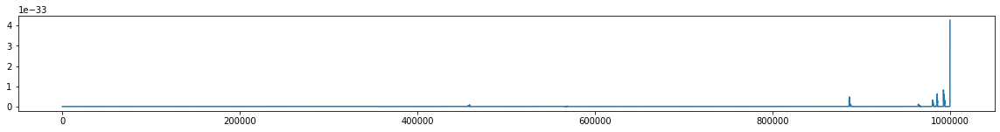

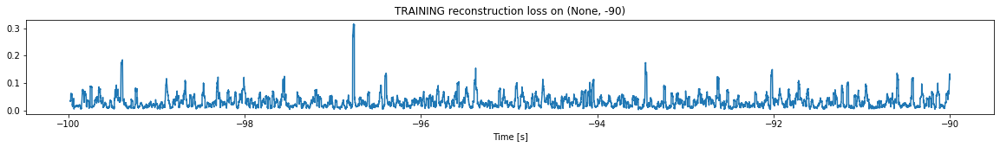

Finished training, median of the log(loss) is:  -1.573762668232749
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


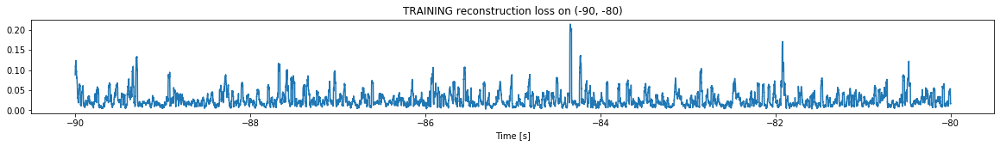

Finished training, median of the log(loss) is:  -1.680147990210389
Triggering for section:  (-80, -70)
Using this median for triggering: -1.573762668232749


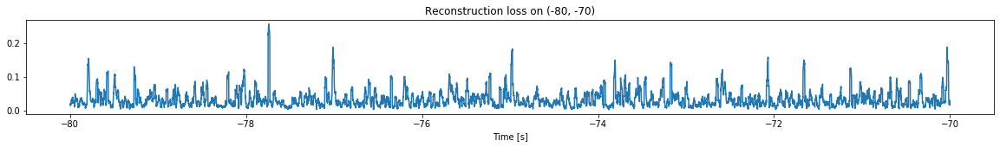

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


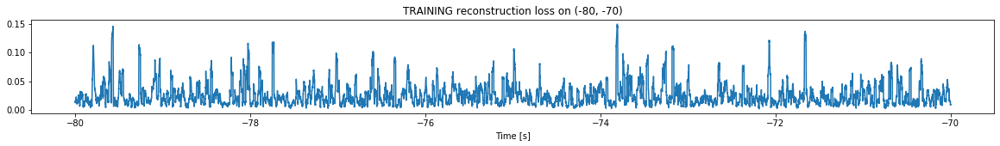

Finished training, median of the log(loss) is:  -1.672124027024943
Triggering for section:  (-70, -60)
Using this median for triggering: -1.680147990210389


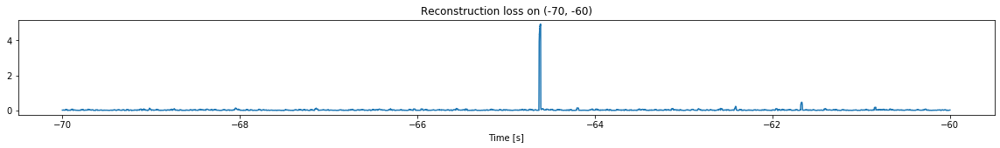

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


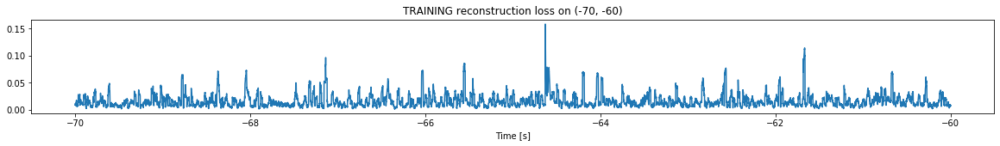

Finished training, median of the log(loss) is:  -1.877242345034961
Triggering for section:  (-60, -50)
Using this median for triggering: -1.672124027024943


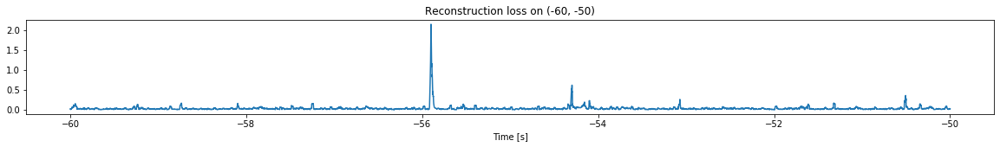

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


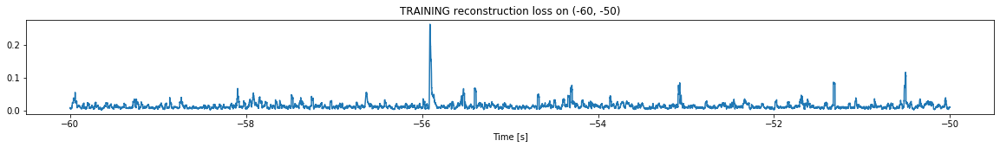

Finished training, median of the log(loss) is:  -1.9484178112967014
Triggering for section:  (-50, -40)
Using this median for triggering: -1.877242345034961


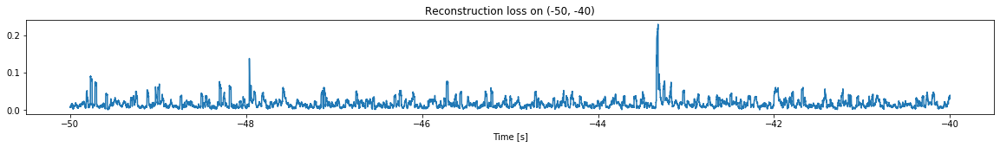

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


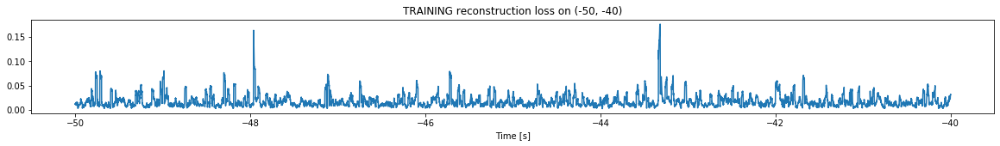

Finished training, median of the log(loss) is:  -1.8526046289077995
Triggering for section:  (-40, -30)
Using this median for triggering: -1.9484178112967014


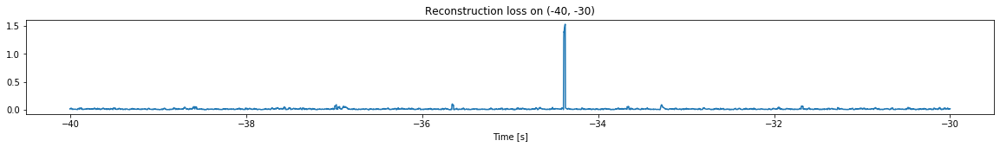

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


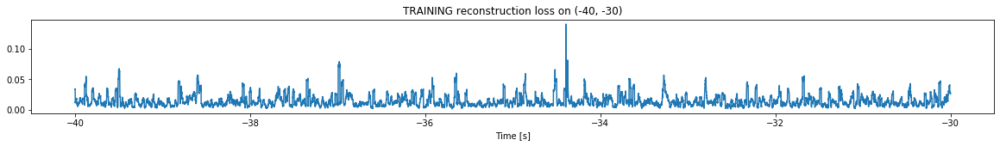

Finished training, median of the log(loss) is:  -1.9274907235771337
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8526046289077995


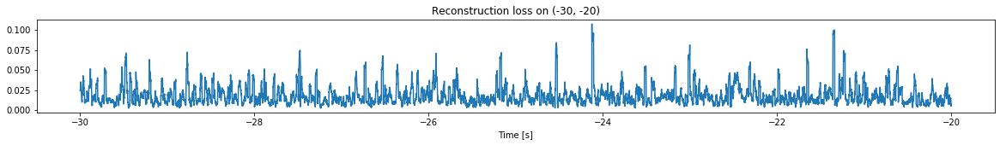

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


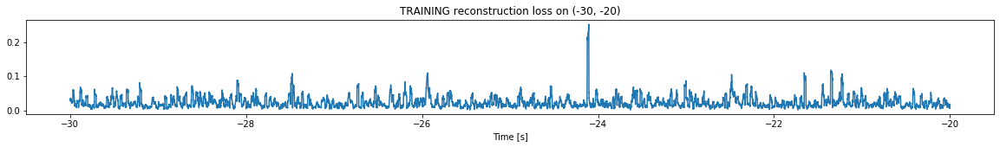

Finished training, median of the log(loss) is:  -1.7127078583094615
Triggering for section:  (-20, -10)
Using this median for triggering: -1.9274907235771337


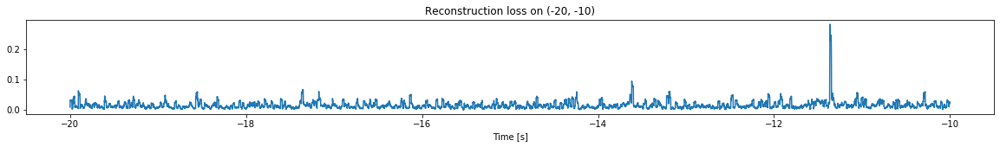

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


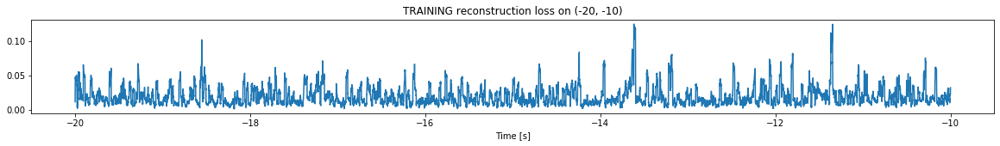

Finished training, median of the log(loss) is:  -1.805110580861112
Triggering for section:  (-10, 0)
Using this median for triggering: -1.7127078583094615


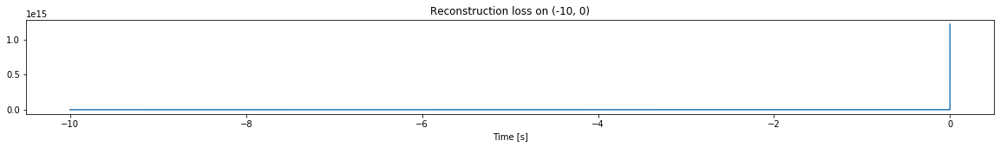

Other trigger time:  [-7.3339999e-01 -4.9999997e-04]
Their log loss values are:  [ 3.96050723 12.94620615]


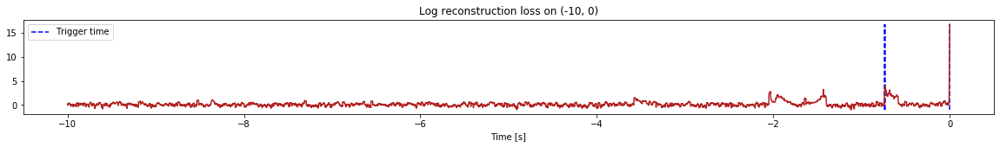

Triggered at:  [-0.7334, -0.00049999997]
<--------
Finished simulation, all the triggered times are:  [-0.7334, -0.00049999997]


In [8]:
simulation("./data/Ramp29/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (999800, 13)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


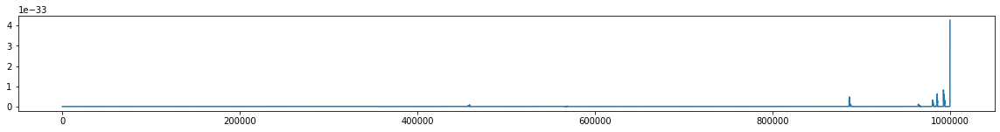

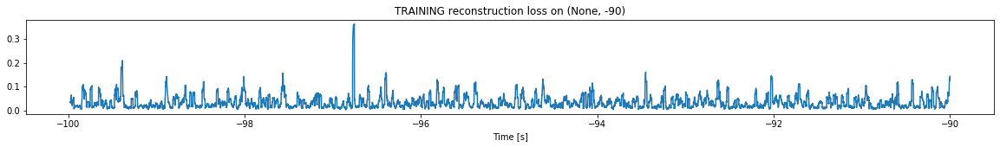

Finished training, median of the log(loss) is:  -1.5587901411659197
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


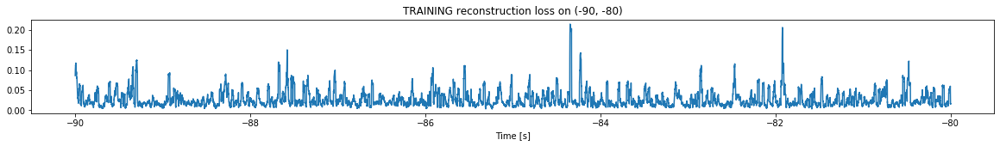

Finished training, median of the log(loss) is:  -1.6793011230943653
Triggering for section:  (-80, -70)
Using this median for triggering: -1.5587901411659197


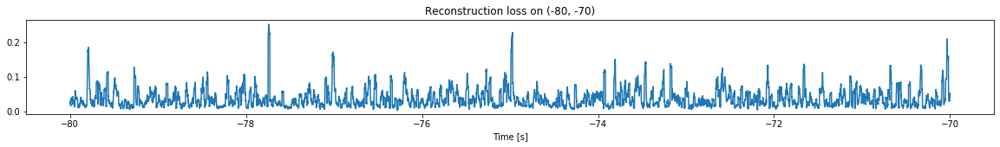

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


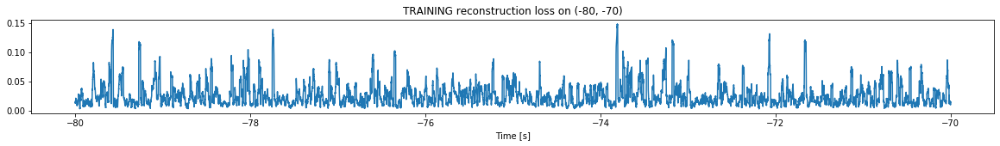

Finished training, median of the log(loss) is:  -1.6762609185428445
Triggering for section:  (-70, -60)
Using this median for triggering: -1.6793011230943653


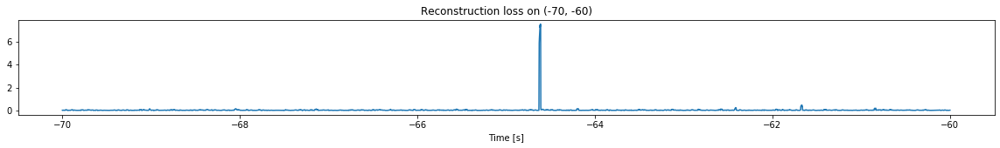

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


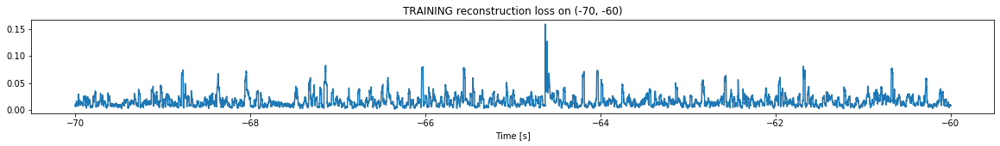

Finished training, median of the log(loss) is:  -1.883042148478241
Triggering for section:  (-60, -50)
Using this median for triggering: -1.6762609185428445


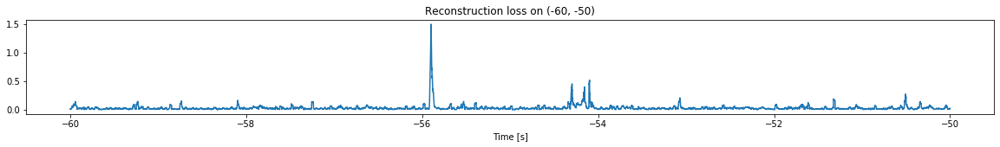

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


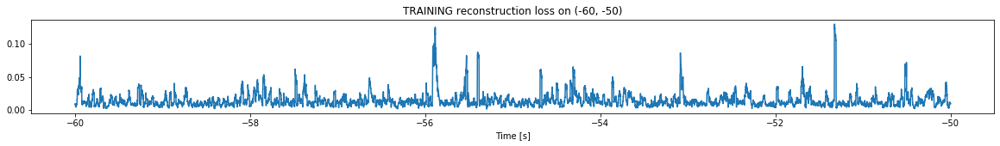

Finished training, median of the log(loss) is:  -1.9310472604085147
Triggering for section:  (-50, -40)
Using this median for triggering: -1.883042148478241


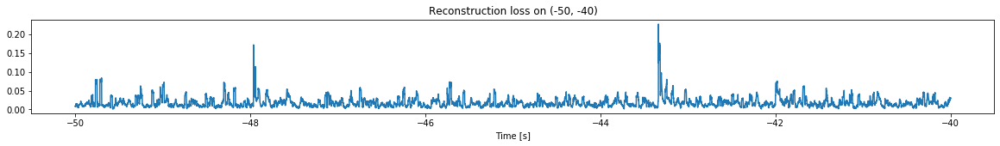

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


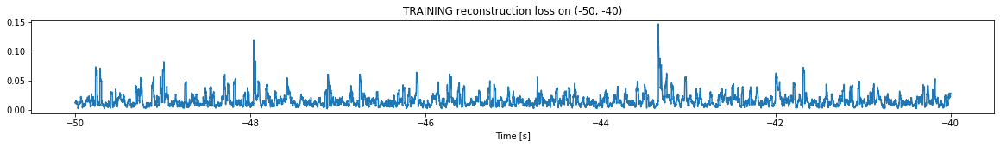

Finished training, median of the log(loss) is:  -1.8692212185981898
Triggering for section:  (-40, -30)
Using this median for triggering: -1.9310472604085147


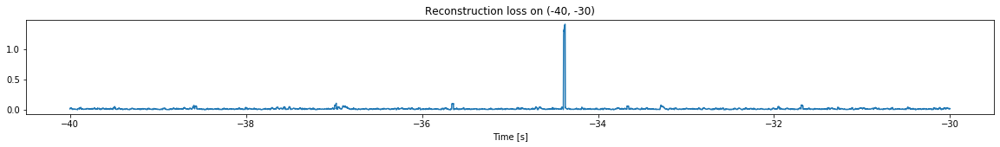

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


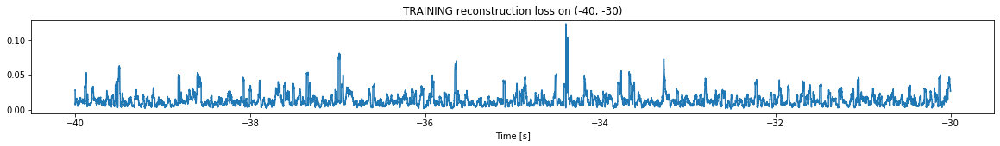

Finished training, median of the log(loss) is:  -1.9307741382267318
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8692212185981898


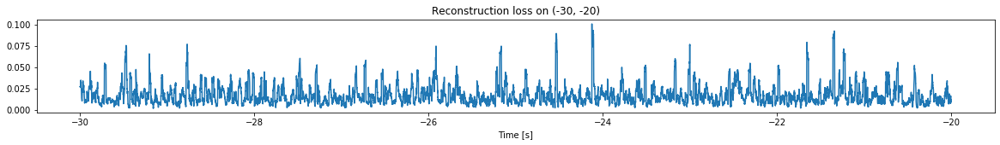

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


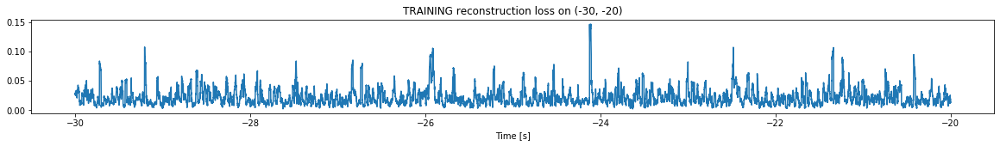

Finished training, median of the log(loss) is:  -1.7287580309368071
Triggering for section:  (-20, -10)
Using this median for triggering: -1.9307741382267318


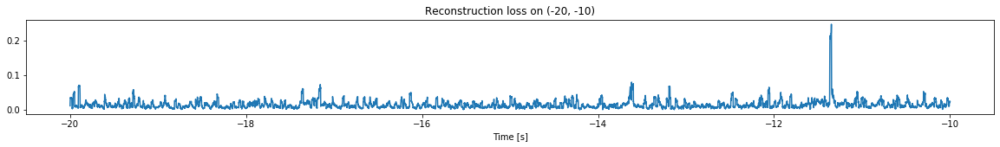

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


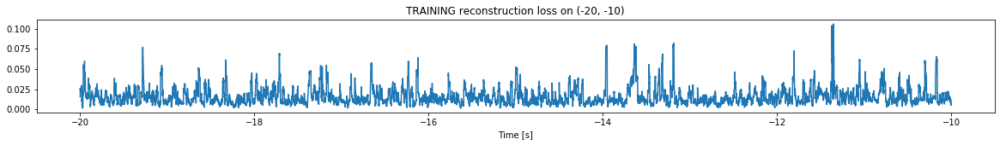

Finished training, median of the log(loss) is:  -1.8779588096039093
Triggering for section:  (-10, 0)
Using this median for triggering: -1.7287580309368071


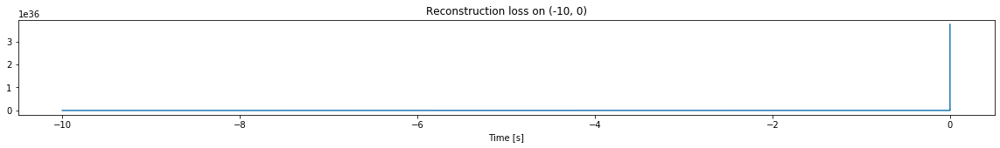

/uscms_data/d3/dhoang/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:274: RuntimeWarning: invalid value encountered in greater


Other trigger time:  [-1.9577999e+00 -1.4339000e+00 -7.3390001e-01 -1.8999999e-03]
Their log loss values are:  [ 4.24582384  7.71678715  9.82442705 36.23195534]


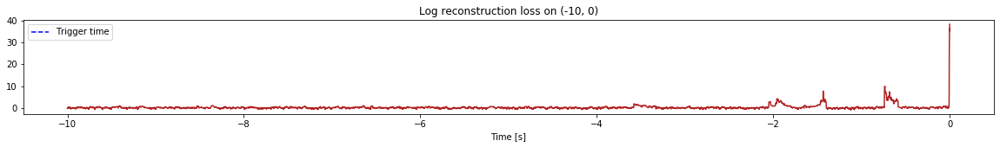

Triggered at:  [-1.9577999, -1.4339, -0.7339, -0.0018999999]
<--------
Finished simulation, all the triggered times are:  [-1.9577999, -1.4339, -0.7339, -0.0018999999]


In [10]:
#1.003 constant
simulation("./data/Ramp29/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (999800, 13)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


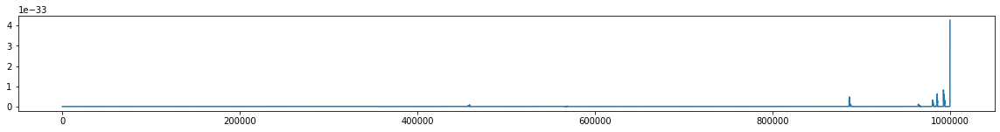

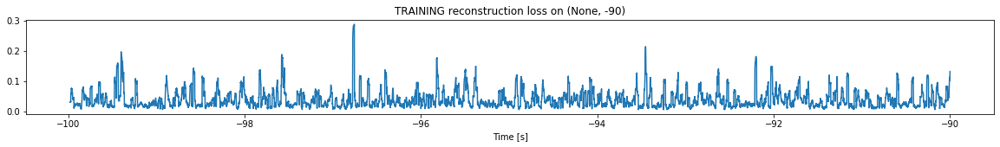

Finished training, median of the log(loss) is:  -1.5047965668482168
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


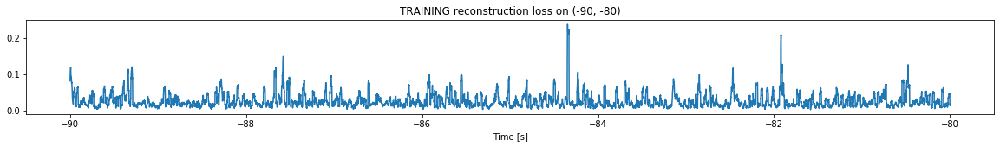

Finished training, median of the log(loss) is:  -1.6633197921111467
Triggering for section:  (-80, -70)
Using this median for triggering: -1.5047965668482168


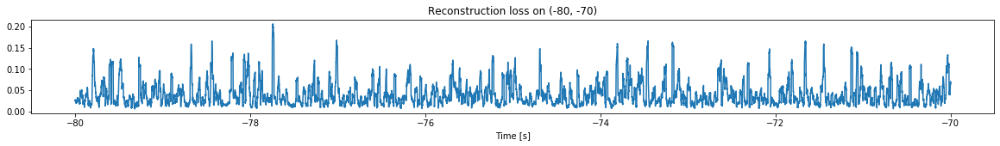

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


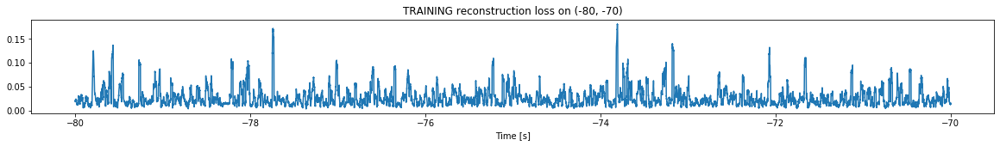

Finished training, median of the log(loss) is:  -1.6622442951421612
Triggering for section:  (-70, -60)
Using this median for triggering: -1.6633197921111467


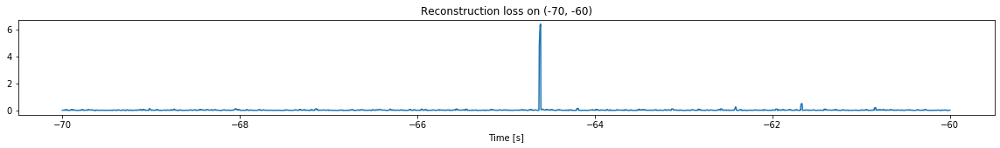

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


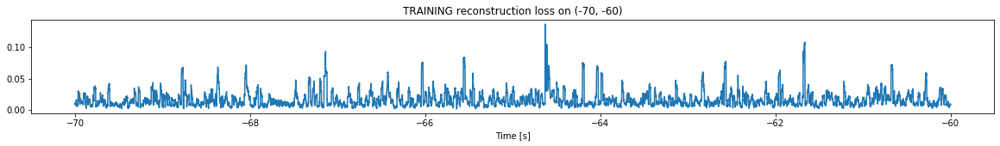

Finished training, median of the log(loss) is:  -1.88009103673999
Triggering for section:  (-60, -50)
Using this median for triggering: -1.6622442951421612


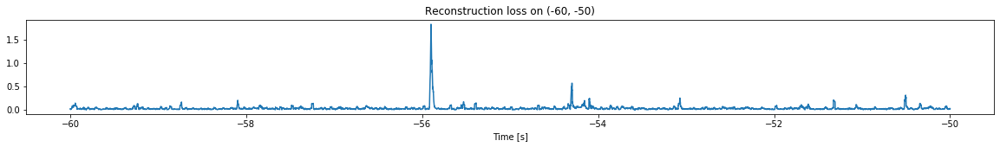

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


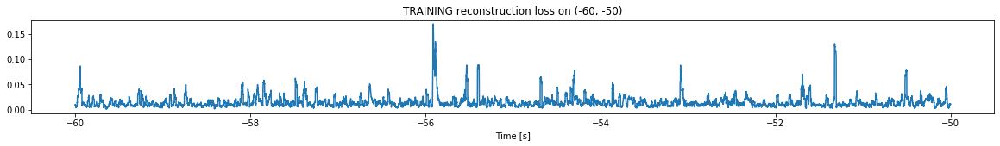

Finished training, median of the log(loss) is:  -1.9190579085568766
Triggering for section:  (-50, -40)
Using this median for triggering: -1.88009103673999


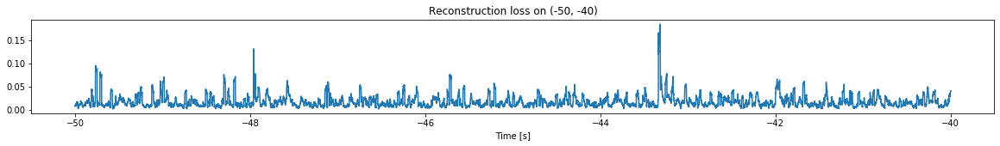

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


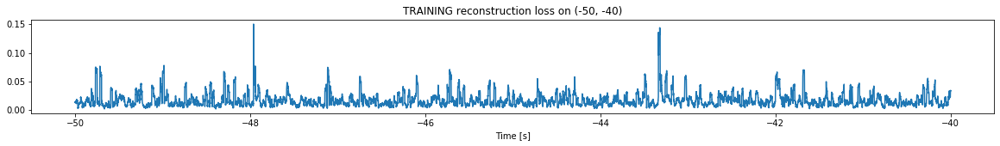

Finished training, median of the log(loss) is:  -1.8536412525080932
Triggering for section:  (-40, -30)
Using this median for triggering: -1.9190579085568766


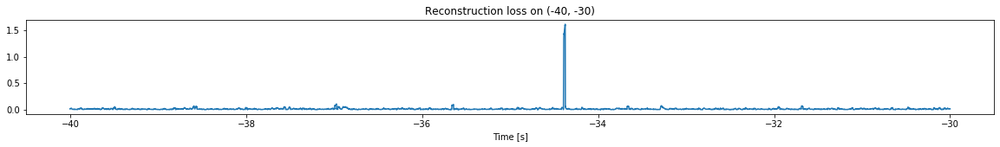

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


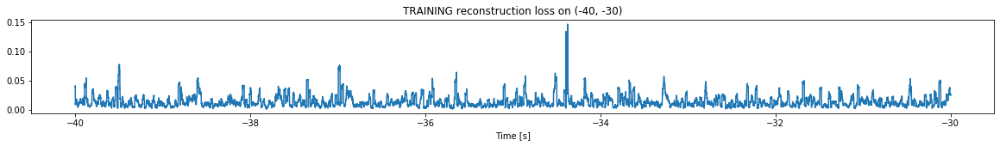

Finished training, median of the log(loss) is:  -1.9324657666488152
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8536412525080932


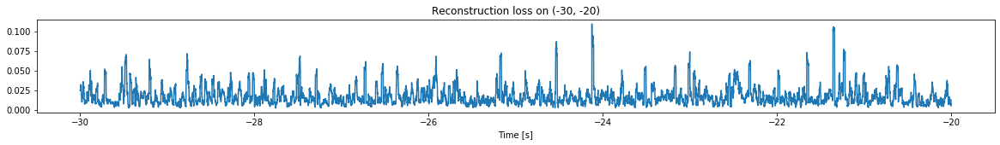

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


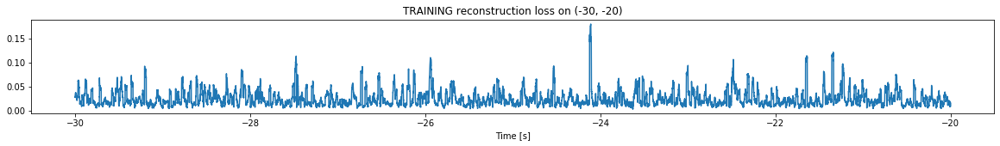

Finished training, median of the log(loss) is:  -1.7000459098285112
Triggering for section:  (-20, -10)
Using this median for triggering: -1.9324657666488152


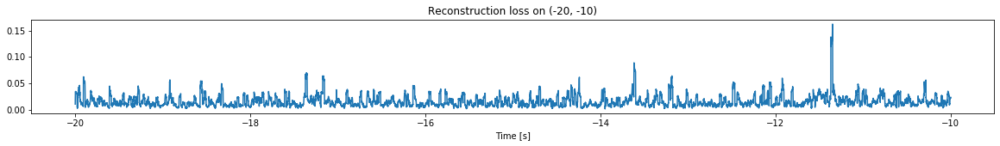

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


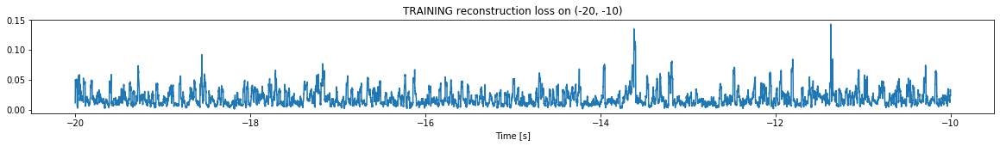

Finished training, median of the log(loss) is:  -1.7981945903157293
Triggering for section:  (-10, 0)
Using this median for triggering: -1.7000459098285112


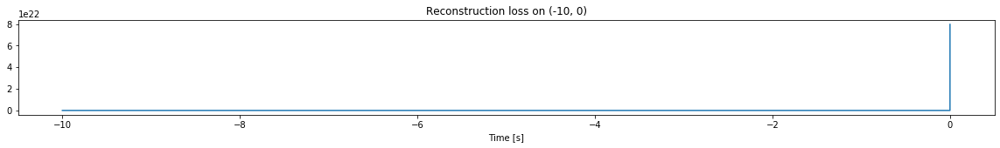

Other trigger time:  [-1.4339 -0.7337 -0.0019]
Their log loss values are:  [ 4.29377404  5.34852217 18.56215678]


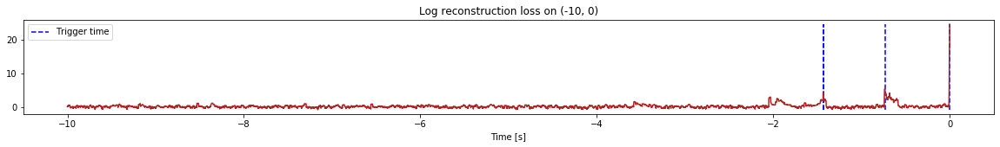

Triggered at:  [-1.4339, -0.7337, -0.0018999999]
<--------
Finished simulation, all the triggered times are:  [-1.4339, -0.7337, -0.0018999999]


In [12]:
#1.0015 constant
simulation("./data/Ramp29/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (999800, 13)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


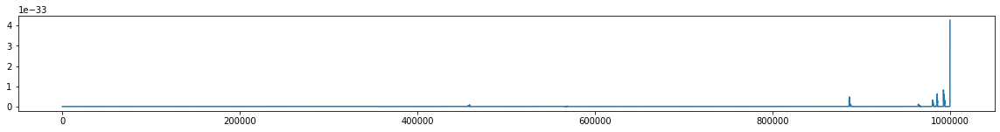

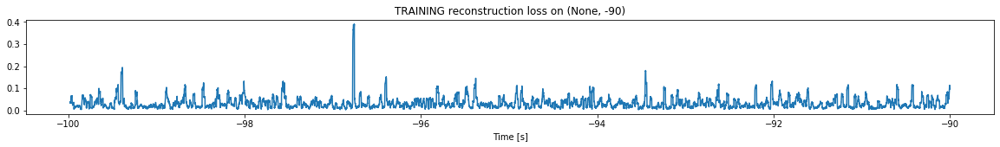

Finished training, median of the log(loss) is:  -1.5640939596292354
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


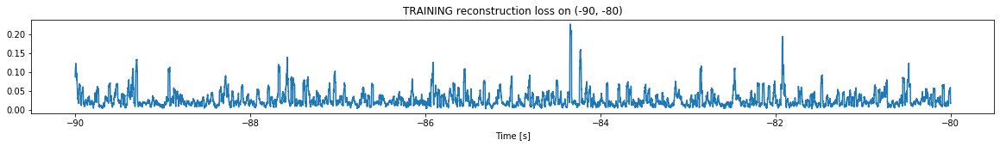

Finished training, median of the log(loss) is:  -1.67150642697827
Triggering for section:  (-80, -70)
Using this median for triggering: -1.5640939596292354


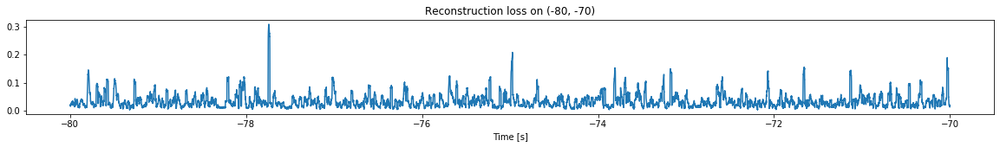

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


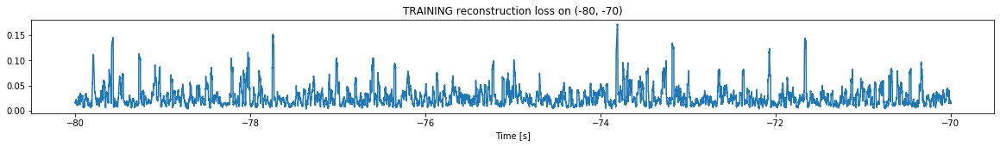

Finished training, median of the log(loss) is:  -1.6560543321959524
Triggering for section:  (-70, -60)
Using this median for triggering: -1.67150642697827


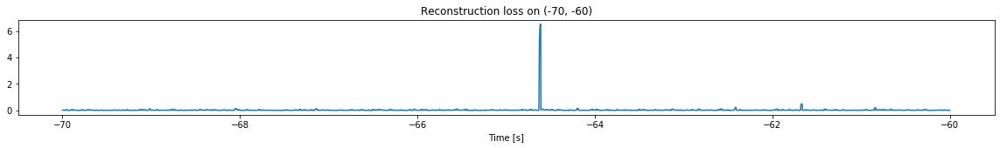

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


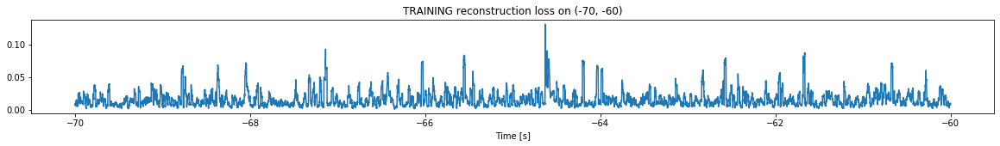

Finished training, median of the log(loss) is:  -1.8721802569201744
Triggering for section:  (-60, -50)
Using this median for triggering: -1.6560543321959524


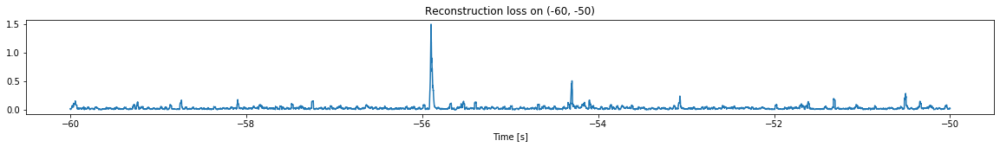

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


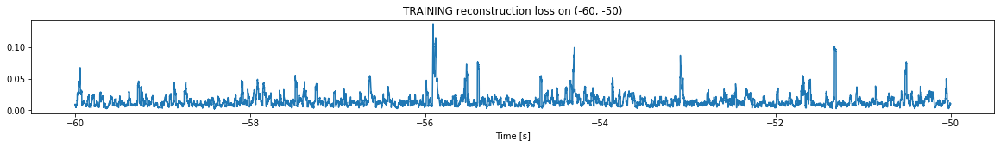

Finished training, median of the log(loss) is:  -1.9152606928579514
Triggering for section:  (-50, -40)
Using this median for triggering: -1.8721802569201744


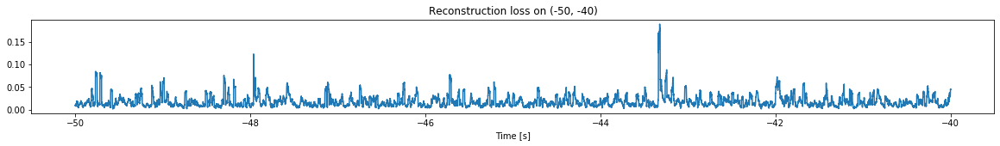

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


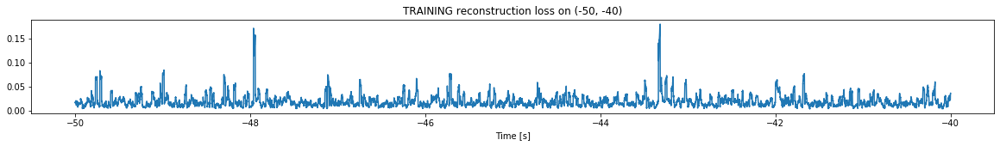

Finished training, median of the log(loss) is:  -1.8073047412220462
Triggering for section:  (-40, -30)
Using this median for triggering: -1.9152606928579514


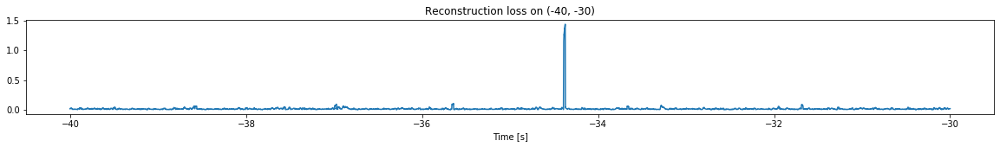

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


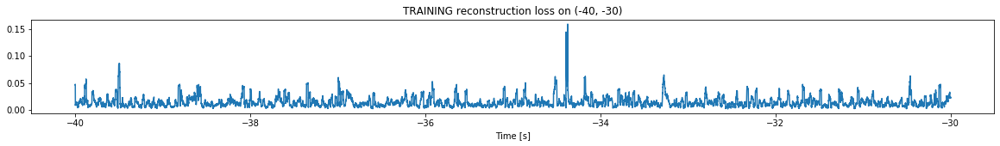

Finished training, median of the log(loss) is:  -1.9196081531545282
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8073047412220462


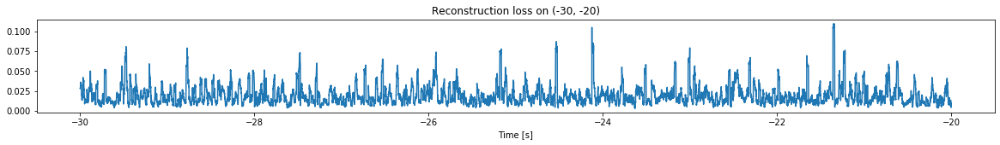

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


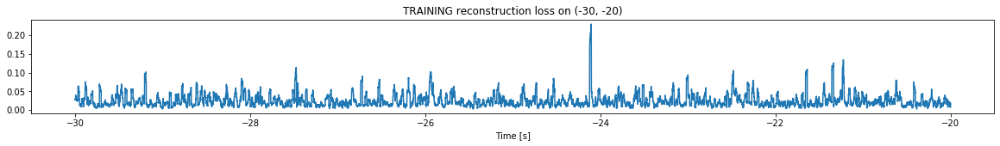

Finished training, median of the log(loss) is:  -1.6827029325450997
Triggering for section:  (-20, -10)
Using this median for triggering: -1.9196081531545282


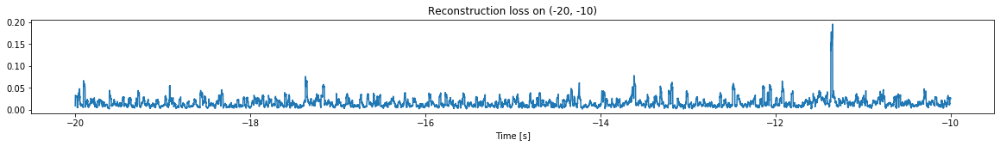

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


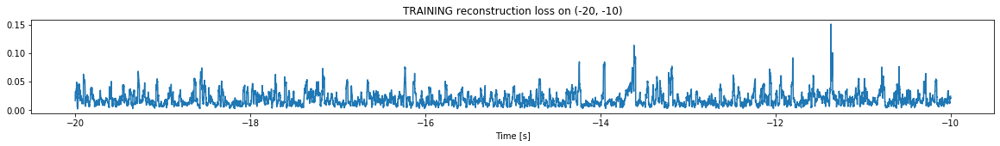

Finished training, median of the log(loss) is:  -1.798269920835961
Triggering for section:  (-10, 0)
Using this median for triggering: -1.6827029325450997


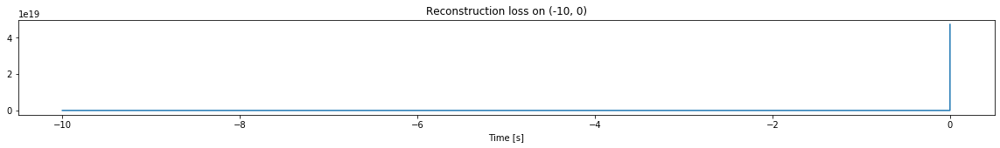

Other trigger time:  [-1.4339000e+00 -7.3390001e-01 -5.9999997e-04]
Their log loss values are:  [ 3.75552811  4.6701277  16.35039278]


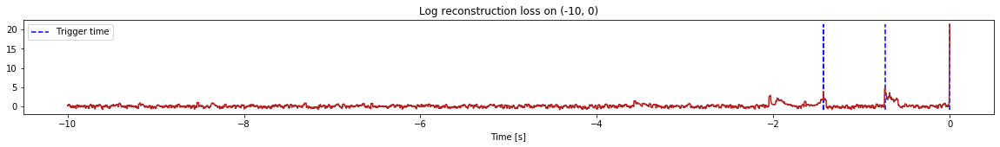

Triggered at:  [-1.4339, -0.7339, -0.00059999997]
<--------
Finished simulation, all the triggered times are:  [-1.4339, -0.7339, -0.00059999997]


In [14]:
#1.0013 constant
simulation("./data/Ramp29/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (999800, 13)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


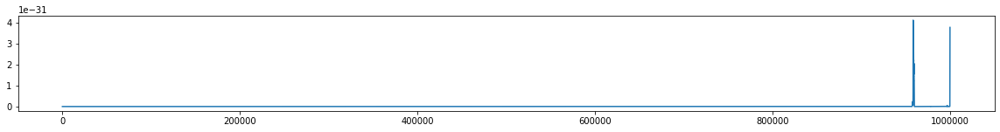

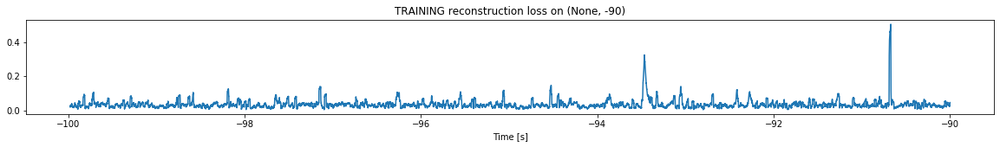

Finished training, median of the log(loss) is:  -1.5120821186379347
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


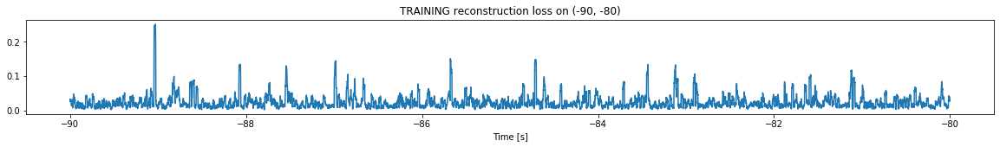

Finished training, median of the log(loss) is:  -1.7103935326020405
Triggering for section:  (-80, -70)
Using this median for triggering: -1.5120821186379347


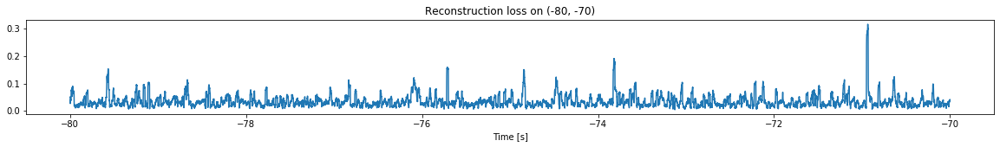

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


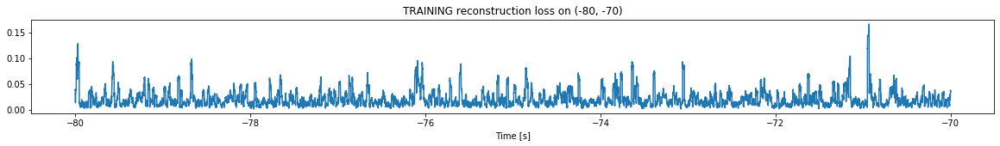

Finished training, median of the log(loss) is:  -1.7745164823061783
Triggering for section:  (-70, -60)
Using this median for triggering: -1.7103935326020405


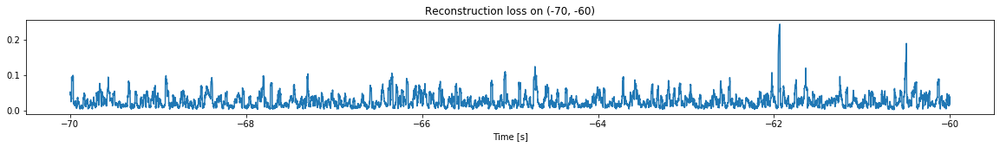

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


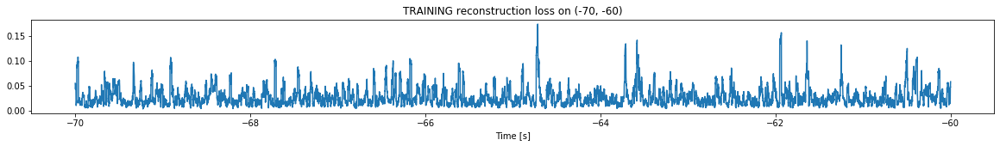

Finished training, median of the log(loss) is:  -1.6578839520296689
Triggering for section:  (-60, -50)
Using this median for triggering: -1.7745164823061783


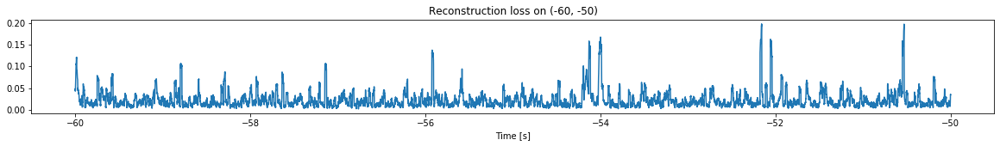

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


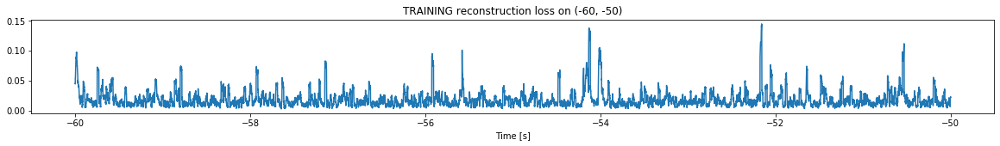

Finished training, median of the log(loss) is:  -1.8359137208236276
Triggering for section:  (-50, -40)
Using this median for triggering: -1.6578839520296689


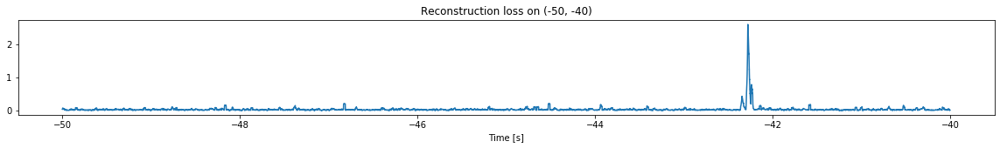

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


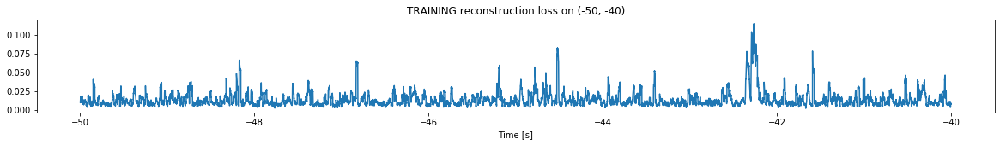

Finished training, median of the log(loss) is:  -1.9643852146490064
Triggering for section:  (-40, -30)
Using this median for triggering: -1.8359137208236276


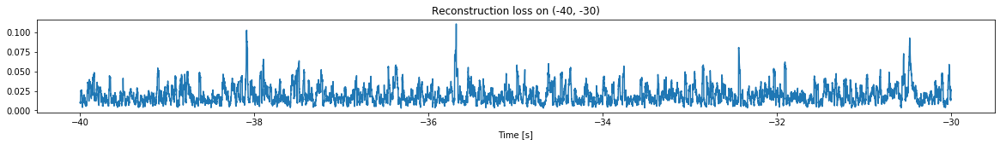

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


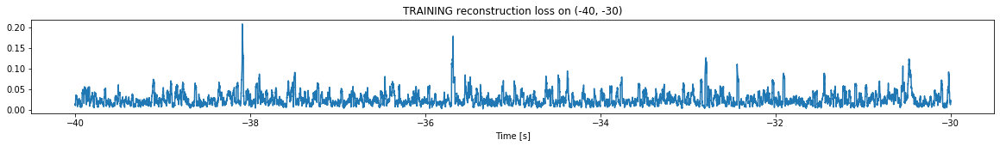

Finished training, median of the log(loss) is:  -1.651258748066676
Triggering for section:  (-30, -20)
Using this median for triggering: -1.9643852146490064


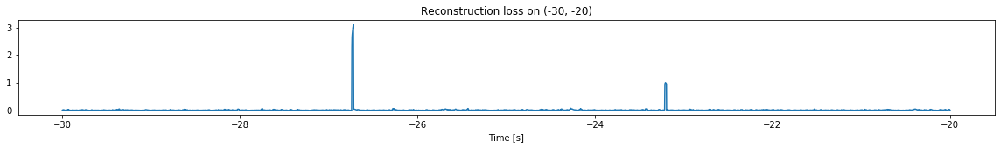

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


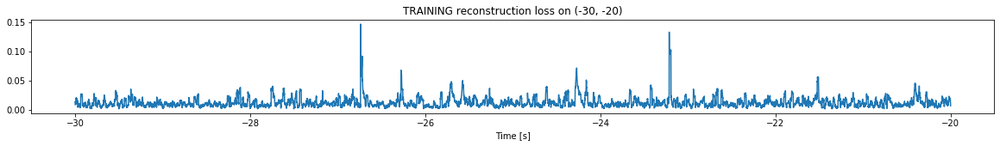

Finished training, median of the log(loss) is:  -1.984507572268472
Triggering for section:  (-20, -10)
Using this median for triggering: -1.651258748066676


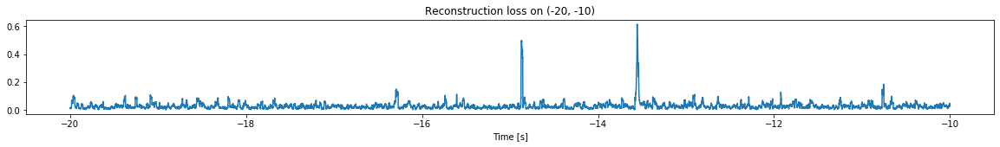

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


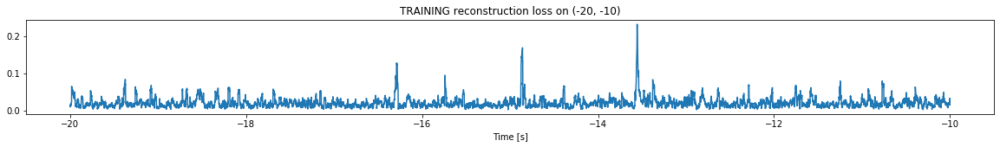

Finished training, median of the log(loss) is:  -1.744928664675867
Triggering for section:  (-10, 0)
Using this median for triggering: -1.984507572268472


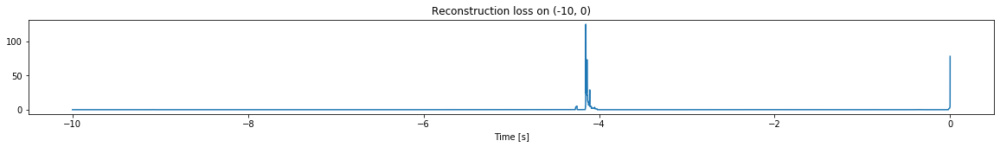

Other trigger time:  [-4.1506]
Their log loss values are:  [4.08278676]


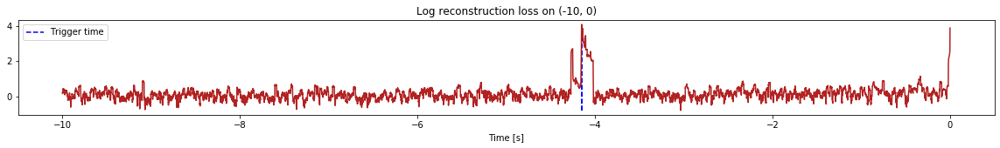

Triggered at:  [-4.1506]
<--------
Finished simulation, all the triggered times are:  [-4.1506]


In [15]:
#1.0013 constant
simulation("./data/Ramp5/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (999800, 13)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


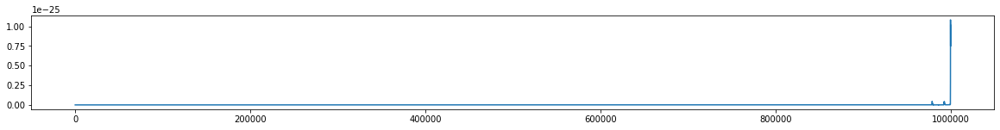

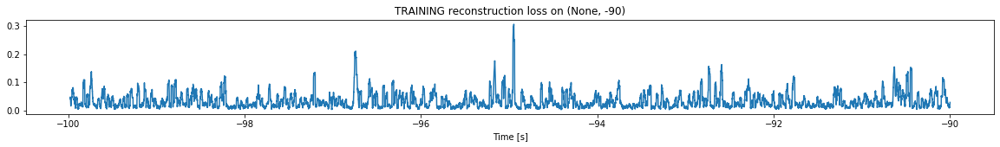

Finished training, median of the log(loss) is:  -1.5808066965050347
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


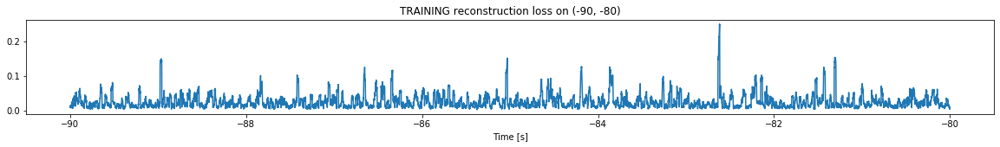

Finished training, median of the log(loss) is:  -1.6963630703454395
Triggering for section:  (-80, -70)
Using this median for triggering: -1.5808066965050347


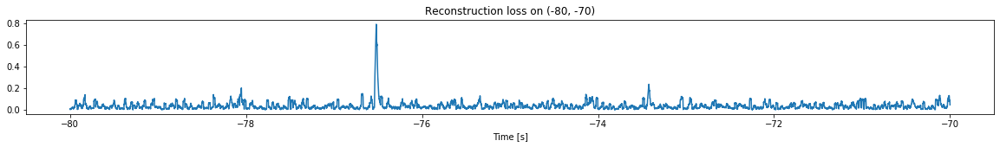

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


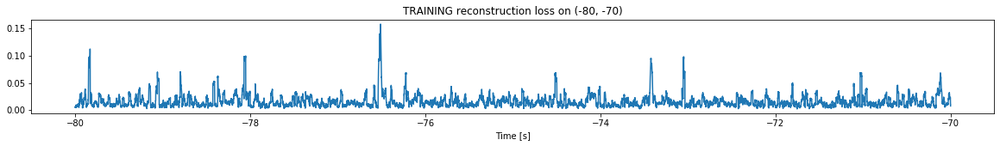

Finished training, median of the log(loss) is:  -1.888470621585193
Triggering for section:  (-70, -60)
Using this median for triggering: -1.6963630703454395


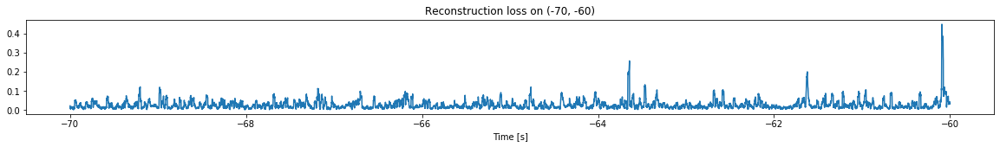

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


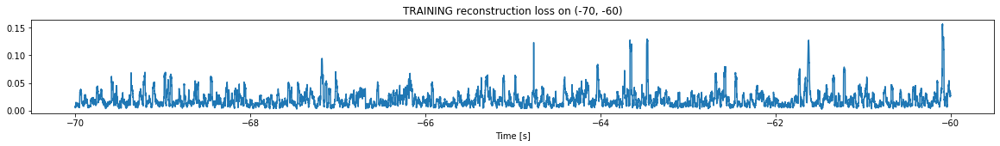

Finished training, median of the log(loss) is:  -1.7923620943351697
Triggering for section:  (-60, -50)
Using this median for triggering: -1.888470621585193


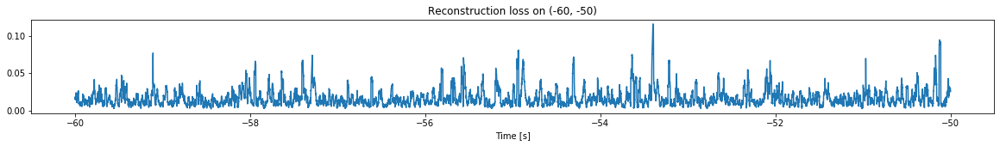

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


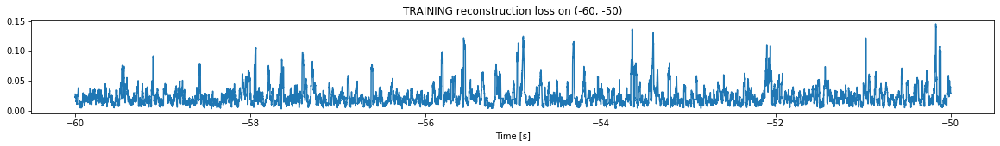

Finished training, median of the log(loss) is:  -1.7082597887777164
Triggering for section:  (-50, -40)
Using this median for triggering: -1.7923620943351697


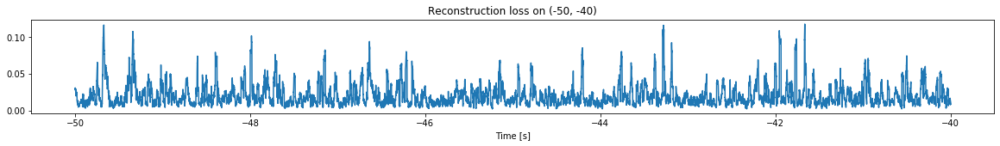

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


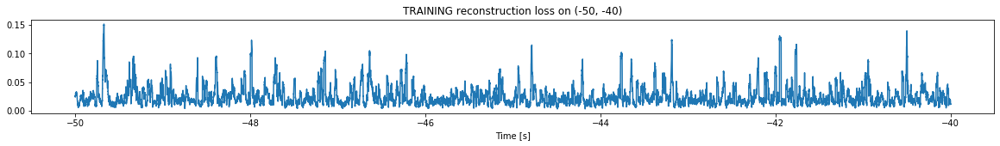

Finished training, median of the log(loss) is:  -1.6902598927037007
Triggering for section:  (-40, -30)
Using this median for triggering: -1.7082597887777164


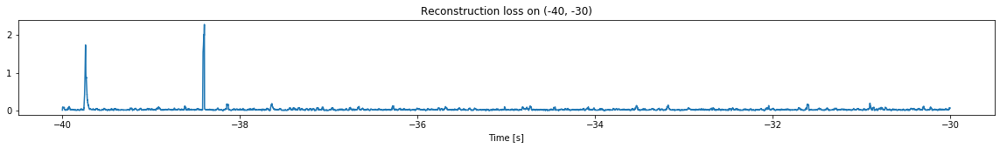

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


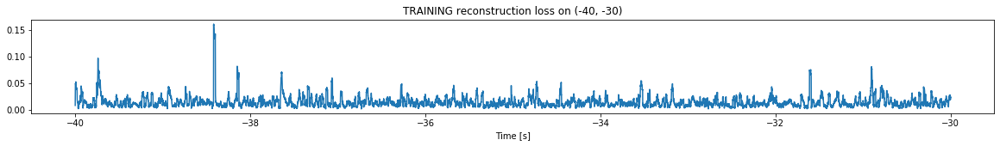

Finished training, median of the log(loss) is:  -1.894282034929731
Triggering for section:  (-30, -20)
Using this median for triggering: -1.6902598927037007


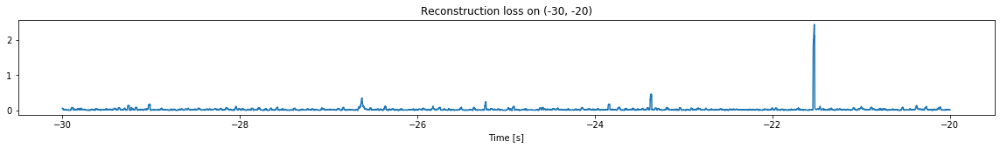

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


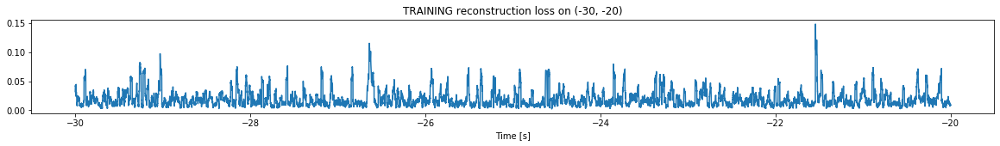

Finished training, median of the log(loss) is:  -1.8066008674231098
Triggering for section:  (-20, -10)
Using this median for triggering: -1.894282034929731


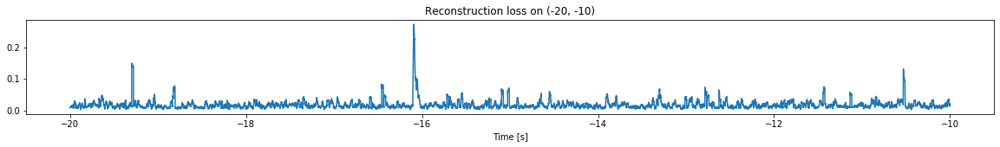

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


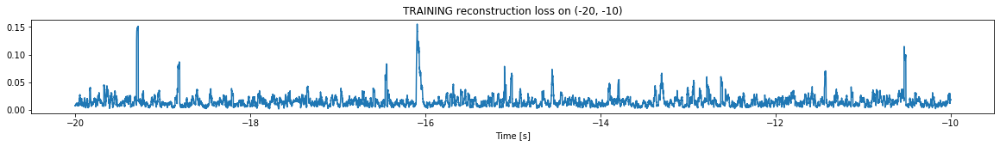

Finished training, median of the log(loss) is:  -1.8940078669925935
Triggering for section:  (-10, 0)
Using this median for triggering: -1.8066008674231098


/uscms_data/d3/dhoang/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: overflow encountered in power


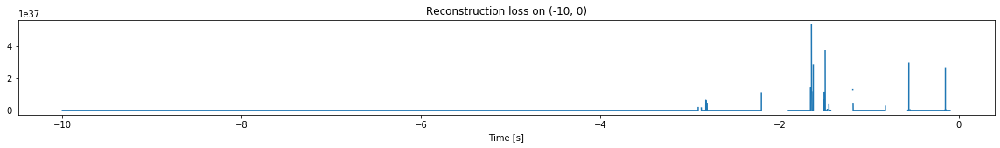

/uscms_data/d3/dhoang/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:274: RuntimeWarning: invalid value encountered in greater


Other trigger time:  [-4.2950997  -2.8214998  -2.2681     -1.6366999  -1.1297     -0.14919999]
Their log loss values are:  [ 4.5948673  38.61105091 11.10453965 36.05756083 21.65027127 37.55818988]


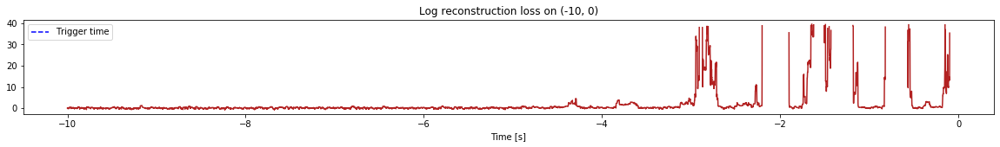

Triggered at:  [-4.2950997, -2.8214998, -2.2681, -1.6366999, -1.1297, -0.14919999]
<--------
Finished simulation, all the triggered times are:  [-4.2950997, -2.8214998, -2.2681, -1.6366999, -1.1297, -0.14919999]


In [16]:
#1.0013 constant
simulation("./data/Ramp4/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (999800, 13)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


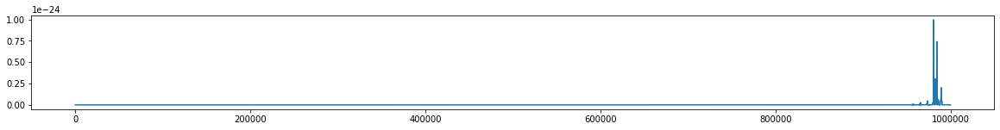

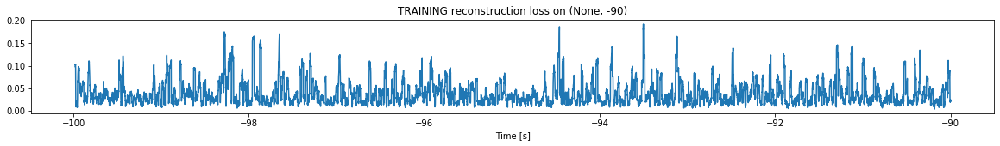

Finished training, median of the log(loss) is:  -1.5013692183020515
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


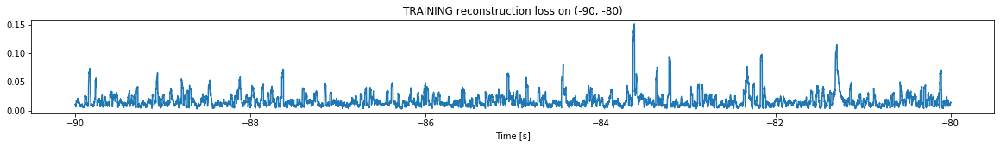

Finished training, median of the log(loss) is:  -1.8623517258860351
Triggering for section:  (-80, -70)
Using this median for triggering: -1.5013692183020515


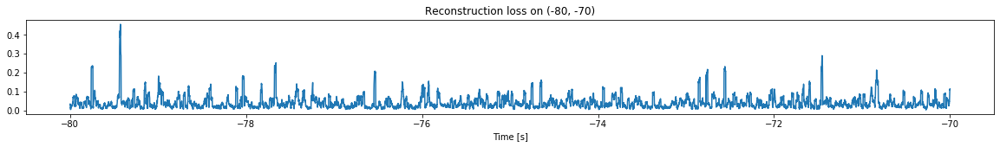

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


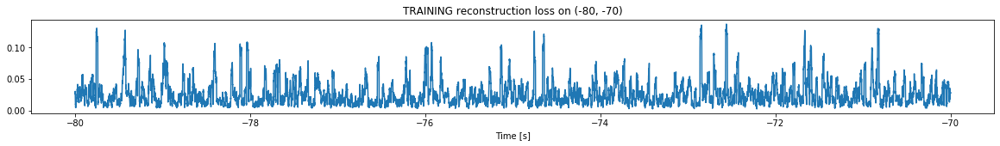

Finished training, median of the log(loss) is:  -1.6723983048002085
Triggering for section:  (-70, -60)
Using this median for triggering: -1.8623517258860351


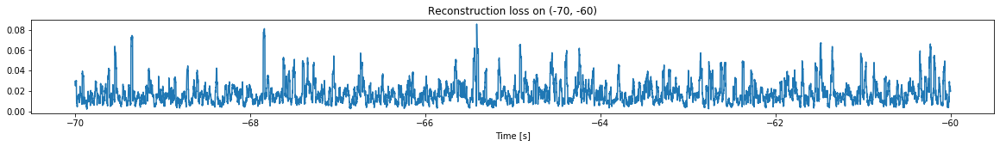

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


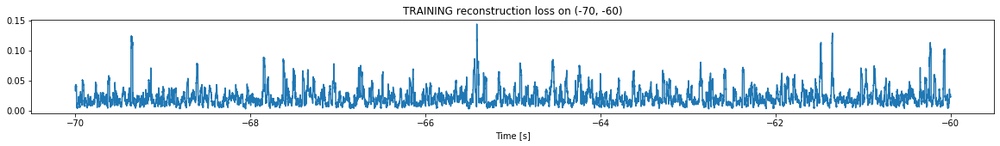

Finished training, median of the log(loss) is:  -1.737133434067442
Triggering for section:  (-60, -50)
Using this median for triggering: -1.6723983048002085


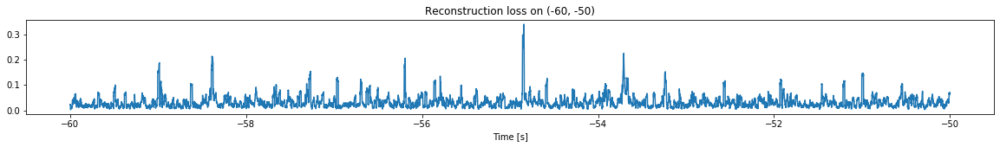

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


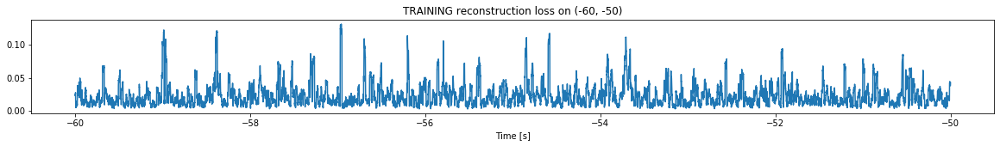

Finished training, median of the log(loss) is:  -1.7364883395121198
Triggering for section:  (-50, -40)
Using this median for triggering: -1.737133434067442


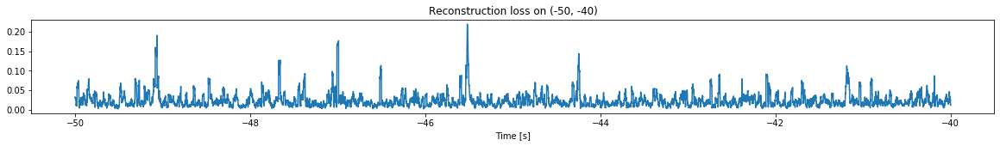

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


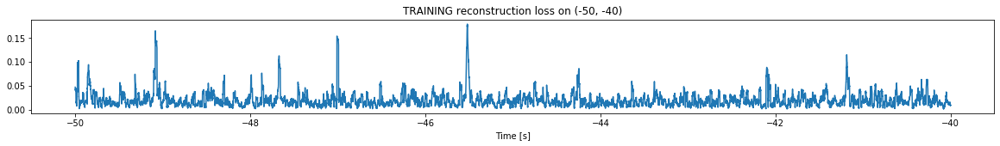

Finished training, median of the log(loss) is:  -1.750995399500904
Triggering for section:  (-40, -30)
Using this median for triggering: -1.7364883395121198


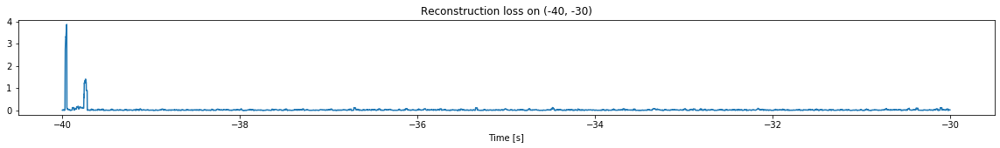

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


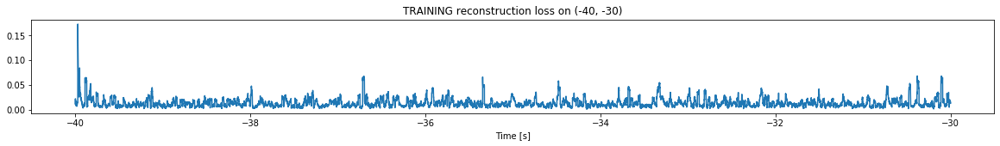

Finished training, median of the log(loss) is:  -1.9605670669347286
Triggering for section:  (-30, -20)
Using this median for triggering: -1.750995399500904


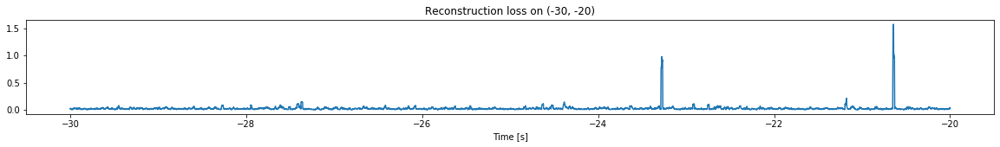

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


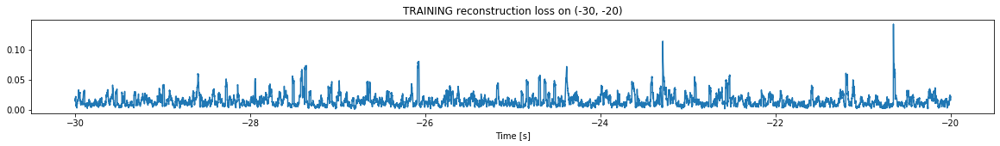

Finished training, median of the log(loss) is:  -1.9024773486270536
Triggering for section:  (-20, -10)
Using this median for triggering: -1.9605670669347286


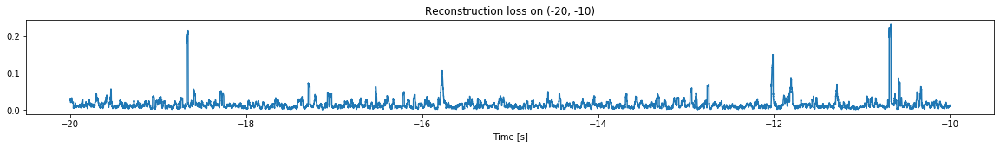

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


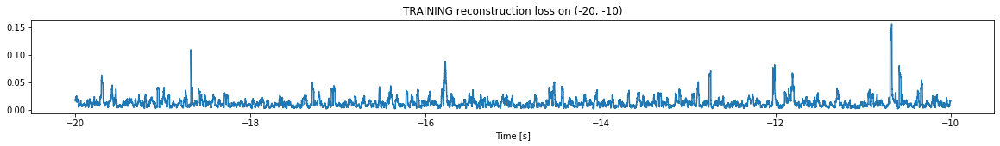

Finished training, median of the log(loss) is:  -1.9819369763864376
Triggering for section:  (-10, 0)
Using this median for triggering: -1.9024773486270536


/uscms_data/d3/dhoang/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: overflow encountered in power


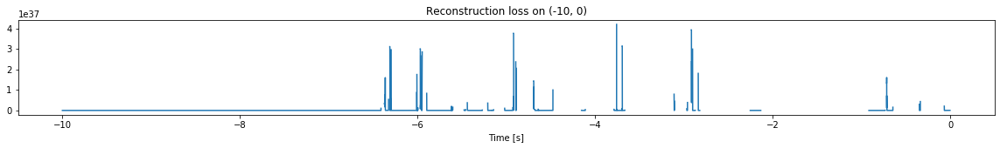

/uscms_data/d3/dhoang/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:274: RuntimeWarning: invalid value encountered in greater


Other trigger time:  [-6.3638997 -5.6183    -5.0169    -4.486     -3.674     -3.1109998
 -2.1615999 -0.7172    -0.0661   ]
Their log loss values are:  [39.10680247 38.21538155 13.58097457 18.60040775 33.58925837 36.68287711
  6.3426428  39.10842813  5.3266193 ]


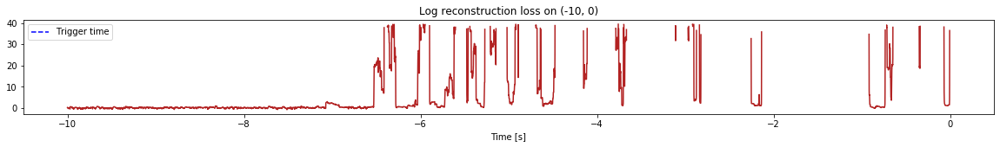

Triggered at:  [-6.3638997, -5.6183, -5.0169, -4.486, -3.674, -3.1109998, -2.1615999, -0.7172, -0.0661]
<--------
Finished simulation, all the triggered times are:  [-6.3638997, -5.6183, -5.0169, -4.486, -3.674, -3.1109998, -2.1615999, -0.7172, -0.0661]


In [17]:
#1.0013 constant
simulation("./data/Ramp12d/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (999800, 13)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


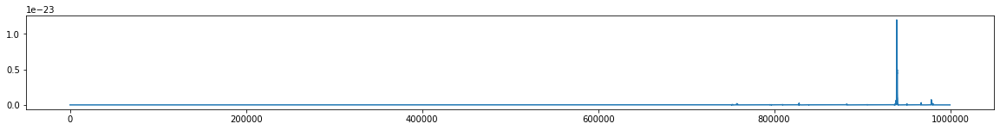

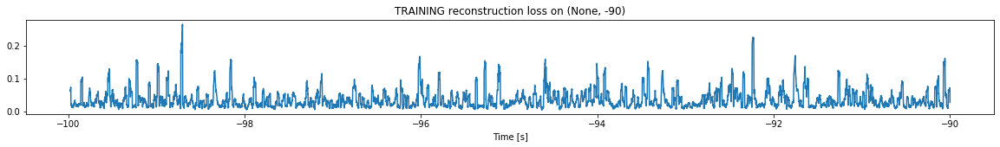

Finished training, median of the log(loss) is:  -1.5482772988862703
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


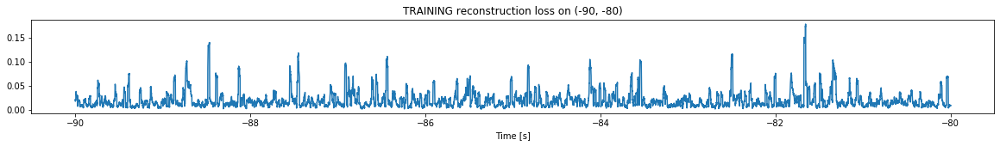

Finished training, median of the log(loss) is:  -1.8059205534238822
Triggering for section:  (-80, -70)
Using this median for triggering: -1.5482772988862703


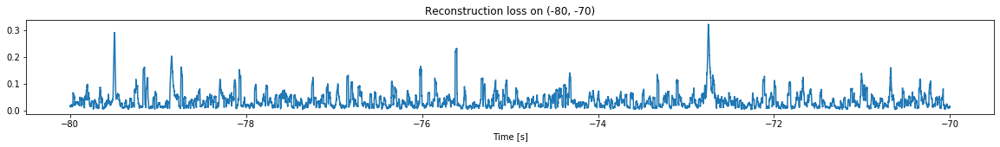

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


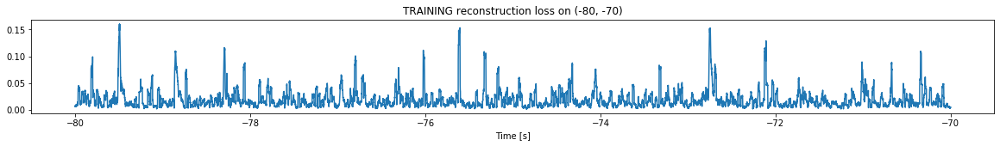

Finished training, median of the log(loss) is:  -1.8154073028737514
Triggering for section:  (-70, -60)
Using this median for triggering: -1.8059205534238822


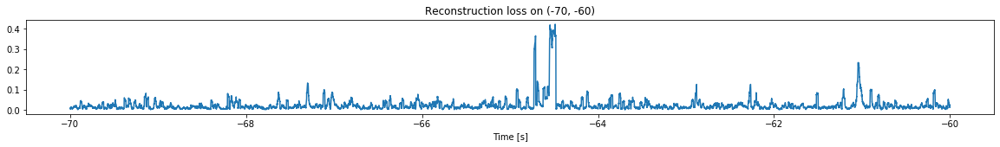

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


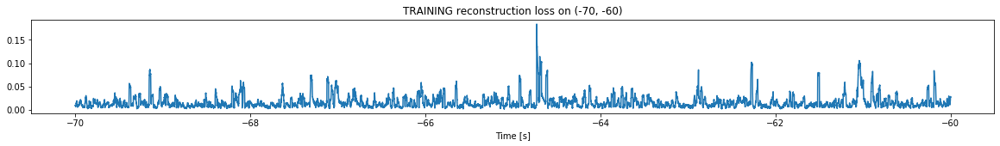

Finished training, median of the log(loss) is:  -1.89653776990443
Triggering for section:  (-60, -50)
Using this median for triggering: -1.8154073028737514


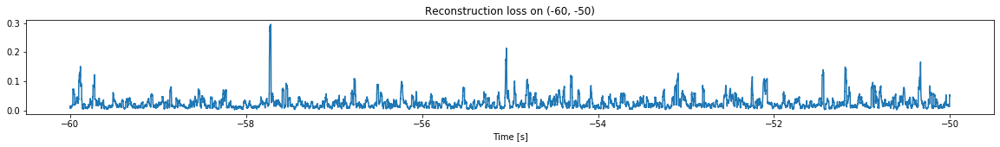

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


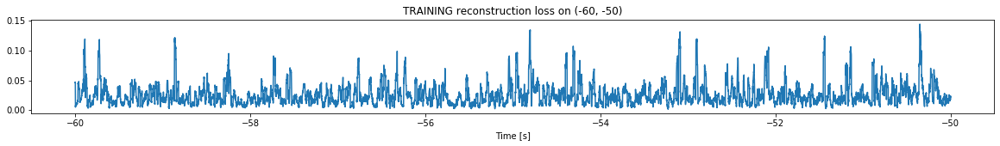

Finished training, median of the log(loss) is:  -1.66366445846479
Triggering for section:  (-50, -40)
Using this median for triggering: -1.89653776990443


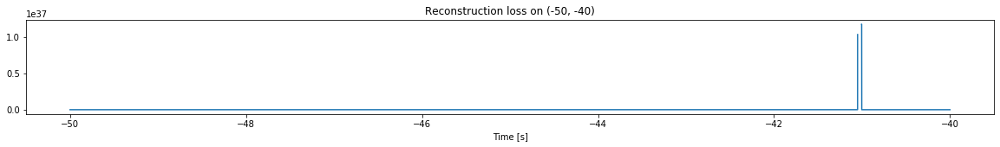

/uscms_data/d3/dhoang/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:274: RuntimeWarning: invalid value encountered in greater


Other trigger time:  [-40.993298]
Their log loss values are:  [19.28964352]


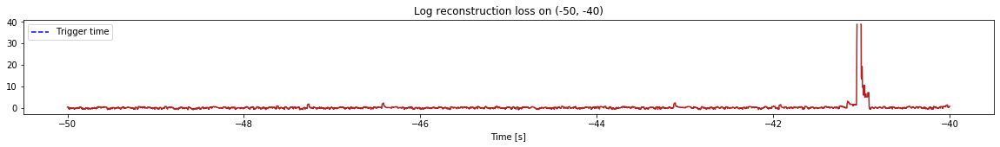

Triggered at:  [-40.993298]
<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


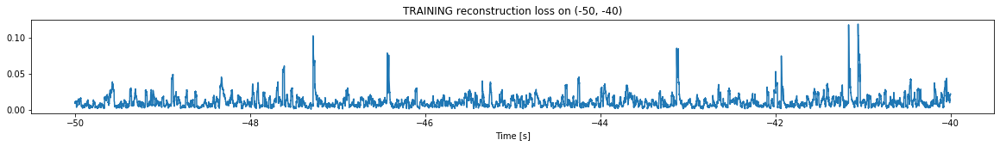

Finished training, median of the log(loss) is:  -2.0381522811335366
Triggering for section:  (-40, -30)
Using this median for triggering: -1.66366445846479


/uscms_data/d3/dhoang/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: overflow encountered in power


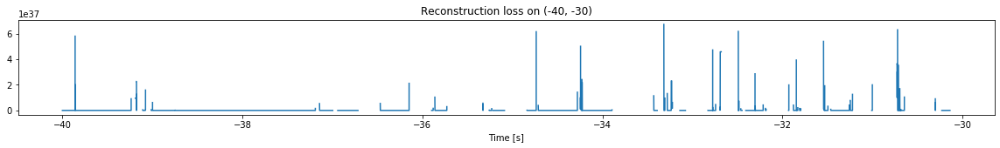

/uscms_data/d3/dhoang/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:274: RuntimeWarning: invalid value encountered in greater


<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


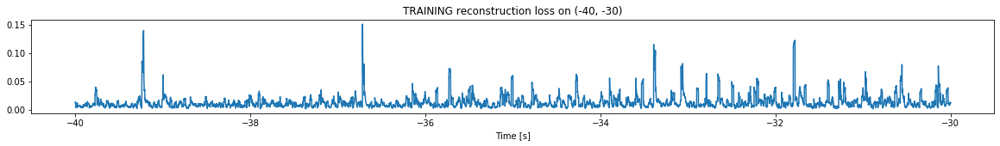

Finished training, median of the log(loss) is:  -2.0029324903819345
Triggering for section:  (-30, -20)
Using this median for triggering: -2.0381522811335366


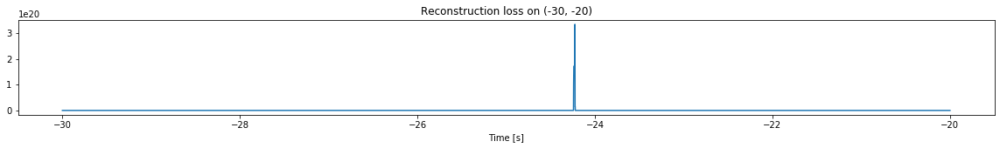

Other trigger time:  [-24.7431 -24.2265 -20.4439]
Their log loss values are:  [ 8.55844818 22.56079202  6.44715393]


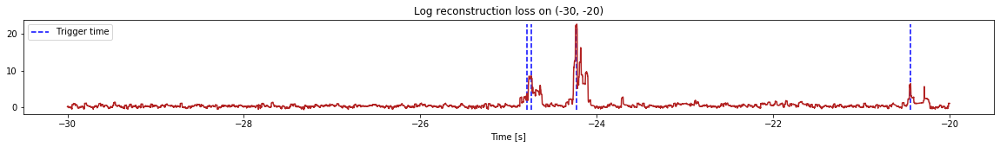

Triggered at:  [-24.7431, -24.2265, -20.4439]
<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


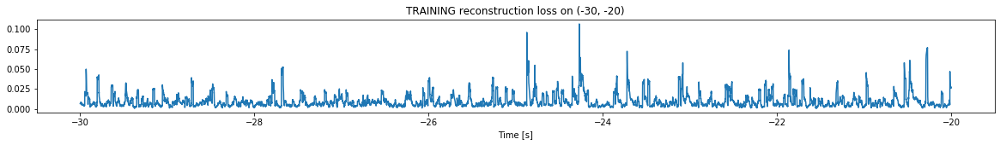

Finished training, median of the log(loss) is:  -2.1560349242414043
Triggering for section:  (-20, -10)
Using this median for triggering: -2.0029324903819345


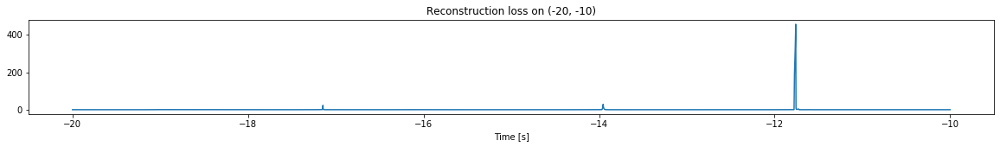

Other trigger time:  [-17.1464 -13.9534 -11.759 ]
Their log loss values are:  [3.37014949 3.45948787 4.6627538 ]


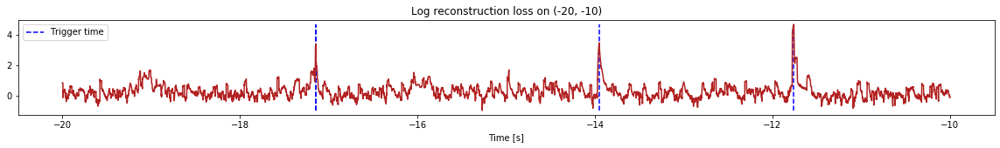

Triggered at:  [-17.1464, -13.9534, -11.759]
<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


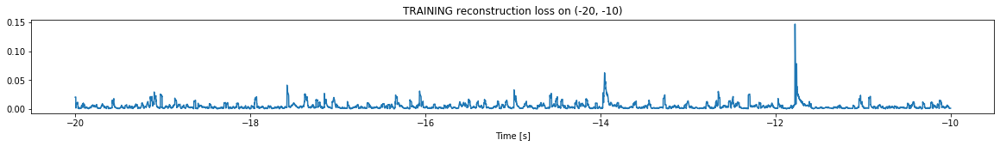

Finished training, median of the log(loss) is:  -2.454124076997067
Triggering for section:  (-10, 0)
Using this median for triggering: -2.1560349242414043


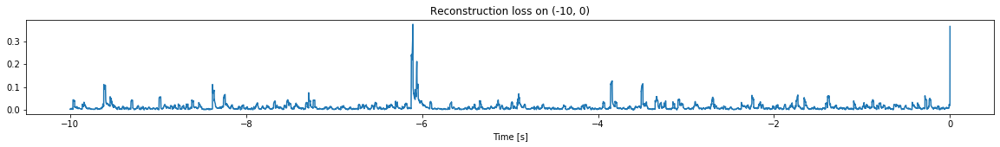

<--------
Finished simulation, all the triggered times are:  [-40.993298, -24.7431, -24.2265, -20.4439, -17.1464, -13.9534, -11.759]


In [18]:
#1.0013 constant
simulation("./data/Ramp21/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (999800, 13)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


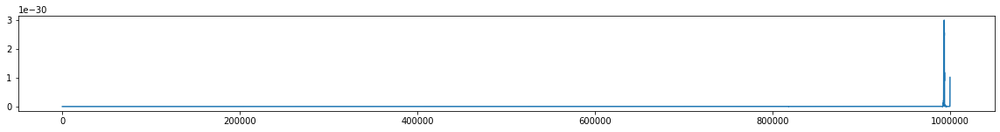

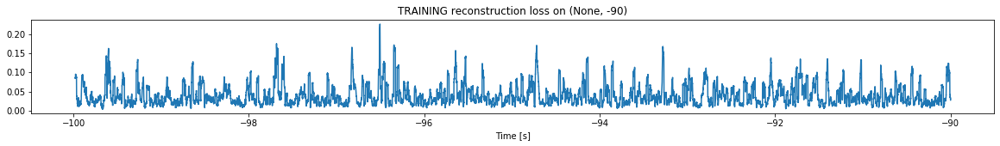

Finished training, median of the log(loss) is:  -1.4835792602298072
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


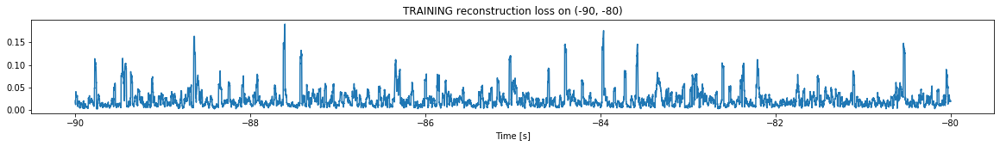

Finished training, median of the log(loss) is:  -1.7382686387603967
Triggering for section:  (-80, -70)
Using this median for triggering: -1.4835792602298072


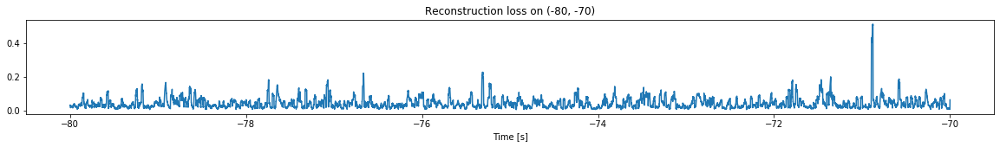

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


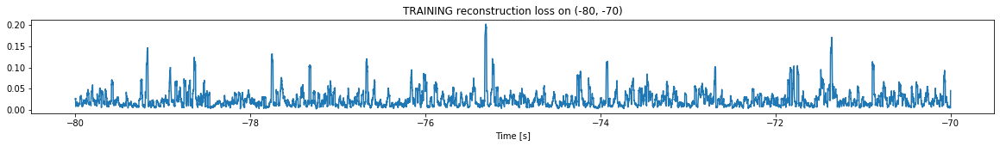

Finished training, median of the log(loss) is:  -1.7200694548437112
Triggering for section:  (-70, -60)
Using this median for triggering: -1.7382686387603967


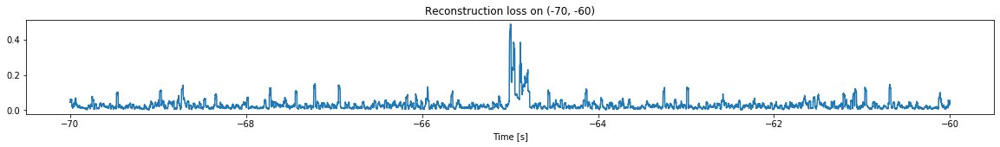

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


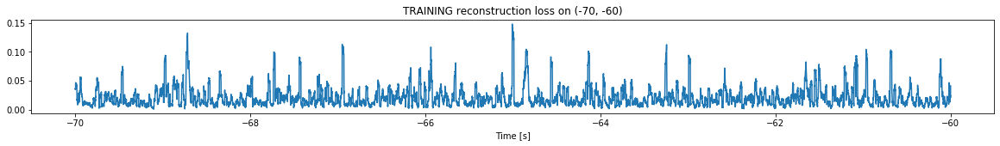

Finished training, median of the log(loss) is:  -1.7540199597039727
Triggering for section:  (-60, -50)
Using this median for triggering: -1.7200694548437112


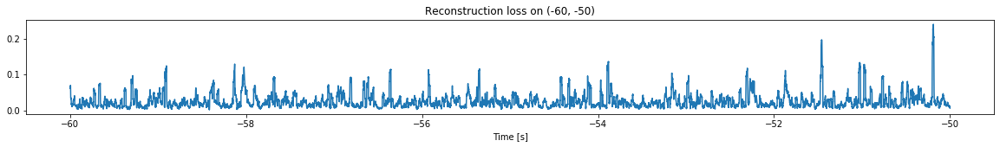

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


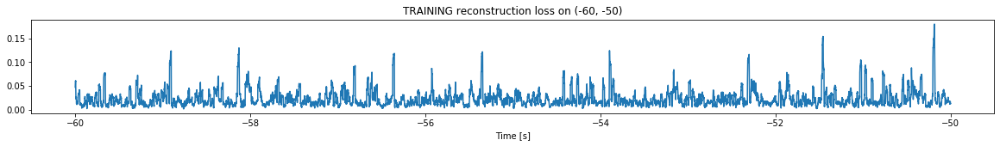

Finished training, median of the log(loss) is:  -1.7315040808860052
Triggering for section:  (-50, -40)
Using this median for triggering: -1.7540199597039727


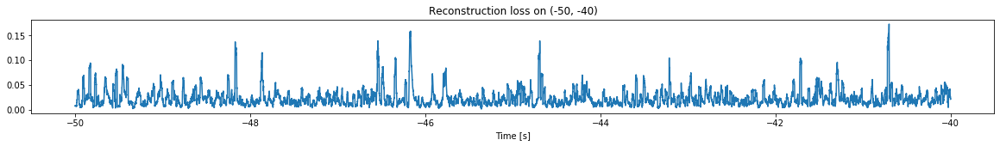

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


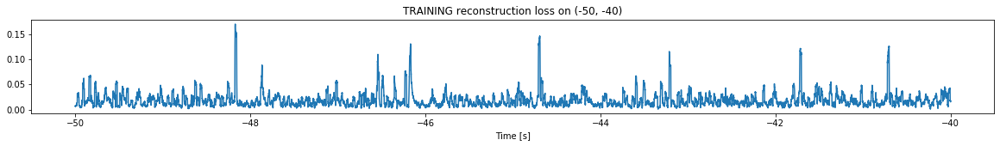

Finished training, median of the log(loss) is:  -1.8125325218929182
Triggering for section:  (-40, -30)
Using this median for triggering: -1.7315040808860052


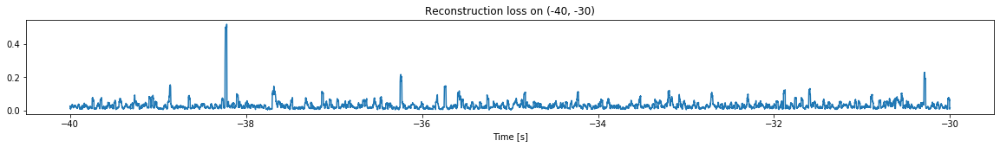

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


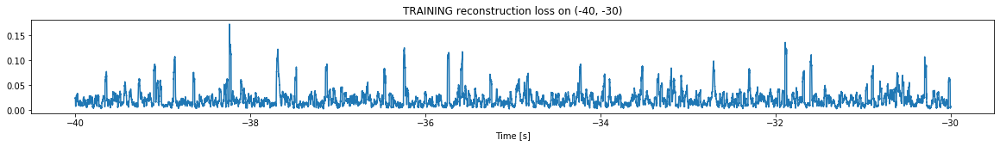

Finished training, median of the log(loss) is:  -1.7425858269489827
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8125325218929182


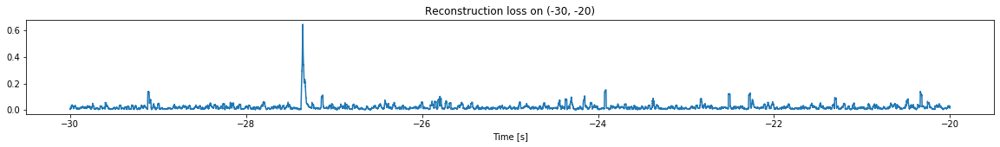

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


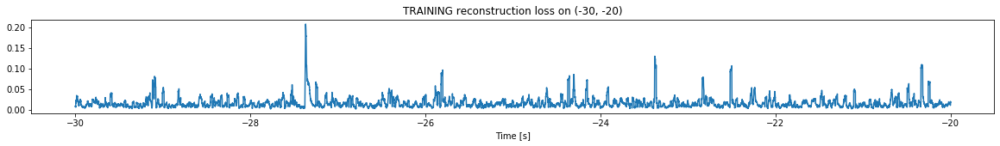

Finished training, median of the log(loss) is:  -1.896296656046546
Triggering for section:  (-20, -10)
Using this median for triggering: -1.7425858269489827


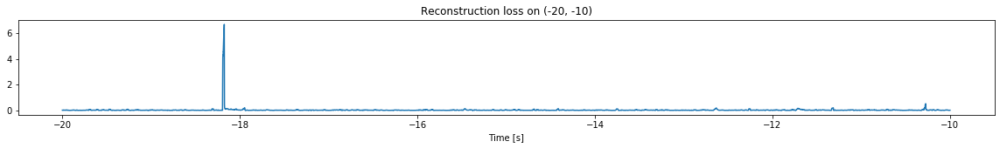

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


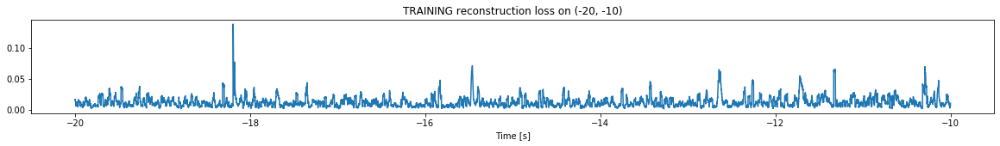

Finished training, median of the log(loss) is:  -1.981213766569529
Triggering for section:  (-10, 0)
Using this median for triggering: -1.896296656046546


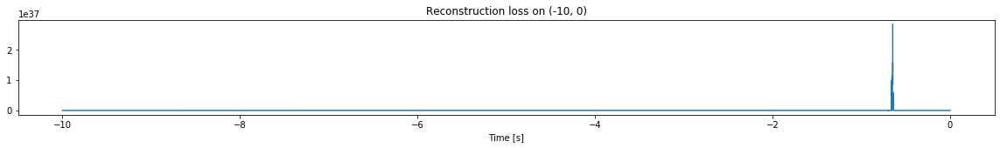

/uscms_data/d3/dhoang/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:274: RuntimeWarning: invalid value encountered in greater


Other trigger time:  [-0.696  -0.0056]
Their log loss values are:  [36.99371015  5.21927499]


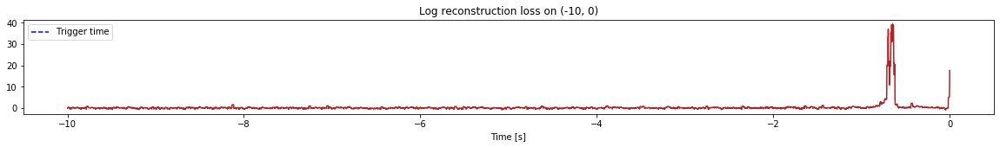

Triggered at:  [-0.696, -0.0056]
<--------
Finished simulation, all the triggered times are:  [-0.696, -0.0056]


In [19]:
#1.0013 constant
simulation("./data/Ramp22/", 10, (-100,0))

--------

-----------

In [28]:
def load_sensor(dir_path, sensor, time_range = None):
    
    data = pd.DataFrame(data = {sensor: np.load(dir_path + sensor + ".npy"),
                                "time": np.load(dir_path + "time.npy")})
    
    start = min(data["time"])
    end = max(data["time"])
    
    if time_range:
        start = time_range[0]
        end = time_range[1]
    
    
    data = data[(data["time"] > start) & (data["time"] < end)]
   
    %reset -f in
    
    return data[sensor]

def load_time_label(dir_path, time_range, window = 2000, step = 10):
    
    time_label =  np.load(dir_path + "time.npy")
    
    start = min(time_label)
    end = max(time_label)
    
    if time_range:
        start = time_range[0]
        end = time_range[1]
    
    
    time_label = time_label[(time_label > start) & (time_label < end)][window-1::step]
    
    %reset -f in
    
    return time_label

#### Mean of abs(signal)
def generate_mean_data(dir_path, time_range, window = 2000, step = 10):
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    
    #Calculate the product
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_mean = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_mean

#### SD of signal
def generate_sd_data(dir_path, time_range, window = 2000, step = 10):
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    
    #Calculate the product
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_sd = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_sd

#### Thresholded zero crossings
def zero_crossings(array):
    
    #Set values outside of range (0.001, 0.1) = 0
    array[abs(array) > 0.1] = 0
    array[abs(array) < 0.005] = 0
    
    #Calculate number of zero-crossing points, normalized by the window size
    zero_crossings = ((array[:-1] * array[1:]) < 0).sum()/array.size
    
    return zero_crossings


def generate_crossings_data(dir_path, time_range = None, window = 5000, step = 10):
    
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_crossings = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_crossings

def load_thres_product(dir_path, time_range):
    #load time axis
    time_axis = load_time_label(dir_path, time_range = (-200,0), window = 25000, step = 10)
    
    #Load data
    product_data = np.load(dir_path+"cross-product.npy")
    
    #return the data in time_range
    selection_index = (time_axis > time_range[0]) & (time_axis < time_range[1]) 
    %reset -f in
    
    return product_data[selection_index][:, np.newaxis]


def generate_data(dir_path, time_range, window = 2000, step = 10):
    
    #Selection index due to using different window
    #selection_index = int((thres_win - window)/step)
    
    moving_mean = generate_mean_data(dir_path, time_range, window = window, step = step) ##!!!!!! CAREFUL
    moving_sd = generate_sd_data(dir_path, time_range, window = window, step = step)
    time_label = load_time_label(dir_path, time_range, window = window, step = step)
    moving_thres_crossings = load_thres_product(dir_path, time_range = (time_label.min() - 1e-4, time_label.max()))
    
    
    all_data = np.concatenate((moving_mean, moving_sd, moving_thres_crossings**2.3), axis = 1)
    
    print("All data's shape: ", all_data.shape)
    
    plt.figure(figsize=(20,2))
    plt.plot(all_data[:,12])
    
    %reset -f in
    
    return all_data, time_label

#####-------INCREMENTAL LEARNING IMPLEMENTATION-------######

def create_model():
    
    #================BUILD THE MODEL====================
    # Simple model
    # Simple model
    model = models.Sequential()

    model.add(Dense(6, activation = 'elu', kernel_initializer='glorot_uniform',
                    kernel_regularizer=regularizers.l2(0.0),
                    input_dim=13))

    model.add(Dense(3,activation='elu',
                    kernel_initializer='glorot_uniform'))

    model.add(Dense(6,activation='elu',
                    kernel_initializer='glorot_uniform'))

    model.add(Dense(13,
                    kernel_initializer='glorot_uniform'))

    model.compile(loss='mse',optimizer='adam')


    return model

def train(current_weights, X, time_axis, time_range):
    """Take a model, train it in the appropritate time range, return the new weights
    and its reconstruction loss distribution"""
    
    print("Training for section: ", time_range)
    #Select the appropriate time
    start_index = None
    
    if time_range[0] is not None:
        start_index = np.argmax(time_axis > time_range[0])
    else:
        start_index = 0
    
    if time_range[1] == 0:
        end_index = None
    else:
        end_index = np.argmax(time_axis > time_range[1])
    
    X_train = np.copy(X[start_index:end_index])
    time_train = time_axis[start_index:end_index]
    
    #Create model
    model = create_model()
    
    if current_weights:
        model.set_weights(current_weights)
    
    #Scaler initiation
    scaler = MinMaxScaler()
    scaler.fit(X_train)
    X_train = scaler.transform(X_train)
    
    X_train[:,12] = X_train[:,12]*12 #More importance in product of zero-crossings
    
    #Train the model and extract new weights
    model.fit(X_train, X_train,
              batch_size=2000,
              epochs=30, verbose = 0)
    
    new_weights = model.get_weights()
    
    #Evaluate the losses and update the distribution
    X_pred = model.predict(X_train)
    loss = np.mean(np.abs(X_pred-X_train), axis = 1)
    
    #Plot the reconstruction loss
    plt.figure(figsize=(20,2))
    plt.plot(time_train, loss)
    plt.title("TRAINING reconstruction loss on {}".format(time_range))
    plt.xlabel("Time [s]")
    plt.show()
    
    #Take the mean of the log loss and update the mean threshold
    current_median = np.median(np.log10(loss))
    
    print("Finished training, median of the log(loss) is: ", current_median)
    
    return new_weights, current_median, scaler

def trigger(current_weights, X, time_axis, time_range, prev_median, scaler):
    
    print("Triggering for section: ", time_range)
    print("Using this median for triggering:", prev_median)
    
    #Select the appropriate time
    start_index = None
    
    if time_range[0] is not None:
        start_index = np.argmax(time_axis > time_range[0])
    else:
        start_index = 0
    
    if time_range[1] == 0:
        end_index = None
    else:
        end_index = np.argmax(time_axis > time_range[1])
    
    time_test = time_axis[start_index:end_index]
    X_test = np.copy(X[start_index:end_index])
    
    X_test = scaler.transform(X_test) #Scale the current data
    X_test[:,12] = X_test[:,12]*12 #Put more importance on the product of zero crossings
    
    #Create model
    model = create_model()
    model.set_weights(current_weights)
        
    #Find the test loss (doing this in parallel for the sake of simulation), but in a practical system
    #Ideally we need to do inference every single data point come in
    X_pred_test = model.predict(X_test)
    test_loss = np.mean(np.abs(X_pred_test-X_test), axis = 1)
    
    
    #Plot the reconstruction loss just to check
    plt.figure(figsize=(20,2))
    plt.plot(time_test, test_loss)
    plt.title("Reconstruction loss on {}".format(time_range))
    plt.xlabel("Time [s]")
    plt.show()
    
    #Quantify how much each data point is far away from the distribution
    log_test_loss = np.log10(test_loss) - prev_median
    
    #Find the trigger time
    trigger_index = np.argmax(log_test_loss > 3.3)
    
    if  trigger_index != 0:
        #Plot the triggered time
        plt.figure(figsize=(20,2))
        plt.plot(time_test, log_test_loss, color = "firebrick")
        plt.title("Log reconstruction loss on {}".format(time_range))
        plt.xlabel("Time [s]")
        
        #Trigger time
        plt.vlines(time_test[trigger_index], log_test_loss.min(), log_test_loss.max(), color = "blue", linestyles = "dashed", label = "Trigger time")
        plt.legend(loc = "upper left")
        
        
        ### Find trigger times
        peaks, _ = find_peaks(log_test_loss, height=3.3, distance = 5000)
        print("Other trigger time: ", time_test[peaks])
        print("Their log loss values are: ", log_test_loss[peaks])
        
        for i in range(len(peaks)):
            plt.vlines(time_test[peaks[i]], log_test_loss.min(), log_test_loss.max(), color = "blue", linestyles = "dashed")
            
        plt.show()
        
        return list(time_test[peaks])
    
    else:
        return None
    

def simulation(dir_path, section_size, time_range):
    
    #Load data and create the model
    X, time_axis = generate_data(dir_path, time_range = time_range, window = 2000, step = 10)
    
    #For updating model
    current_weights = None
    new_weights = None
    
    #For keeping track of distribution history
    prev_median = None
    updated_median = None
    
    #Keeping track of scaler after training
    past_scaler = None
    
    #Calculate number of sections
    num_section = int(abs(time_range[0])/section_size)
    print("Number of sections:", num_section)
    
    #Keeping log of all the trigger time
    trigger_log = []
    
    #Sequentially go through the data
    for i in range(num_section):
        
        print("Entering sections: ", (-section_size*(num_section - i), -section_size*(num_section - i - 1)))
        print("-------->")
        
        if i == 0:
            continue
        elif i == 1:
            #Train on the first segment
            time_range = (None, -section_size*(num_section - i))
            new_weights, updated_median, new_scaler = train(current_weights, X, time_axis, time_range)
        else:
            
            #Set previous distrubution to the newly trained disttribution
            prev_median = updated_median
            current_scaler = new_scaler
            current_weights = new_weights
            
            #Selecting appropriate time range for training and triggering
            train_time_range = (-section_size*(num_section - i + 1), -section_size*(num_section - i))
            trigger_time_range = (-section_size*(num_section - i), -section_size*(num_section - i - 1))
            
            #Train and predict simutaneously
            new_weights, updated_median, new_scaler = train(current_weights, X, time_axis, train_time_range)
            trigger_time = trigger(current_weights, X, time_axis, trigger_time_range, prev_median, current_scaler)
            
            if trigger_time is not None:
                print("Triggered at: ", trigger_time)
                trigger_log.extend(trigger_time)
        
        print("<--------")
        
    print("Finished simulation, all the triggered times are: ", trigger_log)

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (899800, 13)
Flushing input history
Number of sections: 9
Entering sections:  (-90, -80)
-------->
Entering sections:  (-80, -70)
-------->
Training for section:  (None, -80)


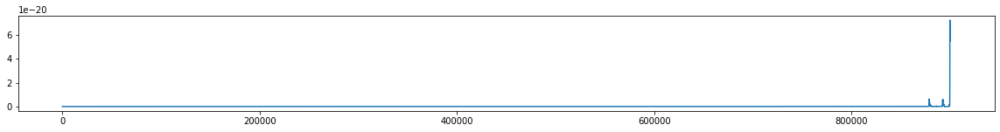

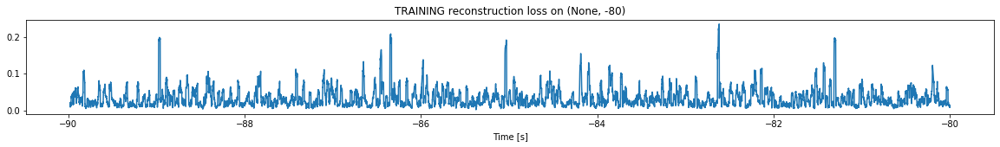

Finished training, median of the log(loss) is:  -1.5713189223377528
<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


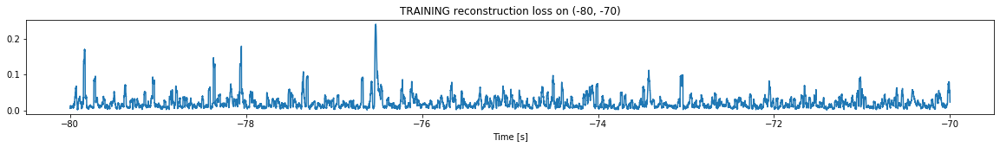

Finished training, median of the log(loss) is:  -1.7781712919362875
Triggering for section:  (-70, -60)
Using this median for triggering: -1.5713189223377528


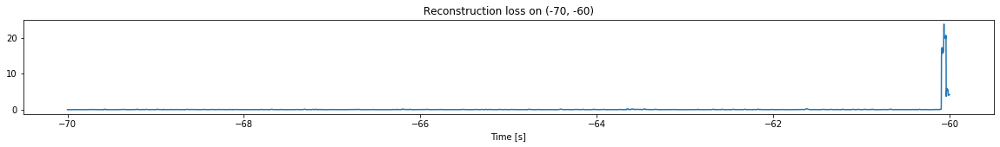

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


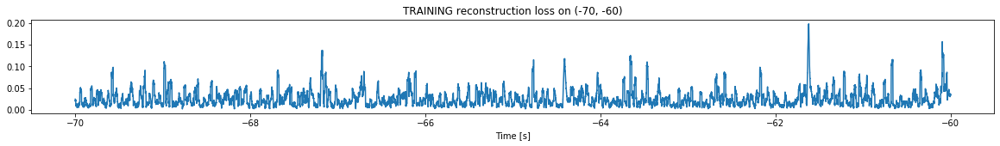

Finished training, median of the log(loss) is:  -1.6780691834787236
Triggering for section:  (-60, -50)
Using this median for triggering: -1.7781712919362875


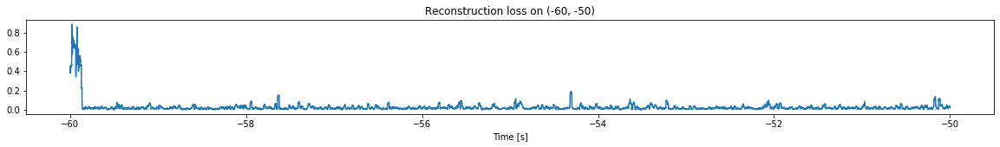

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


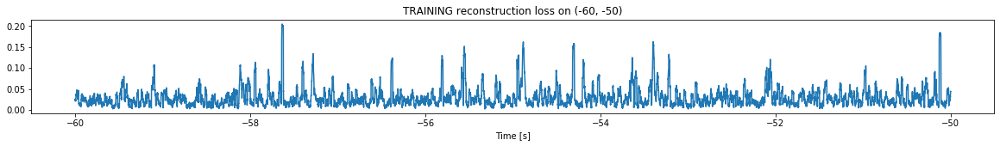

Finished training, median of the log(loss) is:  -1.6181672110588847
Triggering for section:  (-50, -40)
Using this median for triggering: -1.6780691834787236


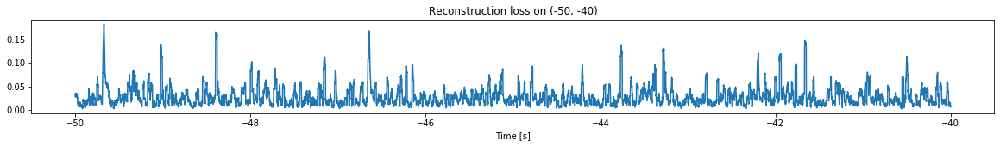

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


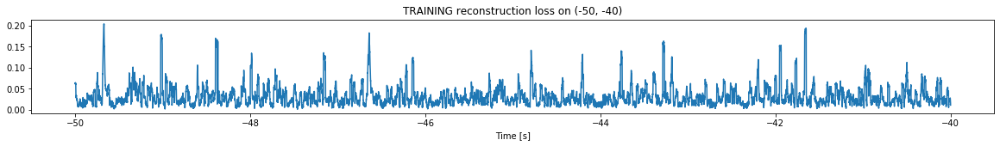

Finished training, median of the log(loss) is:  -1.5821845500012564
Triggering for section:  (-40, -30)
Using this median for triggering: -1.6181672110588847


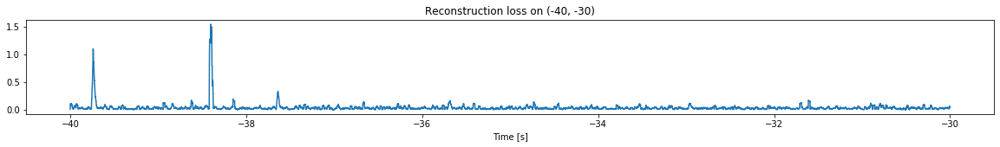

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


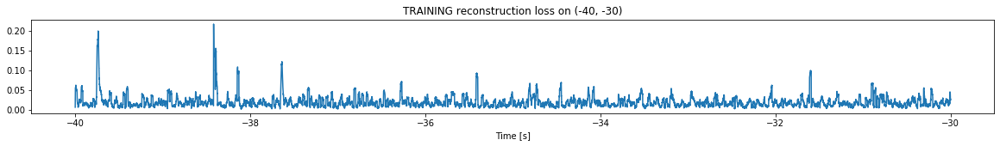

Finished training, median of the log(loss) is:  -1.7987373149812358
Triggering for section:  (-30, -20)
Using this median for triggering: -1.5821845500012564


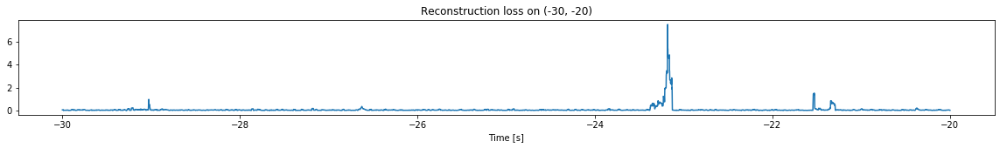

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


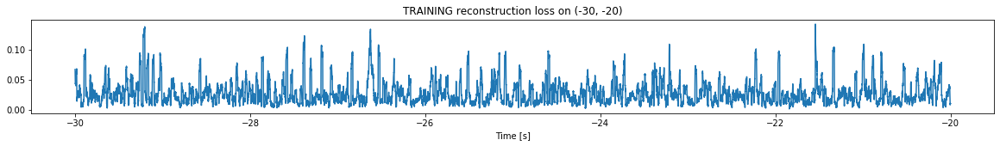

Finished training, median of the log(loss) is:  -1.638065088336539
Triggering for section:  (-20, -10)
Using this median for triggering: -1.7987373149812358


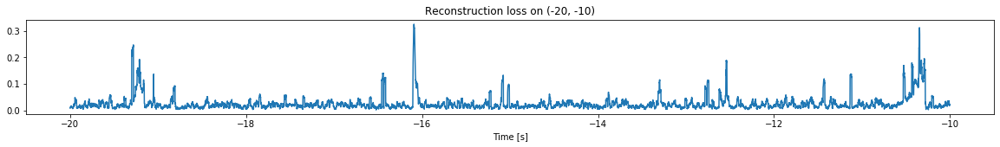

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


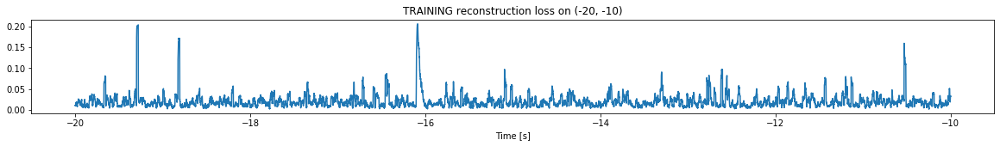

Finished training, median of the log(loss) is:  -1.7589088208592556
Triggering for section:  (-10, 0)
Using this median for triggering: -1.638065088336539


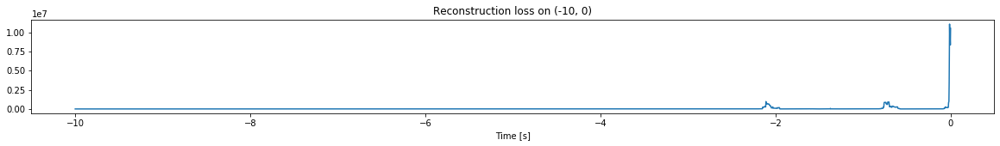

Other trigger time:  [-4.2953    -3.6724    -2.8834999 -2.1095    -1.3736    -0.7039
 -0.0115   ]
Their log loss values are:  [3.98869811 3.77499182 5.20121478 7.6255715  6.50684932 7.59857277
 8.68357477]


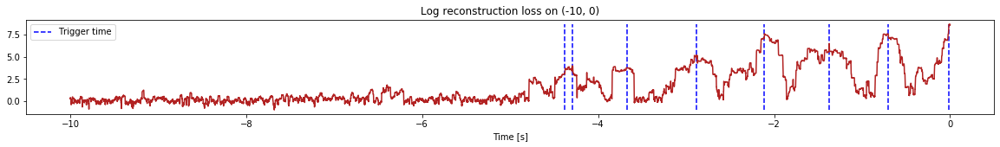

Triggered at:  [-4.2953, -3.6724, -2.8834999, -2.1095, -1.3736, -0.7039, -0.0115]
<--------
Finished simulation, all the triggered times are:  [-4.2953, -3.6724, -2.8834999, -2.1095, -1.3736, -0.7039, -0.0115]


In [32]:
simulation("./data/Ramp4/", 10, (-90,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (899800, 13)
Flushing input history
Number of sections: 9
Entering sections:  (-90, -80)
-------->
Entering sections:  (-80, -70)
-------->
Training for section:  (None, -80)


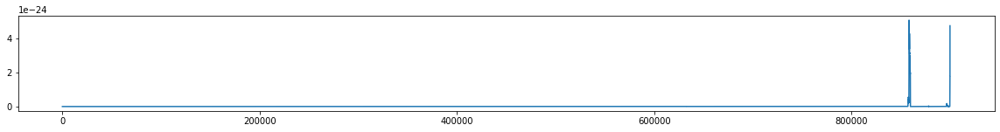

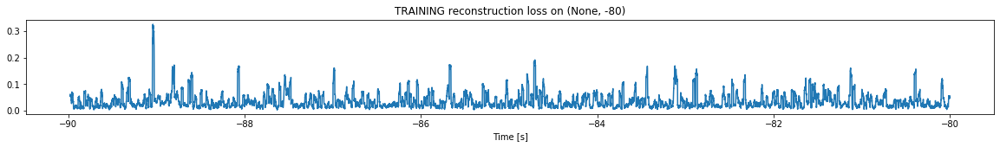

Finished training, median of the log(loss) is:  -1.5470462700735845
<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


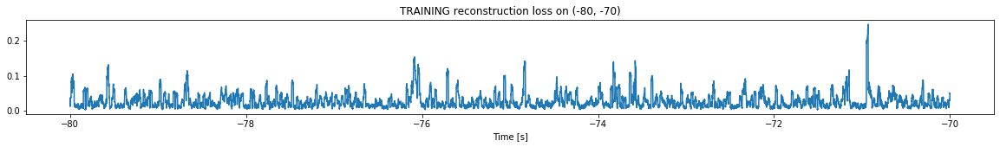

Finished training, median of the log(loss) is:  -1.666067789281297
Triggering for section:  (-70, -60)
Using this median for triggering: -1.5470462700735845


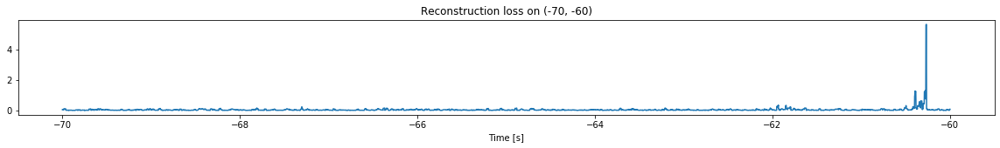

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


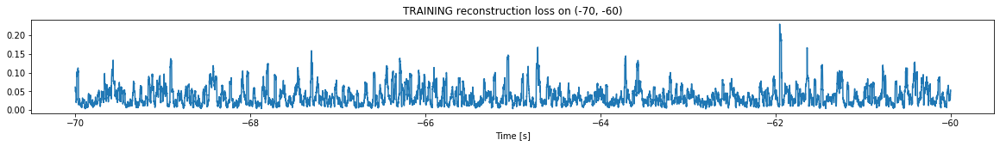

Finished training, median of the log(loss) is:  -1.5107205861630002
Triggering for section:  (-60, -50)
Using this median for triggering: -1.666067789281297


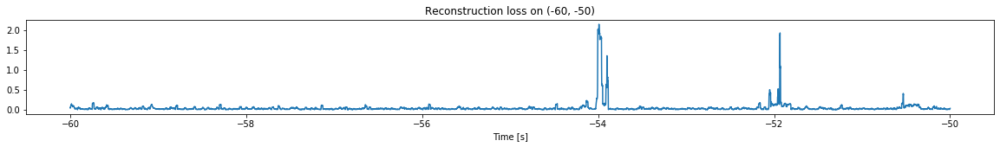

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


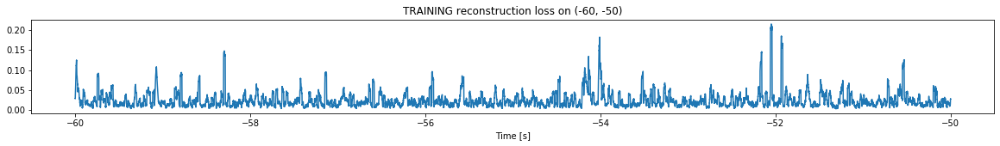

Finished training, median of the log(loss) is:  -1.7228557707702374
Triggering for section:  (-50, -40)
Using this median for triggering: -1.5107205861630002


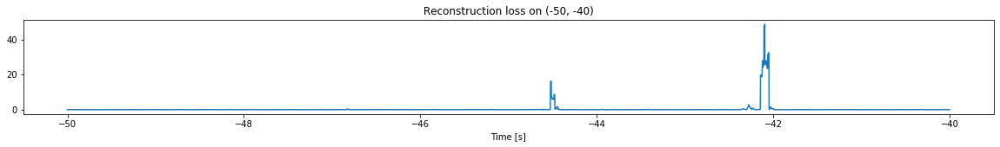

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


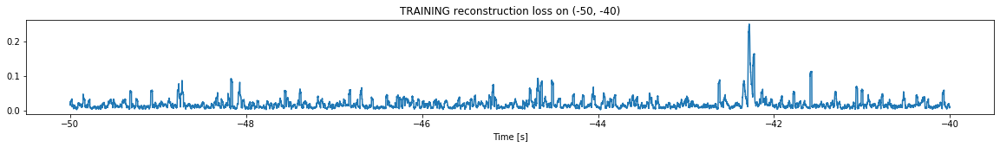

Finished training, median of the log(loss) is:  -1.8356954787070583
Triggering for section:  (-40, -30)
Using this median for triggering: -1.7228557707702374


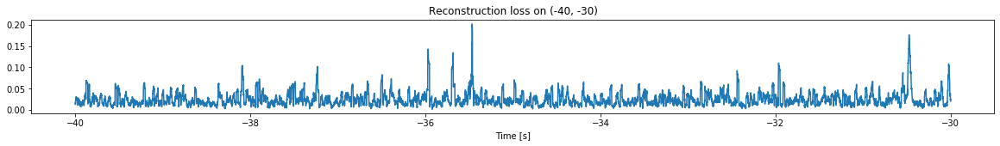

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


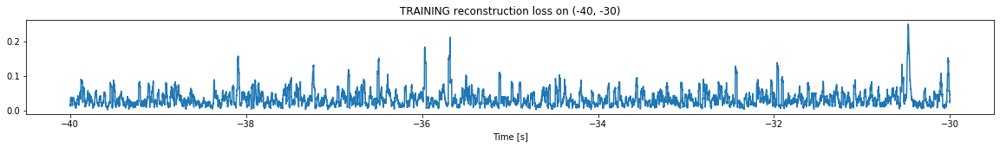

Finished training, median of the log(loss) is:  -1.524116555423643
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8356954787070583


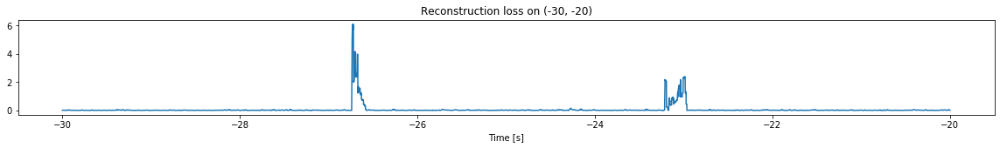

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


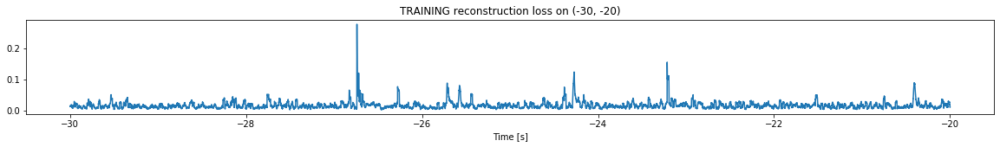

Finished training, median of the log(loss) is:  -1.8654602647960234
Triggering for section:  (-20, -10)
Using this median for triggering: -1.524116555423643


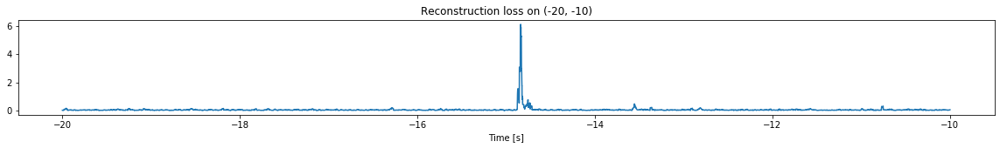

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


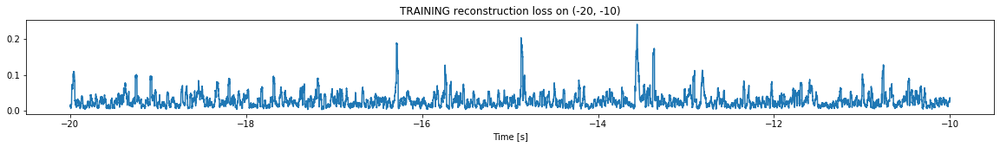

Finished training, median of the log(loss) is:  -1.6076300348354486
Triggering for section:  (-10, 0)
Using this median for triggering: -1.8654602647960234


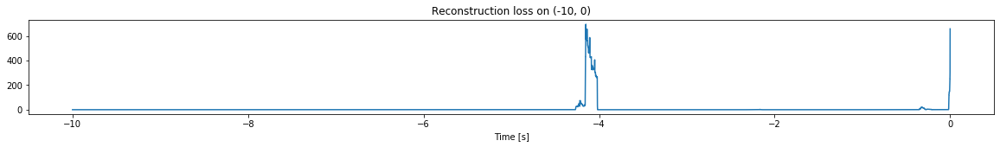

Other trigger time:  [-4.1503997]
Their log loss values are:  [4.7081243]


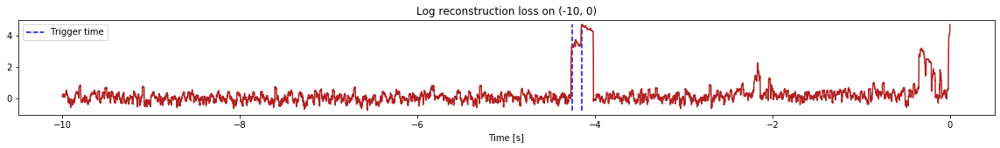

Triggered at:  [-4.1503997]
<--------
Finished simulation, all the triggered times are:  [-4.1503997]


In [33]:
simulation("./data/Ramp5/", 10, (-90,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (999800, 13)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


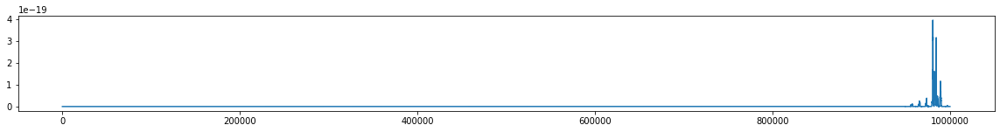

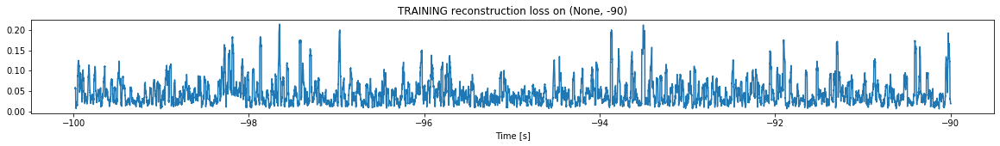

Finished training, median of the log(loss) is:  -1.4261154371084999
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


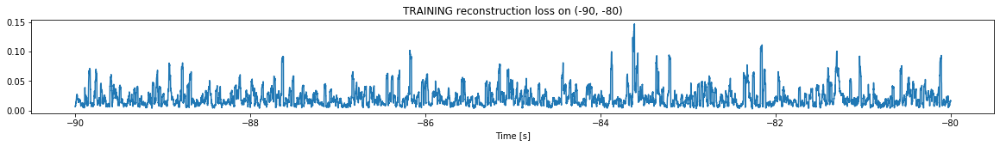

Finished training, median of the log(loss) is:  -1.7506106326587856
Triggering for section:  (-80, -70)
Using this median for triggering: -1.4261154371084999


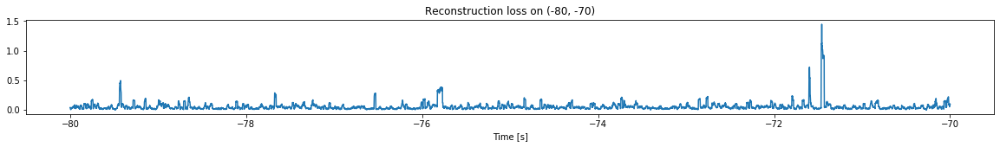

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


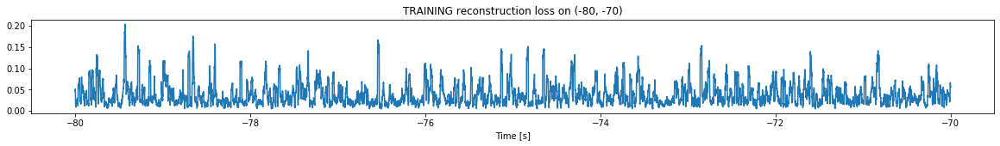

Finished training, median of the log(loss) is:  -1.5068225823447305
Triggering for section:  (-70, -60)
Using this median for triggering: -1.7506106326587856


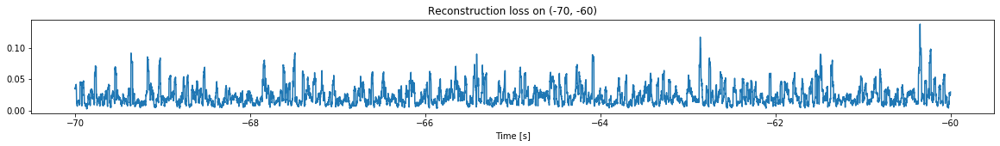

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


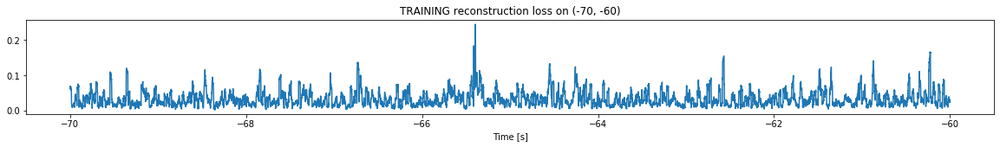

Finished training, median of the log(loss) is:  -1.5404525452113895
Triggering for section:  (-60, -50)
Using this median for triggering: -1.5068225823447305


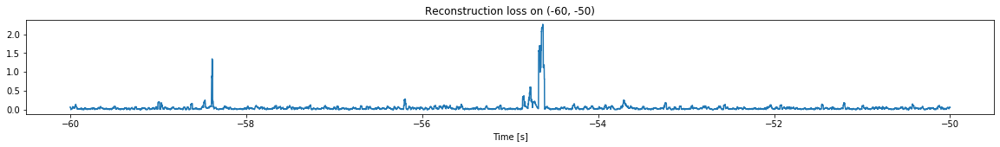

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


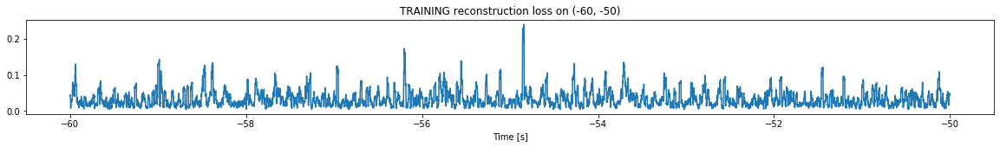

Finished training, median of the log(loss) is:  -1.550350677809062
Triggering for section:  (-50, -40)
Using this median for triggering: -1.5404525452113895


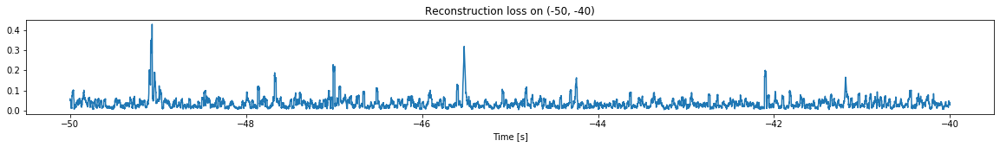

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


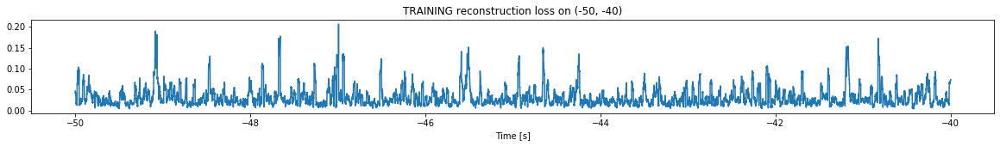

Finished training, median of the log(loss) is:  -1.6010891286318123
Triggering for section:  (-40, -30)
Using this median for triggering: -1.550350677809062


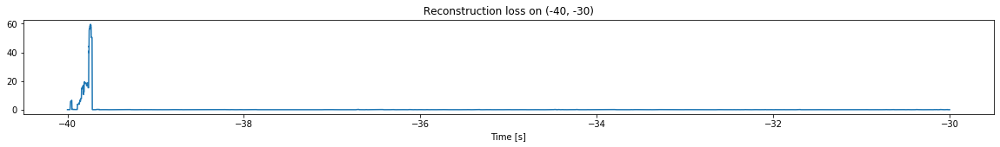

Other trigger time:  [-39.7383]
Their log loss values are:  [3.3258523]


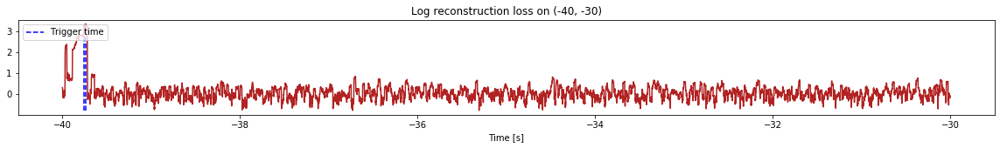

Triggered at:  [-39.7383]
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


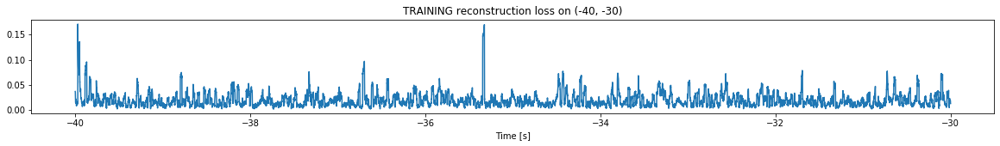

Finished training, median of the log(loss) is:  -1.7802416377016494
Triggering for section:  (-30, -20)
Using this median for triggering: -1.6010891286318123


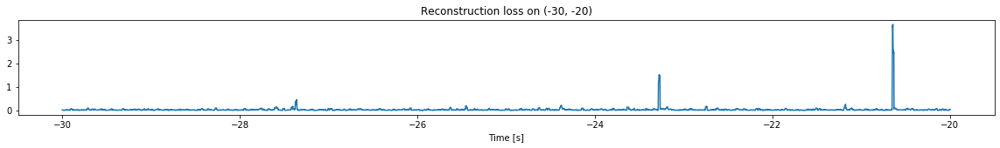

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


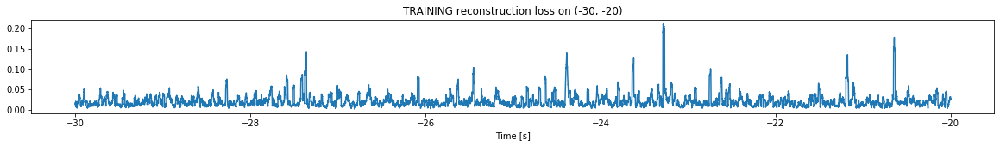

Finished training, median of the log(loss) is:  -1.7494890236036151
Triggering for section:  (-20, -10)
Using this median for triggering: -1.7802416377016494


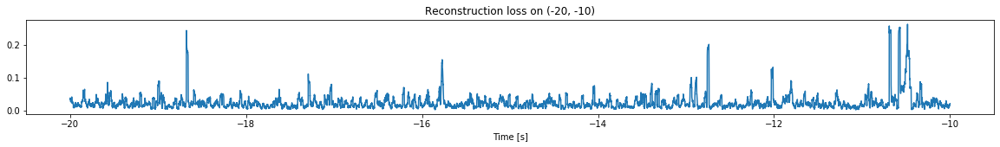

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


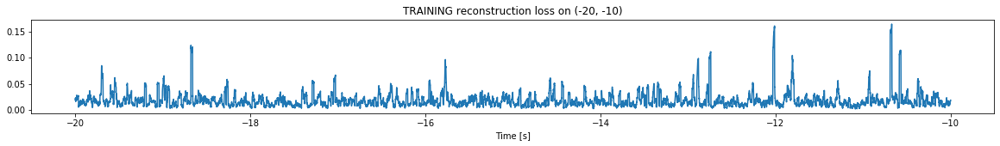

Finished training, median of the log(loss) is:  -1.8259210042337846
Triggering for section:  (-10, 0)
Using this median for triggering: -1.7494890236036151


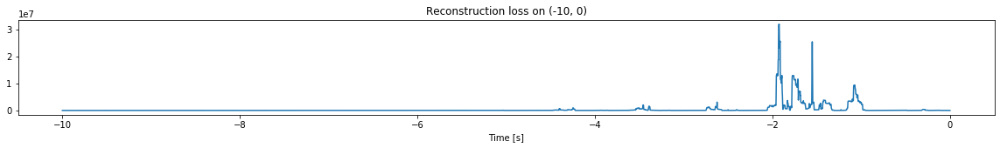

Other trigger time:  [-7.0564    -6.3933997 -5.5516996 -5.0397997 -4.2481    -3.4557998
 -2.6244    -1.9283999 -1.0723    -0.3028   ]
Their log loss values are:  [3.6152841  5.25503252 5.45369229 6.71050602 7.74392046 8.065175
 8.24040083 9.25491866 8.72319078 7.33887875]


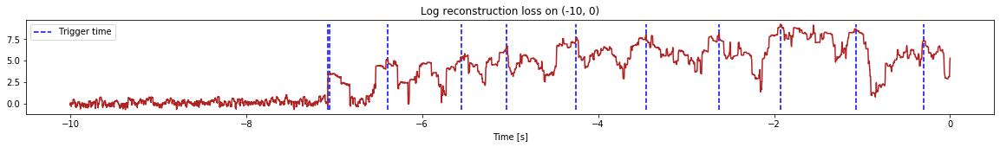

Triggered at:  [-7.0564, -6.3933997, -5.5516996, -5.0397997, -4.2481, -3.4557998, -2.6244, -1.9283999, -1.0723, -0.3028]
<--------
Finished simulation, all the triggered times are:  [-39.7383, -7.0564, -6.3933997, -5.5516996, -5.0397997, -4.2481, -3.4557998, -2.6244, -1.9283999, -1.0723, -0.3028]


In [34]:
simulation("./data/Ramp12d/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1949800, 13)
Flushing input history
Number of sections: 19
Entering sections:  (-190, -180)
-------->
Entering sections:  (-180, -170)
-------->
Training for section:  (None, -180)


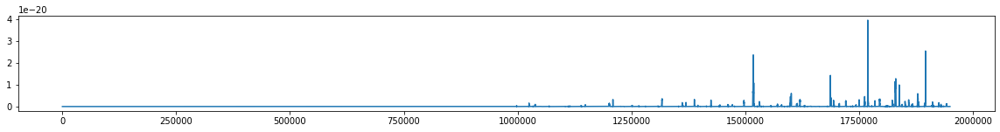

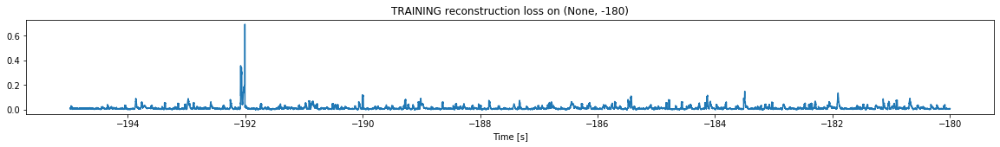

Finished training, median of the log(loss) is:  -1.9677835135715638
<--------
Entering sections:  (-170, -160)
-------->
Training for section:  (-180, -170)


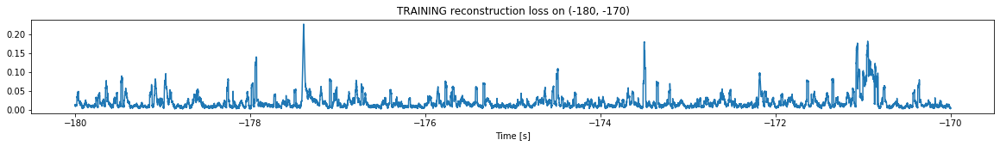

Finished training, median of the log(loss) is:  -1.8308396132180134
Triggering for section:  (-170, -160)
Using this median for triggering: -1.9677835135715638


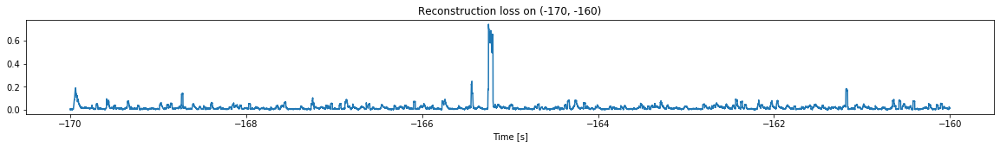

<--------
Entering sections:  (-160, -150)
-------->
Training for section:  (-170, -160)


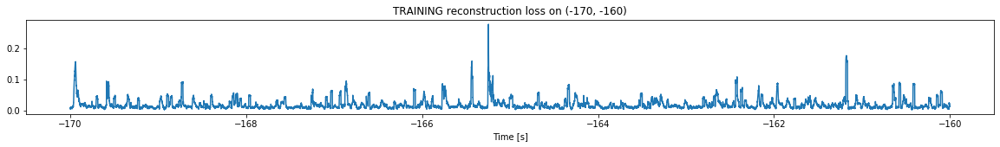

Finished training, median of the log(loss) is:  -1.872662550336375
Triggering for section:  (-160, -150)
Using this median for triggering: -1.8308396132180134


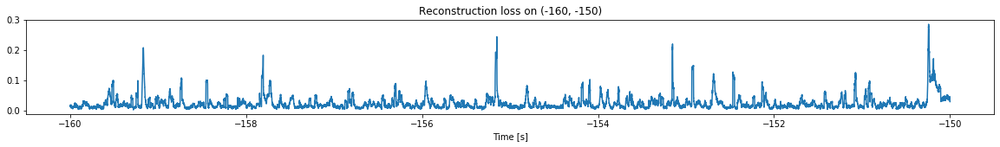

<--------
Entering sections:  (-150, -140)
-------->
Training for section:  (-160, -150)


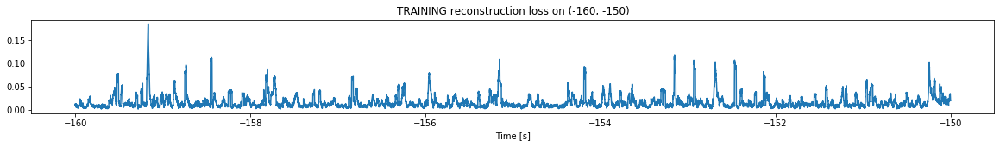

Finished training, median of the log(loss) is:  -1.9054280685607508
Triggering for section:  (-150, -140)
Using this median for triggering: -1.872662550336375


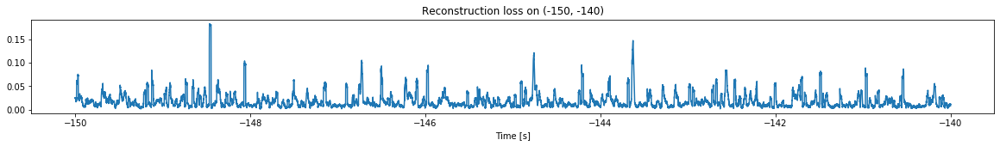

<--------
Entering sections:  (-140, -130)
-------->
Training for section:  (-150, -140)


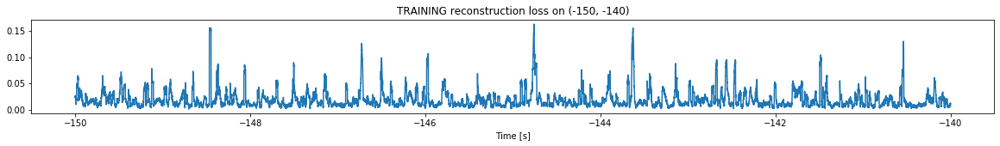

Finished training, median of the log(loss) is:  -1.8447469397646068
Triggering for section:  (-140, -130)
Using this median for triggering: -1.9054280685607508


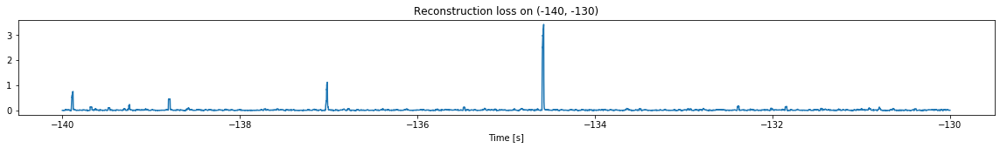

<--------
Entering sections:  (-130, -120)
-------->
Training for section:  (-140, -130)


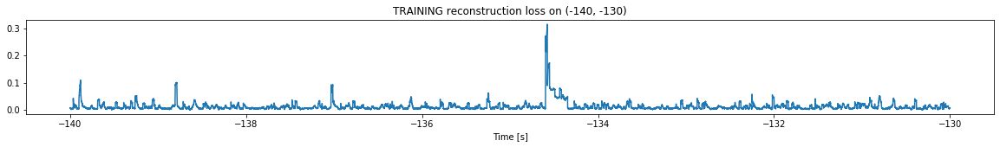

Finished training, median of the log(loss) is:  -2.0596088299978597
Triggering for section:  (-130, -120)
Using this median for triggering: -1.8447469397646068


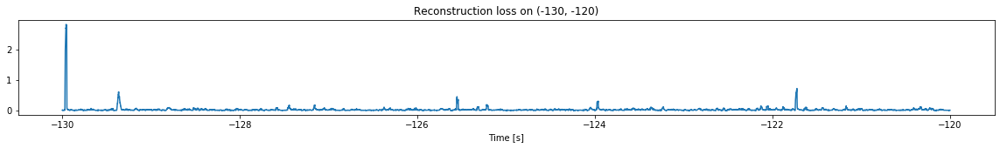

<--------
Entering sections:  (-120, -110)
-------->
Training for section:  (-130, -120)


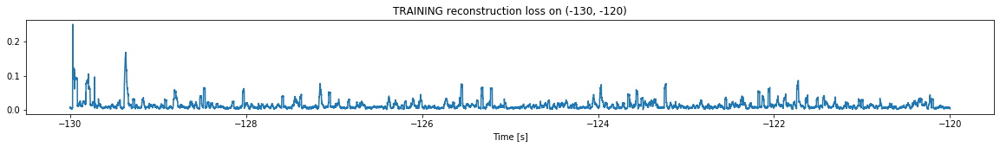

Finished training, median of the log(loss) is:  -1.9840460130148236
Triggering for section:  (-120, -110)
Using this median for triggering: -2.0596088299978597


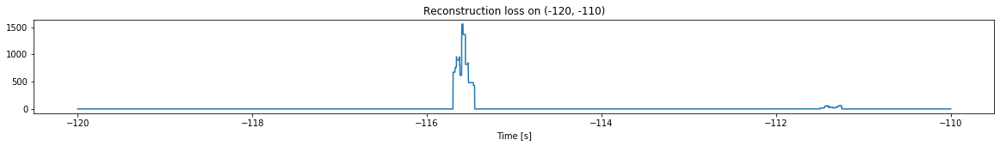

Other trigger time:  [-115.59859 -111.25419]
Their log loss values are:  [5.25181503 3.85517894]


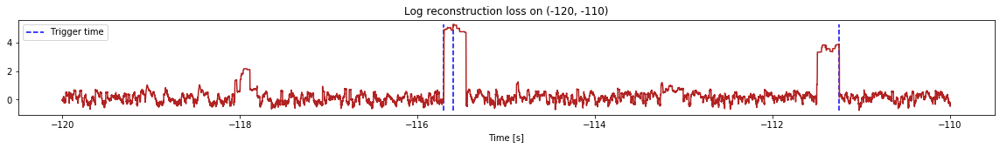

Triggered at:  [-115.59859, -111.25419]
<--------
Entering sections:  (-110, -100)
-------->
Training for section:  (-120, -110)


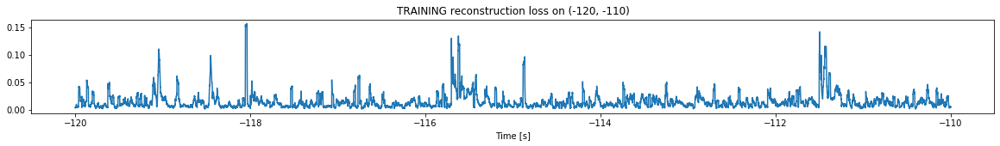

Finished training, median of the log(loss) is:  -1.938985292773383
Triggering for section:  (-110, -100)
Using this median for triggering: -1.9840460130148236


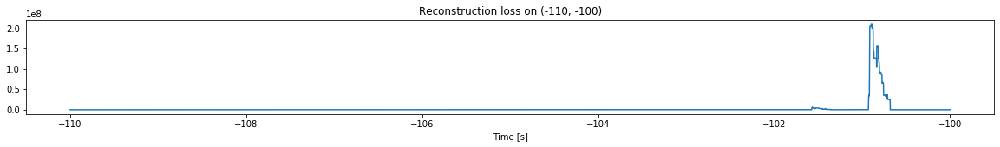

Other trigger time:  [-108.08819  -102.25509  -101.565186 -100.89019  -100.09898 ]
Their log loss values are:  [ 5.1606016   6.87901901  8.78055575 10.30653468  5.78037532]


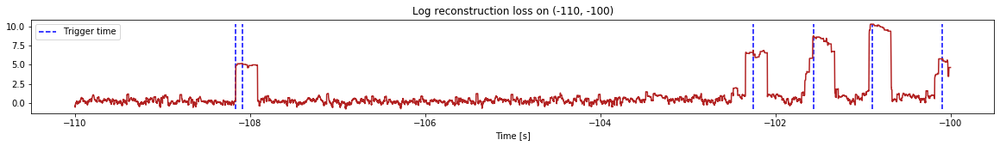

Triggered at:  [-108.08819, -102.25509, -101.565186, -100.89019, -100.09898]
<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


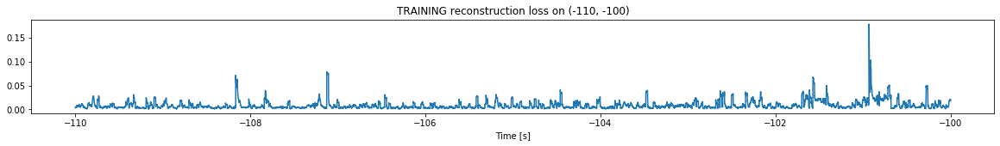

Finished training, median of the log(loss) is:  -2.2281780162044185
Triggering for section:  (-100, -90)
Using this median for triggering: -1.938985292773383


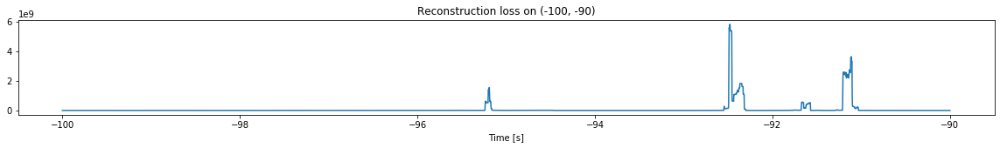

Other trigger time:  [-99.50679  -98.986786 -98.41479  -97.88299  -96.845085 -96.22979
 -95.71519  -95.19009  -94.50299  -93.92869  -93.24849  -92.47909
 -91.66909  -91.11249  -90.178085]
Their log loss values are:  [ 8.14039441  3.73219739  8.01339179  7.5447845   7.28005621  4.69120893
  6.46171432 11.1278773   9.17085836  6.95158618  7.49846126 11.70406867
 10.69018137 11.49955178  7.97514965]


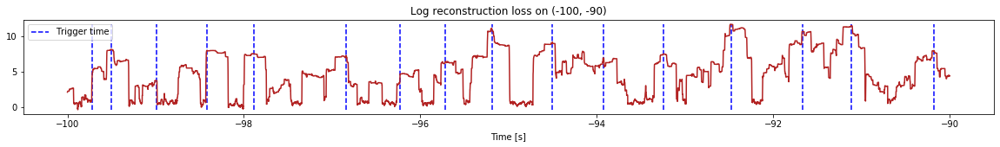

Triggered at:  [-99.50679, -98.986786, -98.41479, -97.88299, -96.845085, -96.22979, -95.71519, -95.19009, -94.50299, -93.92869, -93.24849, -92.47909, -91.66909, -91.11249, -90.178085]
<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


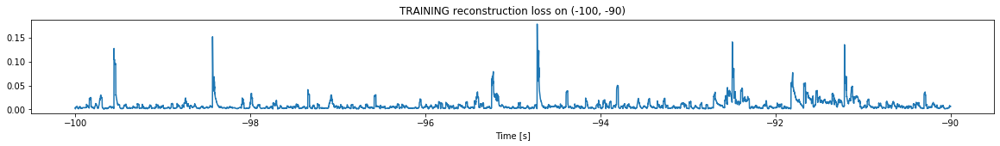

Finished training, median of the log(loss) is:  -2.2812279038383227
Triggering for section:  (-90, -80)
Using this median for triggering: -2.2281780162044185


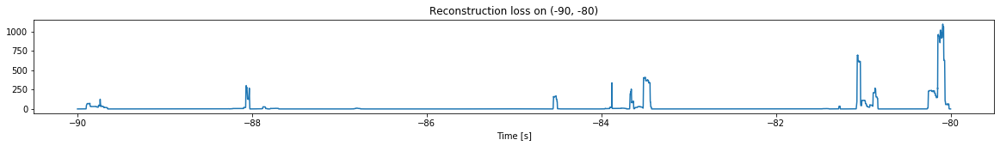

Other trigger time:  [-89.74009  -88.06829  -84.518585 -83.494286 -81.066284 -80.09059 ]
Their log loss values are:  [4.32775084 4.70885578 4.4545963  4.83833165 5.06975572 5.26818879]


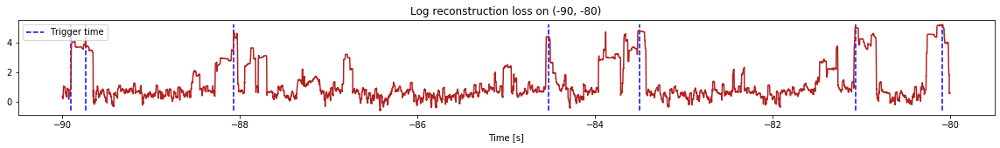

Triggered at:  [-89.74009, -88.06829, -84.518585, -83.494286, -81.066284, -80.09059]
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


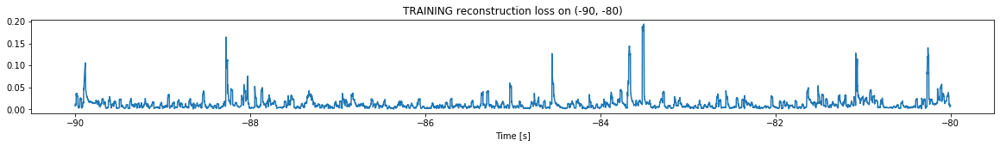

Finished training, median of the log(loss) is:  -2.0423485889461146
Triggering for section:  (-80, -70)
Using this median for triggering: -2.2812279038383227


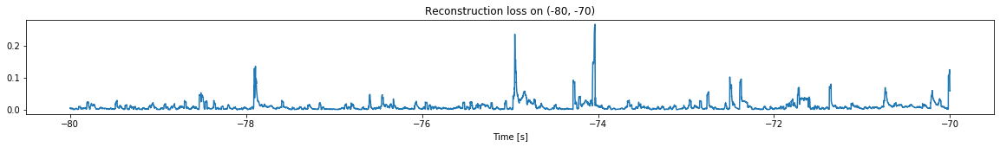

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


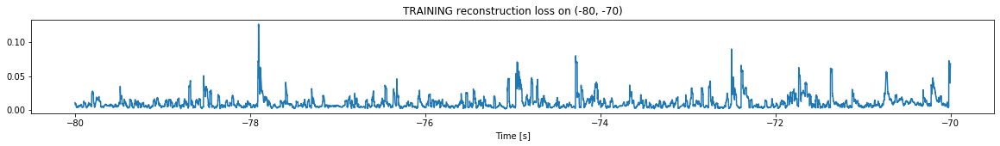

Finished training, median of the log(loss) is:  -2.1215757143922205
Triggering for section:  (-70, -60)
Using this median for triggering: -2.0423485889461146


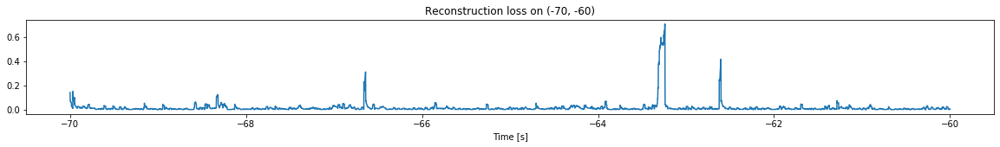

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


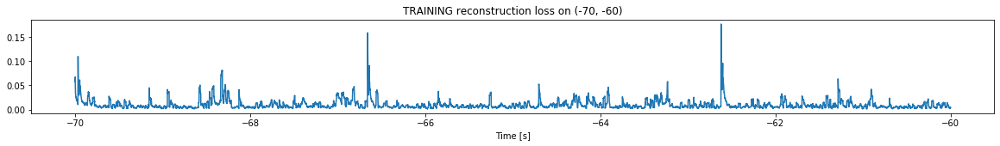

Finished training, median of the log(loss) is:  -2.1420094095300257
Triggering for section:  (-60, -50)
Using this median for triggering: -2.1215757143922205


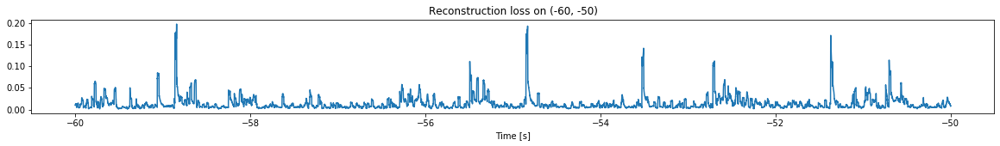

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


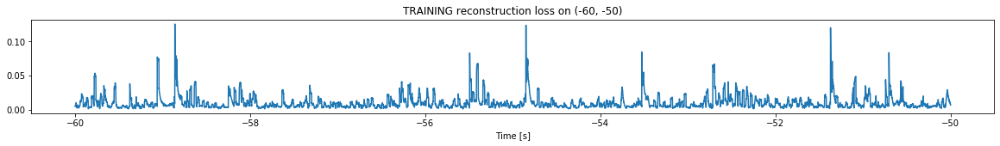

Finished training, median of the log(loss) is:  -2.130577996748176
Triggering for section:  (-50, -40)
Using this median for triggering: -2.1420094095300257


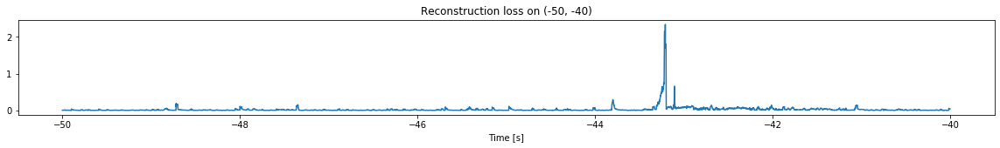

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


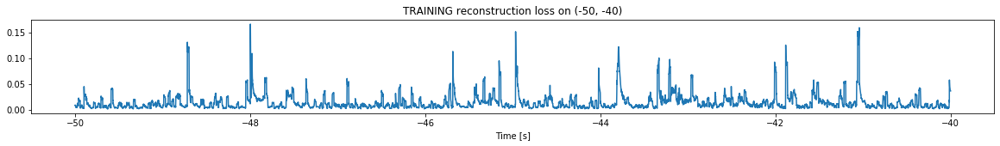

Finished training, median of the log(loss) is:  -2.026435732694965
Triggering for section:  (-40, -30)
Using this median for triggering: -2.130577996748176


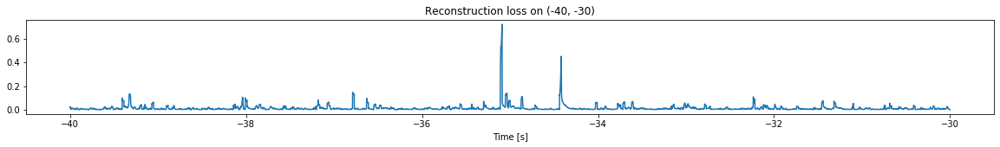

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


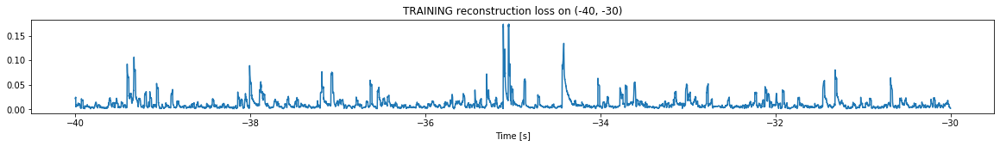

Finished training, median of the log(loss) is:  -2.1070918566954724
Triggering for section:  (-30, -20)
Using this median for triggering: -2.026435732694965


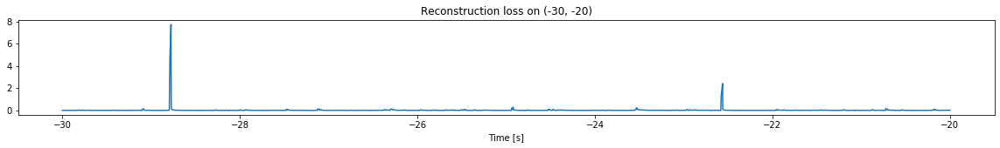

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


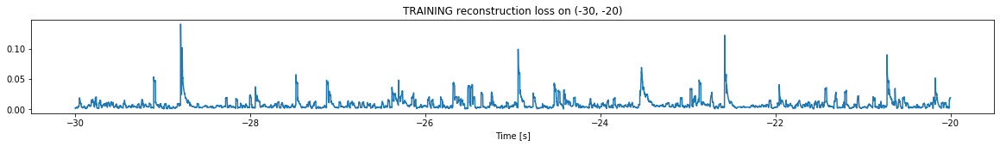

Finished training, median of the log(loss) is:  -2.2425194109441327
Triggering for section:  (-20, -10)
Using this median for triggering: -2.1070918566954724


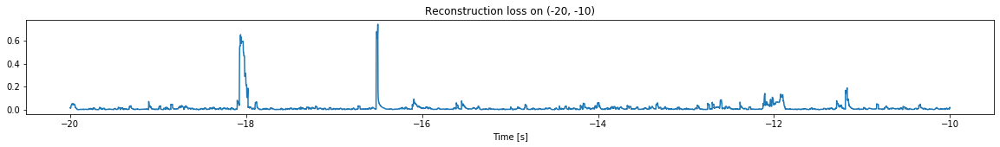

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


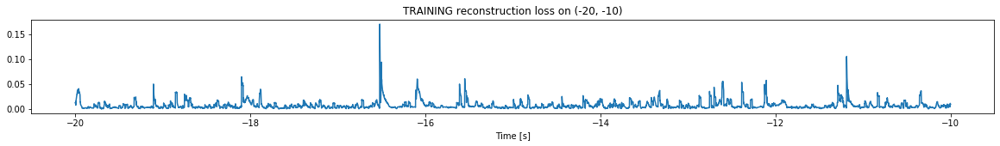

Finished training, median of the log(loss) is:  -2.242902332548087
Triggering for section:  (-10, 0)
Using this median for triggering: -2.2425194109441327


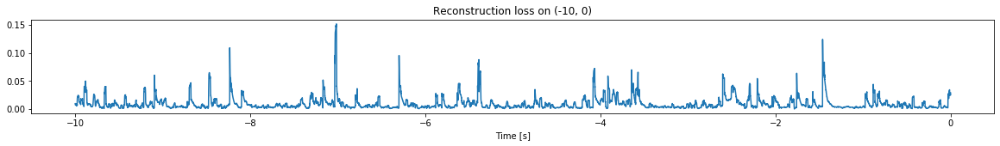

<--------
Finished simulation, all the triggered times are:  [-115.59859, -111.25419, -108.08819, -102.25509, -101.565186, -100.89019, -100.09898, -99.50679, -98.986786, -98.41479, -97.88299, -96.845085, -96.22979, -95.71519, -95.19009, -94.50299, -93.92869, -93.24849, -92.47909, -91.66909, -91.11249, -90.178085, -89.74009, -88.06829, -84.518585, -83.494286, -81.066284, -80.09059]


In [35]:
simulation("./data/Ramp19/", 10, (-195,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1949800, 13)
Flushing input history
Number of sections: 19
Entering sections:  (-190, -180)
-------->
Entering sections:  (-180, -170)
-------->
Training for section:  (None, -180)


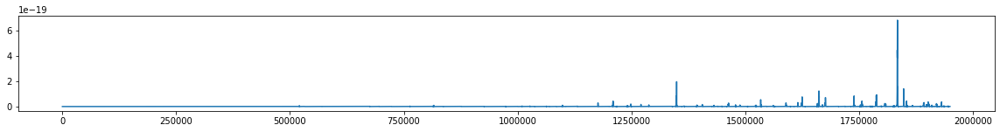

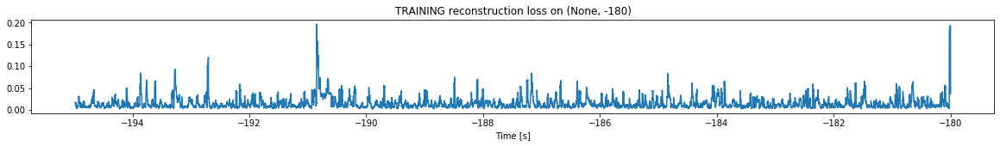

Finished training, median of the log(loss) is:  -1.9624991320241145
<--------
Entering sections:  (-170, -160)
-------->
Training for section:  (-180, -170)


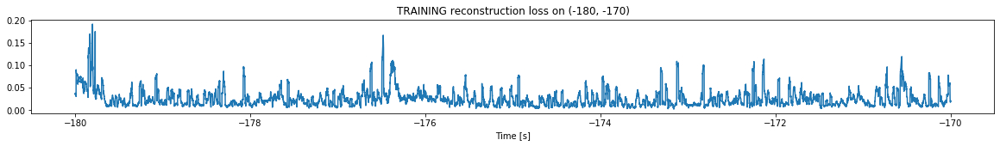

Finished training, median of the log(loss) is:  -1.6692796443256366
Triggering for section:  (-170, -160)
Using this median for triggering: -1.9624991320241145


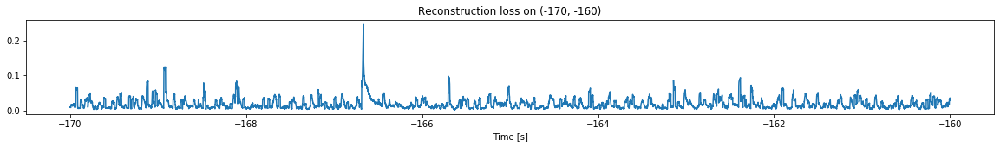

<--------
Entering sections:  (-160, -150)
-------->
Training for section:  (-170, -160)


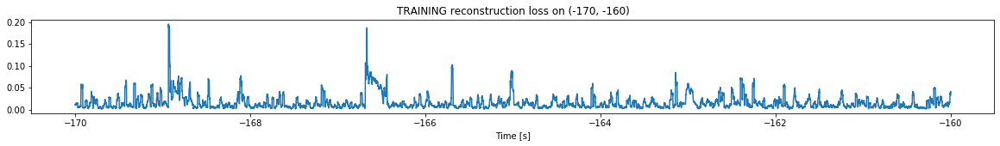

Finished training, median of the log(loss) is:  -1.9469103692767709
Triggering for section:  (-160, -150)
Using this median for triggering: -1.6692796443256366


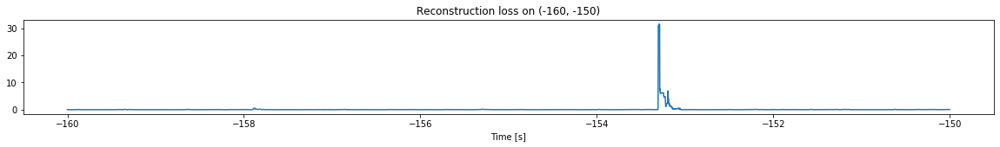

<--------
Entering sections:  (-150, -140)
-------->
Training for section:  (-160, -150)


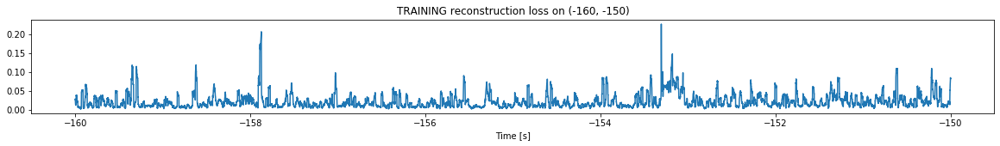

Finished training, median of the log(loss) is:  -1.7866669703204865
Triggering for section:  (-150, -140)
Using this median for triggering: -1.9469103692767709


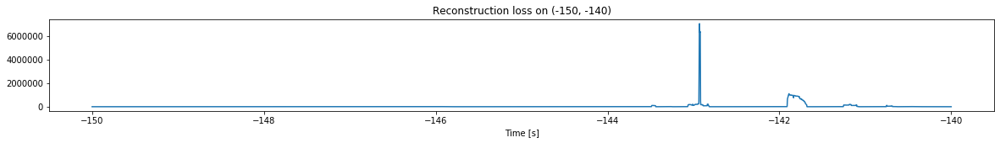

Other trigger time:  [-147.86859 -145.93729 -145.0904  -144.03558 -143.45898 -142.92929
 -142.41599 -141.88719 -141.1856  -140.68428]
Their log loss values are:  [3.92320387 5.88455395 4.13706189 5.1797672  6.98383766 8.79526469
 4.52651534 7.98959336 7.24402289 6.09302506]


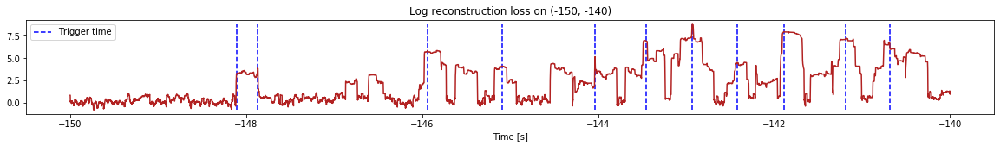

Triggered at:  [-147.86859, -145.93729, -145.0904, -144.03558, -143.45898, -142.92929, -142.41599, -141.88719, -141.1856, -140.68428]
<--------
Entering sections:  (-140, -130)
-------->
Training for section:  (-150, -140)


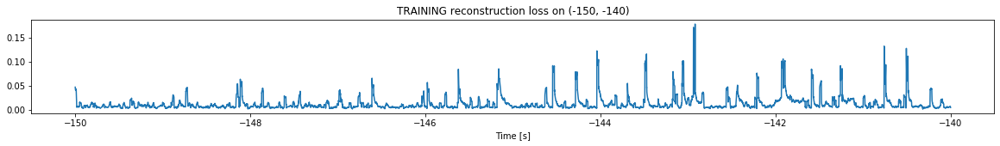

Finished training, median of the log(loss) is:  -2.132893481587482
Triggering for section:  (-140, -130)
Using this median for triggering: -1.7866669703204865


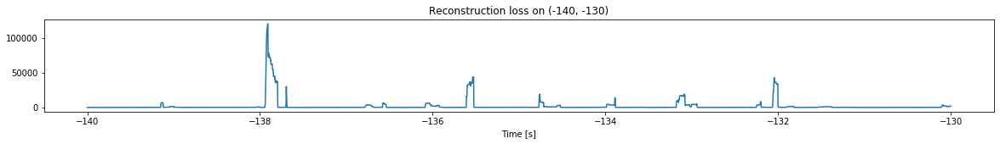

Other trigger time:  [-139.86528 -139.12608 -137.90828 -136.57379 -136.04019 -135.52899
 -134.75859 -133.88799 -133.08559 -132.04239 -131.42918 -130.76549
 -130.09009]
Their log loss values are:  [3.80060405 5.62774189 6.86928618 5.60780874 5.58098396 6.43060909
 6.06923691 5.93318025 6.07411462 6.42089085 4.86661051 3.78446507
 5.34796866]


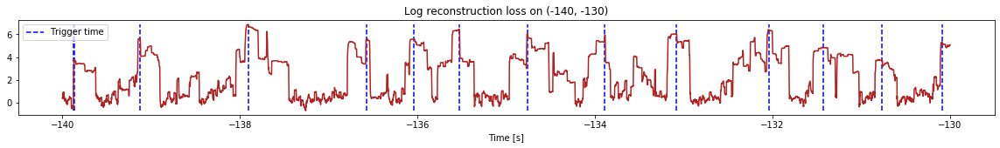

Triggered at:  [-139.86528, -139.12608, -137.90828, -136.57379, -136.04019, -135.52899, -134.75859, -133.88799, -133.08559, -132.04239, -131.42918, -130.76549, -130.09009]
<--------
Entering sections:  (-130, -120)
-------->
Training for section:  (-140, -130)


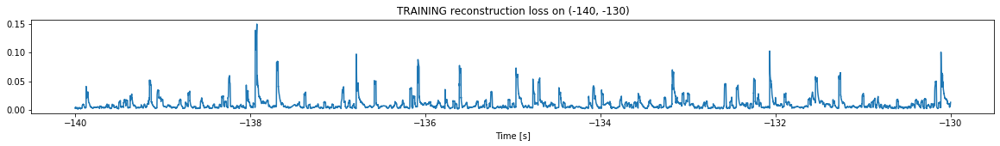

Finished training, median of the log(loss) is:  -2.1999050313558333
Triggering for section:  (-130, -120)
Using this median for triggering: -2.132893481587482


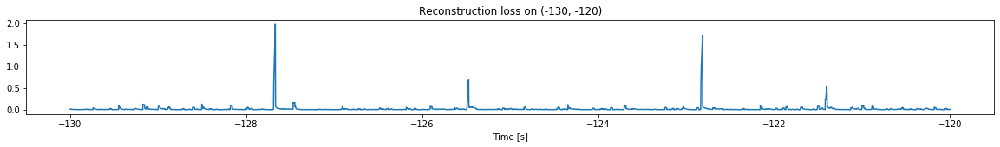

<--------
Entering sections:  (-120, -110)
-------->
Training for section:  (-130, -120)


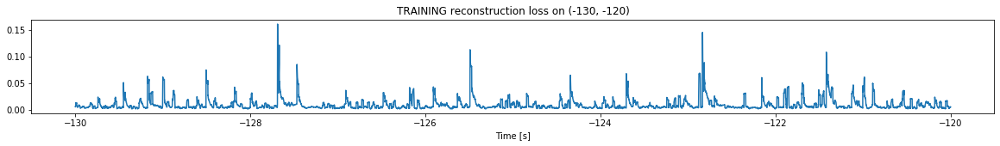

Finished training, median of the log(loss) is:  -2.1989661559438636
Triggering for section:  (-120, -110)
Using this median for triggering: -2.1999050313558333


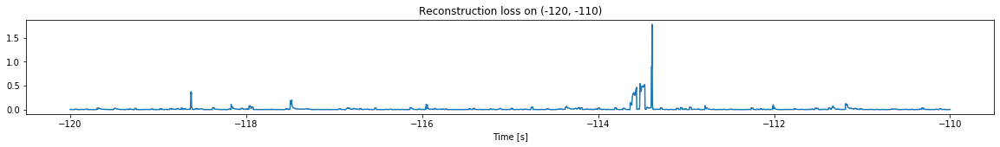

<--------
Entering sections:  (-110, -100)
-------->
Training for section:  (-120, -110)


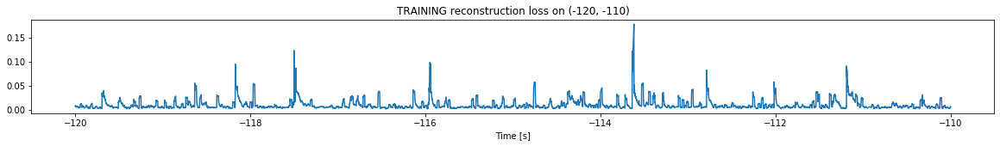

Finished training, median of the log(loss) is:  -2.2065559961799015
Triggering for section:  (-110, -100)
Using this median for triggering: -2.1989661559438636


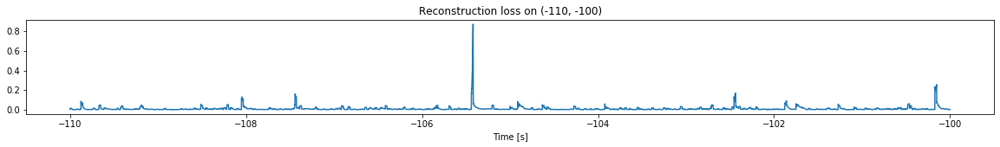

<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


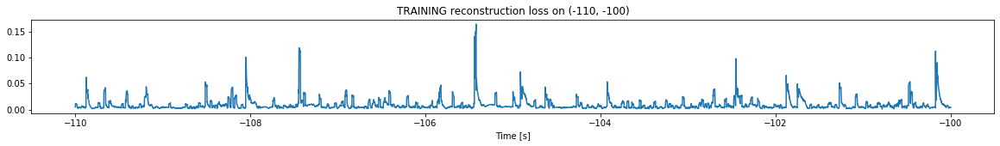

Finished training, median of the log(loss) is:  -2.2446628705971827
Triggering for section:  (-100, -90)
Using this median for triggering: -2.2065559961799015


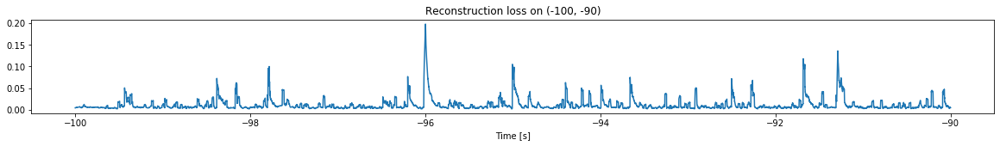

<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


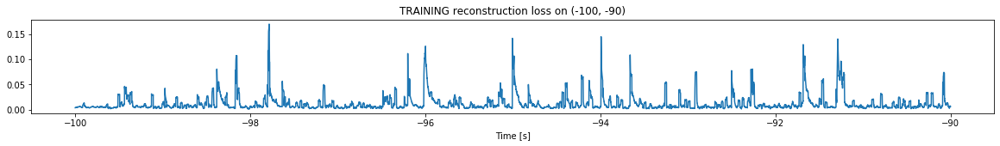

Finished training, median of the log(loss) is:  -2.1479560702685463
Triggering for section:  (-90, -80)
Using this median for triggering: -2.2446628705971827


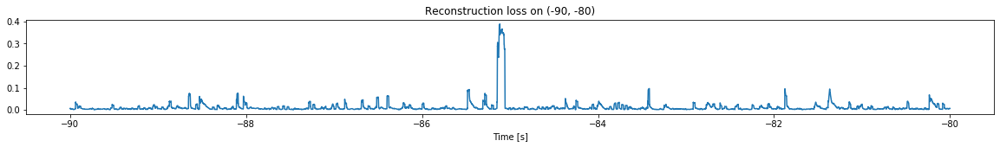

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


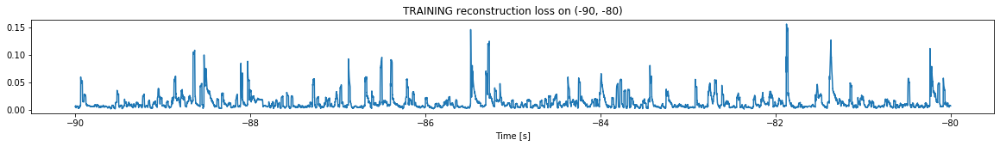

Finished training, median of the log(loss) is:  -2.04949797839232
Triggering for section:  (-80, -70)
Using this median for triggering: -2.1479560702685463


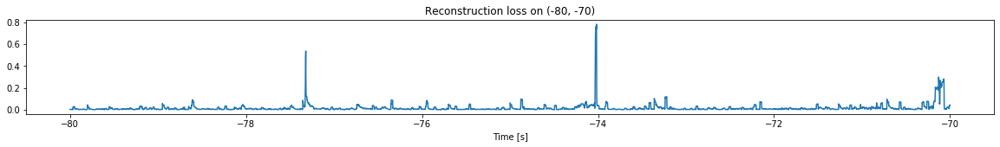

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


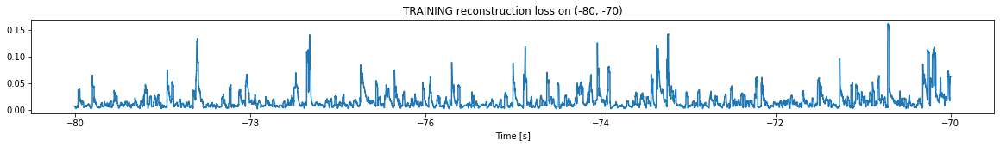

Finished training, median of the log(loss) is:  -1.903817901439076
Triggering for section:  (-70, -60)
Using this median for triggering: -2.04949797839232


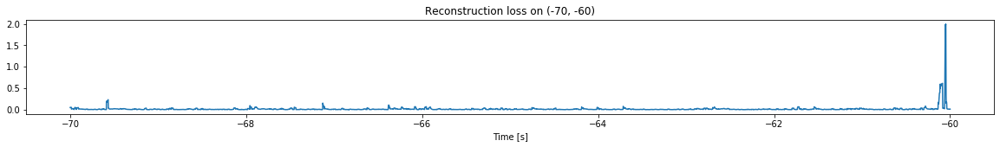

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


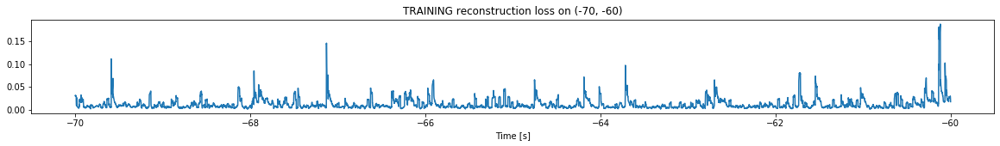

Finished training, median of the log(loss) is:  -2.0705573989521664
Triggering for section:  (-60, -50)
Using this median for triggering: -1.903817901439076


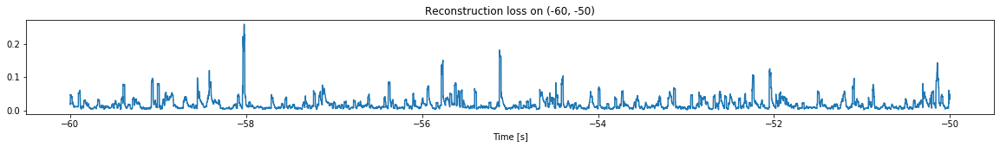

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


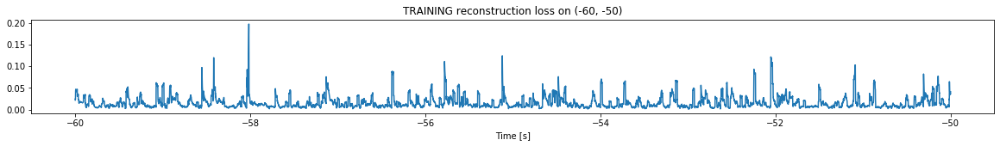

Finished training, median of the log(loss) is:  -1.929143801301588
Triggering for section:  (-50, -40)
Using this median for triggering: -2.0705573989521664


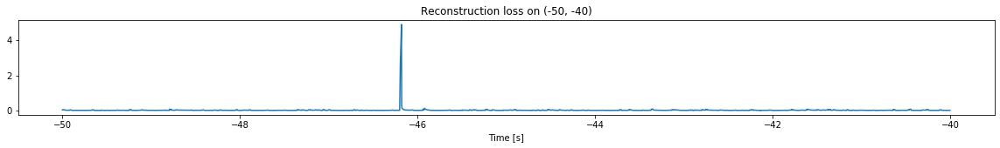

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


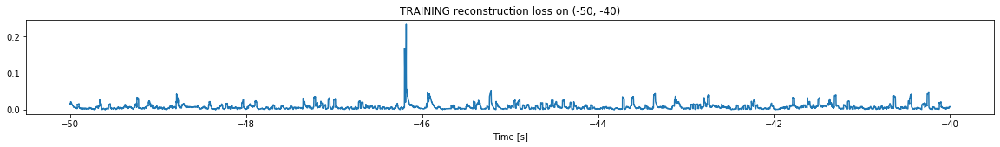

Finished training, median of the log(loss) is:  -2.2229115232235594
Triggering for section:  (-40, -30)
Using this median for triggering: -1.929143801301588


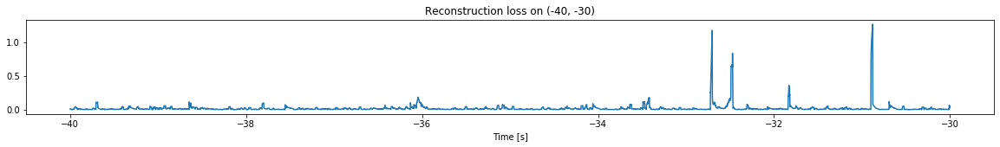

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


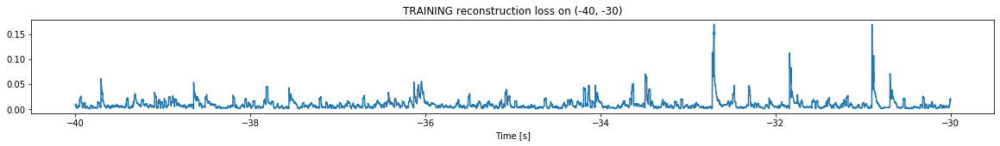

Finished training, median of the log(loss) is:  -2.1512634594145386
Triggering for section:  (-30, -20)
Using this median for triggering: -2.2229115232235594


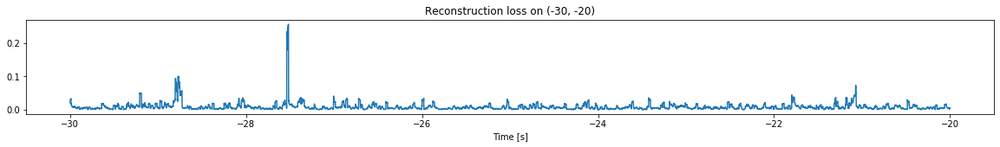

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


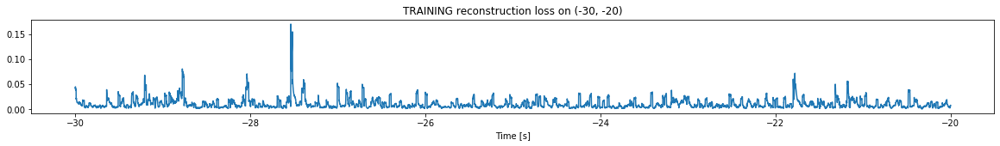

Finished training, median of the log(loss) is:  -2.0951131288351865
Triggering for section:  (-20, -10)
Using this median for triggering: -2.1512634594145386


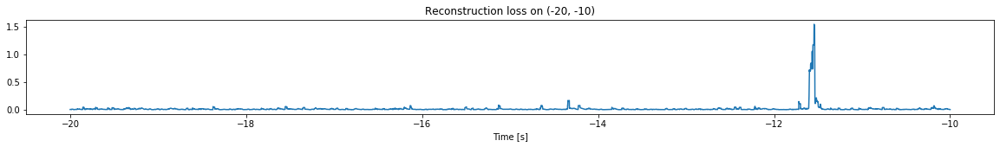

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


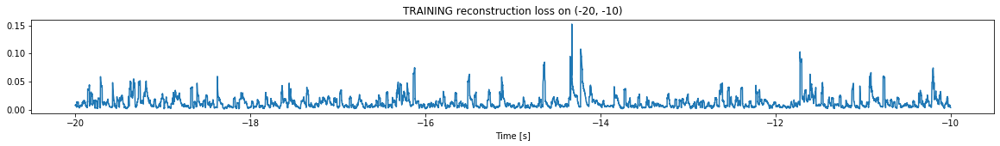

Finished training, median of the log(loss) is:  -2.014867273599367
Triggering for section:  (-10, 0)
Using this median for triggering: -2.0951131288351865


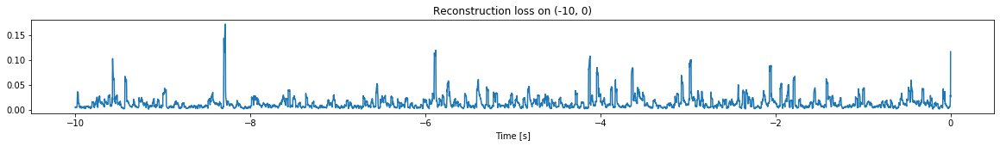

<--------
Finished simulation, all the triggered times are:  [-147.86859, -145.93729, -145.0904, -144.03558, -143.45898, -142.92929, -142.41599, -141.88719, -141.1856, -140.68428, -139.86528, -139.12608, -137.90828, -136.57379, -136.04019, -135.52899, -134.75859, -133.88799, -133.08559, -132.04239, -131.42918, -130.76549, -130.09009]


In [36]:
simulation("./data/Ramp20/", 10, (-195,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1199800, 13)
Flushing input history
Number of sections: 12
Entering sections:  (-120, -110)
-------->
Entering sections:  (-110, -100)
-------->
Training for section:  (None, -110)


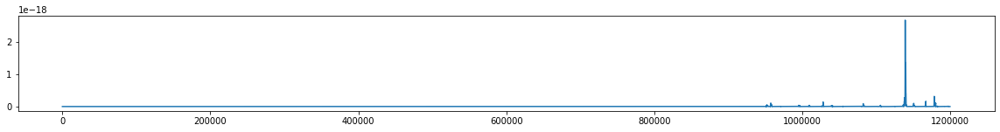

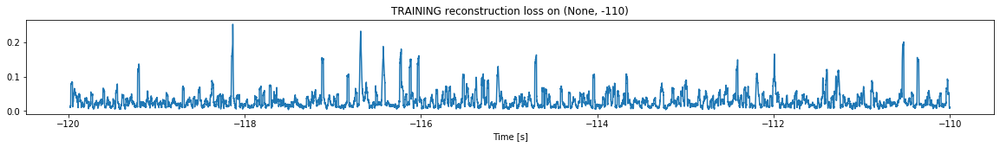

Finished training, median of the log(loss) is:  -1.6221862564642746
<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


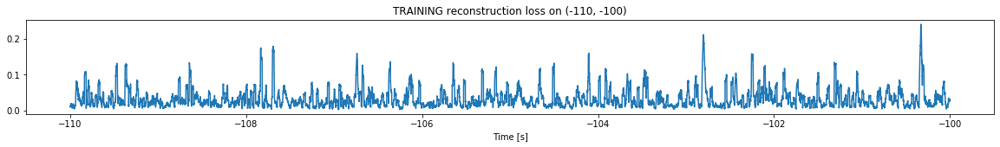

Finished training, median of the log(loss) is:  -1.5856912112954398
Triggering for section:  (-100, -90)
Using this median for triggering: -1.6221862564642746


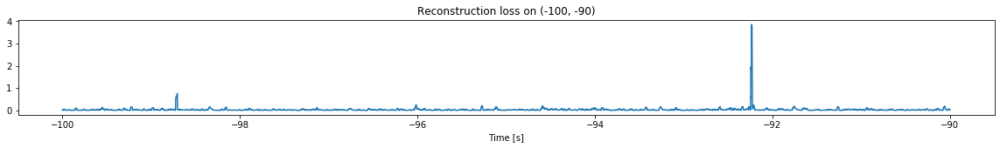

<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


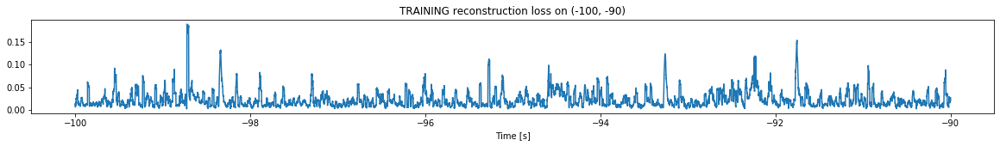

Finished training, median of the log(loss) is:  -1.736599073712592
Triggering for section:  (-90, -80)
Using this median for triggering: -1.5856912112954398


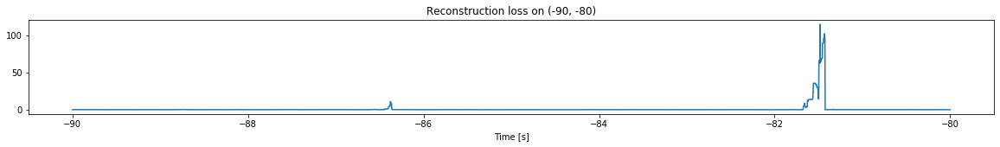

Other trigger time:  [-81.4798]
Their log loss values are:  [3.64670935]


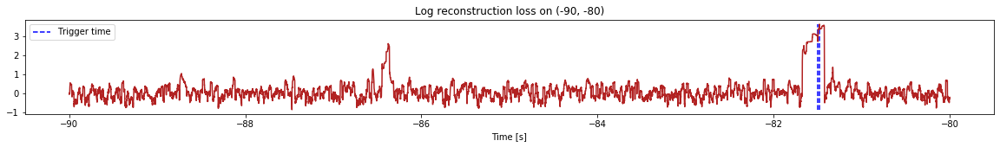

Triggered at:  [-81.4798]
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


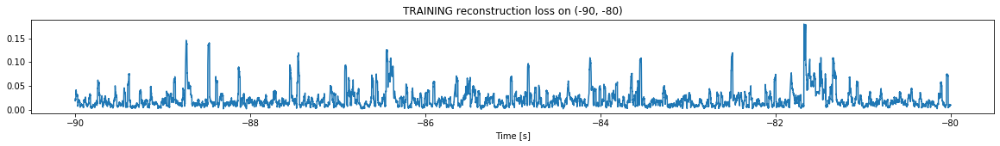

Finished training, median of the log(loss) is:  -1.7901379080001134
Triggering for section:  (-80, -70)
Using this median for triggering: -1.736599073712592


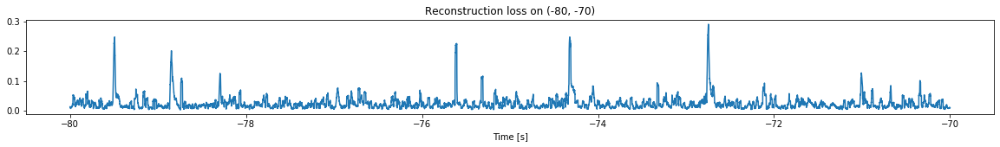

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


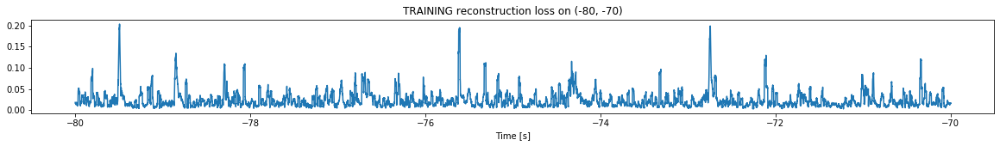

Finished training, median of the log(loss) is:  -1.7362250877974001
Triggering for section:  (-70, -60)
Using this median for triggering: -1.7901379080001134


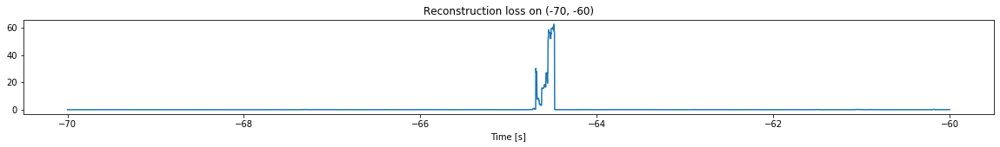

Other trigger time:  [-64.4872]
Their log loss values are:  [3.58672742]


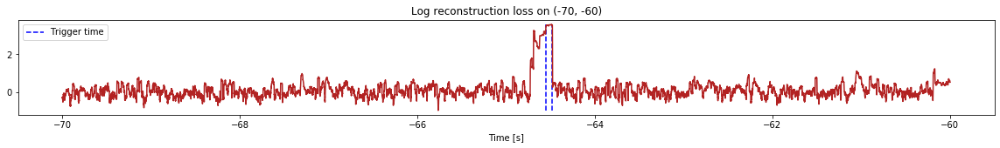

Triggered at:  [-64.4872]
<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


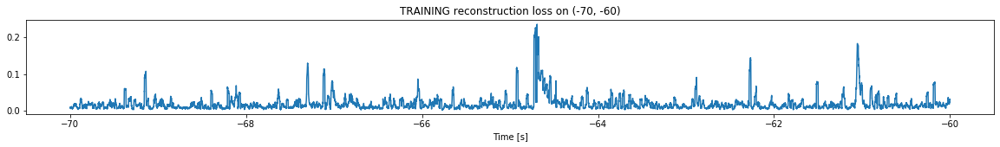

Finished training, median of the log(loss) is:  -1.8680690310020114
Triggering for section:  (-60, -50)
Using this median for triggering: -1.7362250877974001


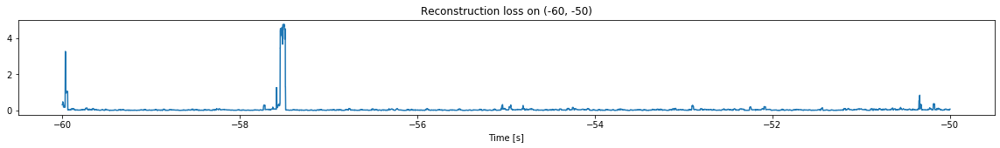

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


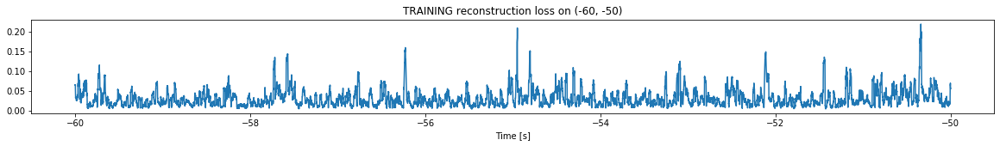

Finished training, median of the log(loss) is:  -1.5928283983807963
Triggering for section:  (-50, -40)
Using this median for triggering: -1.8680690310020114


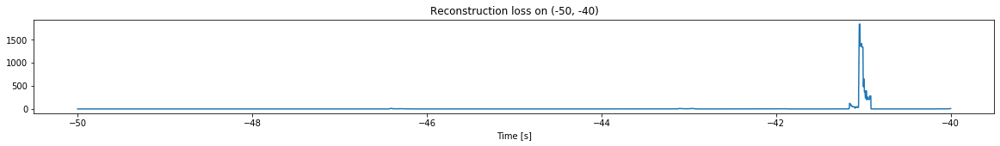

Other trigger time:  [-41.045097]
Their log loss values are:  [5.13369438]


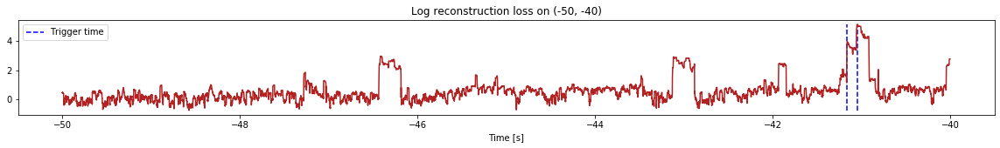

Triggered at:  [-41.045097]
<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


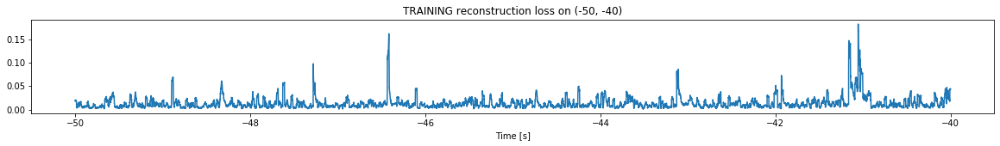

Finished training, median of the log(loss) is:  -1.992687418828959
Triggering for section:  (-40, -30)
Using this median for triggering: -1.5928283983807963


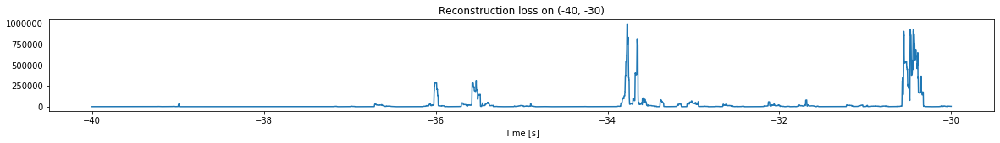

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


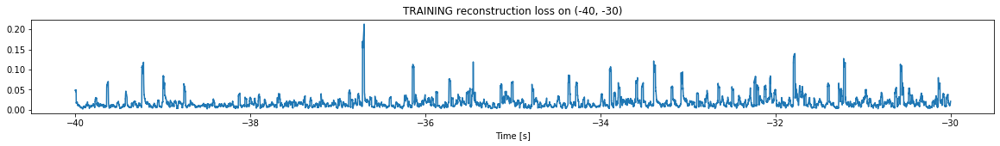

Finished training, median of the log(loss) is:  -1.8396765165041928
Triggering for section:  (-30, -20)
Using this median for triggering: -1.992687418828959


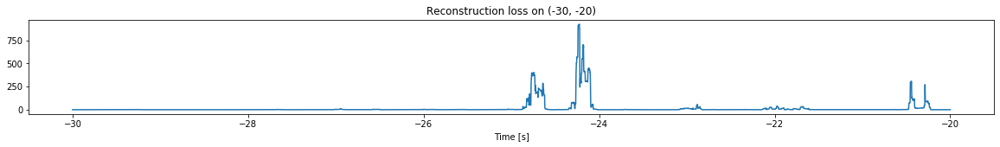

Other trigger time:  [-24.7431   -24.227499 -22.88     -21.975899 -20.4439  ]
Their log loss values are:  [4.59856008 4.9590447  3.74993011 3.5794613  4.48268614]


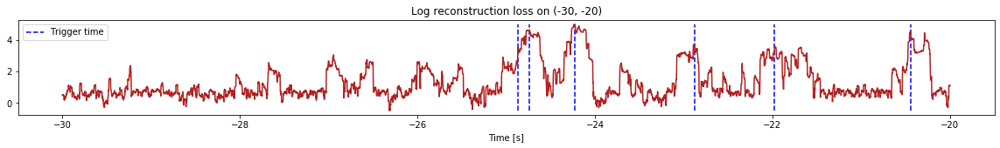

Triggered at:  [-24.7431, -24.227499, -22.88, -21.975899, -20.4439]
<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


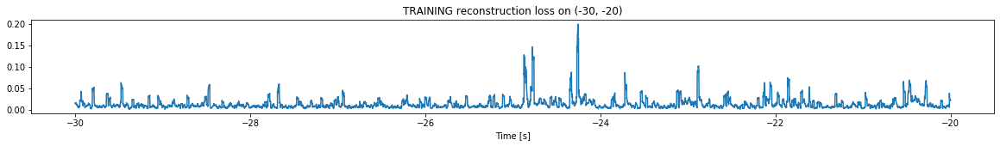

Finished training, median of the log(loss) is:  -2.014568162997505
Triggering for section:  (-20, -10)
Using this median for triggering: -1.8396765165041928


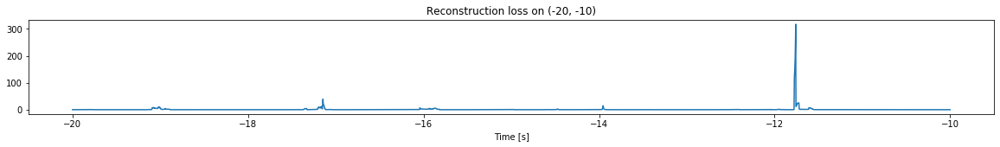

Other trigger time:  [-17.1462 -11.7589]
Their log loss values are:  [3.43386765 4.34152876]


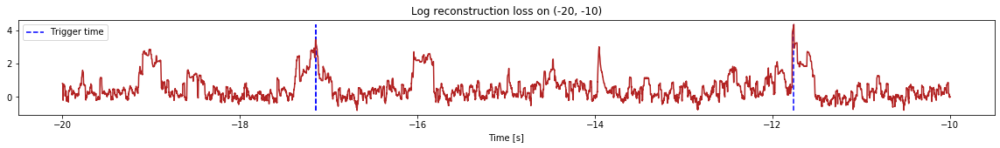

Triggered at:  [-17.1462, -11.7589]
<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


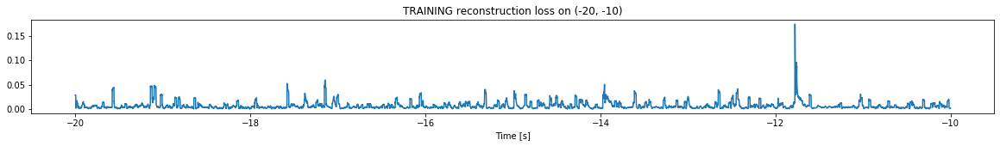

Finished training, median of the log(loss) is:  -2.2861856635620947
Triggering for section:  (-10, 0)
Using this median for triggering: -2.014568162997505


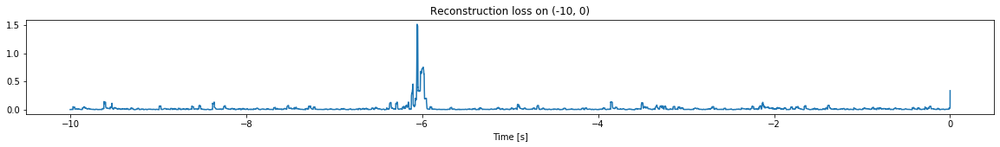

<--------
Finished simulation, all the triggered times are:  [-81.4798, -64.4872, -41.045097, -24.7431, -24.227499, -22.88, -21.975899, -20.4439, -17.1462, -11.7589]


In [37]:
simulation("./data/Ramp21/", 10, (-120,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (799800, 13)
Flushing input history
Number of sections: 8
Entering sections:  (-80, -70)
-------->
Entering sections:  (-70, -60)
-------->
Training for section:  (None, -70)


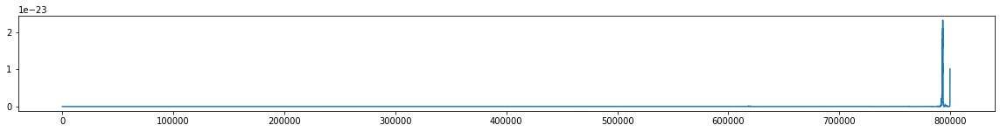

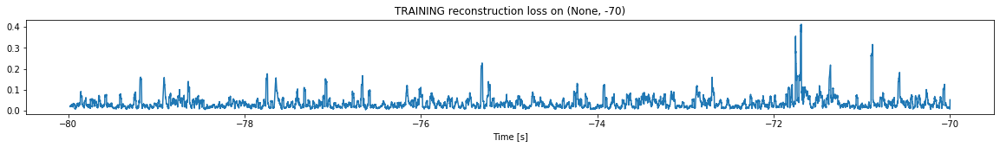

Finished training, median of the log(loss) is:  -1.526819356097332
<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


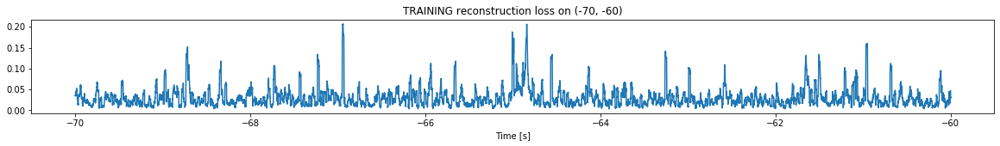

Finished training, median of the log(loss) is:  -1.6108811846685858
Triggering for section:  (-60, -50)
Using this median for triggering: -1.526819356097332


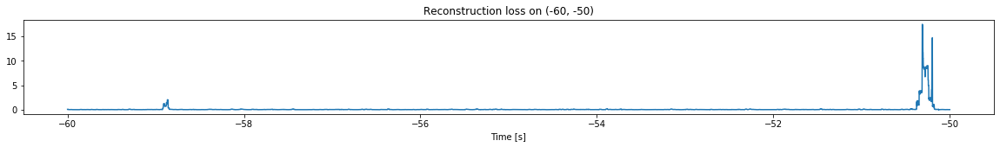

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


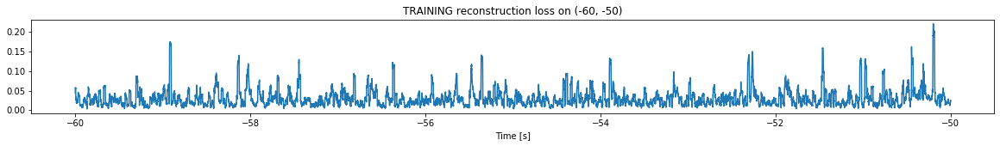

Finished training, median of the log(loss) is:  -1.591429010727515
Triggering for section:  (-50, -40)
Using this median for triggering: -1.6108811846685858


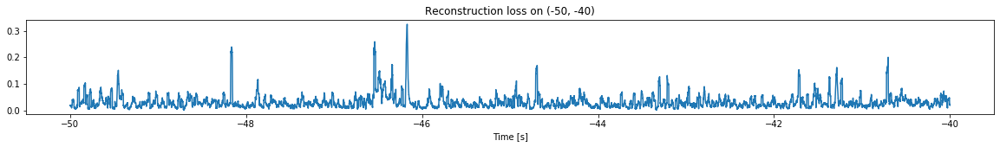

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


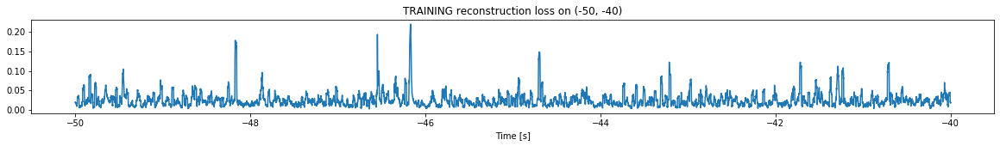

Finished training, median of the log(loss) is:  -1.6827272283415087
Triggering for section:  (-40, -30)
Using this median for triggering: -1.591429010727515


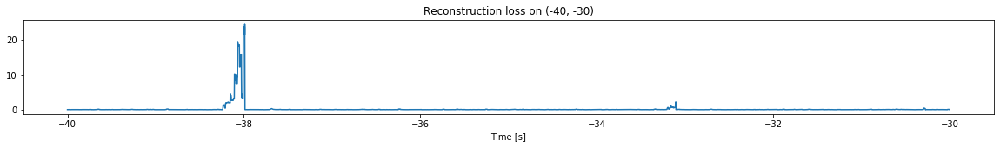

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


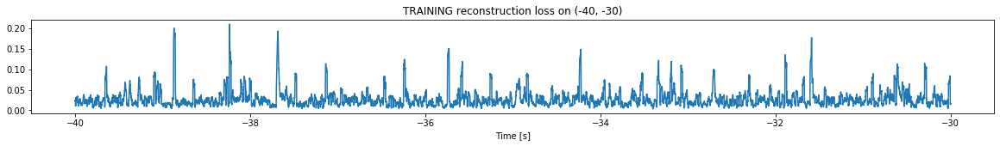

Finished training, median of the log(loss) is:  -1.6351203419826068
Triggering for section:  (-30, -20)
Using this median for triggering: -1.6827272283415087


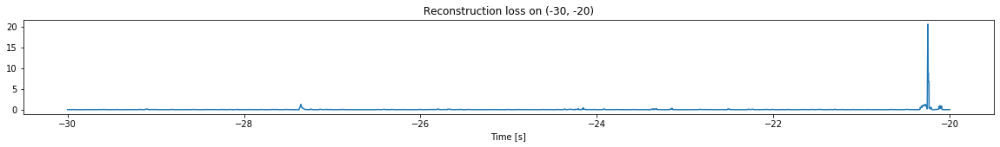

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


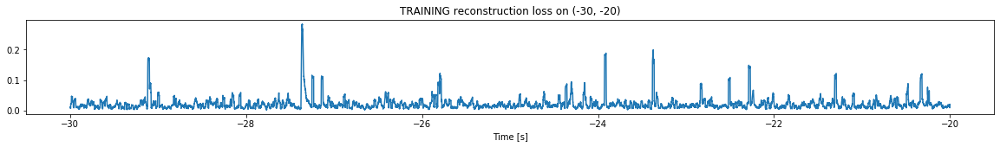

Finished training, median of the log(loss) is:  -1.7765450501013953
Triggering for section:  (-20, -10)
Using this median for triggering: -1.6351203419826068


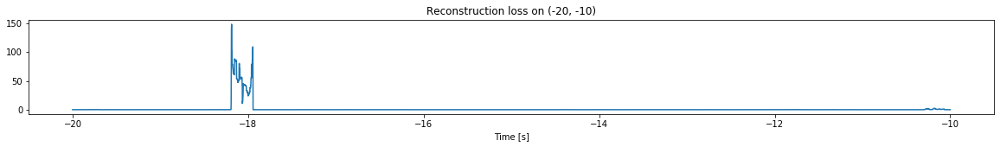

Other trigger time:  [-18.188099]
Their log loss values are:  [3.8061436]


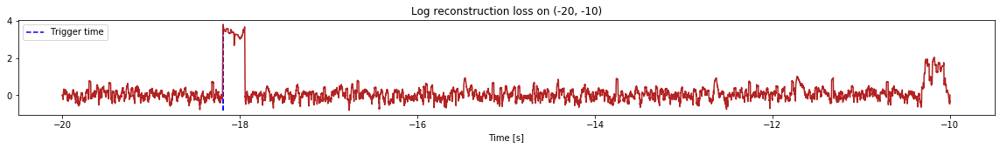

Triggered at:  [-18.188099]
<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


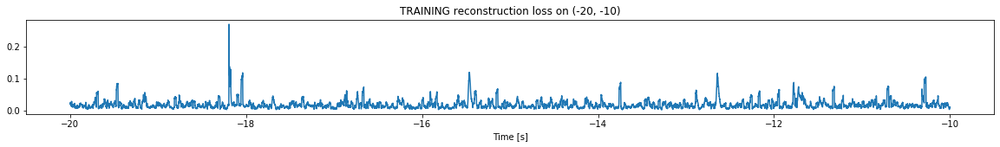

Finished training, median of the log(loss) is:  -1.8178274334805145
Triggering for section:  (-10, 0)
Using this median for triggering: -1.7765450501013953


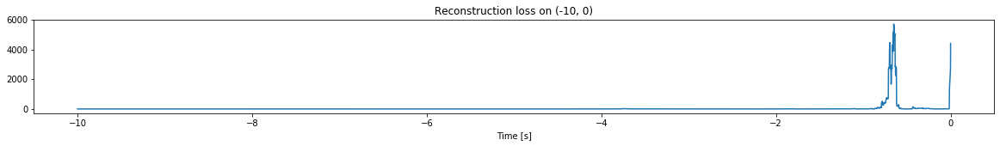

Other trigger time:  [-0.6508]
Their log loss values are:  [5.53354091]


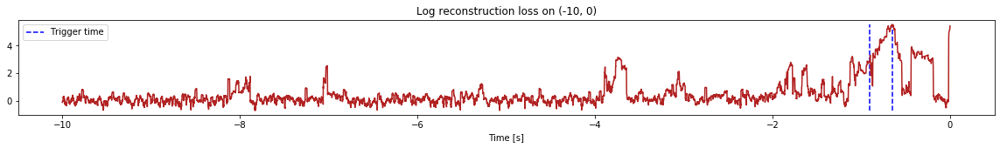

Triggered at:  [-0.6508]
<--------
Finished simulation, all the triggered times are:  [-18.188099, -0.6508]


In [38]:
simulation("./data/Ramp22/", 10, (-80,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (499800, 13)
Flushing input history
Number of sections: 5
Entering sections:  (-50, -40)
-------->
Entering sections:  (-40, -30)
-------->
Training for section:  (None, -40)


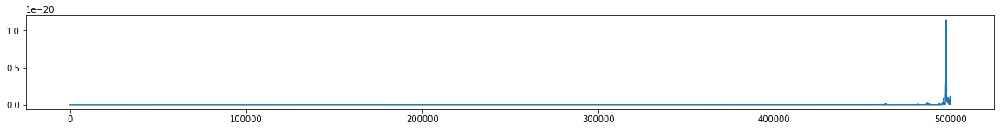

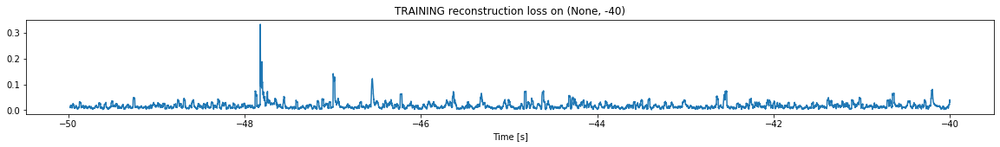

Finished training, median of the log(loss) is:  -1.8356789449313822
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


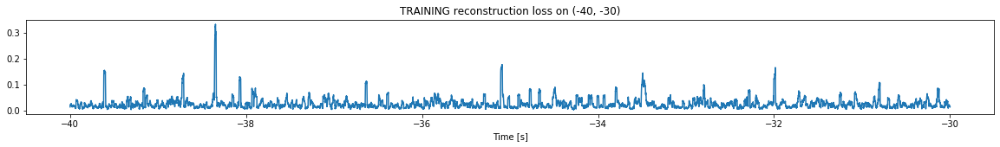

Finished training, median of the log(loss) is:  -1.6762296974040443
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8356789449313822


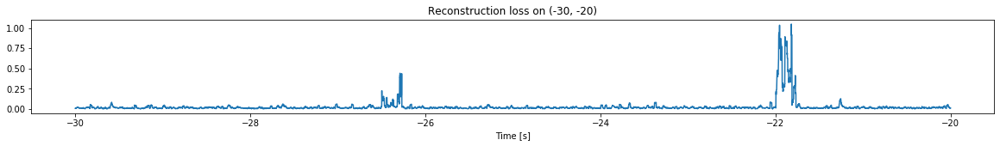

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


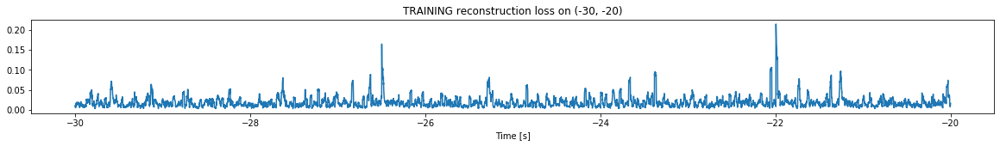

Finished training, median of the log(loss) is:  -1.798553897722193
Triggering for section:  (-20, -10)
Using this median for triggering: -1.6762296974040443


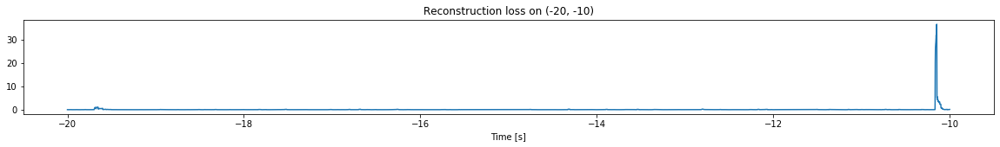

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


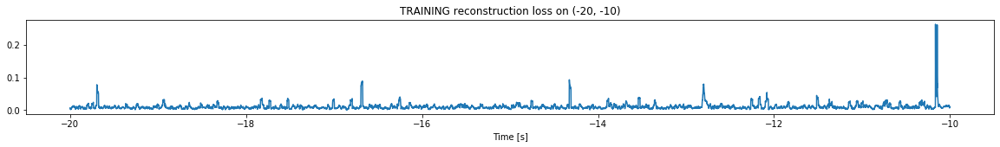

Finished training, median of the log(loss) is:  -2.0662030355540417
Triggering for section:  (-10, 0)
Using this median for triggering: -1.798553897722193


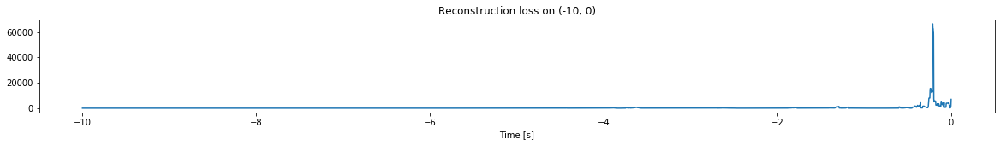

Other trigger time:  [-4.4318     -3.6151     -2.6408     -1.8057     -1.2943     -0.21249999]
Their log loss values are:  [3.89991154 4.65347666 4.14280654 4.56092549 4.9378776  6.62105424]


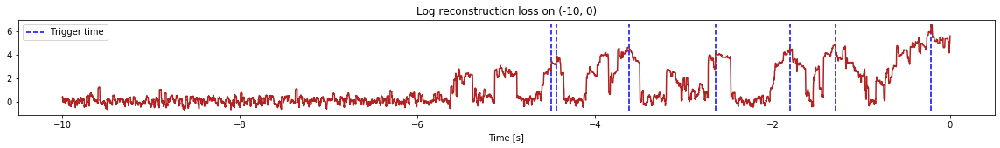

Triggered at:  [-4.4318, -3.6151, -2.6408, -1.8057, -1.2943, -0.21249999]
<--------
Finished simulation, all the triggered times are:  [-4.4318, -3.6151, -2.6408, -1.8057, -1.2943, -0.21249999]


In [39]:
simulation("./data/Ramp23/", 10, (-50,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1099800, 13)
Flushing input history
Number of sections: 11
Entering sections:  (-110, -100)
-------->
Entering sections:  (-100, -90)
-------->
Training for section:  (None, -100)


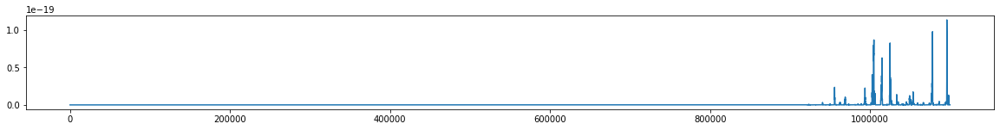

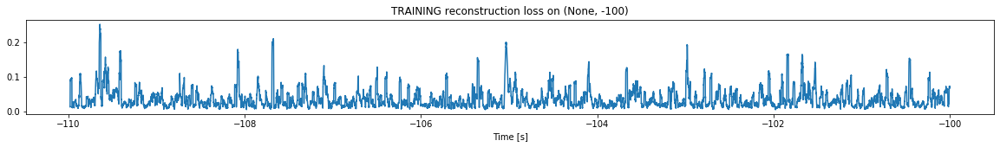

Finished training, median of the log(loss) is:  -1.5397091741915
<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


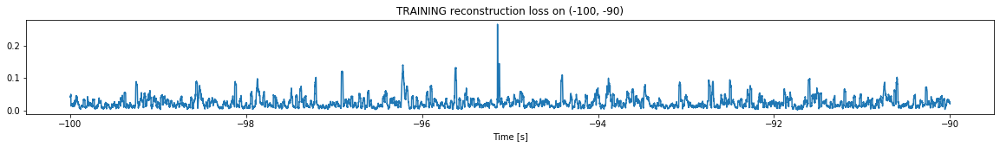

Finished training, median of the log(loss) is:  -1.7038927973649272
Triggering for section:  (-90, -80)
Using this median for triggering: -1.5397091741915


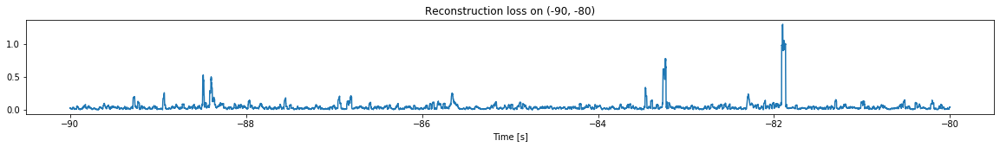

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


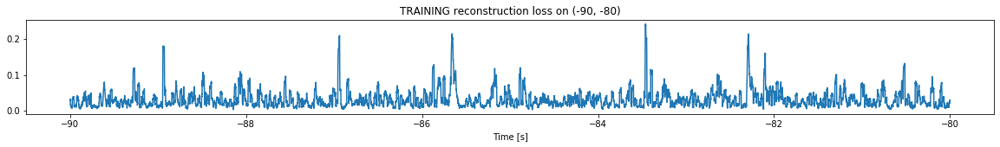

Finished training, median of the log(loss) is:  -1.577901725557449
Triggering for section:  (-80, -70)
Using this median for triggering: -1.7038927973649272


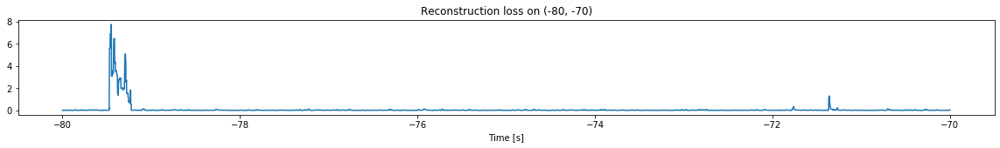

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


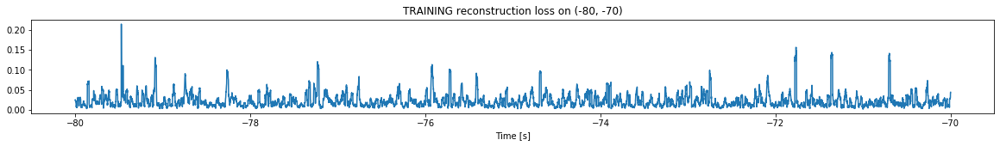

Finished training, median of the log(loss) is:  -1.7434910478672865
Triggering for section:  (-70, -60)
Using this median for triggering: -1.577901725557449


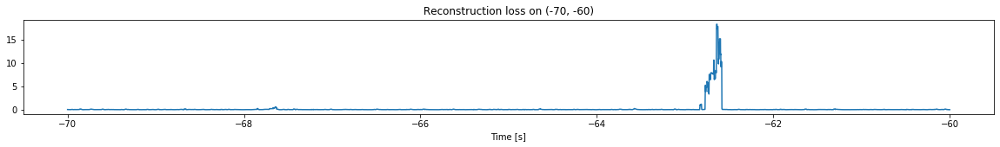

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


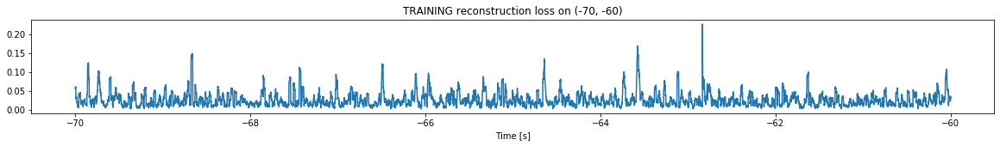

Finished training, median of the log(loss) is:  -1.6440726610968088
Triggering for section:  (-60, -50)
Using this median for triggering: -1.7434910478672865


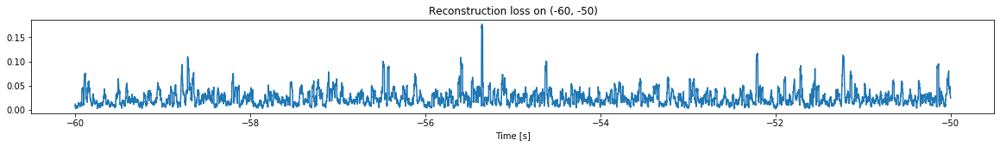

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


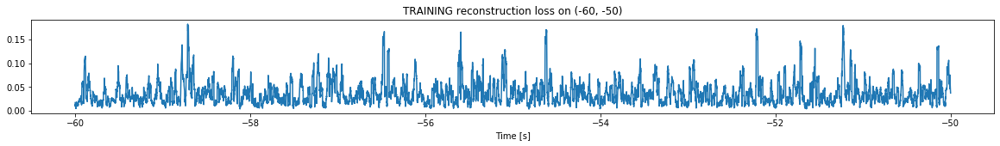

Finished training, median of the log(loss) is:  -1.4996497627680532
Triggering for section:  (-50, -40)
Using this median for triggering: -1.6440726610968088


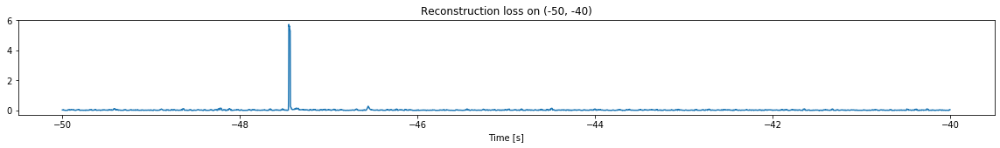

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


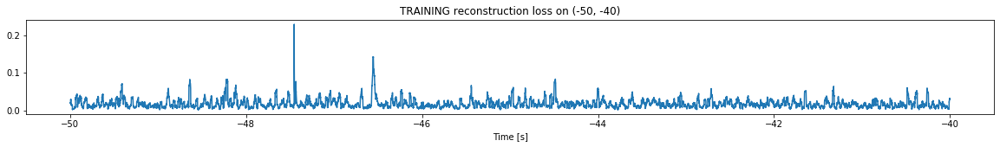

Finished training, median of the log(loss) is:  -1.8179221603705427
Triggering for section:  (-40, -30)
Using this median for triggering: -1.4996497627680532


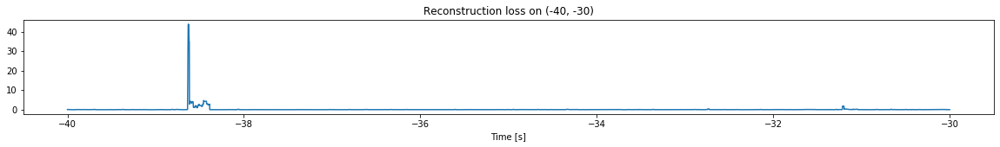

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


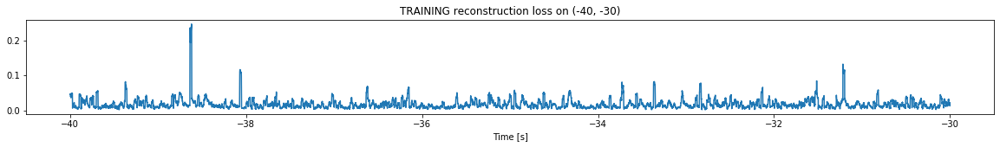

Finished training, median of the log(loss) is:  -1.8466271413576636
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8179221603705427


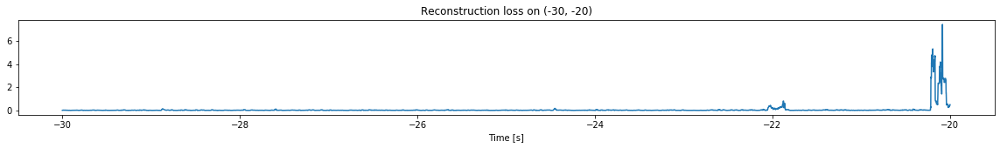

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


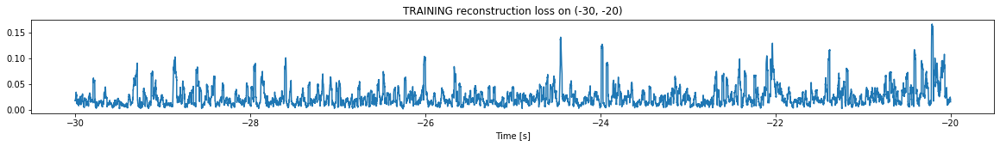

Finished training, median of the log(loss) is:  -1.6983578422007133
Triggering for section:  (-20, -10)
Using this median for triggering: -1.8466271413576636


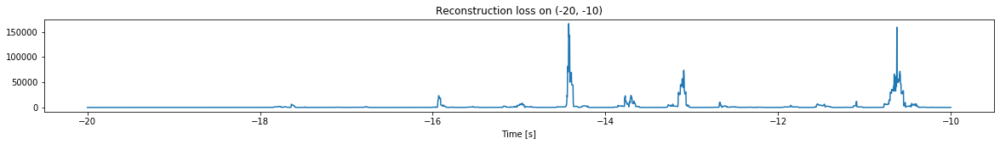

Other trigger time:  [-17.6369    -16.7733    -15.929999  -14.9623995 -14.424999  -13.7056
 -13.0918    -12.5917    -11.5411    -10.6247    -10.028399 ]
Their log loss values are:  [5.65978906 5.06510568 6.21289007 5.75612325 7.06700682 6.21990772
 6.71425654 5.19839008 5.68915179 7.04848849 4.08490961]


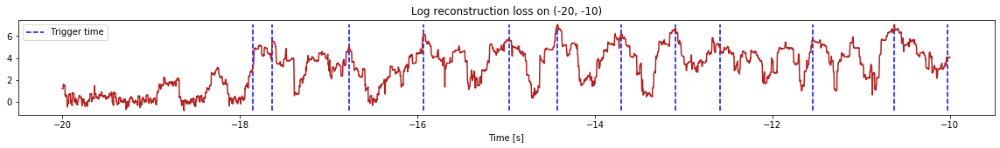

Triggered at:  [-17.6369, -16.7733, -15.929999, -14.9623995, -14.424999, -13.7056, -13.0918, -12.5917, -11.5411, -10.6247, -10.028399]
<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


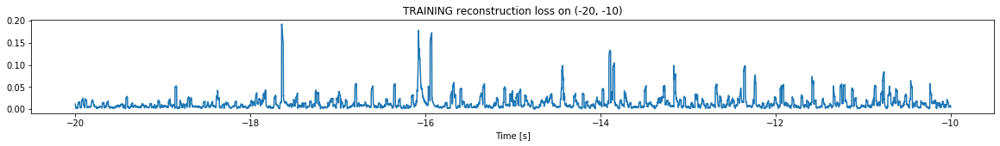

Finished training, median of the log(loss) is:  -2.017091949044411
Triggering for section:  (-10, 0)
Using this median for triggering: -1.6983578422007133


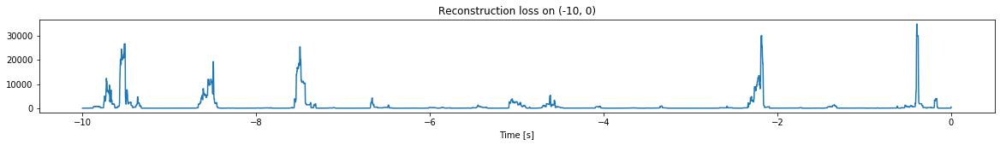

Other trigger time:  [-9.509399   -8.4948     -7.4932     -6.6626     -6.0049     -5.4437
 -4.6141     -4.0443     -3.3406     -2.6862     -2.1826     -1.3424
 -0.39499998]
Their log loss values are:  [6.12395701 5.98347011 6.10280819 5.32634746 4.25654494 4.80065701
 5.42448505 4.5617453  4.65069795 3.38400887 6.17586986 4.85789934
 6.24083237]


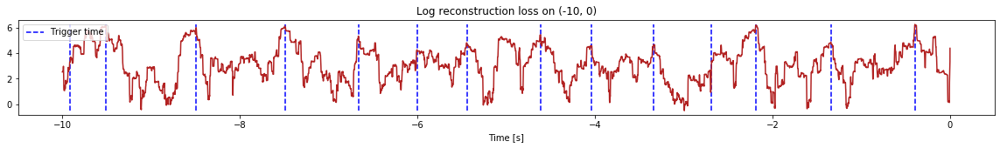

Triggered at:  [-9.509399, -8.4948, -7.4932, -6.6626, -6.0049, -5.4437, -4.6141, -4.0443, -3.3406, -2.6862, -2.1826, -1.3424, -0.39499998]
<--------
Finished simulation, all the triggered times are:  [-17.6369, -16.7733, -15.929999, -14.9623995, -14.424999, -13.7056, -13.0918, -12.5917, -11.5411, -10.6247, -10.028399, -9.509399, -8.4948, -7.4932, -6.6626, -6.0049, -5.4437, -4.6141, -4.0443, -3.3406, -2.6862, -2.1826, -1.3424, -0.39499998]


In [40]:
simulation("./data/Ramp24/", 10, (-110,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (999800, 13)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


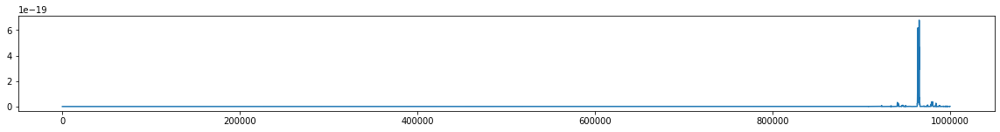

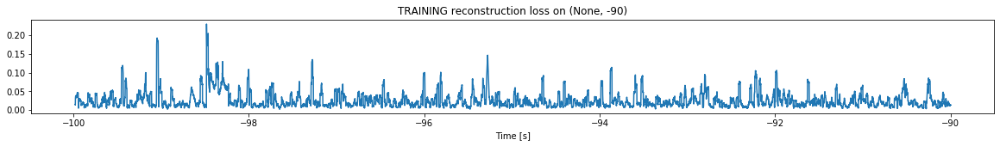

Finished training, median of the log(loss) is:  -1.694677645120956
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


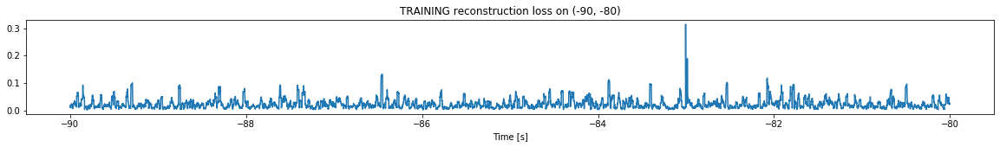

Finished training, median of the log(loss) is:  -1.7067222399331894
Triggering for section:  (-80, -70)
Using this median for triggering: -1.694677645120956


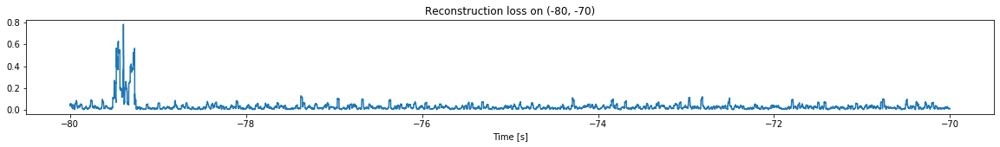

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


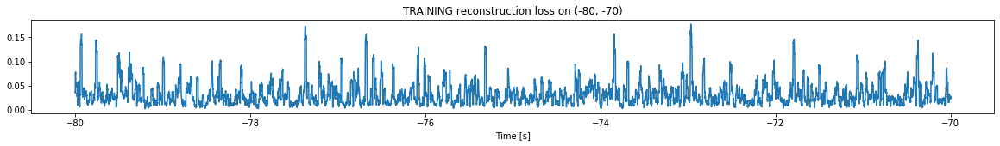

Finished training, median of the log(loss) is:  -1.5799963626909075
Triggering for section:  (-70, -60)
Using this median for triggering: -1.7067222399331894


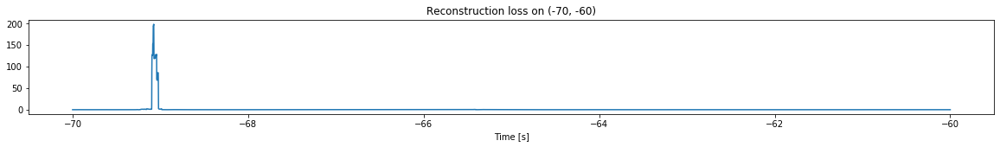

Other trigger time:  [-69.075096]
Their log loss values are:  [4.00533953]


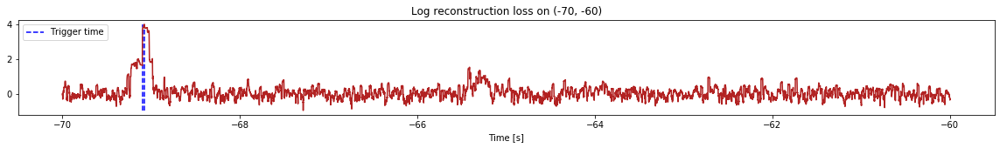

Triggered at:  [-69.075096]
<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


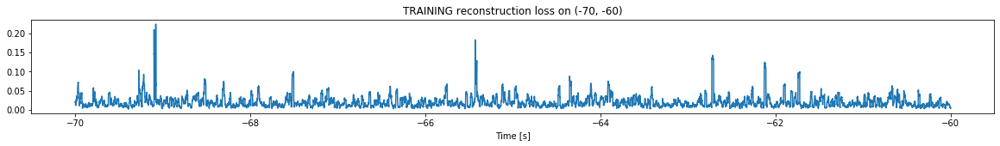

Finished training, median of the log(loss) is:  -1.780216849900262
Triggering for section:  (-60, -50)
Using this median for triggering: -1.5799963626909075


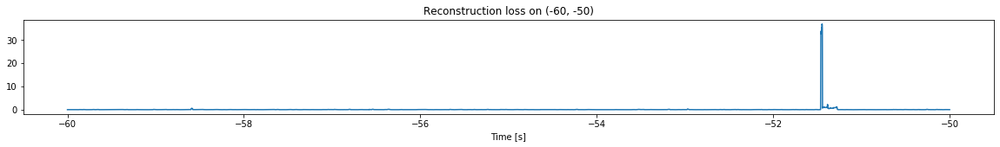

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


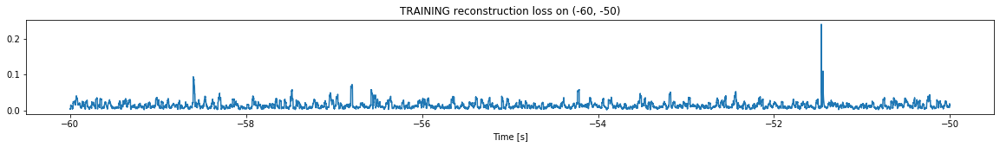

Finished training, median of the log(loss) is:  -1.9409091460875114
Triggering for section:  (-50, -40)
Using this median for triggering: -1.780216849900262


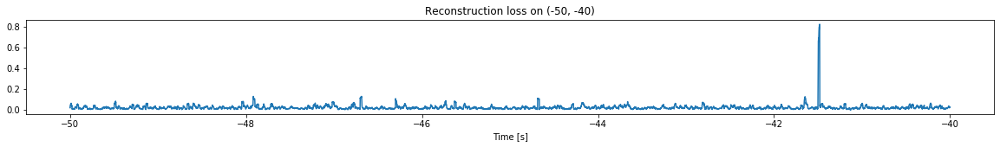

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


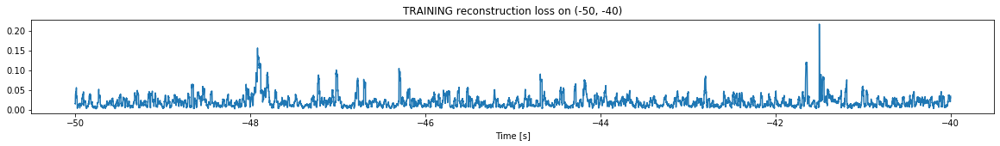

Finished training, median of the log(loss) is:  -1.7772012980428478
Triggering for section:  (-40, -30)
Using this median for triggering: -1.9409091460875114


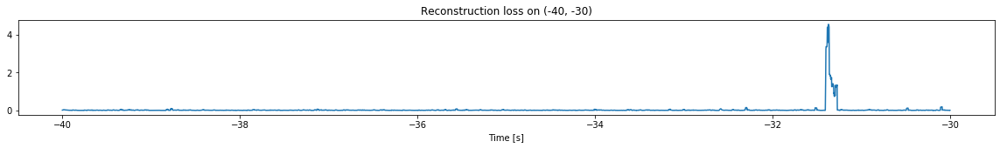

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


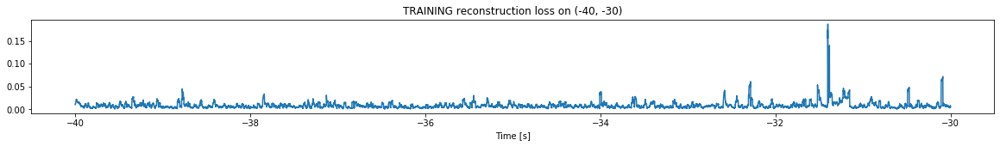

Finished training, median of the log(loss) is:  -2.145651411202101
Triggering for section:  (-30, -20)
Using this median for triggering: -1.7772012980428478


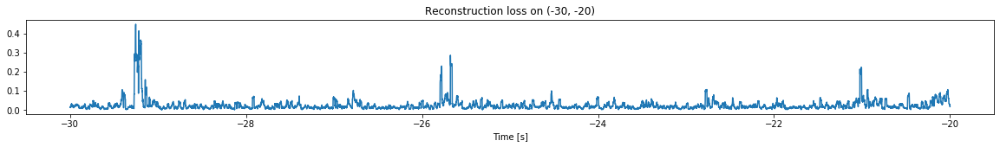

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


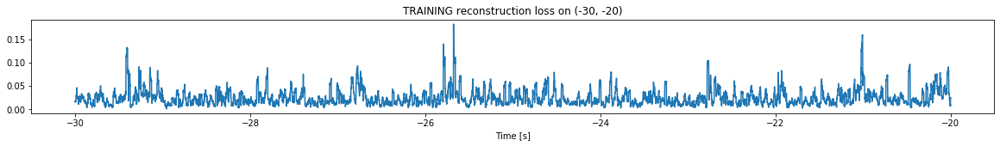

Finished training, median of the log(loss) is:  -1.6796885208591272
Triggering for section:  (-20, -10)
Using this median for triggering: -2.145651411202101


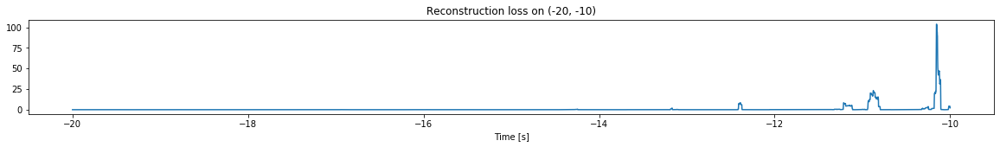

Other trigger time:  [-10.8754   -10.153299]
Their log loss values are:  [3.50711712 4.16215597]


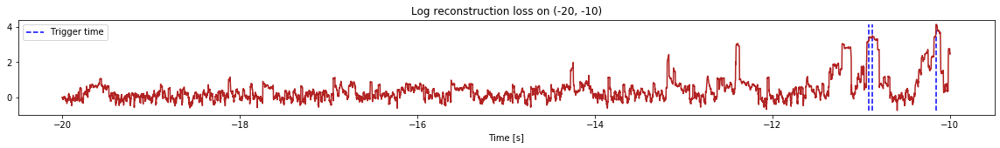

Triggered at:  [-10.8754, -10.153299]
<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


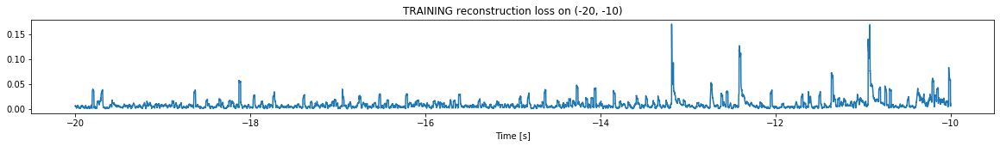

Finished training, median of the log(loss) is:  -2.1502301799561465
Triggering for section:  (-10, 0)
Using this median for triggering: -1.6796885208591272


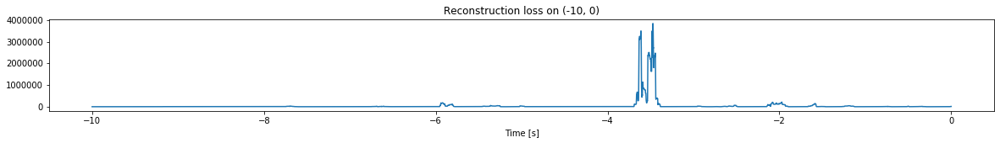

<--------
Finished simulation, all the triggered times are:  [-69.075096, -10.8754, -10.153299]


In [41]:
simulation("./data/Ramp25/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1099800, 13)
Flushing input history
Number of sections: 11
Entering sections:  (-110, -100)
-------->
Entering sections:  (-100, -90)
-------->
Training for section:  (None, -100)


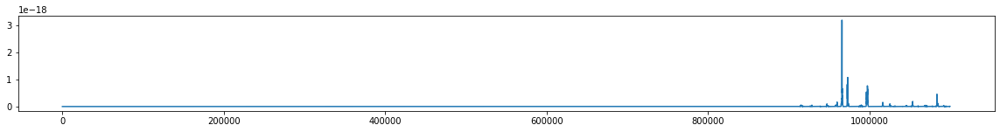

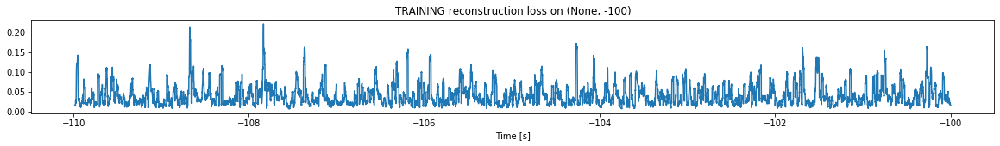

Finished training, median of the log(loss) is:  -1.469923005995759
<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


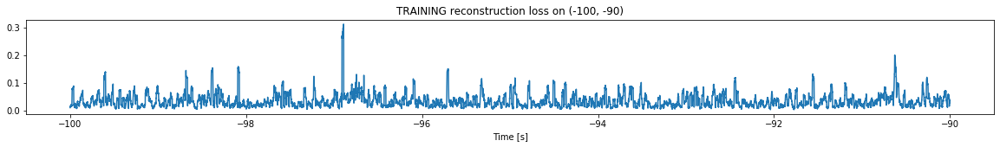

Finished training, median of the log(loss) is:  -1.5288519221522474
Triggering for section:  (-90, -80)
Using this median for triggering: -1.469923005995759


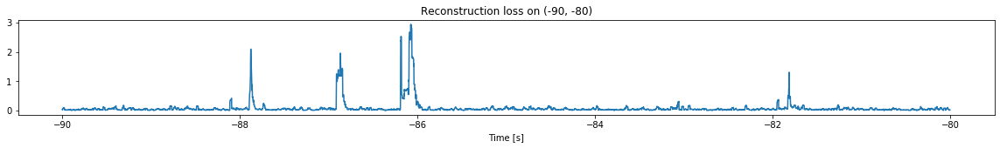

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


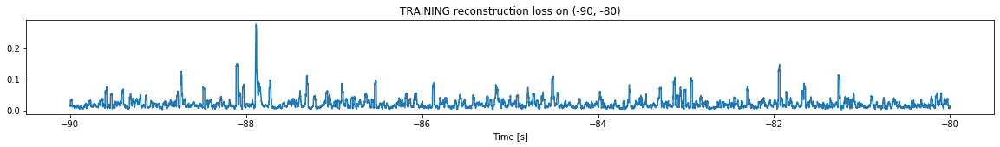

Finished training, median of the log(loss) is:  -1.7608872012098904
Triggering for section:  (-80, -70)
Using this median for triggering: -1.5288519221522474


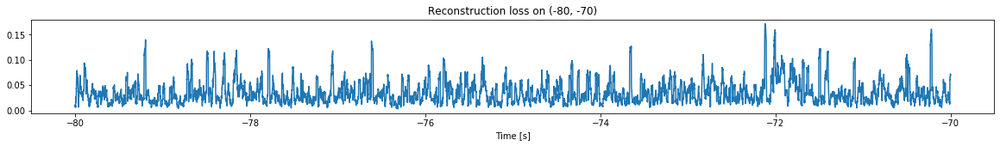

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


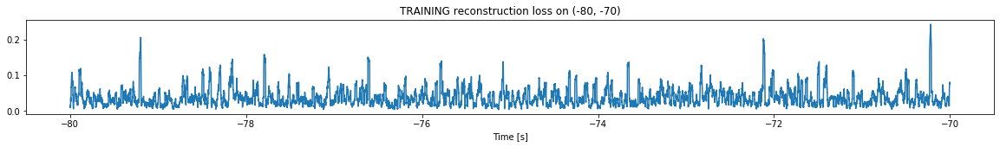

Finished training, median of the log(loss) is:  -1.4869800678577367
Triggering for section:  (-70, -60)
Using this median for triggering: -1.7608872012098904


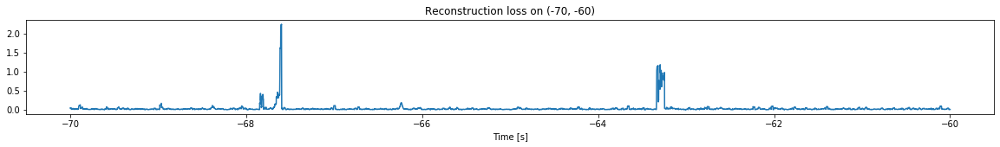

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


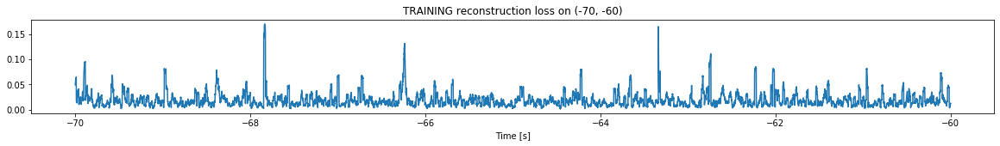

Finished training, median of the log(loss) is:  -1.79775372546613
Triggering for section:  (-60, -50)
Using this median for triggering: -1.4869800678577367


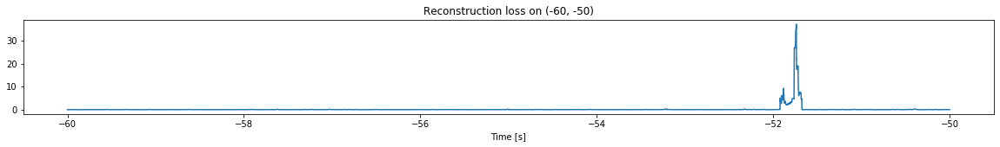

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


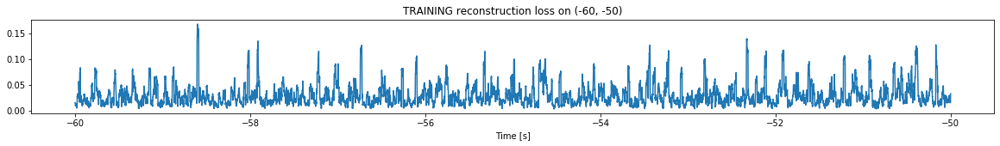

Finished training, median of the log(loss) is:  -1.612950163261057
Triggering for section:  (-50, -40)
Using this median for triggering: -1.79775372546613


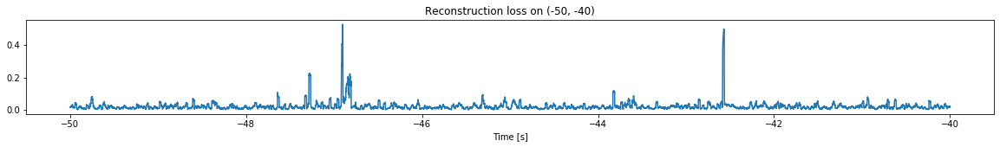

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


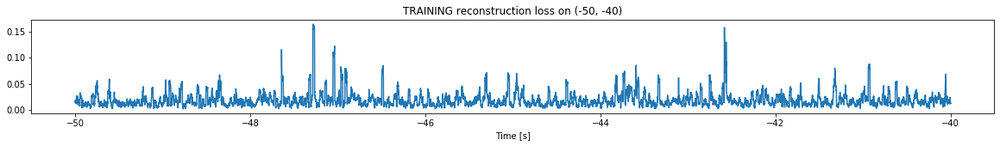

Finished training, median of the log(loss) is:  -1.7992139241719272
Triggering for section:  (-40, -30)
Using this median for triggering: -1.612950163261057


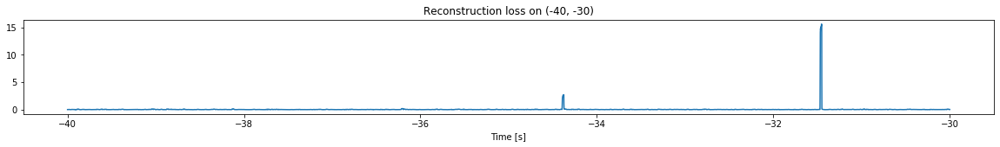

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


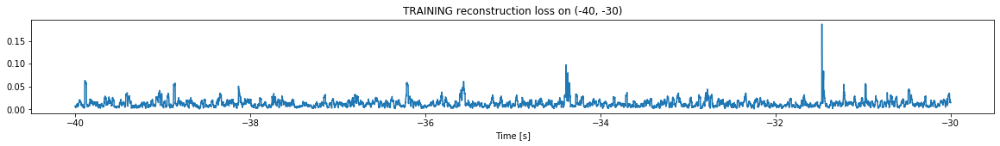

Finished training, median of the log(loss) is:  -1.9400992922232634
Triggering for section:  (-30, -20)
Using this median for triggering: -1.7992139241719272


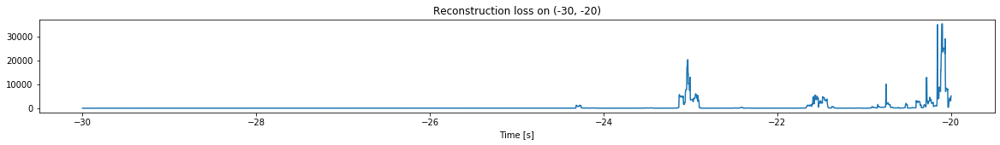

Other trigger time:  [-24.3142   -23.531599 -23.030699 -22.418999 -21.5605   -20.747099
 -20.0998  ]
Their log loss values are:  [4.89625759 3.32490778 6.10913673 4.34475941 5.53562183 5.80420592
 6.34865541]


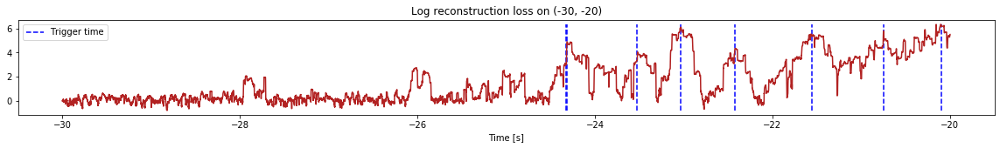

Triggered at:  [-24.3142, -23.531599, -23.030699, -22.418999, -21.5605, -20.747099, -20.0998]
<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


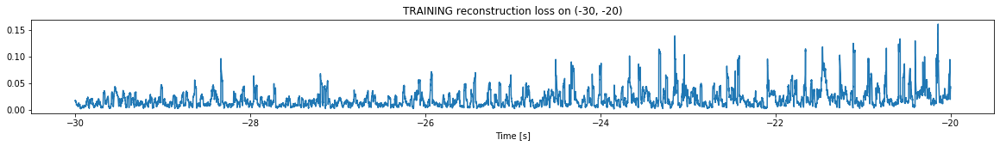

Finished training, median of the log(loss) is:  -1.810181854518659
Triggering for section:  (-20, -10)
Using this median for triggering: -1.9400992922232634


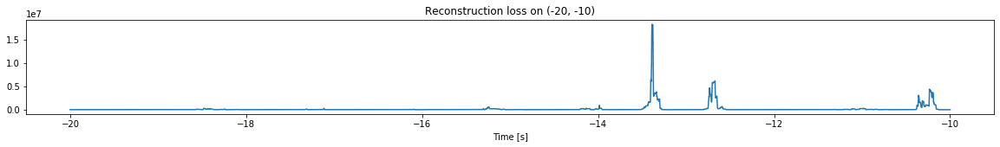

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


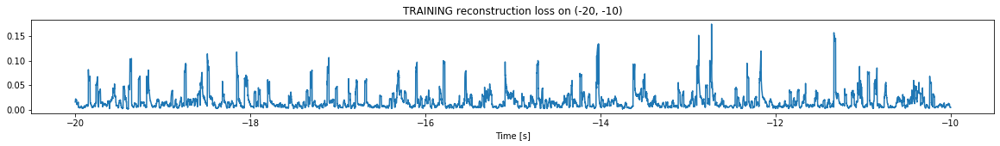

Finished training, median of the log(loss) is:  -1.9504766796371678
Triggering for section:  (-10, 0)
Using this median for triggering: -1.810181854518659


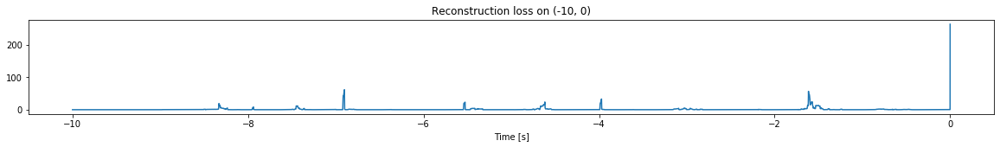

Other trigger time:  [-6.9013    -3.9722    -1.6136999]
Their log loss values are:  [3.60190103 3.32936497 3.56468784]


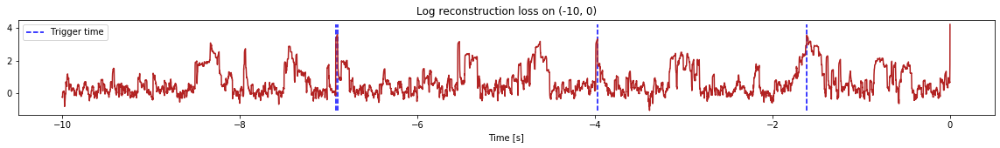

Triggered at:  [-6.9013, -3.9722, -1.6136999]
<--------
Finished simulation, all the triggered times are:  [-24.3142, -23.531599, -23.030699, -22.418999, -21.5605, -20.747099, -20.0998, -6.9013, -3.9722, -1.6136999]


In [42]:
simulation("./data/Ramp26/", 10, (-110,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (699800, 13)
Flushing input history
Number of sections: 7
Entering sections:  (-70, -60)
-------->
Entering sections:  (-60, -50)
-------->
Training for section:  (None, -60)


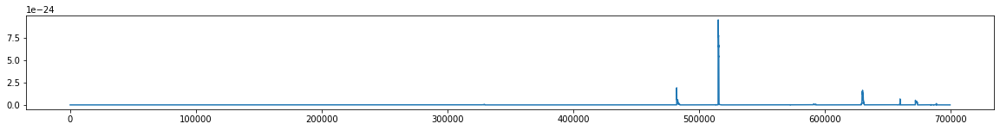

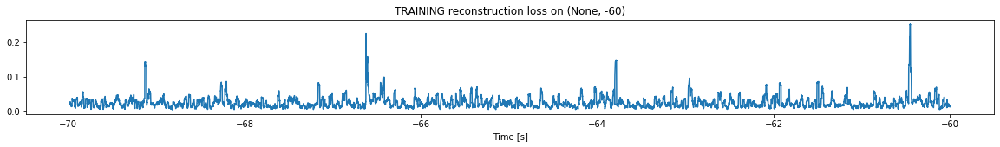

Finished training, median of the log(loss) is:  -1.6805385748094204
<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


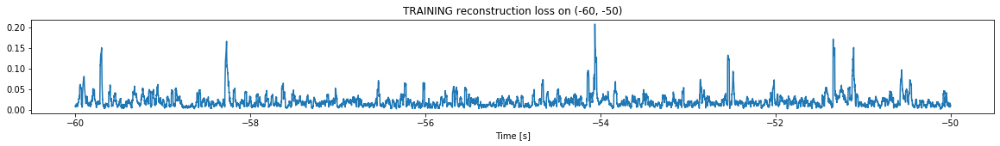

Finished training, median of the log(loss) is:  -1.7628194753786706
Triggering for section:  (-50, -40)
Using this median for triggering: -1.6805385748094204


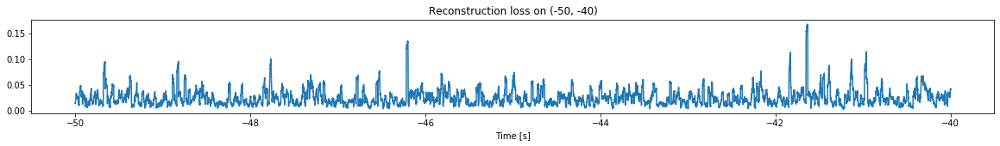

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


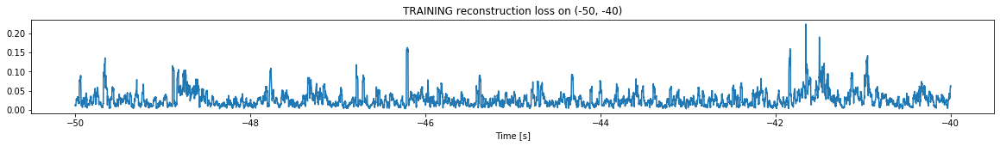

Finished training, median of the log(loss) is:  -1.6252217272698886
Triggering for section:  (-40, -30)
Using this median for triggering: -1.7628194753786706


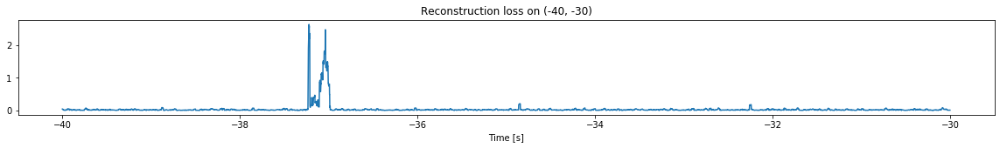

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


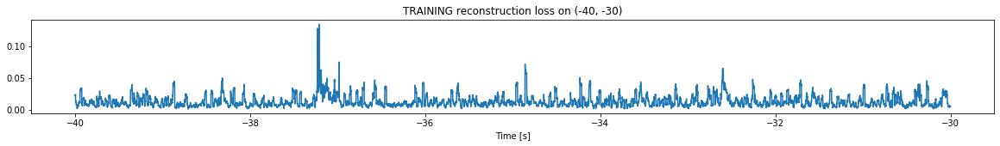

Finished training, median of the log(loss) is:  -1.9709401893222345
Triggering for section:  (-30, -20)
Using this median for triggering: -1.6252217272698886


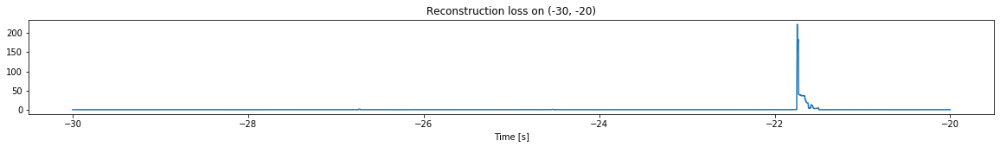

Other trigger time:  [-21.7433]
Their log loss values are:  [3.97321375]


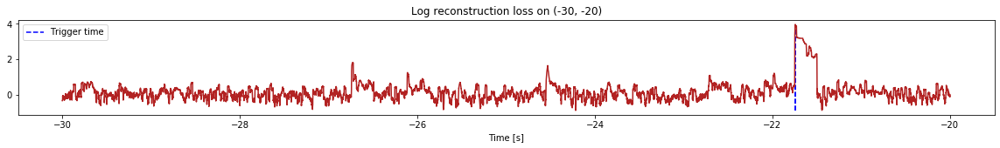

Triggered at:  [-21.7433]
<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


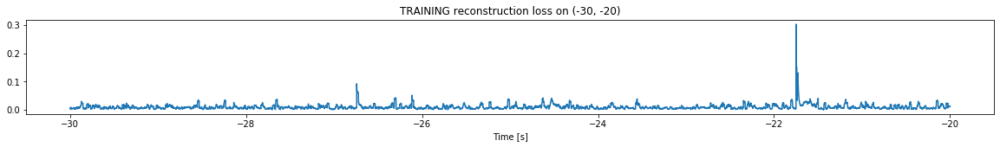

Finished training, median of the log(loss) is:  -2.094958547958294
Triggering for section:  (-20, -10)
Using this median for triggering: -1.9709401893222345


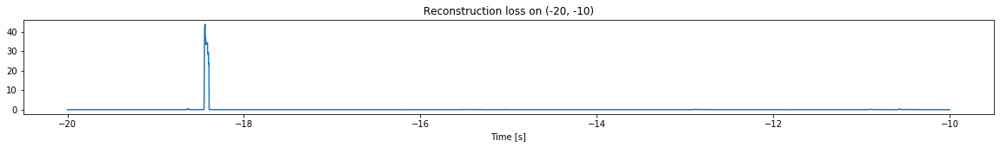

Other trigger time:  [-18.4389]
Their log loss values are:  [3.6125355]


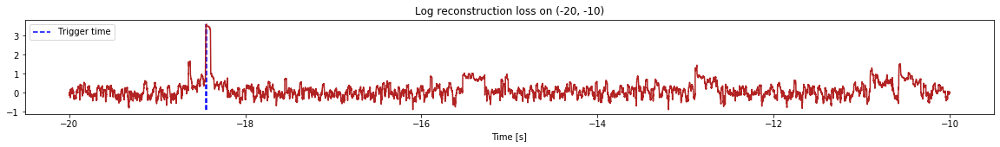

Triggered at:  [-18.4389]
<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


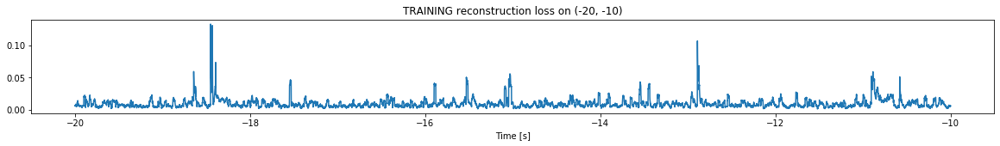

Finished training, median of the log(loss) is:  -2.127606735506806
Triggering for section:  (-10, 0)
Using this median for triggering: -2.094958547958294


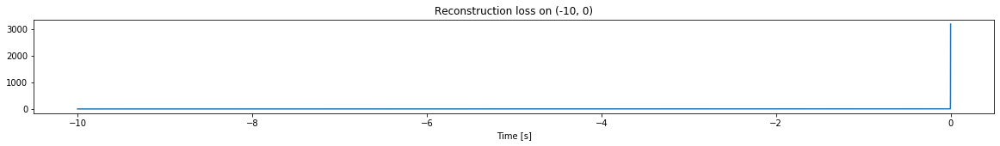

Other trigger time:  []
Their log loss values are:  []


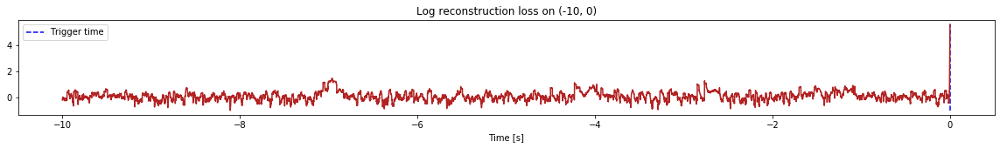

Triggered at:  []
<--------
Finished simulation, all the triggered times are:  [-21.7433, -18.4389]


In [43]:
simulation("./data/Ramp27/", 10, (-70,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (599800, 13)
Flushing input history
Number of sections: 6
Entering sections:  (-60, -50)
-------->
Entering sections:  (-50, -40)
-------->
Training for section:  (None, -50)


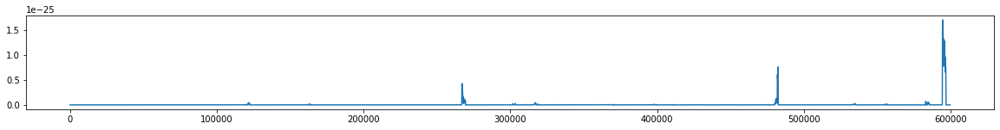

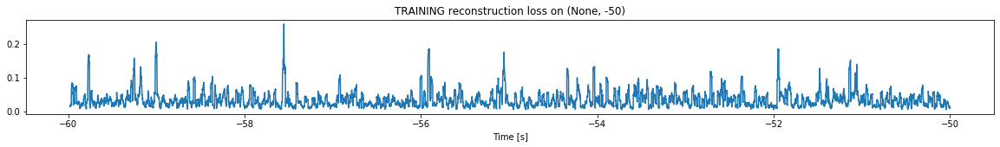

Finished training, median of the log(loss) is:  -1.5320652356270337
<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


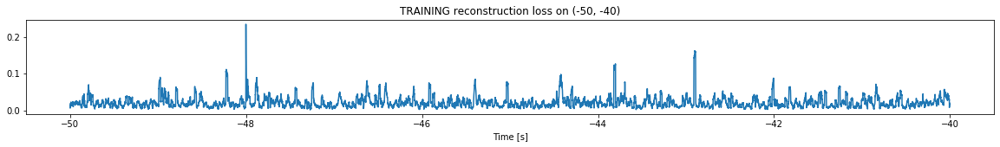

Finished training, median of the log(loss) is:  -1.7254019887544227
Triggering for section:  (-40, -30)
Using this median for triggering: -1.5320652356270337


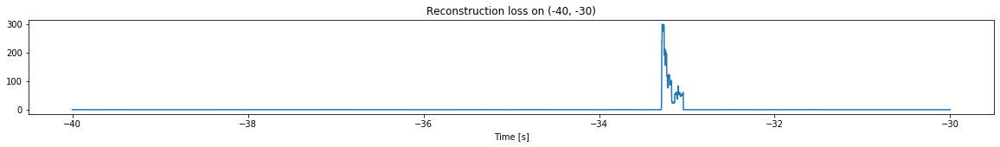

Other trigger time:  [-33.2817]
Their log loss values are:  [4.00691772]


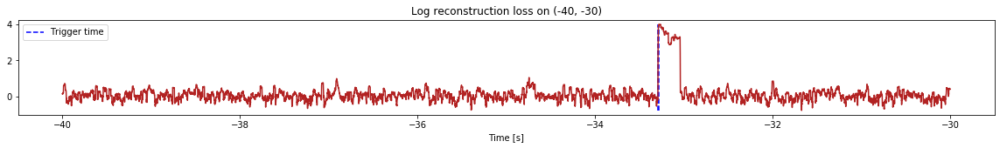

Triggered at:  [-33.2817]
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


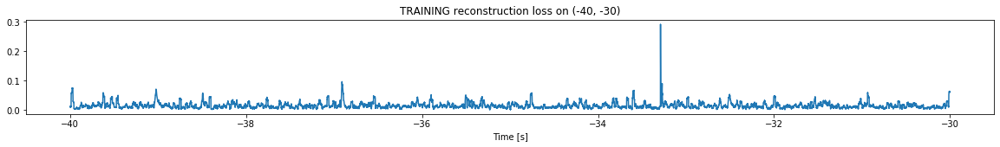

Finished training, median of the log(loss) is:  -1.8650330780201467
Triggering for section:  (-30, -20)
Using this median for triggering: -1.7254019887544227


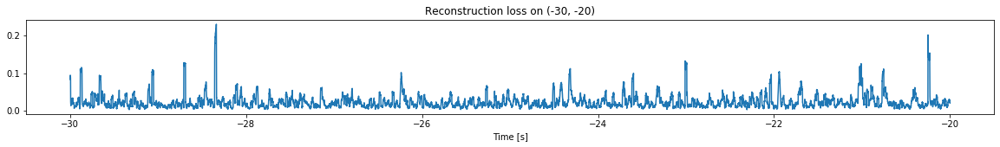

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


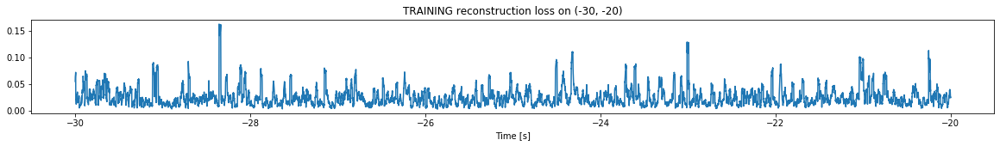

Finished training, median of the log(loss) is:  -1.6715279962854304
Triggering for section:  (-20, -10)
Using this median for triggering: -1.8650330780201467


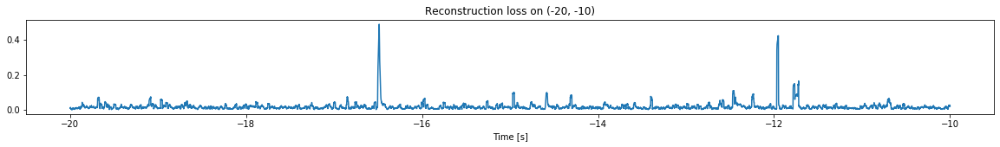

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


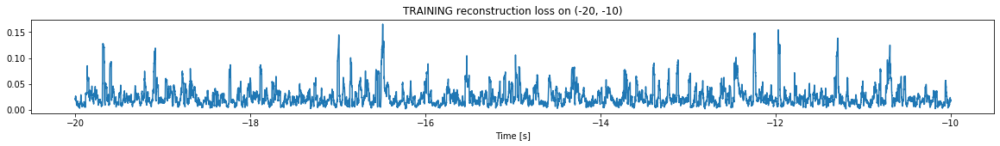

Finished training, median of the log(loss) is:  -1.6810265092557146
Triggering for section:  (-10, 0)
Using this median for triggering: -1.6715279962854304


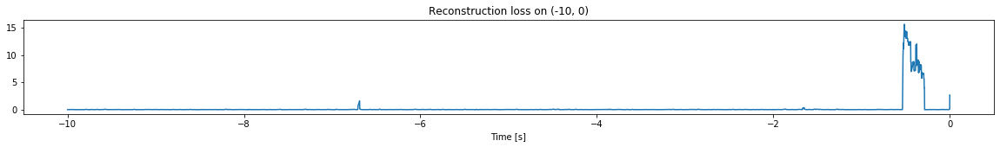

<--------
Finished simulation, all the triggered times are:  [-33.2817]


In [44]:
simulation("./data/Ramp28/", 10, (-60,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (999800, 13)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


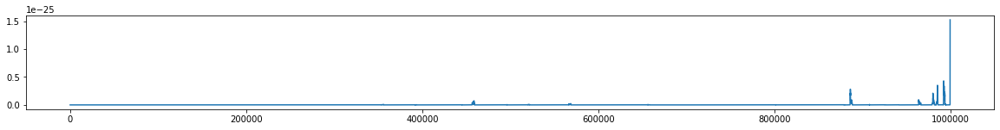

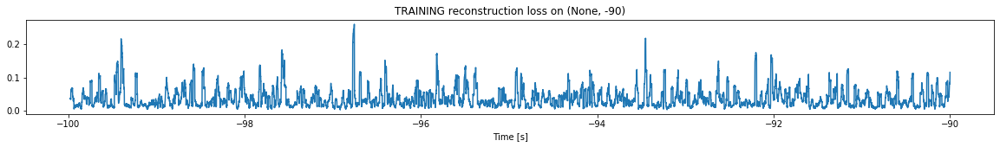

Finished training, median of the log(loss) is:  -1.5281353236730653
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


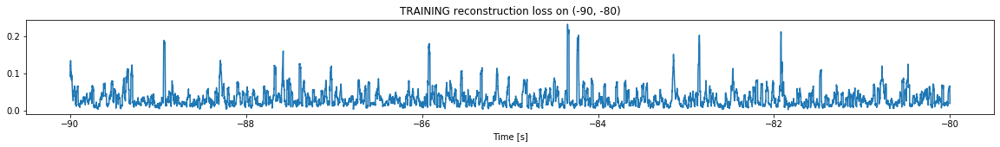

Finished training, median of the log(loss) is:  -1.5632463606652398
Triggering for section:  (-80, -70)
Using this median for triggering: -1.5281353236730653


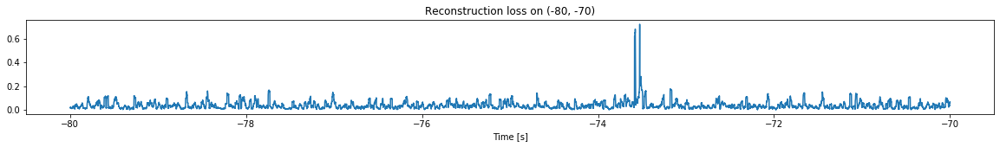

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


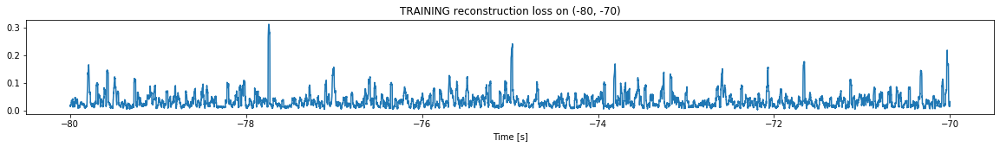

Finished training, median of the log(loss) is:  -1.538494561374586
Triggering for section:  (-70, -60)
Using this median for triggering: -1.5632463606652398


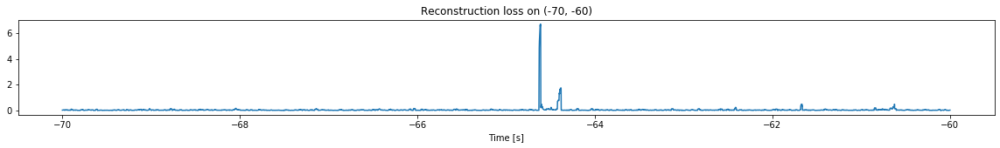

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


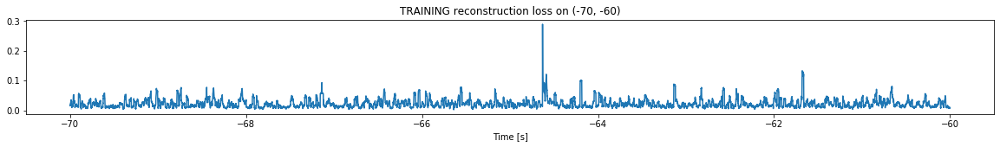

Finished training, median of the log(loss) is:  -1.7239401019850409
Triggering for section:  (-60, -50)
Using this median for triggering: -1.538494561374586


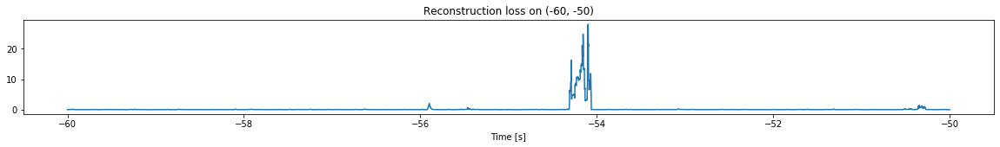

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


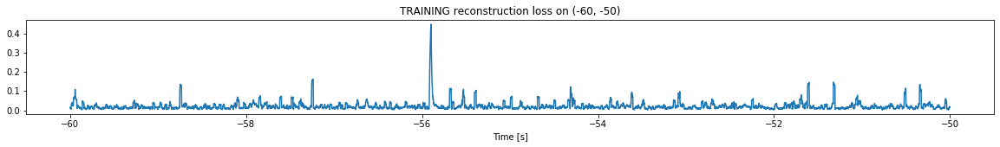

Finished training, median of the log(loss) is:  -1.7778544298593124
Triggering for section:  (-50, -40)
Using this median for triggering: -1.7239401019850409


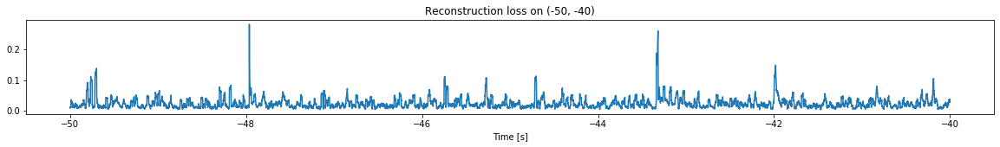

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


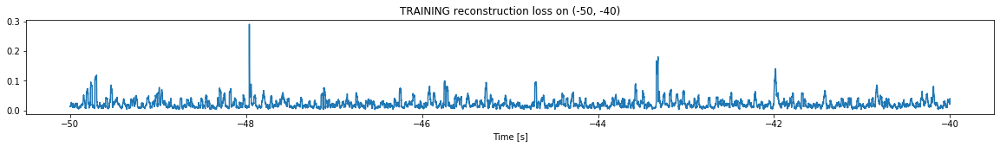

Finished training, median of the log(loss) is:  -1.7178170851913013
Triggering for section:  (-40, -30)
Using this median for triggering: -1.7778544298593124


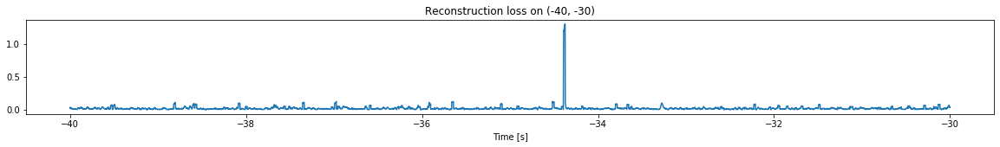

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


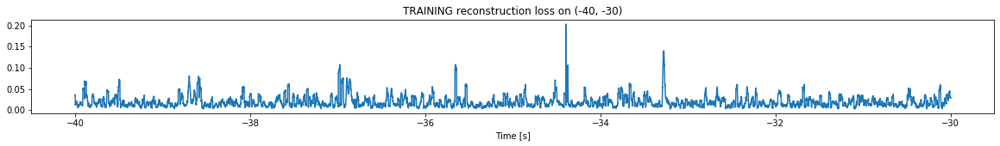

Finished training, median of the log(loss) is:  -1.7980368548253343
Triggering for section:  (-30, -20)
Using this median for triggering: -1.7178170851913013


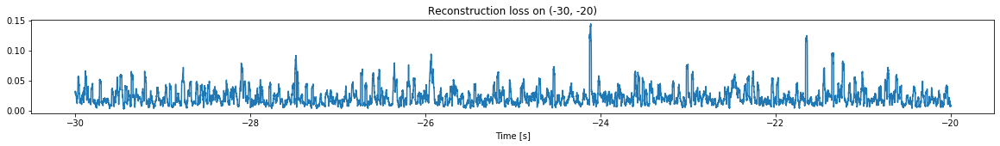

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


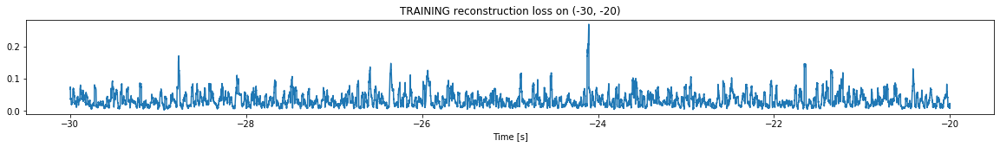

Finished training, median of the log(loss) is:  -1.5321225261012068
Triggering for section:  (-20, -10)
Using this median for triggering: -1.7980368548253343


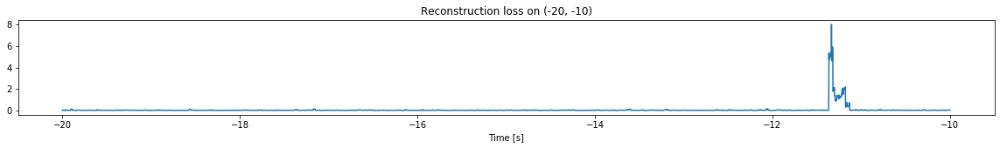

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


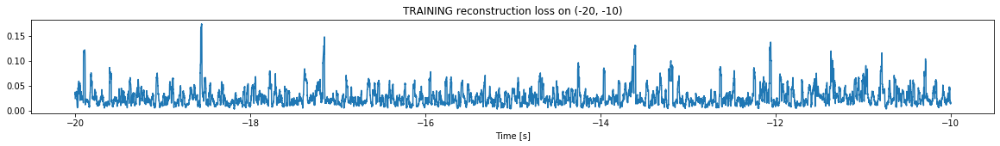

Finished training, median of the log(loss) is:  -1.6445263828737129
Triggering for section:  (-10, 0)
Using this median for triggering: -1.5321225261012068


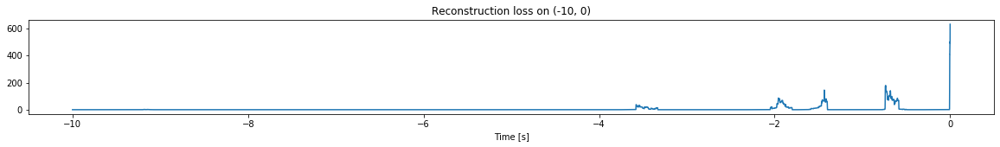

Other trigger time:  [-1.9577999e+00 -1.4339000e+00 -7.3390001e-01 -5.9999997e-04]
Their log loss values are:  [3.46713421 3.69416787 3.78097294 4.23819935]


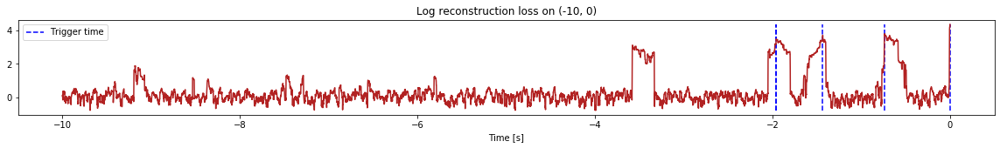

Triggered at:  [-1.9577999, -1.4339, -0.7339, -0.00059999997]
<--------
Finished simulation, all the triggered times are:  [-1.9577999, -1.4339, -0.7339, -0.00059999997]


In [45]:
simulation("./data/Ramp29/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1199800, 13)
Flushing input history
Number of sections: 12
Entering sections:  (-120, -110)
-------->
Entering sections:  (-110, -100)
-------->
Training for section:  (None, -110)


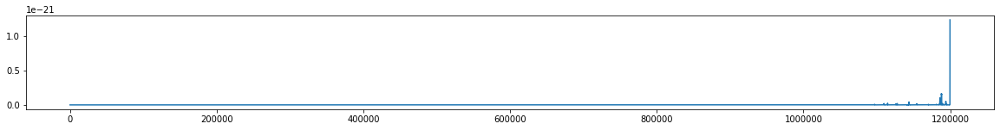

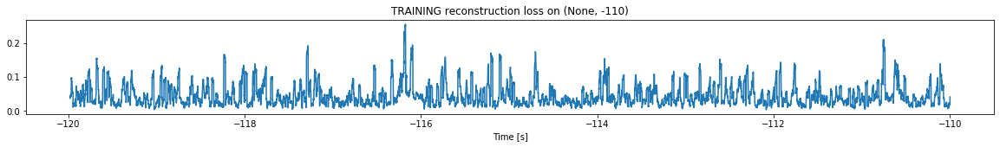

Finished training, median of the log(loss) is:  -1.426101327153083
<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


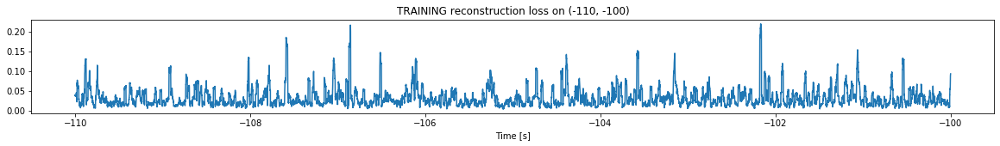

Finished training, median of the log(loss) is:  -1.5801424600906817
Triggering for section:  (-100, -90)
Using this median for triggering: -1.426101327153083


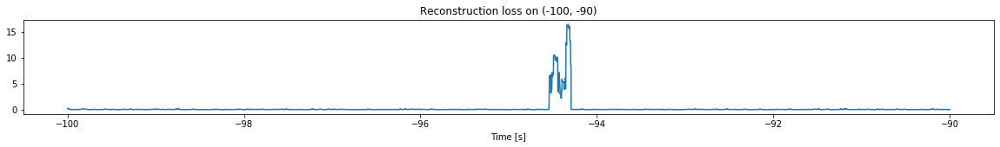

<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


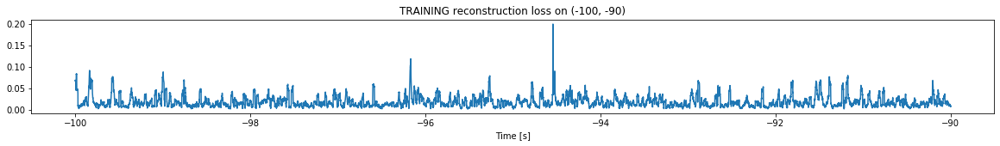

Finished training, median of the log(loss) is:  -1.80564076184976
Triggering for section:  (-90, -80)
Using this median for triggering: -1.5801424600906817


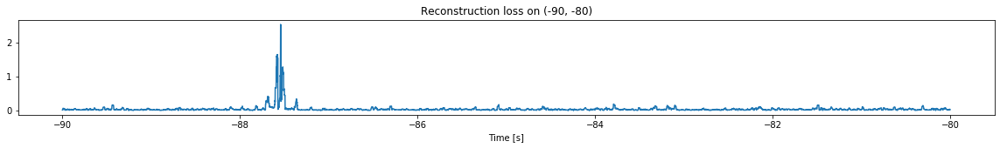

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


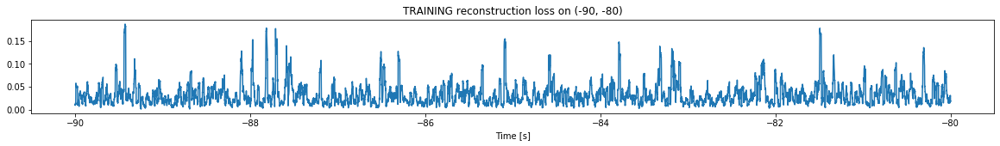

Finished training, median of the log(loss) is:  -1.5570176563085993
Triggering for section:  (-80, -70)
Using this median for triggering: -1.80564076184976


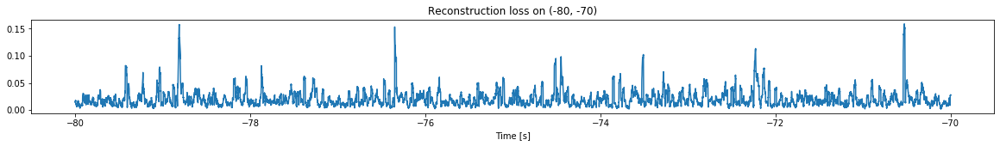

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


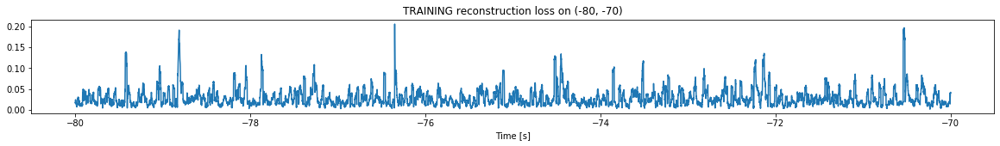

Finished training, median of the log(loss) is:  -1.623125384636365
Triggering for section:  (-70, -60)
Using this median for triggering: -1.5570176563085993


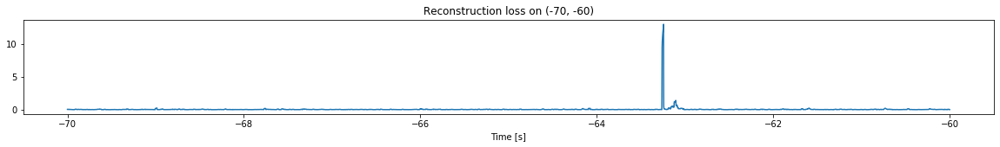

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


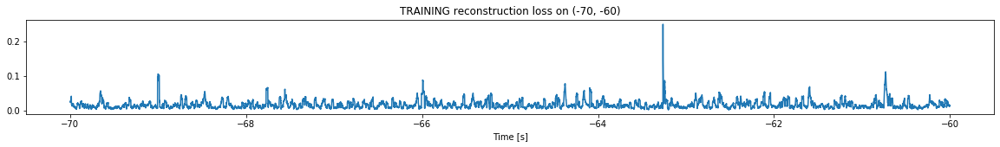

Finished training, median of the log(loss) is:  -1.8641541909131438
Triggering for section:  (-60, -50)
Using this median for triggering: -1.623125384636365


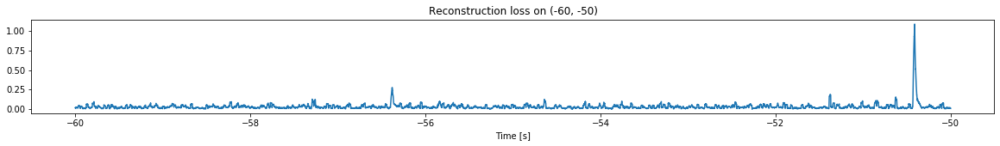

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


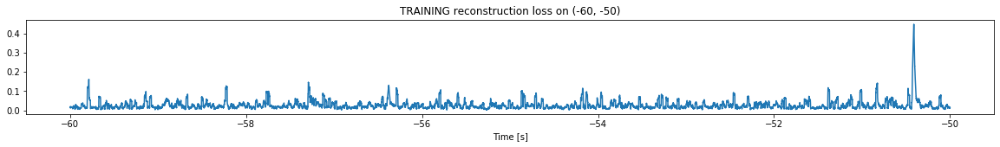

Finished training, median of the log(loss) is:  -1.6819328531165036
Triggering for section:  (-50, -40)
Using this median for triggering: -1.8641541909131438


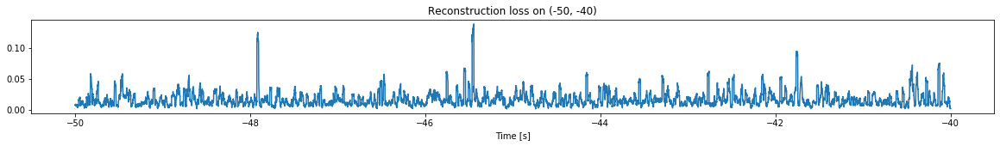

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


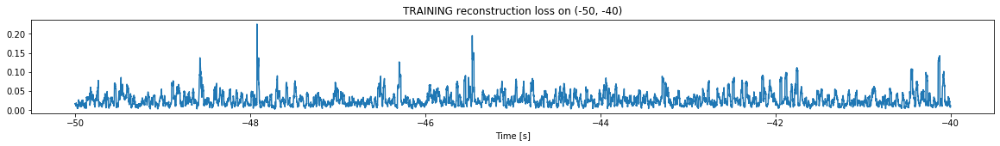

Finished training, median of the log(loss) is:  -1.619926997651721
Triggering for section:  (-40, -30)
Using this median for triggering: -1.6819328531165036


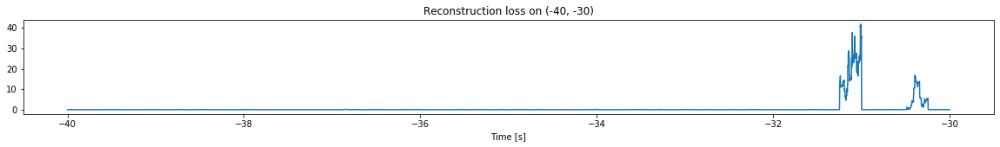

Other trigger time:  [-31.007898]
Their log loss values are:  [3.30307422]


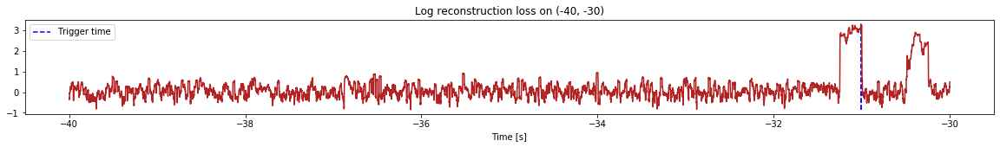

Triggered at:  [-31.007898]
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


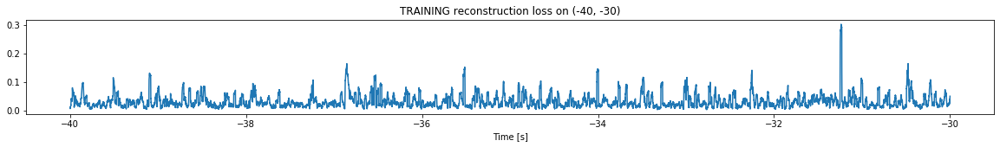

Finished training, median of the log(loss) is:  -1.5758589174854403
Triggering for section:  (-30, -20)
Using this median for triggering: -1.619926997651721


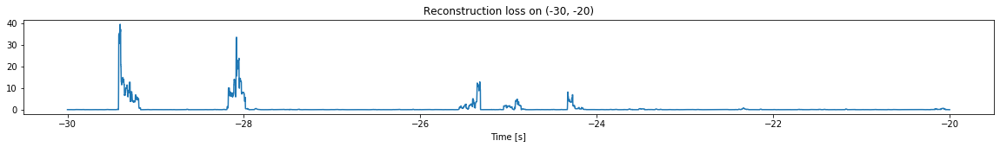

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


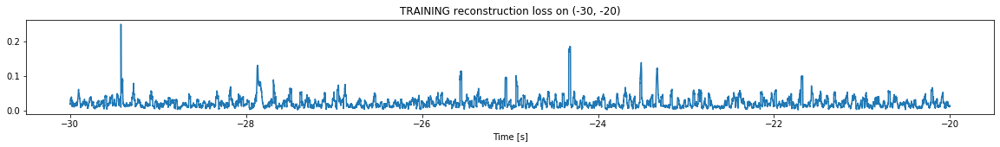

Finished training, median of the log(loss) is:  -1.7114409528606054
Triggering for section:  (-20, -10)
Using this median for triggering: -1.5758589174854403


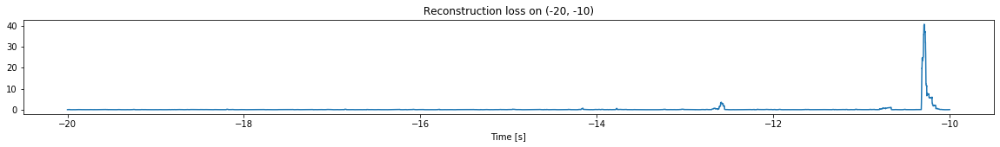

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


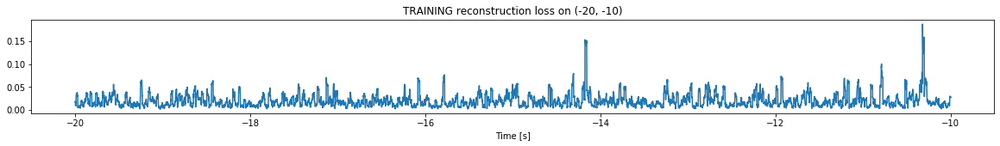

Finished training, median of the log(loss) is:  -1.7762316069654918
Triggering for section:  (-10, 0)
Using this median for triggering: -1.7114409528606054


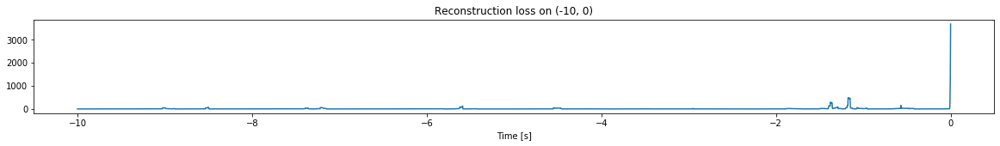

Other trigger time:  [-9.011499e+00 -8.498500e+00 -7.212000e+00 -5.588900e+00 -4.542400e+00
 -1.173700e+00 -5.686000e-01 -1.100000e-03]
Their log loss values are:  [3.48074071 3.56682982 3.49241631 3.81326924 3.39488095 4.40038587
 3.90215783 5.17629954]


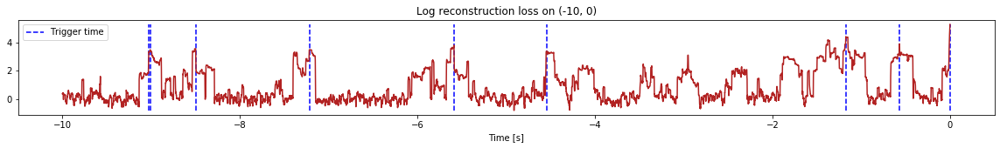

Triggered at:  [-9.011499, -8.4985, -7.212, -5.5889, -4.5424, -1.1737, -0.5686, -0.0011]
<--------
Finished simulation, all the triggered times are:  [-31.007898, -9.011499, -8.4985, -7.212, -5.5889, -4.5424, -1.1737, -0.5686, -0.0011]


In [46]:
simulation("./data/Ramp30/", 10, (-120,0))

-------------------

In [11]:
def load_sensor(dir_path, sensor, time_range = None):
    
    data = pd.DataFrame(data = {sensor: np.load(dir_path + sensor + ".npy"),
                                "time": np.load(dir_path + "time.npy")})
    
    start = min(data["time"])
    end = max(data["time"])
    
    if time_range:
        start = time_range[0]
        end = time_range[1]
    
    
    data = data[(data["time"] > start) & (data["time"] < end)]
   
    %reset -f in
    
    return data[sensor]

def load_time_label(dir_path, time_range, window = 2000, step = 10):
    
    time_label =  np.load(dir_path + "time.npy")
    
    start = min(time_label)
    end = max(time_label)
    
    if time_range:
        start = time_range[0]
        end = time_range[1]
    
    
    time_label = time_label[(time_label > start) & (time_label < end)][window-1::step]
    
    %reset -f in
    
    return time_label

#### Mean of abs(signal)
def generate_mean_data(dir_path, time_range, window = 2000, step = 10):
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    
    #Calculate the product
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_mean = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_mean

#### SD of signal
def generate_sd_data(dir_path, time_range, window = 2000, step = 10):
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    
    #Calculate the product
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_sd = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_sd

#### Thresholded zero crossings
def zero_crossings(array):
    
    #Set values outside of range (0.001, 0.1) = 0
    array[abs(array) > 0.1] = 0
    array[abs(array) < 0.005] = 0
    
    #Calculate number of zero-crossing points, normalized by the window size
    zero_crossings = ((array[:-1] * array[1:]) < 0).sum()/array.size
    
    return zero_crossings


def generate_crossings_data(dir_path, time_range = None, window = 5000, step = 10):
    
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_crossings = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_crossings

def load_thres_product(dir_path, time_range):
    #load time axis
    time_axis = load_time_label(dir_path, time_range = (-200,0), window = 25000, step = 10)
    
    #Load data
    product_data = np.load(dir_path+"cross-product.npy")
    
    #return the data in time_range
    selection_index = (time_axis > time_range[0]) & (time_axis < time_range[1]) 
    %reset -f in
    
    return product_data[selection_index][:, np.newaxis]


def generate_data(dir_path, time_range, window = 2000, step = 10):
    
    #Selection index due to using different window
    #selection_index = int((thres_win - window)/step)
    
    moving_mean = generate_mean_data(dir_path, time_range, window = window, step = step) ##!!!!!! CAREFUL
    moving_sd = generate_sd_data(dir_path, time_range, window = window, step = step)
    time_label = load_time_label(dir_path, time_range, window = window, step = step)
    moving_thres_crossings = load_thres_product(dir_path, time_range = (time_label.min() - 1e-4, time_label.max()))
    
    
    all_data = np.concatenate((moving_mean, moving_sd, moving_thres_crossings), axis = 1)
    
    print("All data's shape: ", all_data.shape)
    
    plt.figure(figsize=(20,2))
    plt.plot(all_data[:,12])
    
    %reset -f in
    
    return all_data, time_label

#####-------INCREMENTAL LEARNING IMPLEMENTATION-------######

def create_model():
    
    #================BUILD THE MODEL====================
    # Simple model
    # Simple model
    model = models.Sequential()

    model.add(Dense(6, activation = 'elu', kernel_initializer='glorot_uniform',
                    kernel_regularizer=regularizers.l2(0.0),
                    input_dim=13))

    model.add(Dense(3,activation='elu',
                    kernel_initializer='glorot_uniform'))

    model.add(Dense(6,activation='elu',
                    kernel_initializer='glorot_uniform'))

    model.add(Dense(13,
                    kernel_initializer='glorot_uniform'))

    model.compile(loss='mse',optimizer='adam')


    return model

def train(current_weights, X, time_axis, time_range):
    """Take a model, train it in the appropritate time range, return the new weights
    and its reconstruction loss distribution"""
    
    print("Training for section: ", time_range)
    #Select the appropriate time
    start_index = None
    
    if time_range[0] is not None:
        start_index = np.argmax(time_axis > time_range[0])
    else:
        start_index = 0
    
    if time_range[1] == 0:
        end_index = None
    else:
        end_index = np.argmax(time_axis > time_range[1])
    
    X_train = np.copy(X[start_index:end_index])
    time_train = time_axis[start_index:end_index]
    
    #Create model
    model = create_model()
    
    if current_weights:
        model.set_weights(current_weights)
    
    #Scaler initiation
    scaler = MinMaxScaler()
    scaler.fit(X_train)
    X_train = scaler.transform(X_train)
    
    X_train[:,12] = X_train[:,12]*5 #More importance in product of zero-crossings
    
    #Train the model and extract new weights
    model.fit(X_train, X_train,
              batch_size=2000,
              epochs=30, verbose = 0)
    
    new_weights = model.get_weights()
    
    #Evaluate the losses and update the distribution
    X_pred = model.predict(X_train)
    loss = np.mean(np.abs(X_pred-X_train), axis = 1)
    
    #Plot the reconstruction loss
    plt.figure(figsize=(20,2))
    plt.plot(time_train, loss)
    plt.title("TRAINING reconstruction loss on {}".format(time_range))
    plt.xlabel("Time [s]")
    plt.show()
    
    #Take the mean of the log loss and update the mean threshold
    current_median = np.median(np.log10(loss))
    
    print("Finished training, median of the log(loss) is: ", current_median)
    
    return new_weights, current_median, scaler

def trigger(current_weights, X, time_axis, time_range, prev_median, scaler):
    
    print("Triggering for section: ", time_range)
    print("Using this median for triggering:", prev_median)
    
    #Select the appropriate time
    start_index = None
    
    if time_range[0] is not None:
        start_index = np.argmax(time_axis > time_range[0])
    else:
        start_index = 0
    
    if time_range[1] == 0:
        end_index = None
    else:
        end_index = np.argmax(time_axis > time_range[1])
    
    time_test = time_axis[start_index:end_index]
    X_test = np.copy(X[start_index:end_index])
    
    X_test = scaler.transform(X_test) #Scale the current data
    X_test[:,12] = X_test[:,12]*5 #Put more importance on the product of zero crossings
    
    #Create model
    model = create_model()
    model.set_weights(current_weights)
        
    #Find the test loss (doing this in parallel for the sake of simulation), but in a practical system
    #Ideally we need to do inference every single data point come in
    X_pred_test = model.predict(X_test)
    test_loss = np.mean(np.abs(X_pred_test-X_test), axis = 1)
    
    
    #Plot the reconstruction loss just to check
    plt.figure(figsize=(20,2))
    plt.plot(time_test, test_loss)
    plt.title("Reconstruction loss on {}".format(time_range))
    plt.xlabel("Time [s]")
    plt.show()
    
    #Quantify how much each data point is far away from the distribution
    log_test_loss = np.log10(test_loss) - prev_median
    
    #Find the trigger time
    trigger_index = np.argmax(log_test_loss > 3.3)
    
    if  trigger_index != 0:
        #Plot the triggered time
        plt.figure(figsize=(20,2))
        plt.plot(time_test, log_test_loss, color = "firebrick")
        plt.title("Log reconstruction loss on {}".format(time_range))
        plt.xlabel("Time [s]")
        
        #Trigger time
        plt.vlines(time_test[trigger_index], log_test_loss.min(), log_test_loss.max(), color = "blue", linestyles = "dashed", label = "Trigger time")
        plt.legend(loc = "upper left")
        
        
        ### Find trigger times
        peaks, _ = find_peaks(log_test_loss, height=3.3, distance = 5000)
        print("Other trigger time: ", time_test[peaks])
        print("Their log loss values are: ", log_test_loss[peaks])
        
        for i in range(len(peaks)):
            plt.vlines(time_test[peaks[i]], log_test_loss.min(), log_test_loss.max(), color = "blue", linestyles = "dashed")
            
        plt.show()
        
        return list(time_test[peaks])
    
    else:
        return None
    

def simulation(dir_path, section_size, time_range):
    
    #Load data and create the model
    X, time_axis = generate_data(dir_path, time_range = time_range, window = 2000, step = 10)
    
    #For updating model
    current_weights = None
    new_weights = None
    
    #For keeping track of distribution history
    prev_median = None
    updated_median = None
    
    #Keeping track of scaler after training
    past_scaler = None
    
    #Calculate number of sections
    num_section = int(abs(time_range[0])/section_size)
    print("Number of sections:", num_section)
    
    #Keeping log of all the trigger time
    trigger_log = []
    
    #Sequentially go through the data
    for i in range(num_section):
        
        print("Entering sections: ", (-section_size*(num_section - i), -section_size*(num_section - i - 1)))
        print("-------->")
        
        if i == 0:
            continue
        elif i == 1:
            #Train on the first segment
            time_range = (None, -section_size*(num_section - i))
            new_weights, updated_median, new_scaler = train(current_weights, X, time_axis, time_range)
        else:
            
            #Set previous distrubution to the newly trained disttribution
            prev_median = updated_median
            current_scaler = new_scaler
            current_weights = new_weights
            
            #Selecting appropriate time range for training and triggering
            train_time_range = (-section_size*(num_section - i + 1), -section_size*(num_section - i))
            trigger_time_range = (-section_size*(num_section - i), -section_size*(num_section - i - 1))
            
            #Train and predict simutaneously
            new_weights, updated_median, new_scaler = train(current_weights, X, time_axis, train_time_range)
            trigger_time = trigger(current_weights, X, time_axis, trigger_time_range, prev_median, current_scaler)
            
            if trigger_time is not None:
                print("Triggered at: ", trigger_time)
                trigger_log.extend(trigger_time)
        
        print("<--------")
        
    print("Finished simulation, all the triggered times are: ", trigger_log)

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (899800, 13)
Flushing input history
Number of sections: 9
Entering sections:  (-90, -80)
-------->
Entering sections:  (-80, -70)
-------->
Training for section:  (None, -80)


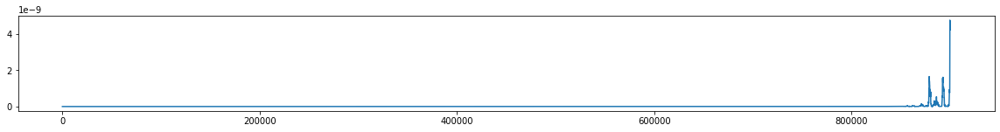

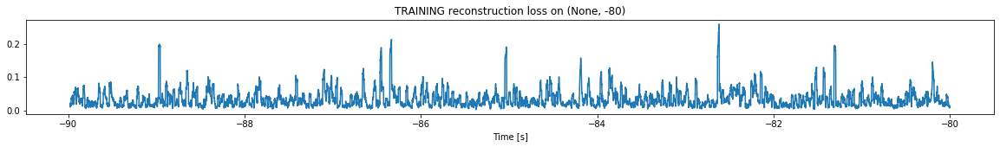

Finished training, median of the log(loss) is:  -1.5491155380500734
<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


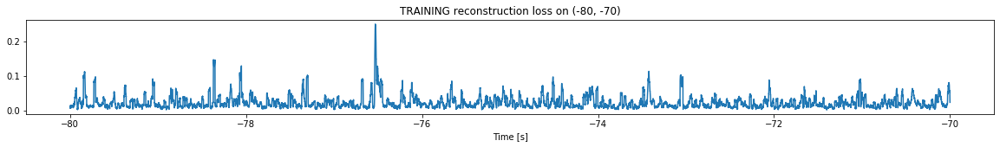

Finished training, median of the log(loss) is:  -1.7596641364125154
Triggering for section:  (-70, -60)
Using this median for triggering: -1.5491155380500734


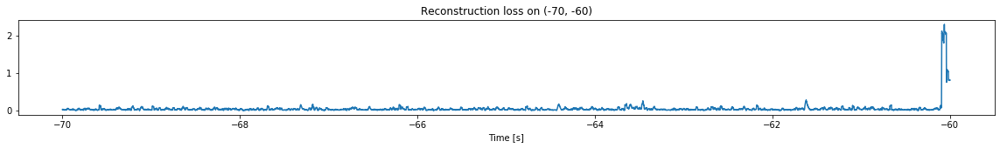

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


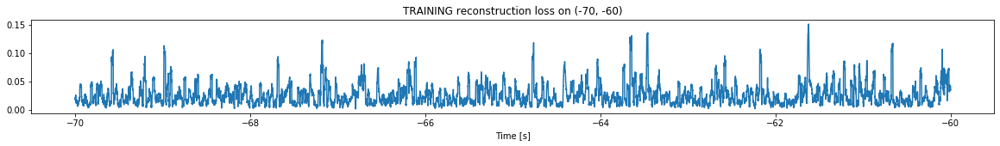

Finished training, median of the log(loss) is:  -1.6523418749103012
Triggering for section:  (-60, -50)
Using this median for triggering: -1.7596641364125154


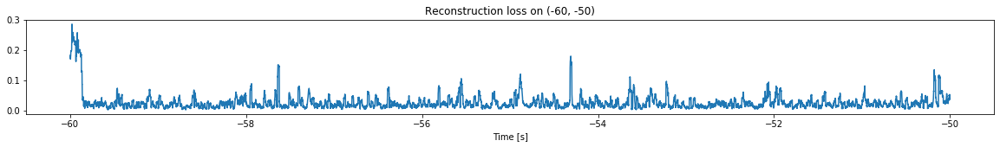

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


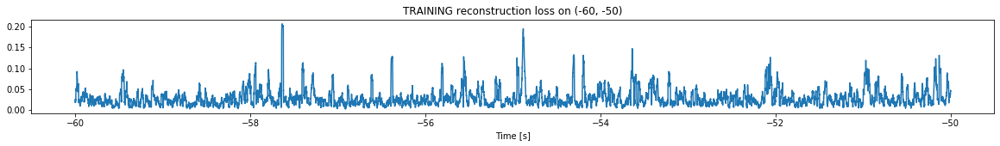

Finished training, median of the log(loss) is:  -1.6239471105593521
Triggering for section:  (-50, -40)
Using this median for triggering: -1.6523418749103012


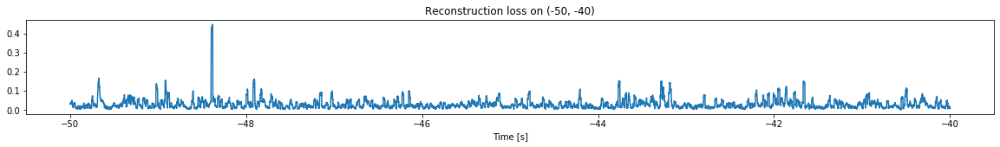

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


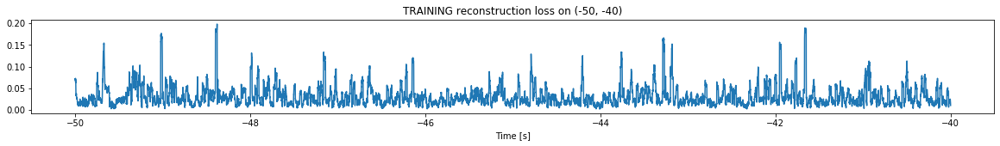

Finished training, median of the log(loss) is:  -1.5858609820137404
Triggering for section:  (-40, -30)
Using this median for triggering: -1.6239471105593521


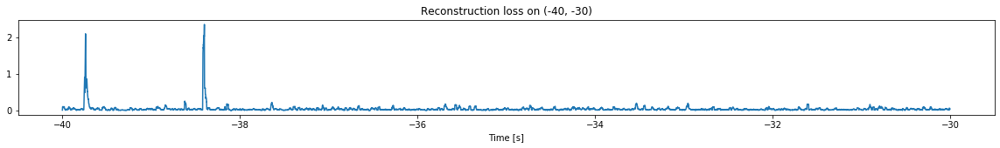

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


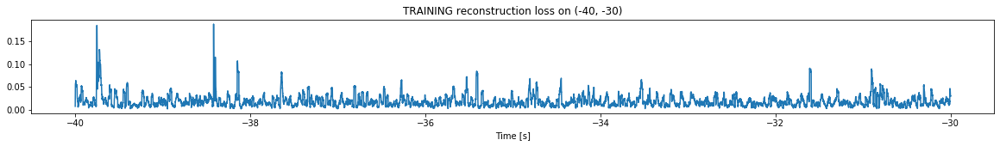

Finished training, median of the log(loss) is:  -1.8088664017791447
Triggering for section:  (-30, -20)
Using this median for triggering: -1.5858609820137404


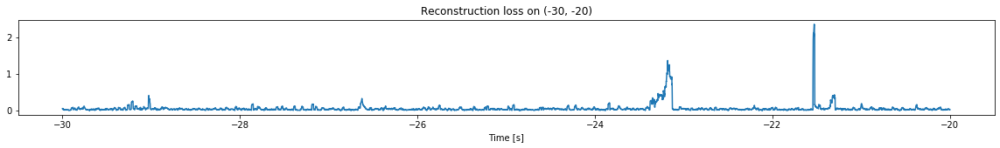

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


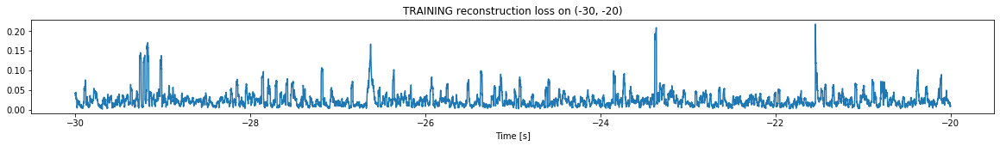

Finished training, median of the log(loss) is:  -1.6823944607259214
Triggering for section:  (-20, -10)
Using this median for triggering: -1.8088664017791447


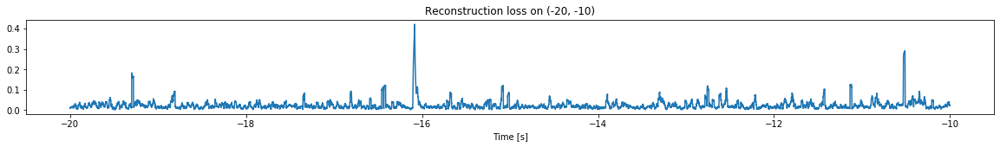

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


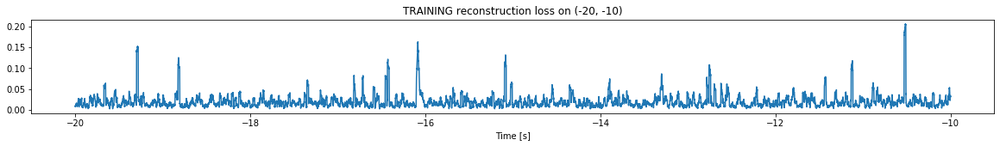

Finished training, median of the log(loss) is:  -1.7833560596920837
Triggering for section:  (-10, 0)
Using this median for triggering: -1.6823944607259214


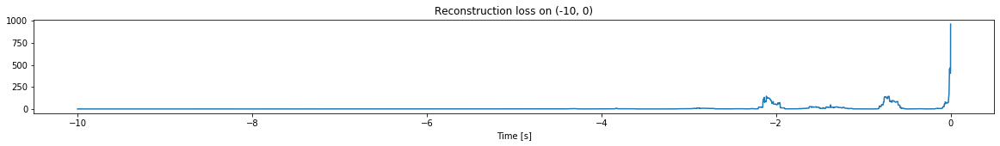

Other trigger time:  [-2.1095 -1.3736 -0.7039 -0.006 ]
Their log loss values are:  [3.84469776 3.35052116 3.83635418 4.35166003]


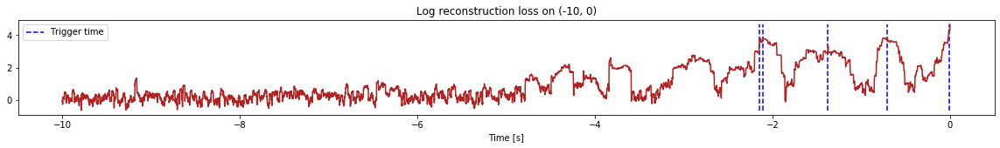

Triggered at:  [-2.1095, -1.3736, -0.7039, -0.006]
<--------
Finished simulation, all the triggered times are:  [-2.1095, -1.3736, -0.7039, -0.006]


In [12]:
simulation("./data/Ramp4/", 10, (-90,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (899800, 13)
Flushing input history
Number of sections: 9
Entering sections:  (-90, -80)
-------->
Entering sections:  (-80, -70)
-------->
Training for section:  (None, -80)


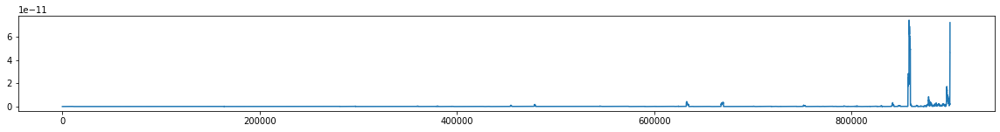

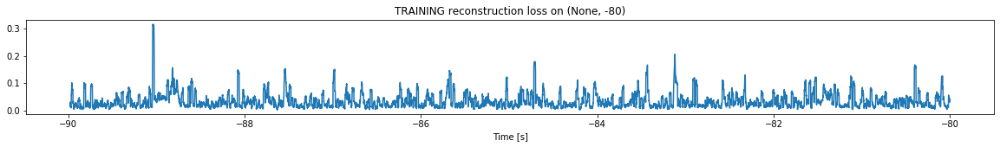

Finished training, median of the log(loss) is:  -1.5471579007397187
<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


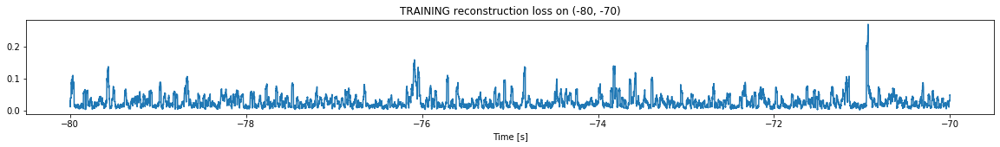

Finished training, median of the log(loss) is:  -1.6616968681090134
Triggering for section:  (-70, -60)
Using this median for triggering: -1.5471579007397187


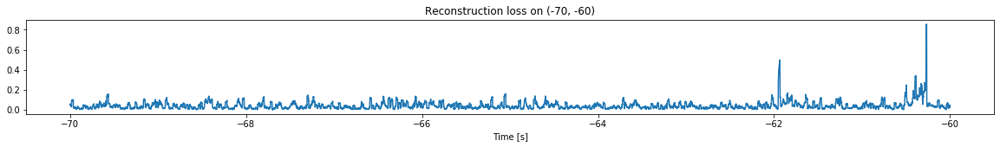

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


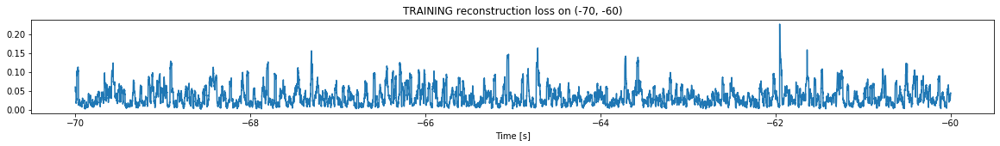

Finished training, median of the log(loss) is:  -1.5218489062320377
Triggering for section:  (-60, -50)
Using this median for triggering: -1.6616968681090134


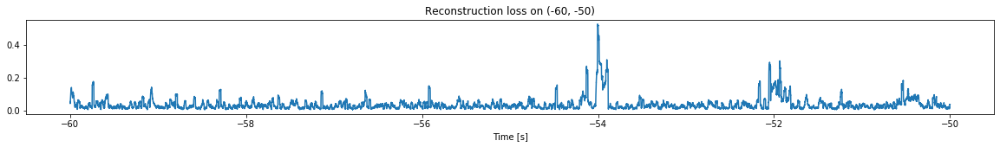

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


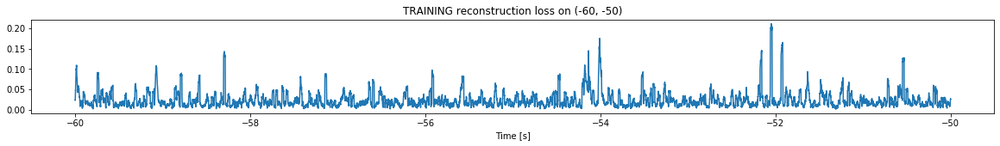

Finished training, median of the log(loss) is:  -1.7302407159538724
Triggering for section:  (-50, -40)
Using this median for triggering: -1.5218489062320377


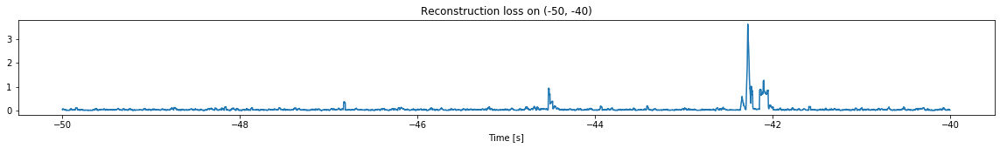

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


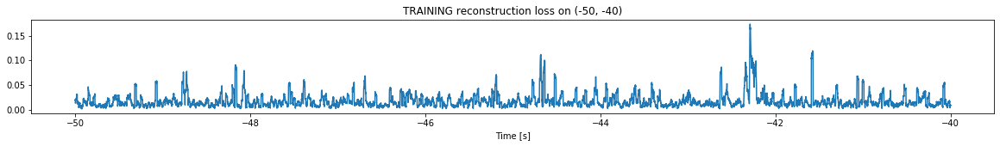

Finished training, median of the log(loss) is:  -1.8503372470963102
Triggering for section:  (-40, -30)
Using this median for triggering: -1.7302407159538724


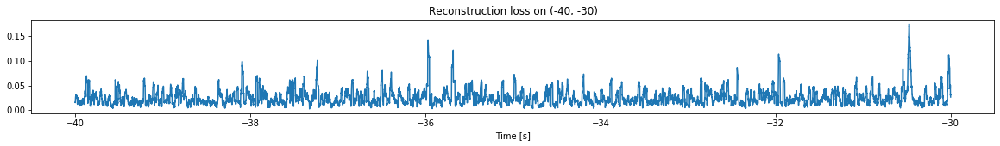

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


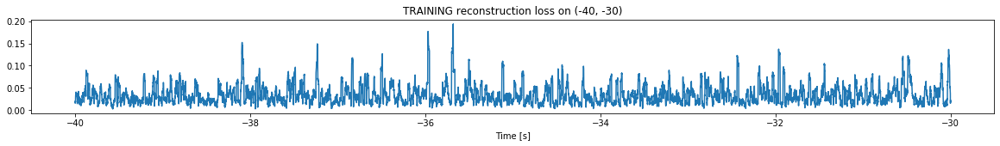

Finished training, median of the log(loss) is:  -1.530582828290625
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8503372470963102


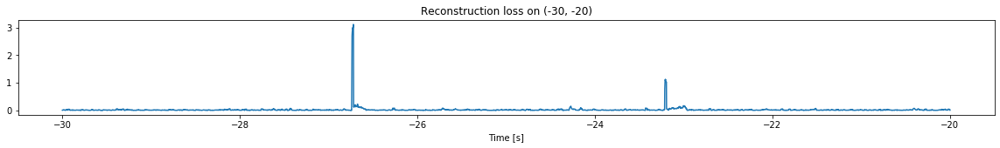

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


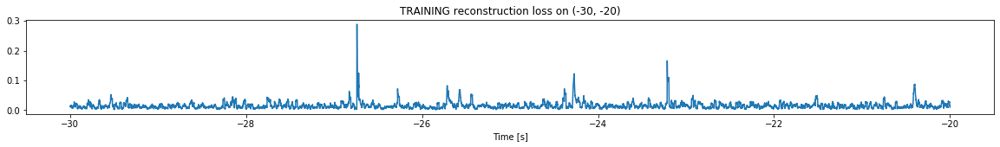

Finished training, median of the log(loss) is:  -1.8844701776978106
Triggering for section:  (-20, -10)
Using this median for triggering: -1.530582828290625


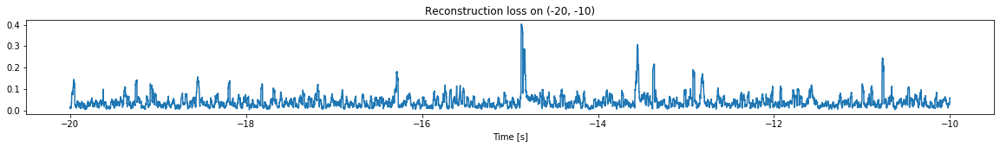

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


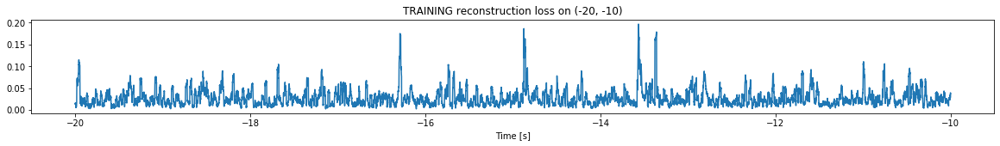

Finished training, median of the log(loss) is:  -1.6205385155740257
Triggering for section:  (-10, 0)
Using this median for triggering: -1.8844701776978106


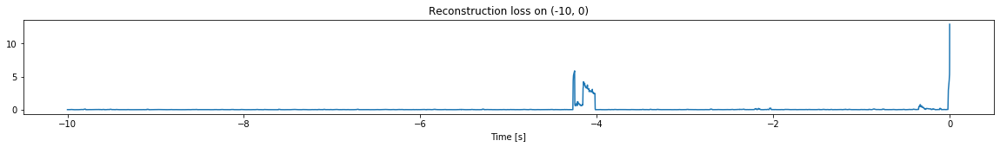

<--------
Finished simulation, all the triggered times are:  []


In [13]:
simulation("./data/Ramp5/", 10, (-90,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (999800, 13)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


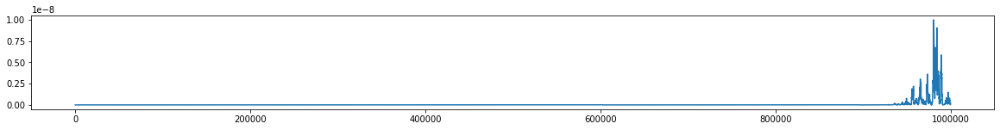

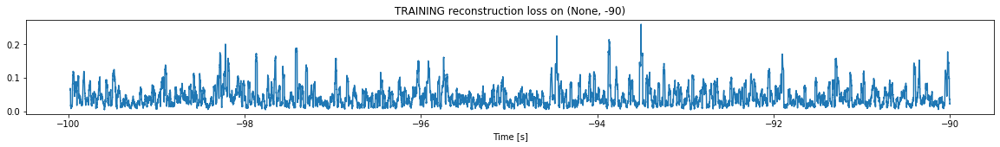

Finished training, median of the log(loss) is:  -1.422843811805323
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


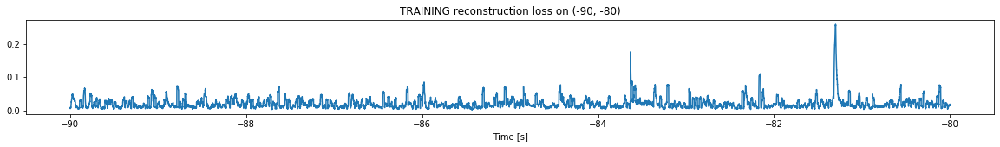

Finished training, median of the log(loss) is:  -1.7846427725798895
Triggering for section:  (-80, -70)
Using this median for triggering: -1.422843811805323


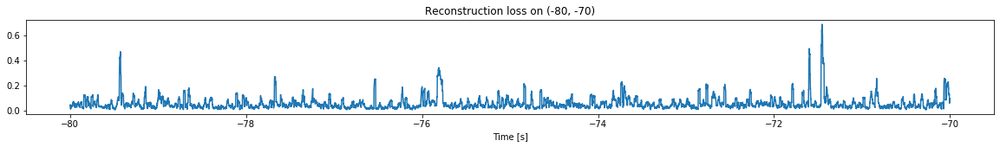

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


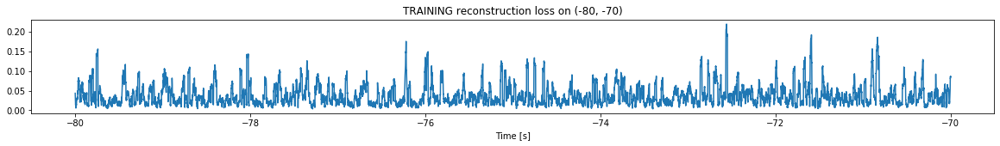

Finished training, median of the log(loss) is:  -1.5151346780980348
Triggering for section:  (-70, -60)
Using this median for triggering: -1.7846427725798895


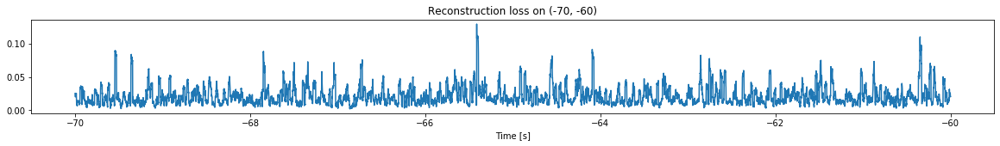

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


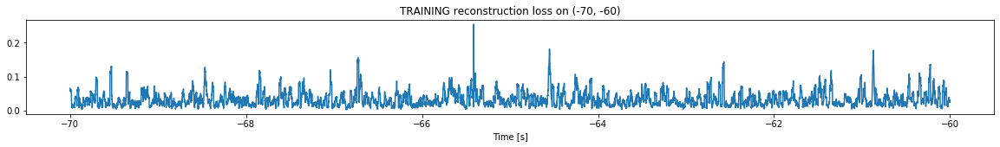

Finished training, median of the log(loss) is:  -1.5448639215827202
Triggering for section:  (-60, -50)
Using this median for triggering: -1.5151346780980348


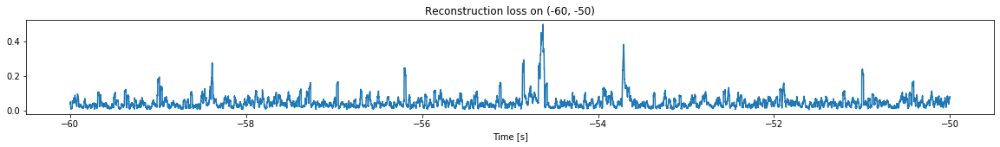

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


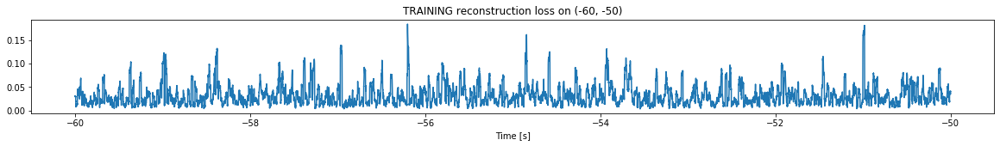

Finished training, median of the log(loss) is:  -1.5656219052065254
Triggering for section:  (-50, -40)
Using this median for triggering: -1.5448639215827202


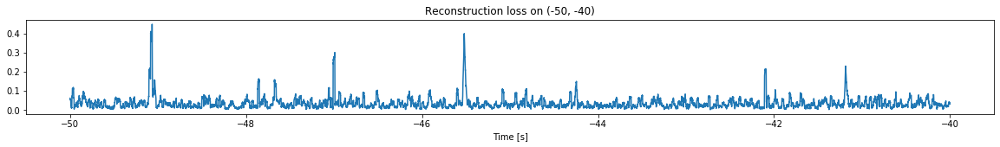

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


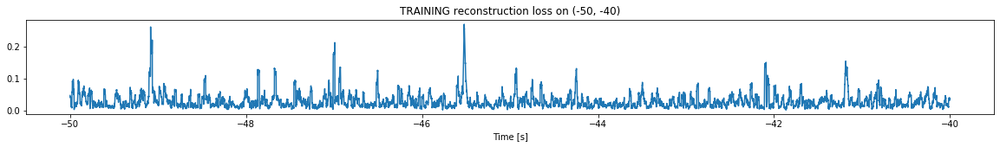

Finished training, median of the log(loss) is:  -1.627661370988091
Triggering for section:  (-40, -30)
Using this median for triggering: -1.5656219052065254


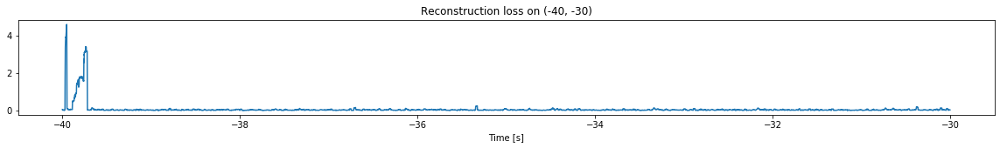

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


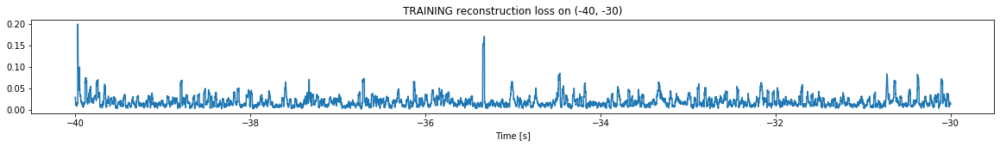

Finished training, median of the log(loss) is:  -1.8092033915194825
Triggering for section:  (-30, -20)
Using this median for triggering: -1.627661370988091


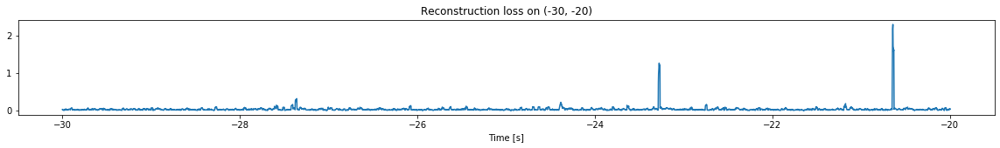

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


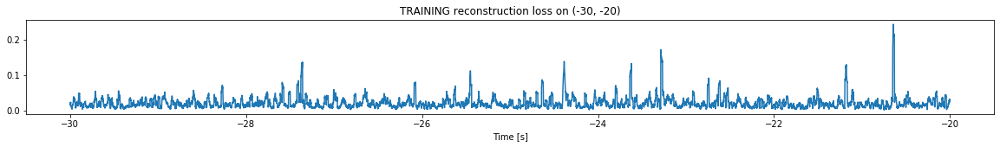

Finished training, median of the log(loss) is:  -1.7424750298947205
Triggering for section:  (-20, -10)
Using this median for triggering: -1.8092033915194825


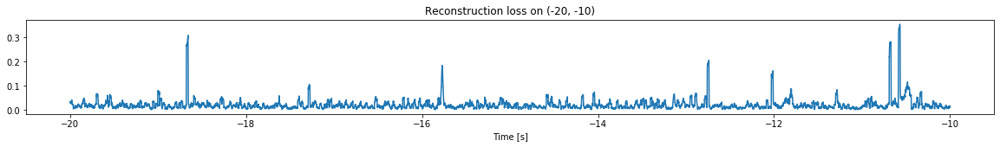

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


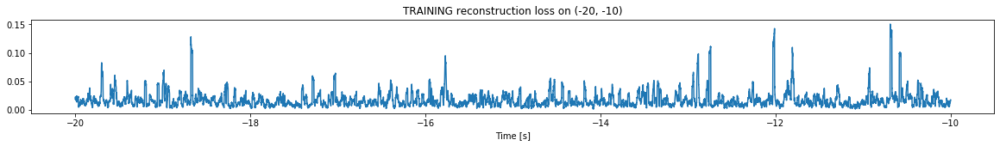

Finished training, median of the log(loss) is:  -1.8411290887645149
Triggering for section:  (-10, 0)
Using this median for triggering: -1.7424750298947205


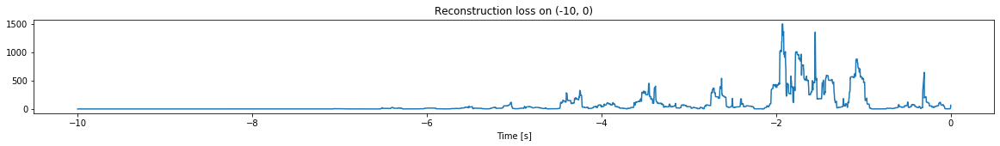

Other trigger time:  [-5.0397997  -4.2481     -3.4557998  -2.6244     -1.9283999  -1.0713999
 -0.30359998]
Their log loss values are:  [3.80586443 4.25742718 4.39817191 4.47482303 4.91670772 4.68528853
 4.55161006]


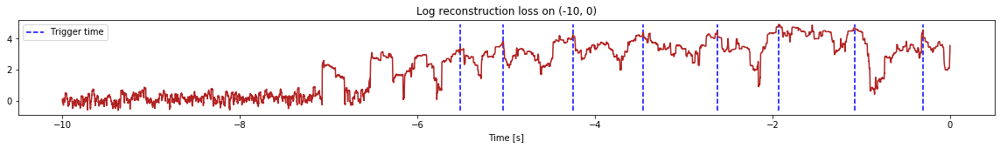

Triggered at:  [-5.0397997, -4.2481, -3.4557998, -2.6244, -1.9283999, -1.0713999, -0.30359998]
<--------
Finished simulation, all the triggered times are:  [-5.0397997, -4.2481, -3.4557998, -2.6244, -1.9283999, -1.0713999, -0.30359998]


In [14]:
simulation("./data/Ramp12d/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1949800, 13)
Flushing input history
Number of sections: 19
Entering sections:  (-190, -180)
-------->
Entering sections:  (-180, -170)
-------->
Training for section:  (None, -180)


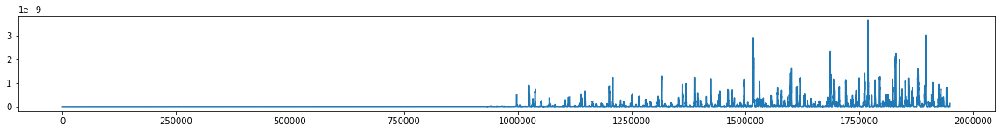

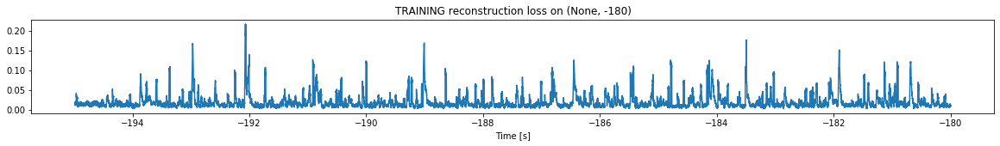

Finished training, median of the log(loss) is:  -1.8743957299645173
<--------
Entering sections:  (-170, -160)
-------->
Training for section:  (-180, -170)


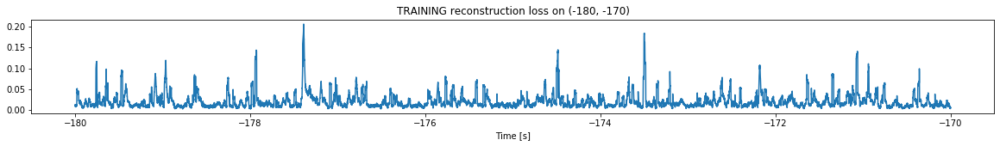

Finished training, median of the log(loss) is:  -1.8015753463459272
Triggering for section:  (-170, -160)
Using this median for triggering: -1.8743957299645173


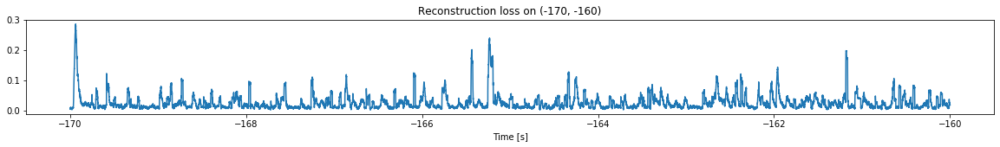

<--------
Entering sections:  (-160, -150)
-------->
Training for section:  (-170, -160)


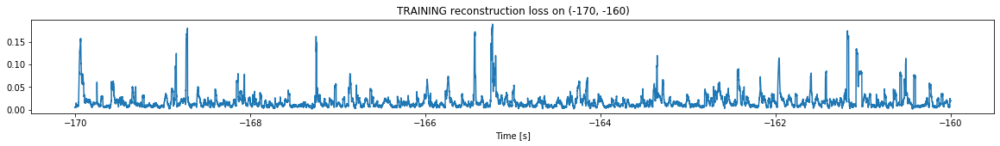

Finished training, median of the log(loss) is:  -1.8659431913562223
Triggering for section:  (-160, -150)
Using this median for triggering: -1.8015753463459272


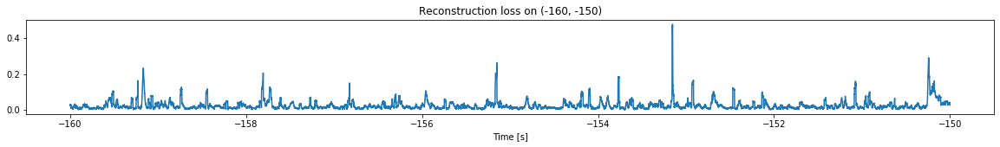

<--------
Entering sections:  (-150, -140)
-------->
Training for section:  (-160, -150)


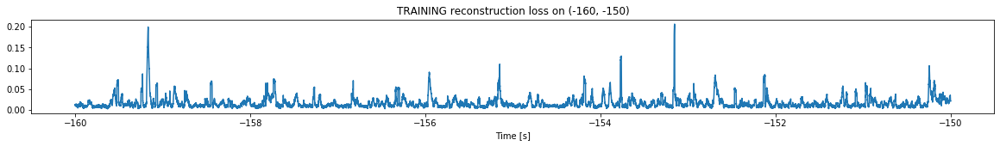

Finished training, median of the log(loss) is:  -1.9118305335337744
Triggering for section:  (-150, -140)
Using this median for triggering: -1.8659431913562223


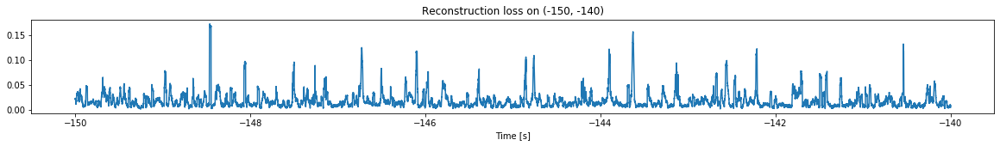

<--------
Entering sections:  (-140, -130)
-------->
Training for section:  (-150, -140)


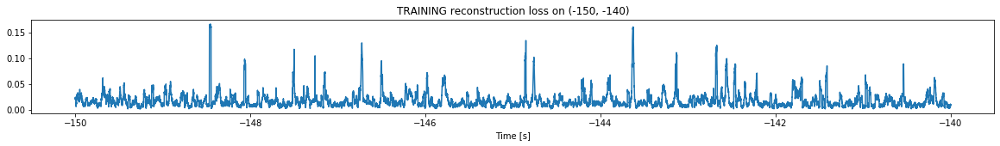

Finished training, median of the log(loss) is:  -1.8385448017843125
Triggering for section:  (-140, -130)
Using this median for triggering: -1.9118305335337744


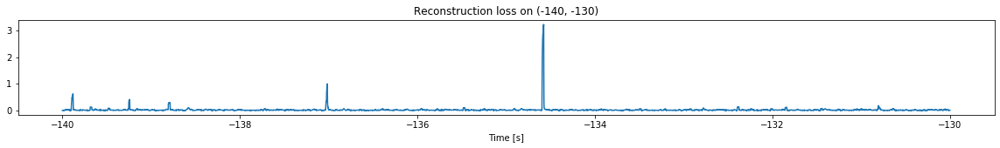

<--------
Entering sections:  (-130, -120)
-------->
Training for section:  (-140, -130)


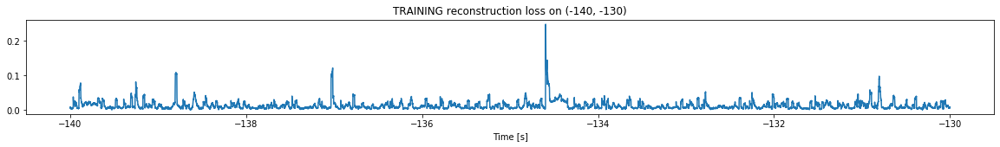

Finished training, median of the log(loss) is:  -2.0026543761326687
Triggering for section:  (-130, -120)
Using this median for triggering: -1.8385448017843125


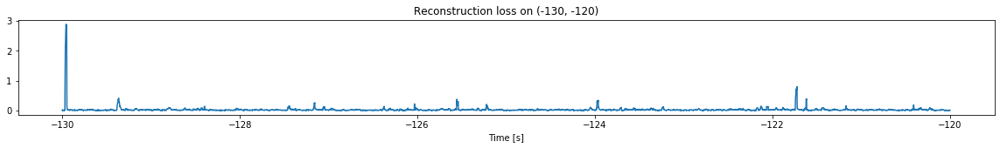

<--------
Entering sections:  (-120, -110)
-------->
Training for section:  (-130, -120)


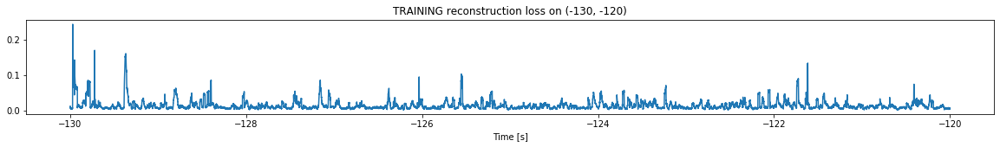

Finished training, median of the log(loss) is:  -1.9933524229815642
Triggering for section:  (-120, -110)
Using this median for triggering: -2.0026543761326687


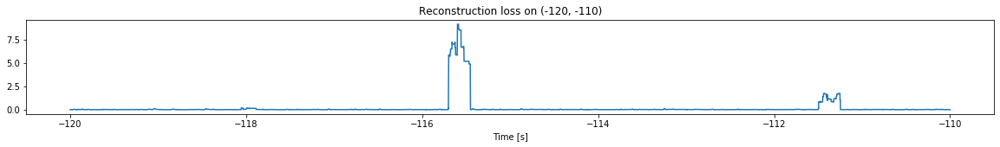

<--------
Entering sections:  (-110, -100)
-------->
Training for section:  (-120, -110)


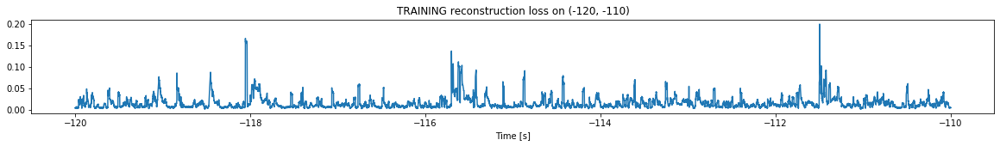

Finished training, median of the log(loss) is:  -1.9370766893620535
Triggering for section:  (-110, -100)
Using this median for triggering: -1.9933524229815642


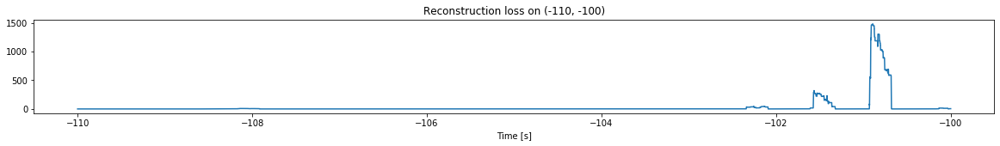

Other trigger time:  [-102.25499  -101.565186 -100.89129 ]
Their log loss values are:  [3.66919067 4.49939096 5.16382388]


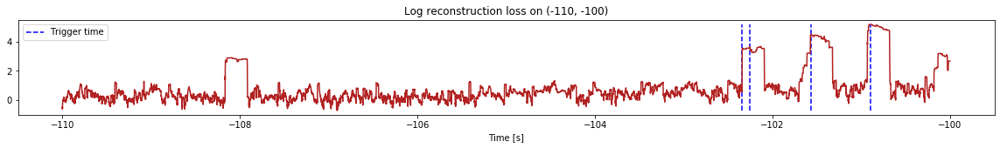

Triggered at:  [-102.25499, -101.565186, -100.89129]
<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


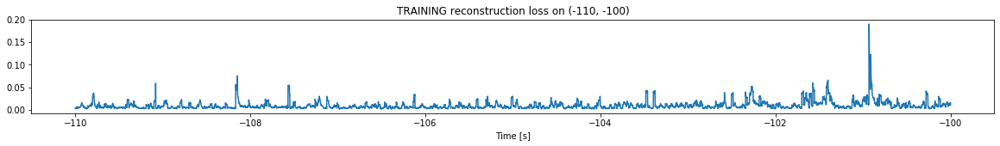

Finished training, median of the log(loss) is:  -2.169726395116144
Triggering for section:  (-100, -90)
Using this median for triggering: -1.9370766893620535


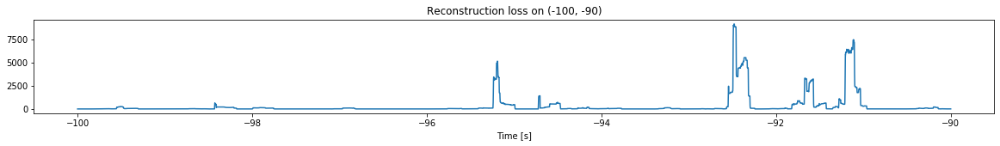

Other trigger time:  [-99.50769  -98.42829  -97.90069  -96.84099  -95.71189  -95.193085
 -94.50299  -93.92869  -93.25049  -92.47909  -91.66909  -91.11309
 -90.18019 ]
Their log loss values are:  [4.34757778 4.75103749 4.08797191 3.97265277 3.61411901 5.64727271
 4.79620685 3.82822932 4.06772891 5.89730538 5.45627297 5.8088902
 4.27565556]


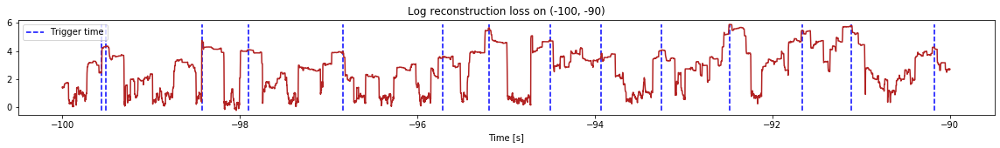

Triggered at:  [-99.50769, -98.42829, -97.90069, -96.84099, -95.71189, -95.193085, -94.50299, -93.92869, -93.25049, -92.47909, -91.66909, -91.11309, -90.18019]
<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


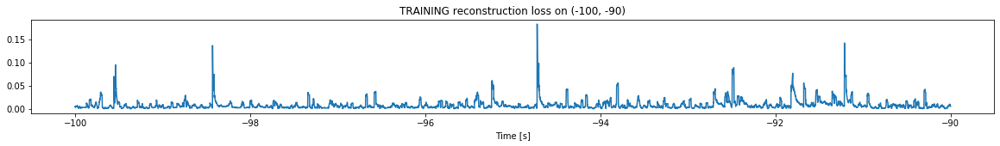

Finished training, median of the log(loss) is:  -2.177452937356305
Triggering for section:  (-90, -80)
Using this median for triggering: -2.169726395116144


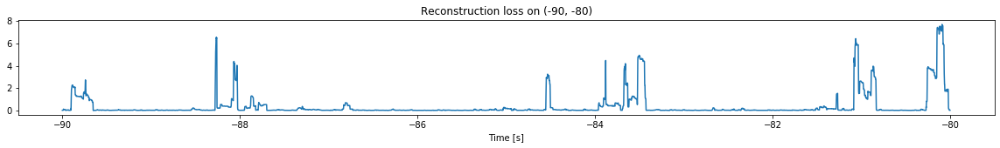

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


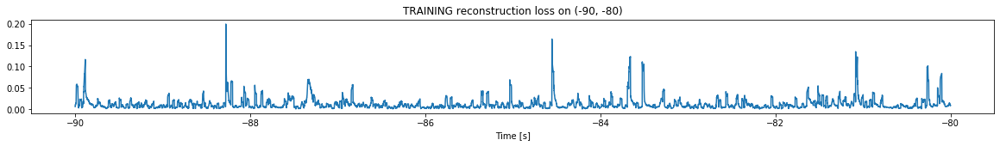

Finished training, median of the log(loss) is:  -2.0508421383918556
Triggering for section:  (-80, -70)
Using this median for triggering: -2.177452937356305


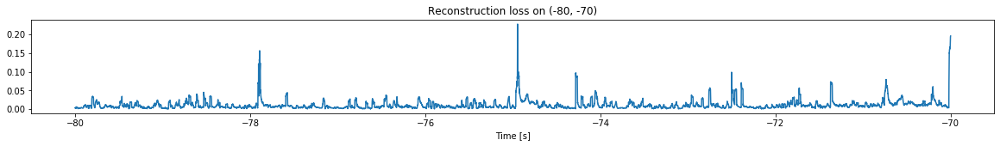

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


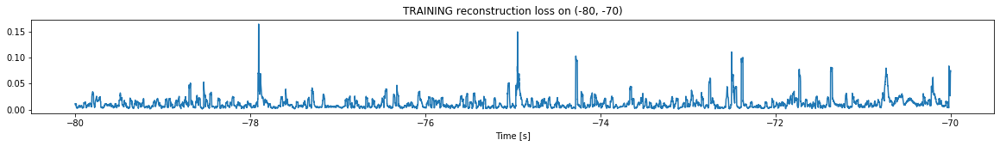

Finished training, median of the log(loss) is:  -2.071805005364118
Triggering for section:  (-70, -60)
Using this median for triggering: -2.0508421383918556


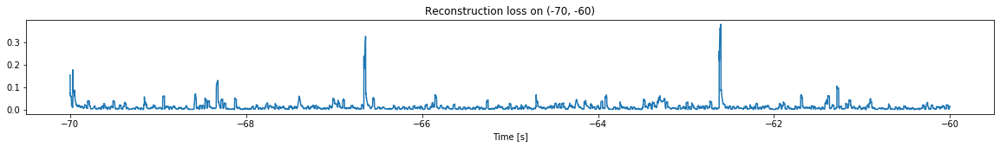

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


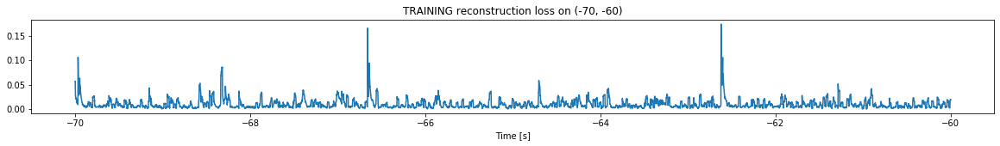

Finished training, median of the log(loss) is:  -2.1072383255732774
Triggering for section:  (-60, -50)
Using this median for triggering: -2.071805005364118


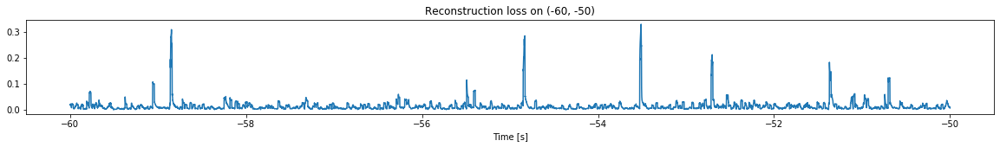

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


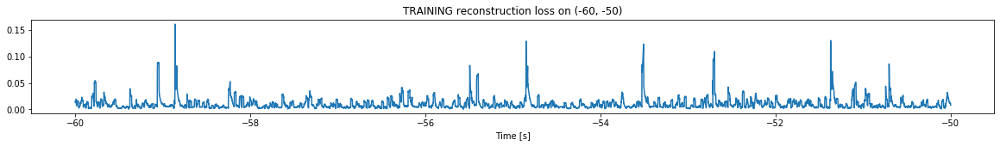

Finished training, median of the log(loss) is:  -2.118963013253704
Triggering for section:  (-50, -40)
Using this median for triggering: -2.1072383255732774


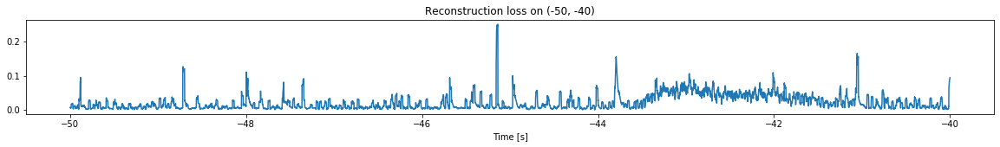

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


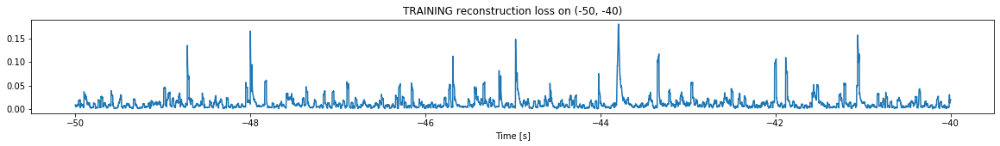

Finished training, median of the log(loss) is:  -2.0352888770346325
Triggering for section:  (-40, -30)
Using this median for triggering: -2.118963013253704


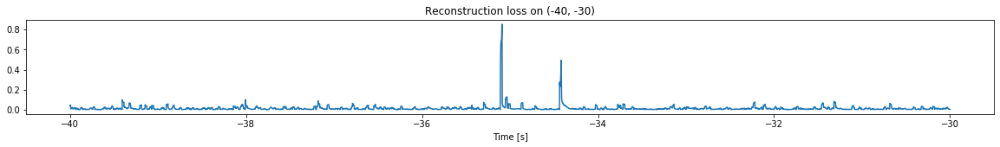

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


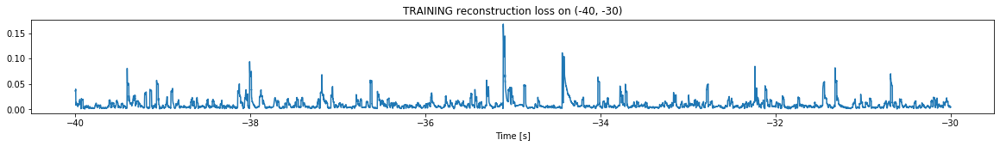

Finished training, median of the log(loss) is:  -2.175628478025696
Triggering for section:  (-30, -20)
Using this median for triggering: -2.0352888770346325


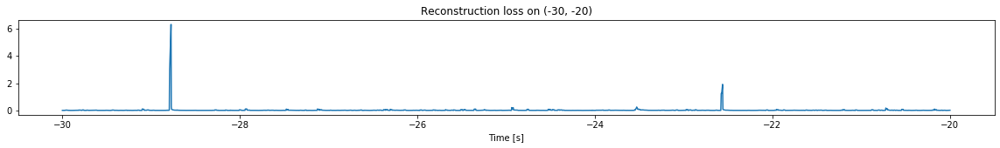

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


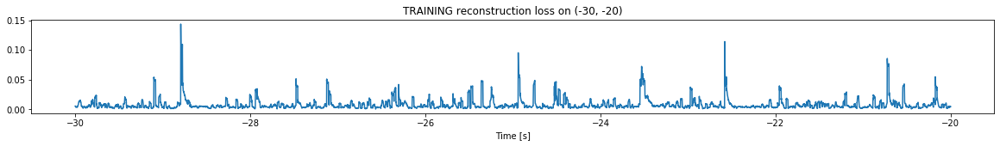

Finished training, median of the log(loss) is:  -2.270376980096365
Triggering for section:  (-20, -10)
Using this median for triggering: -2.175628478025696


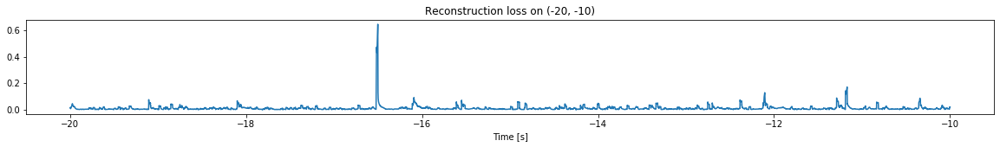

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


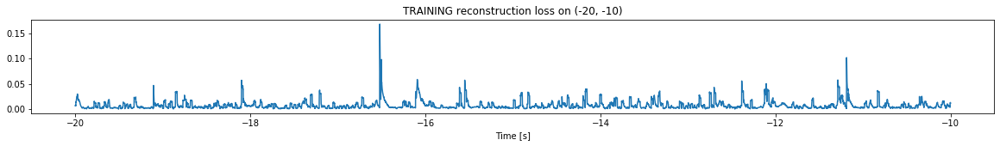

Finished training, median of the log(loss) is:  -2.2643943617901763
Triggering for section:  (-10, 0)
Using this median for triggering: -2.270376980096365


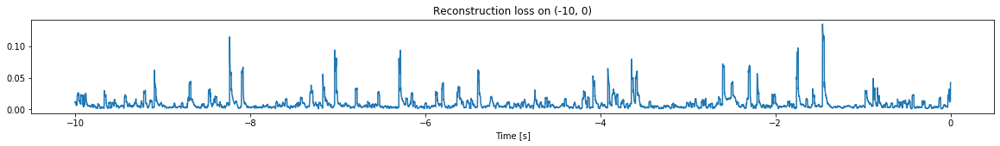

<--------
Finished simulation, all the triggered times are:  [-102.25499, -101.565186, -100.89129, -99.50769, -98.42829, -97.90069, -96.84099, -95.71189, -95.193085, -94.50299, -93.92869, -93.25049, -92.47909, -91.66909, -91.11309, -90.18019]


In [15]:
simulation("./data/Ramp19/", 10, (-195,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1949800, 13)
Flushing input history
Number of sections: 19
Entering sections:  (-190, -180)
-------->
Entering sections:  (-180, -170)
-------->
Training for section:  (None, -180)


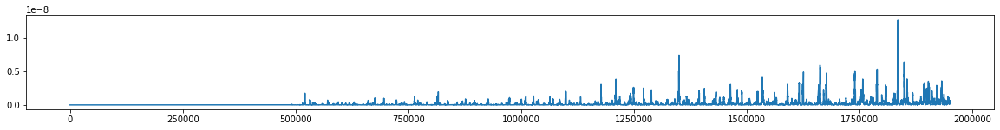

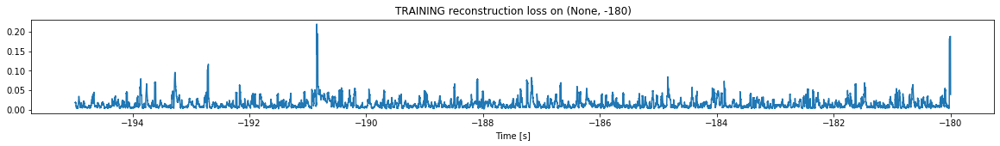

Finished training, median of the log(loss) is:  -1.9550823784963354
<--------
Entering sections:  (-170, -160)
-------->
Training for section:  (-180, -170)


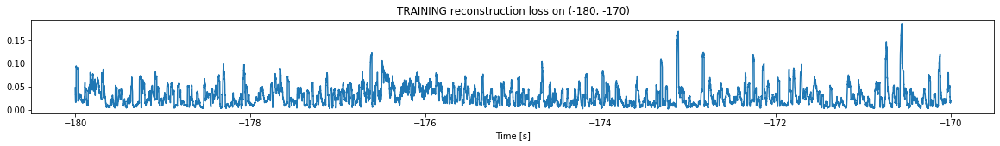

Finished training, median of the log(loss) is:  -1.6054143329403079
Triggering for section:  (-170, -160)
Using this median for triggering: -1.9550823784963354


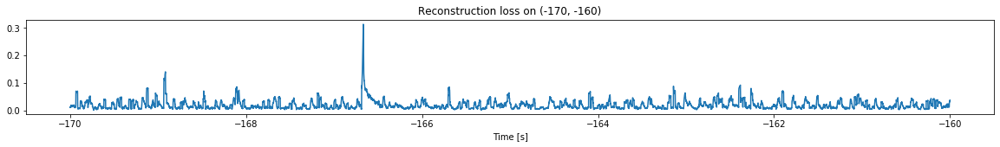

<--------
Entering sections:  (-160, -150)
-------->
Training for section:  (-170, -160)


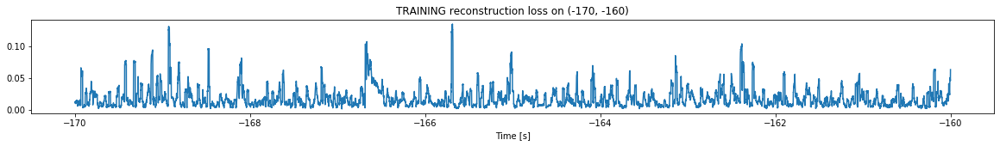

Finished training, median of the log(loss) is:  -1.8402904945718161
Triggering for section:  (-160, -150)
Using this median for triggering: -1.6054143329403079


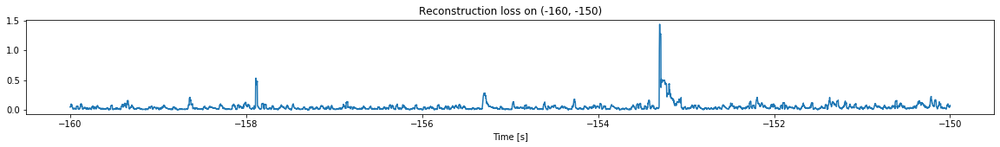

<--------
Entering sections:  (-150, -140)
-------->
Training for section:  (-160, -150)


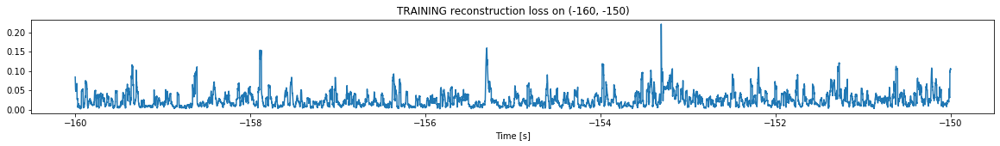

Finished training, median of the log(loss) is:  -1.6874214986955114
Triggering for section:  (-150, -140)
Using this median for triggering: -1.8402904945718161


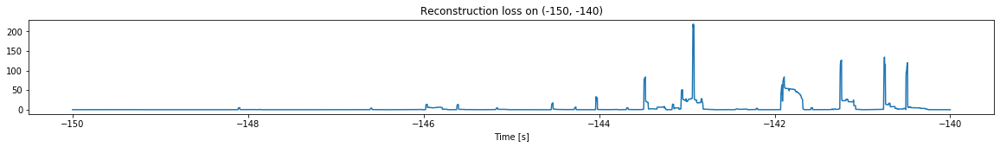

Other trigger time:  [-144.03558 -143.47359 -142.92929 -141.89198 -140.74948]
Their log loss values are:  [3.36370655 3.76321856 4.17989164 3.76405979 3.96903474]


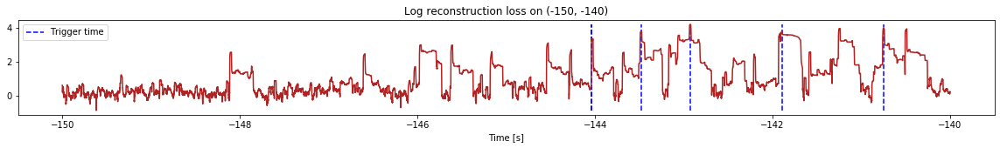

Triggered at:  [-144.03558, -143.47359, -142.92929, -141.89198, -140.74948]
<--------
Entering sections:  (-140, -130)
-------->
Training for section:  (-150, -140)


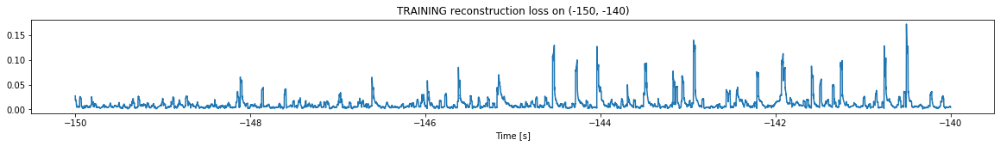

Finished training, median of the log(loss) is:  -2.139349640854623
Triggering for section:  (-140, -130)
Using this median for triggering: -1.6874214986955114


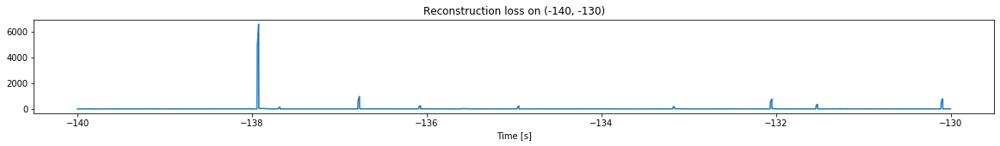

Other trigger time:  [-137.92479 -136.77028 -136.0718  -134.94579 -133.17009 -132.0474
 -131.52489 -130.09099]
Their log loss values are:  [5.50658532 4.67668714 4.07812082 4.05631606 3.96986337 4.57161844
 4.24853527 4.58558375]


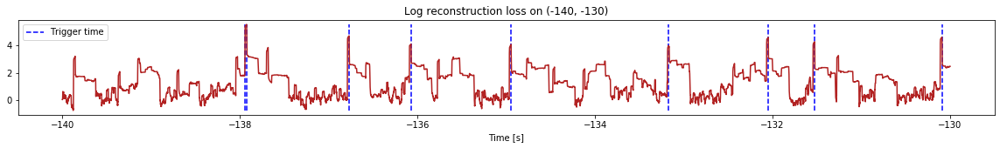

Triggered at:  [-137.92479, -136.77028, -136.0718, -134.94579, -133.17009, -132.0474, -131.52489, -130.09099]
<--------
Entering sections:  (-130, -120)
-------->
Training for section:  (-140, -130)


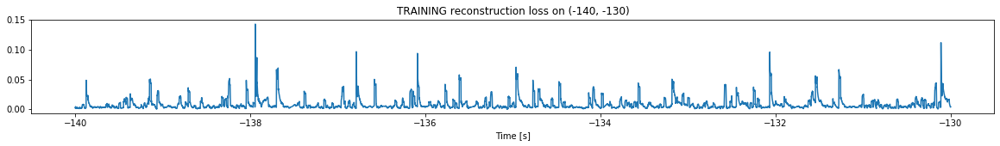

Finished training, median of the log(loss) is:  -2.2697457812287274
Triggering for section:  (-130, -120)
Using this median for triggering: -2.139349640854623


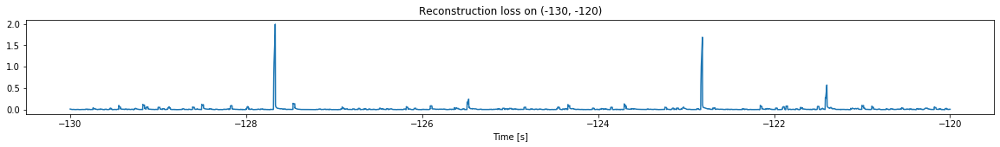

<--------
Entering sections:  (-120, -110)
-------->
Training for section:  (-130, -120)


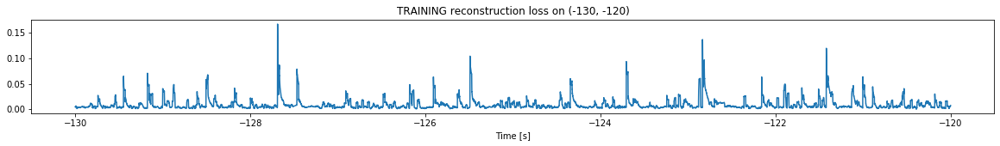

Finished training, median of the log(loss) is:  -2.227170906170132
Triggering for section:  (-120, -110)
Using this median for triggering: -2.2697457812287274


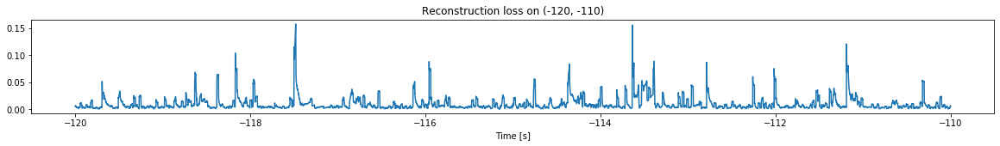

<--------
Entering sections:  (-110, -100)
-------->
Training for section:  (-120, -110)


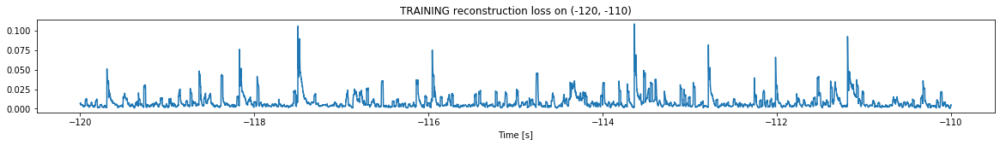

Finished training, median of the log(loss) is:  -2.2762539940110966
Triggering for section:  (-110, -100)
Using this median for triggering: -2.227170906170132


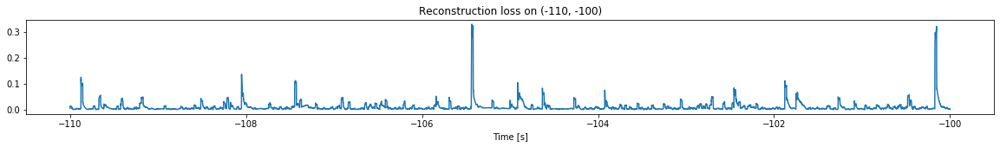

<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


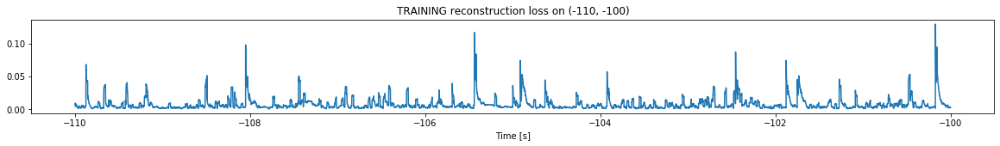

Finished training, median of the log(loss) is:  -2.2917819052728525
Triggering for section:  (-100, -90)
Using this median for triggering: -2.2762539940110966


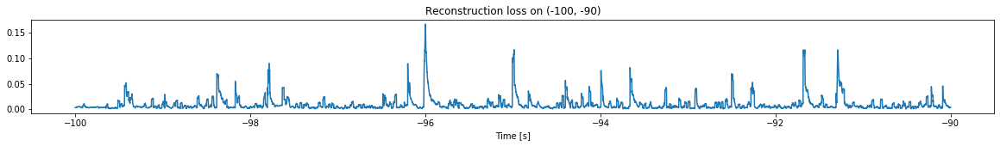

<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


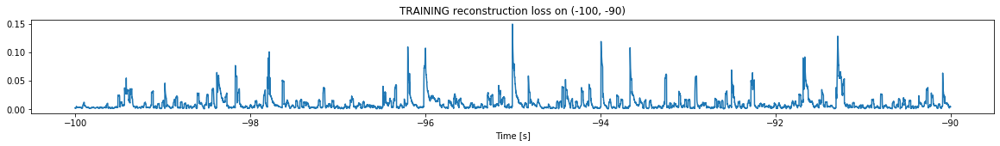

Finished training, median of the log(loss) is:  -2.200462653878281
Triggering for section:  (-90, -80)
Using this median for triggering: -2.2917819052728525


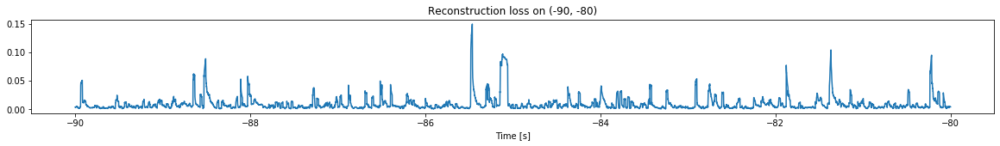

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


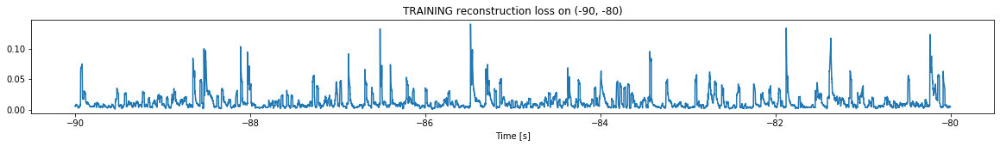

Finished training, median of the log(loss) is:  -2.0754353786949564
Triggering for section:  (-80, -70)
Using this median for triggering: -2.200462653878281


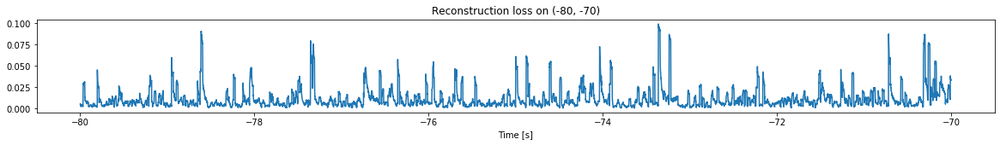

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


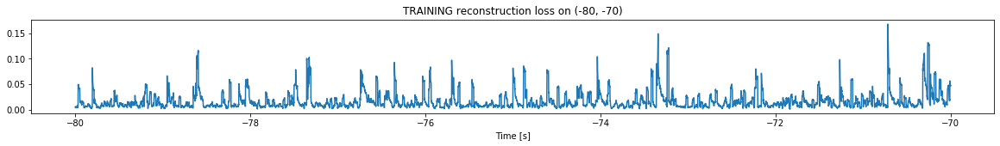

Finished training, median of the log(loss) is:  -1.934922269537506
Triggering for section:  (-70, -60)
Using this median for triggering: -2.0754353786949564


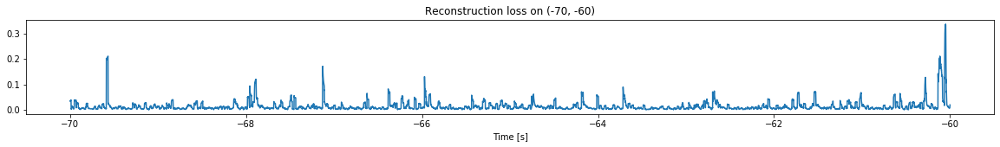

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


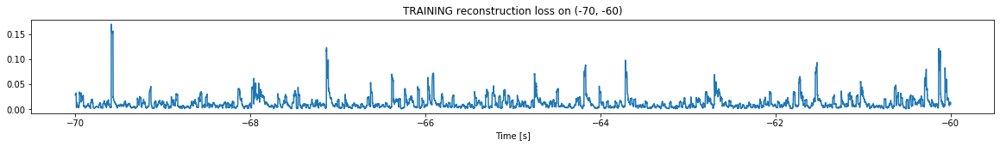

Finished training, median of the log(loss) is:  -2.0429417782181183
Triggering for section:  (-60, -50)
Using this median for triggering: -1.934922269537506


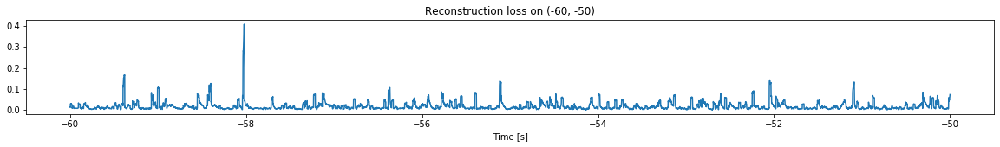

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


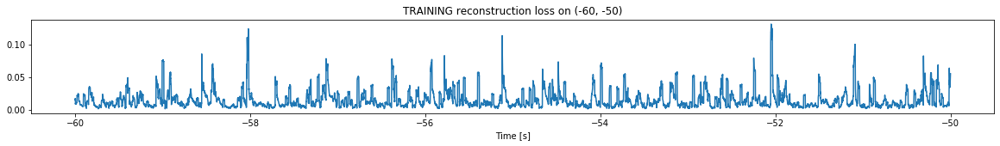

Finished training, median of the log(loss) is:  -1.9596064762305012
Triggering for section:  (-50, -40)
Using this median for triggering: -2.0429417782181183


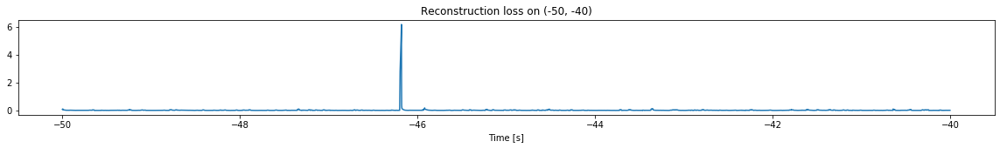

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


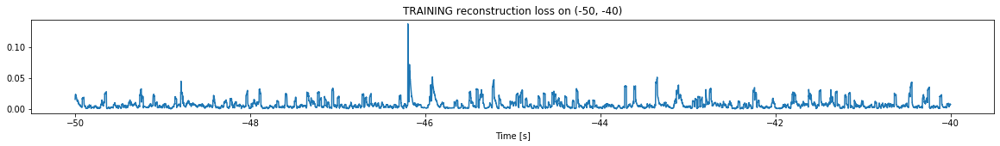

Finished training, median of the log(loss) is:  -2.2365970080867363
Triggering for section:  (-40, -30)
Using this median for triggering: -1.9596064762305012


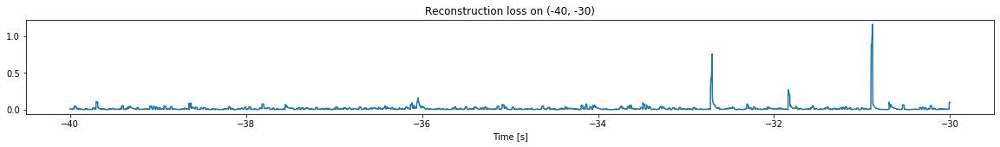

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


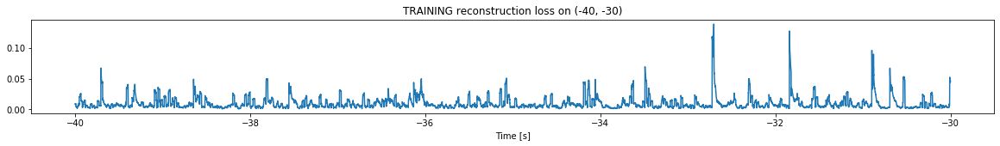

Finished training, median of the log(loss) is:  -2.1685180958249908
Triggering for section:  (-30, -20)
Using this median for triggering: -2.2365970080867363


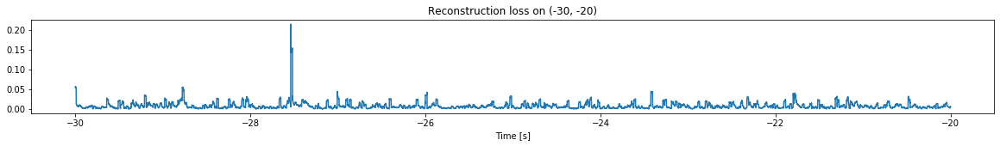

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


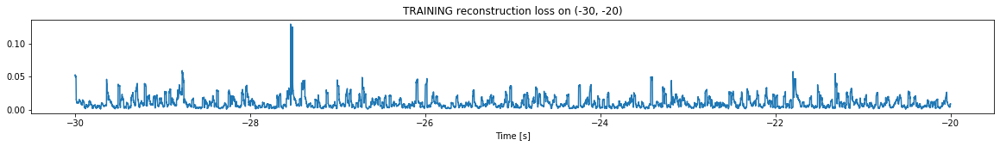

Finished training, median of the log(loss) is:  -2.1126284972906753
Triggering for section:  (-20, -10)
Using this median for triggering: -2.1685180958249908


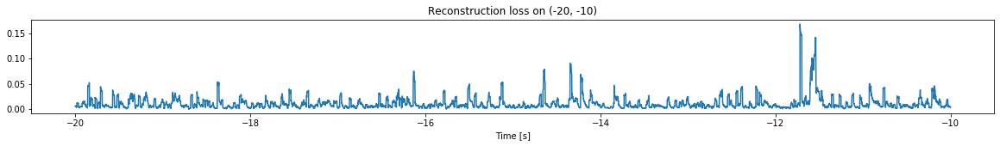

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


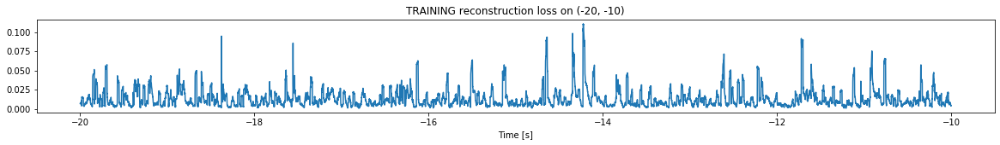

Finished training, median of the log(loss) is:  -1.989275009443582
Triggering for section:  (-10, 0)
Using this median for triggering: -2.1126284972906753


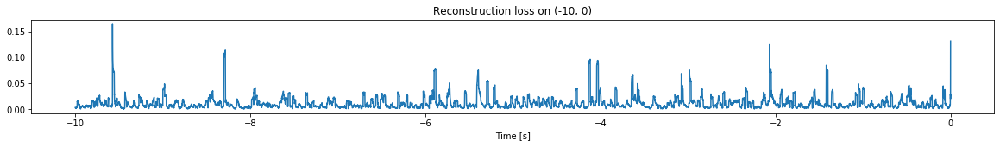

<--------
Finished simulation, all the triggered times are:  [-144.03558, -143.47359, -142.92929, -141.89198, -140.74948, -137.92479, -136.77028, -136.0718, -134.94579, -133.17009, -132.0474, -131.52489, -130.09099]


In [16]:
simulation("./data/Ramp20/", 10, (-195,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1199800, 13)
Flushing input history
Number of sections: 12
Entering sections:  (-120, -110)
-------->
Entering sections:  (-110, -100)
-------->
Training for section:  (None, -110)


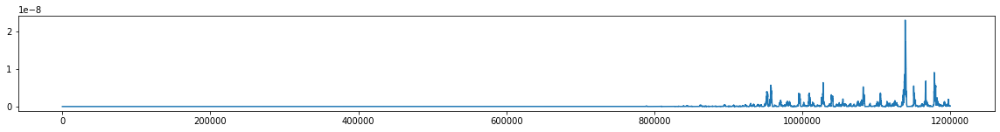

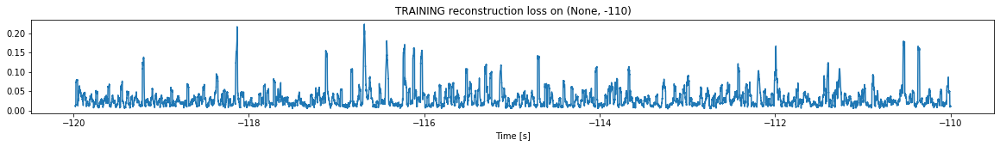

Finished training, median of the log(loss) is:  -1.6137992365837626
<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


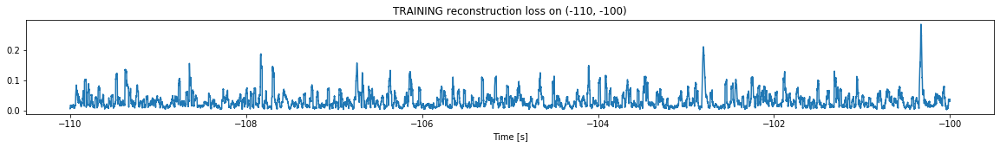

Finished training, median of the log(loss) is:  -1.594497304999087
Triggering for section:  (-100, -90)
Using this median for triggering: -1.6137992365837626


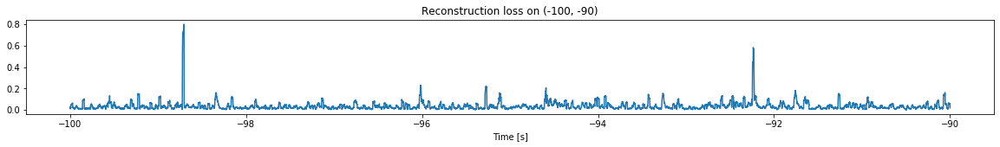

<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


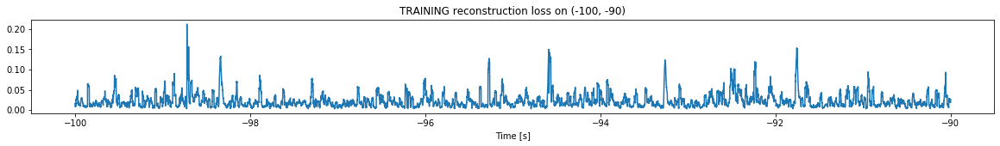

Finished training, median of the log(loss) is:  -1.7322779292450137
Triggering for section:  (-90, -80)
Using this median for triggering: -1.594497304999087


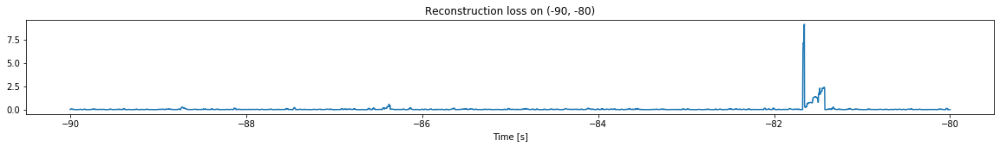

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


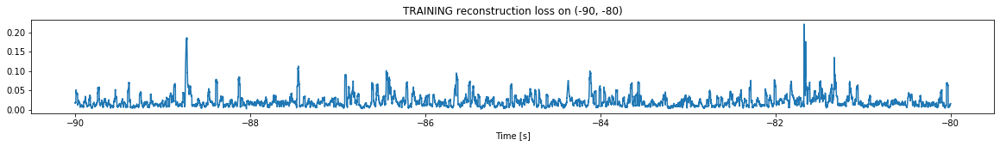

Finished training, median of the log(loss) is:  -1.7771392227364387
Triggering for section:  (-80, -70)
Using this median for triggering: -1.7322779292450137


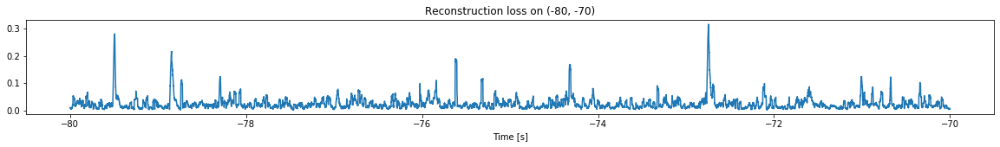

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


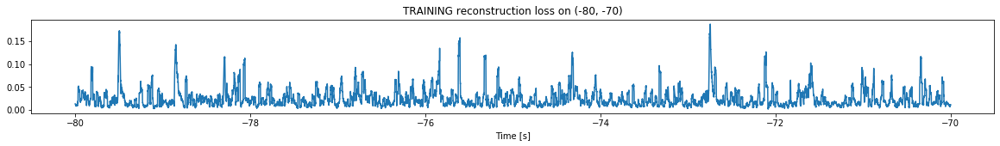

Finished training, median of the log(loss) is:  -1.7091774336249472
Triggering for section:  (-70, -60)
Using this median for triggering: -1.7771392227364387


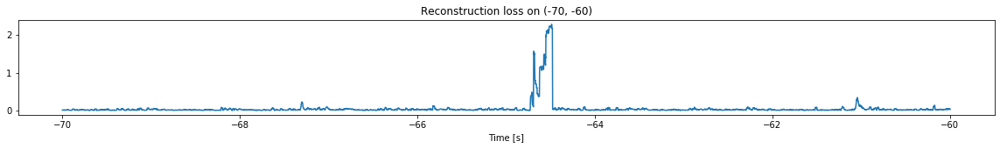

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


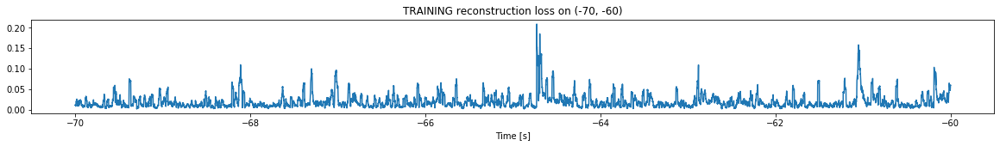

Finished training, median of the log(loss) is:  -1.822471263201051
Triggering for section:  (-60, -50)
Using this median for triggering: -1.7091774336249472


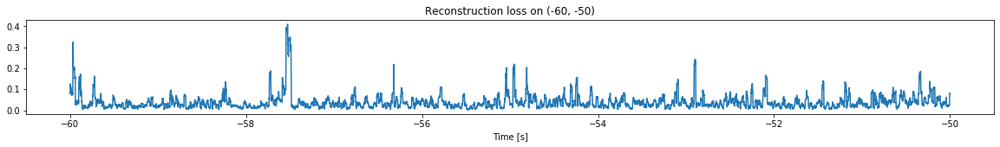

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


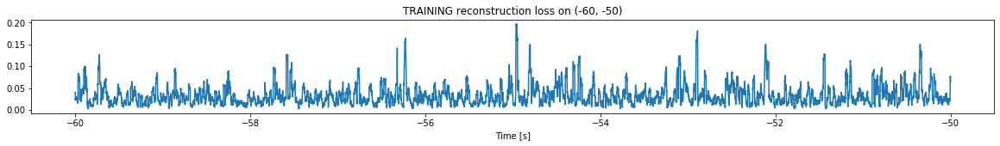

Finished training, median of the log(loss) is:  -1.5449814718010066
Triggering for section:  (-50, -40)
Using this median for triggering: -1.822471263201051


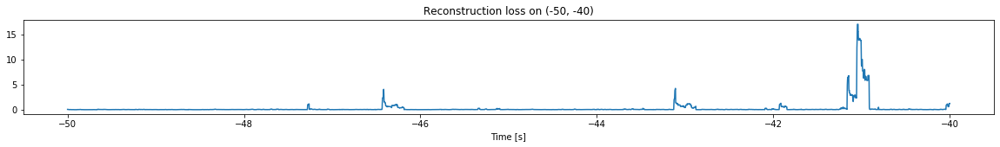

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


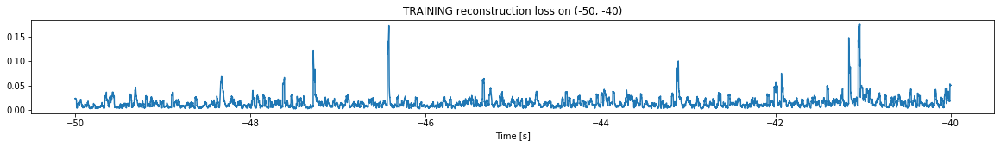

Finished training, median of the log(loss) is:  -1.9369679421579673
Triggering for section:  (-40, -30)
Using this median for triggering: -1.5449814718010066


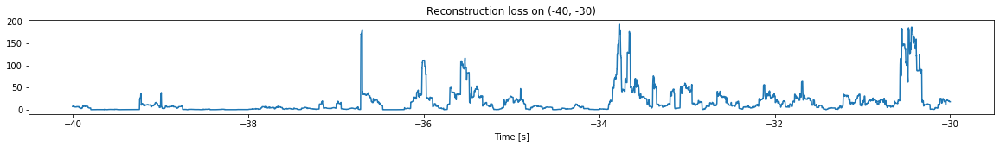

Other trigger time:  [-36.699398 -35.5289   -33.770798 -33.0238   -31.682098 -30.439299]
Their log loss values are:  [3.8002184  3.6137514  3.83227243 3.32464771 3.35306951 3.81787788]


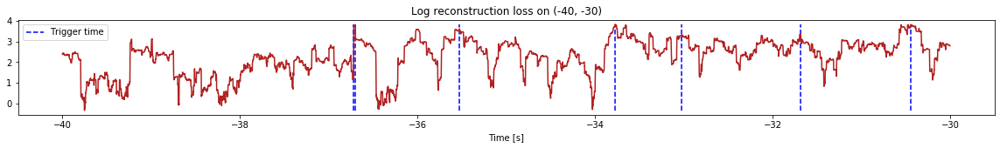

Triggered at:  [-36.699398, -35.5289, -33.770798, -33.0238, -31.682098, -30.439299]
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


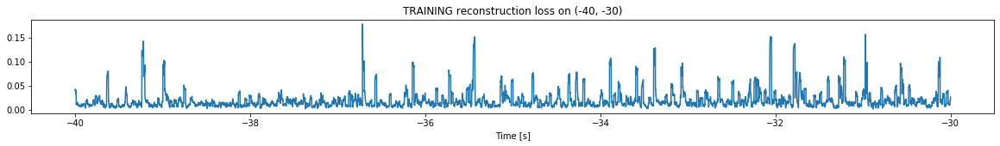

Finished training, median of the log(loss) is:  -1.8502920415273023
Triggering for section:  (-30, -20)
Using this median for triggering: -1.9369679421579673


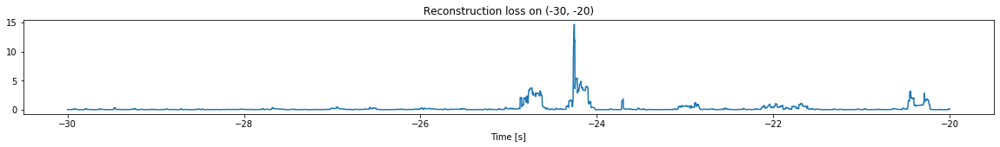

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


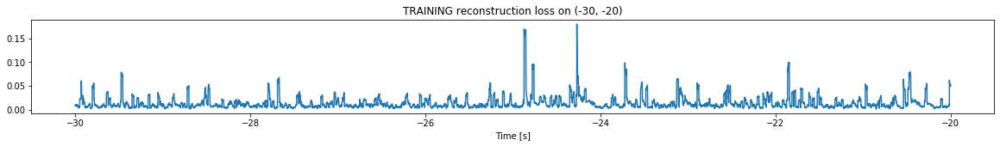

Finished training, median of the log(loss) is:  -2.0219279374005508
Triggering for section:  (-20, -10)
Using this median for triggering: -1.8502920415273023


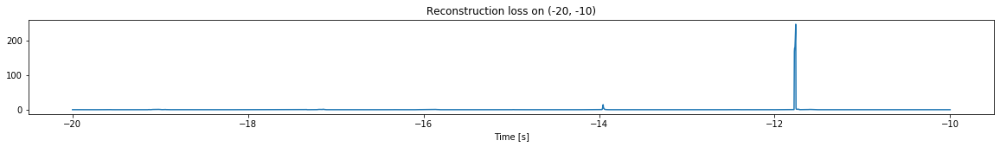

Other trigger time:  [-11.759]
Their log loss values are:  [4.24394381]


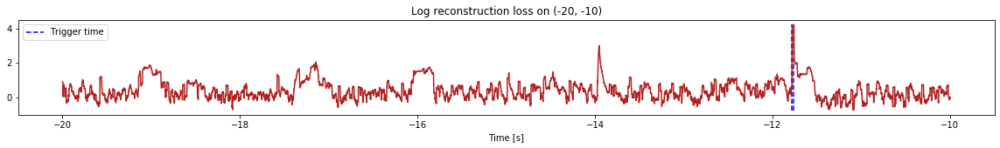

Triggered at:  [-11.759]
<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


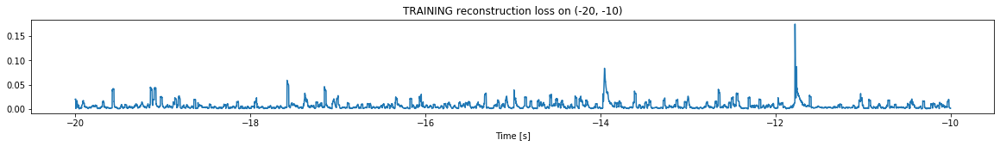

Finished training, median of the log(loss) is:  -2.3218534713455306
Triggering for section:  (-10, 0)
Using this median for triggering: -2.0219279374005508


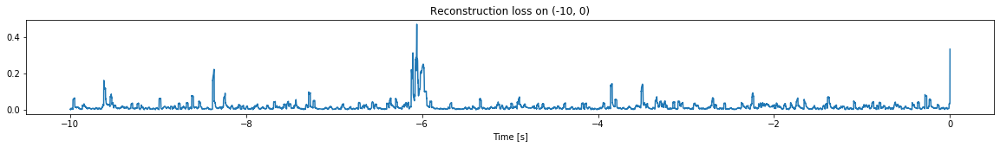

<--------
Finished simulation, all the triggered times are:  [-36.699398, -35.5289, -33.770798, -33.0238, -31.682098, -30.439299, -11.759]


In [17]:
simulation("./data/Ramp21/", 10, (-120,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (799800, 13)
Flushing input history
Number of sections: 8
Entering sections:  (-80, -70)
-------->
Entering sections:  (-70, -60)
-------->
Training for section:  (None, -70)


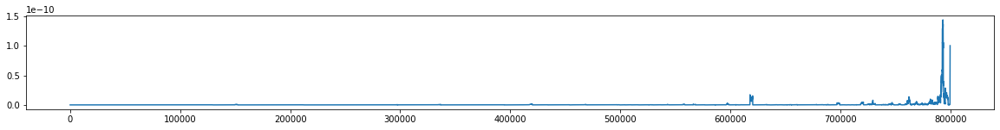

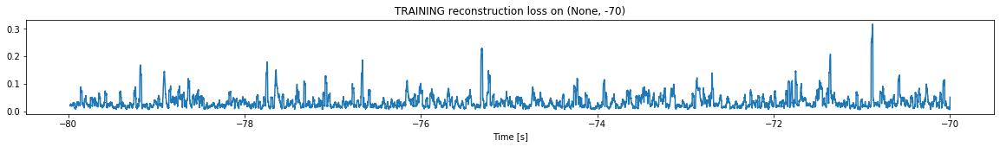

Finished training, median of the log(loss) is:  -1.5591021233458076
<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


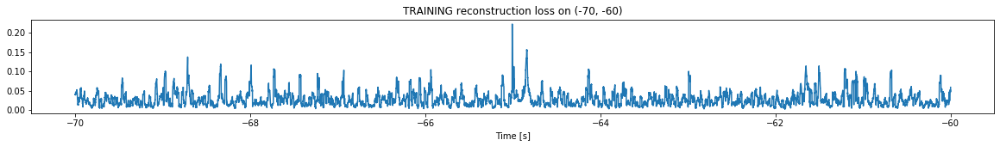

Finished training, median of the log(loss) is:  -1.6239468567676607
Triggering for section:  (-60, -50)
Using this median for triggering: -1.5591021233458076


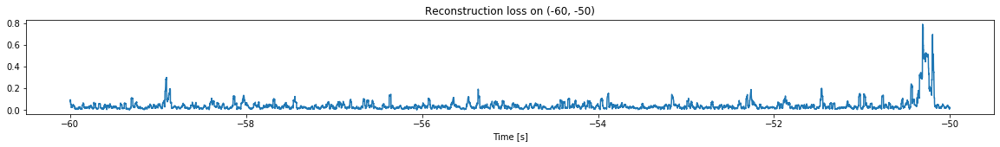

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


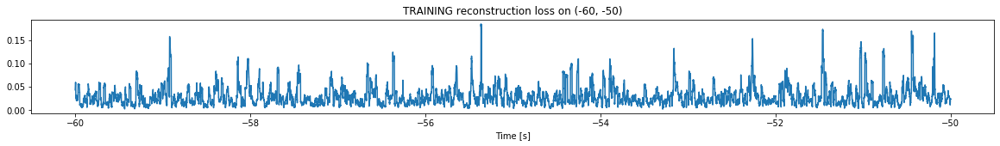

Finished training, median of the log(loss) is:  -1.592311287666483
Triggering for section:  (-50, -40)
Using this median for triggering: -1.6239468567676607


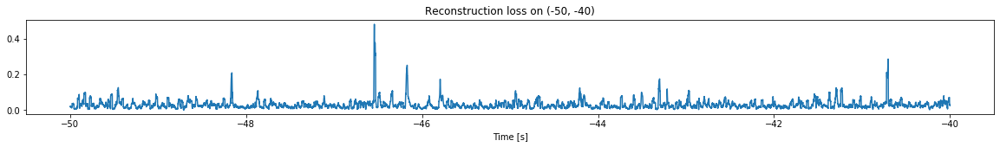

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


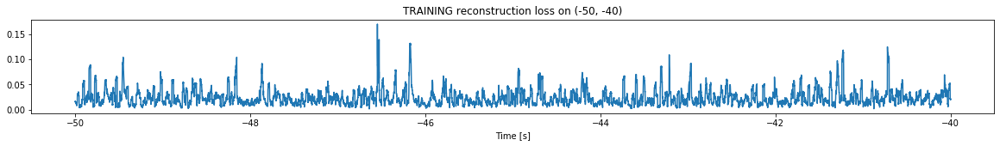

Finished training, median of the log(loss) is:  -1.691057393361134
Triggering for section:  (-40, -30)
Using this median for triggering: -1.592311287666483


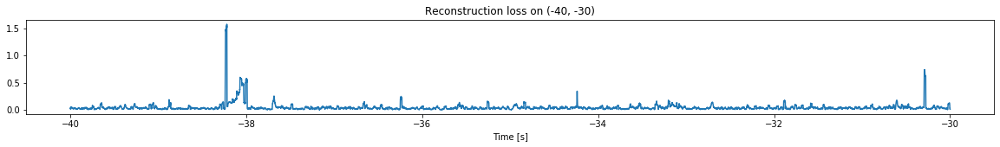

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


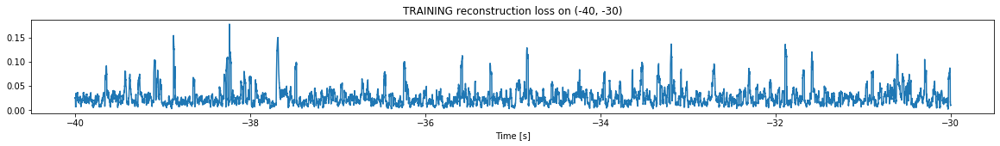

Finished training, median of the log(loss) is:  -1.6353338779961282
Triggering for section:  (-30, -20)
Using this median for triggering: -1.691057393361134


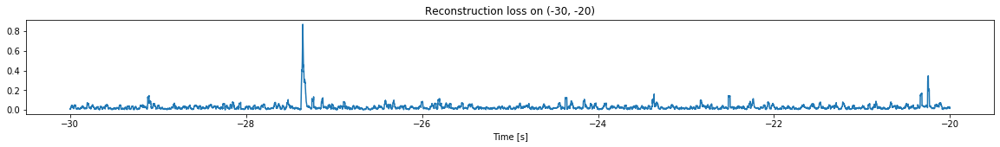

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


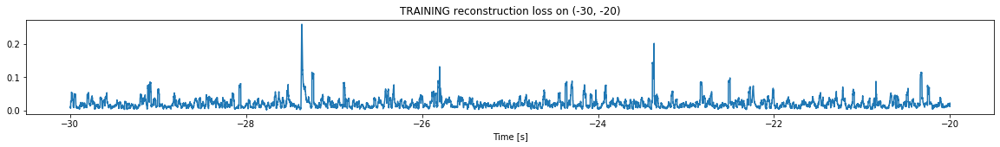

Finished training, median of the log(loss) is:  -1.7632838681030871
Triggering for section:  (-20, -10)
Using this median for triggering: -1.6353338779961282


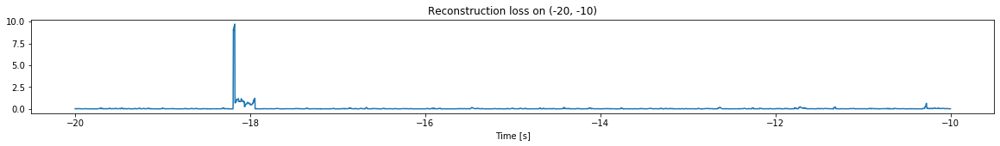

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


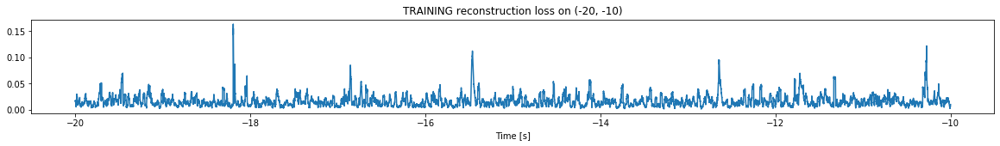

Finished training, median of the log(loss) is:  -1.8510496899371631
Triggering for section:  (-10, 0)
Using this median for triggering: -1.7632838681030871


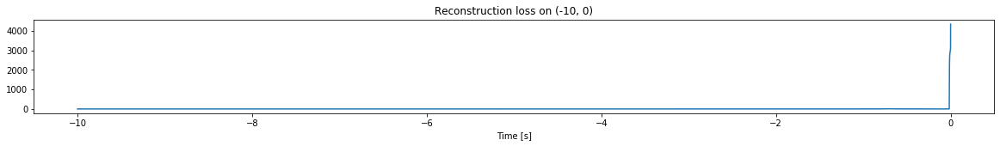

Other trigger time:  []
Their log loss values are:  []


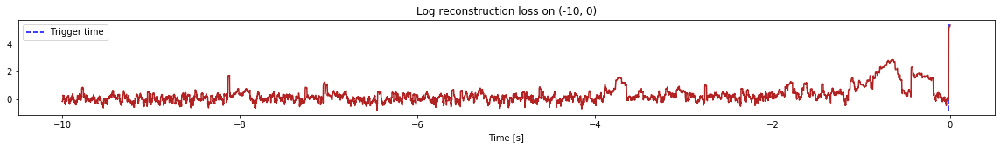

Triggered at:  []
<--------
Finished simulation, all the triggered times are:  []


In [18]:
simulation("./data/Ramp22/", 10, (-80,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (499800, 13)
Flushing input history
Number of sections: 5
Entering sections:  (-50, -40)
-------->
Entering sections:  (-40, -30)
-------->
Training for section:  (None, -40)


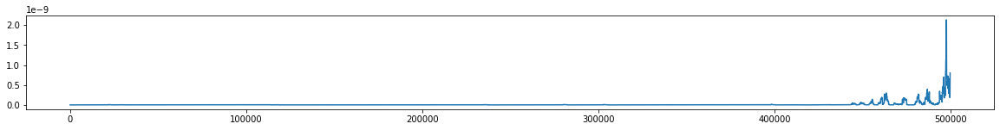

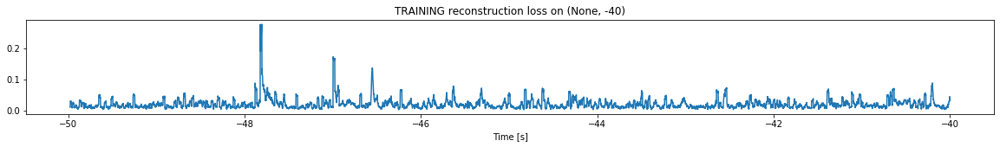

Finished training, median of the log(loss) is:  -1.7615348081803661
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


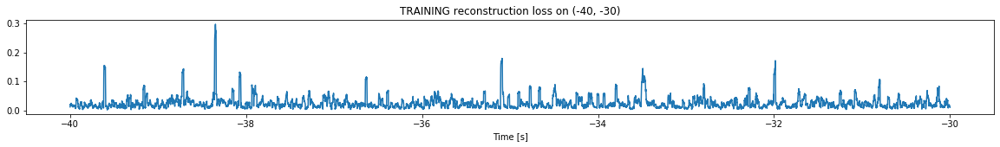

Finished training, median of the log(loss) is:  -1.6754144550382324
Triggering for section:  (-30, -20)
Using this median for triggering: -1.7615348081803661


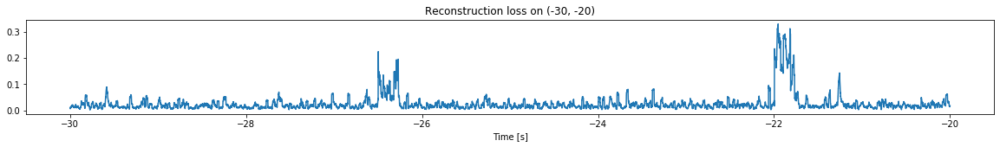

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


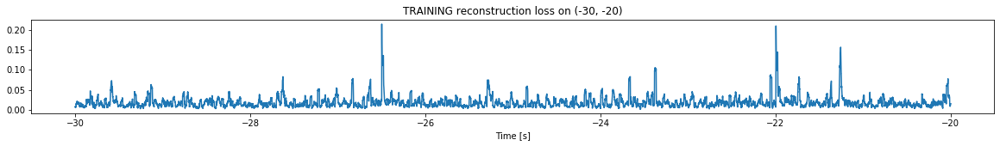

Finished training, median of the log(loss) is:  -1.8101216303013035
Triggering for section:  (-20, -10)
Using this median for triggering: -1.6754144550382324


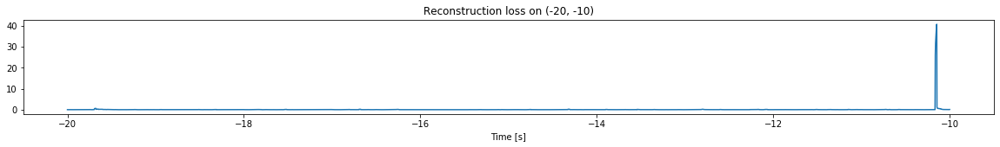

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


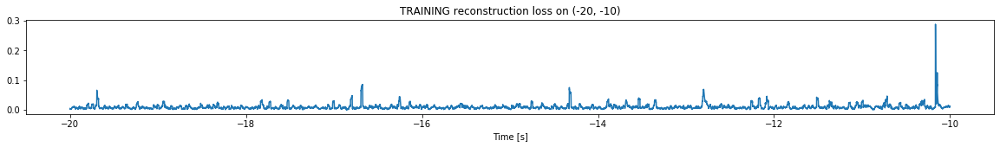

Finished training, median of the log(loss) is:  -2.0672403728942874
Triggering for section:  (-10, 0)
Using this median for triggering: -1.8101216303013035


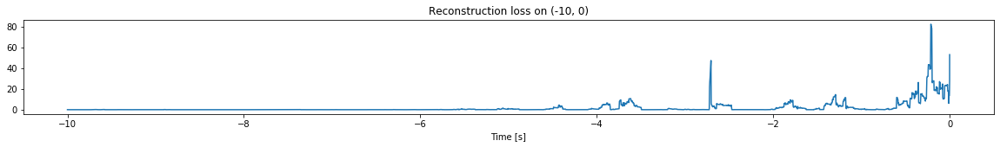

Other trigger time:  [-2.7054     -0.21249999]
Their log loss values are:  [3.48560473 3.72530946]


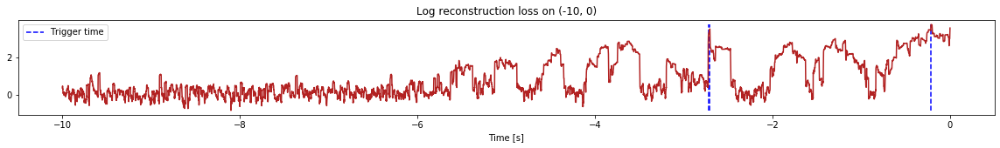

Triggered at:  [-2.7054, -0.21249999]
<--------
Finished simulation, all the triggered times are:  [-2.7054, -0.21249999]


In [19]:
simulation("./data/Ramp23/", 10, (-50,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1099800, 13)
Flushing input history
Number of sections: 11
Entering sections:  (-110, -100)
-------->
Entering sections:  (-100, -90)
-------->
Training for section:  (None, -100)


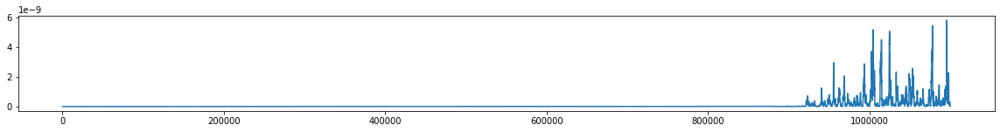

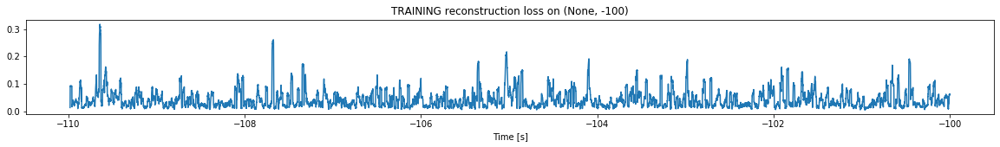

Finished training, median of the log(loss) is:  -1.4698656946099544
<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


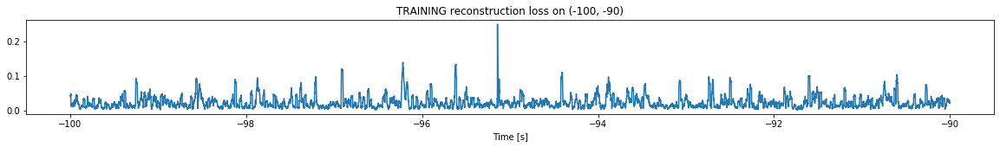

Finished training, median of the log(loss) is:  -1.7135362465534656
Triggering for section:  (-90, -80)
Using this median for triggering: -1.4698656946099544


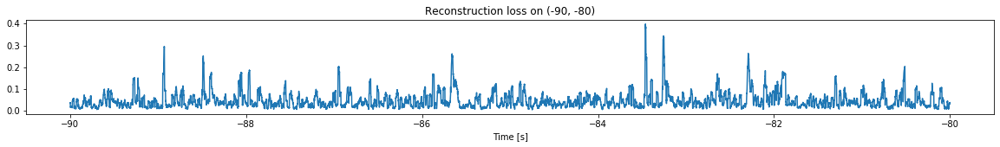

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


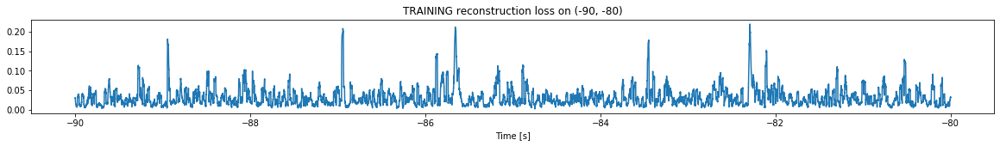

Finished training, median of the log(loss) is:  -1.5779667900719594
Triggering for section:  (-80, -70)
Using this median for triggering: -1.7135362465534656


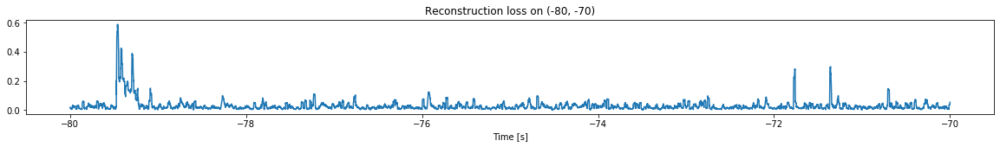

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


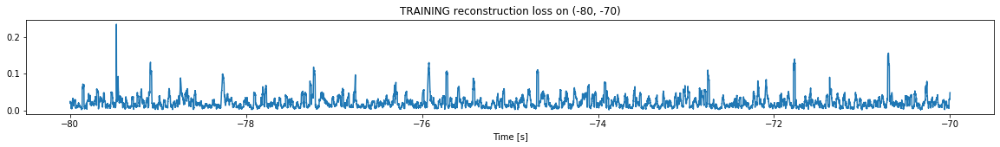

Finished training, median of the log(loss) is:  -1.7261720468295318
Triggering for section:  (-70, -60)
Using this median for triggering: -1.5779667900719594


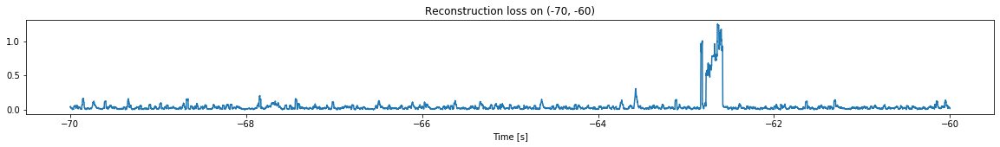

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


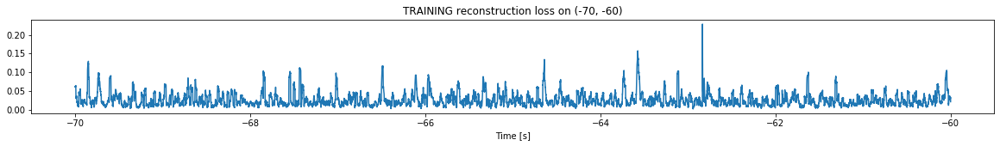

Finished training, median of the log(loss) is:  -1.649155205271958
Triggering for section:  (-60, -50)
Using this median for triggering: -1.7261720468295318


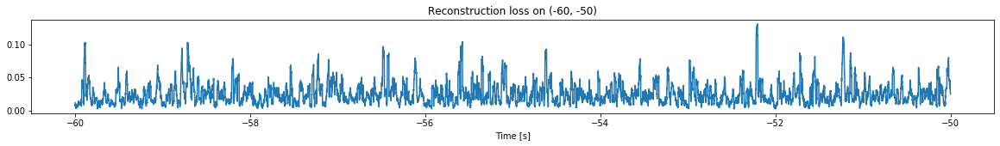

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


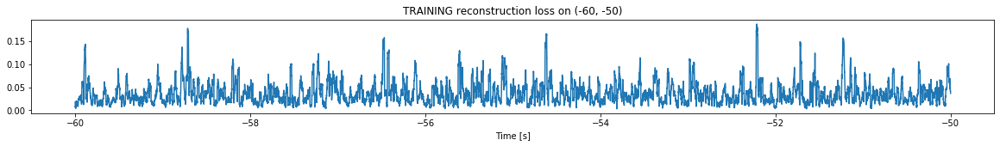

Finished training, median of the log(loss) is:  -1.5013706432997578
Triggering for section:  (-50, -40)
Using this median for triggering: -1.649155205271958


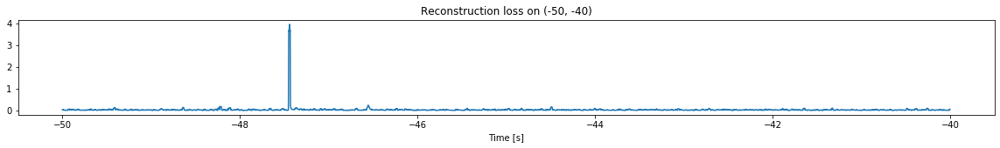

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


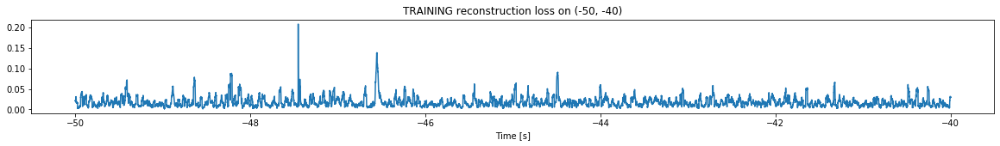

Finished training, median of the log(loss) is:  -1.8190091453518868
Triggering for section:  (-40, -30)
Using this median for triggering: -1.5013706432997578


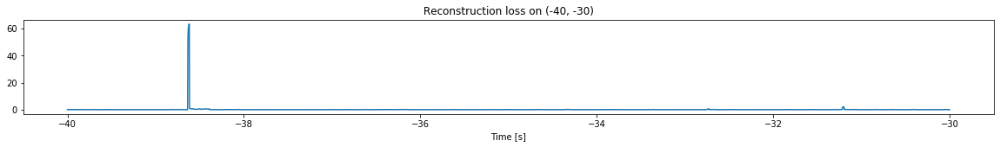

Other trigger time:  [-38.621597]
Their log loss values are:  [3.30297629]


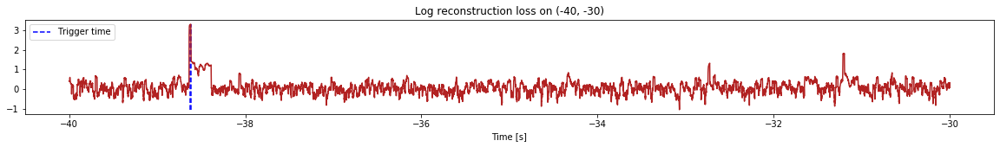

Triggered at:  [-38.621597]
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


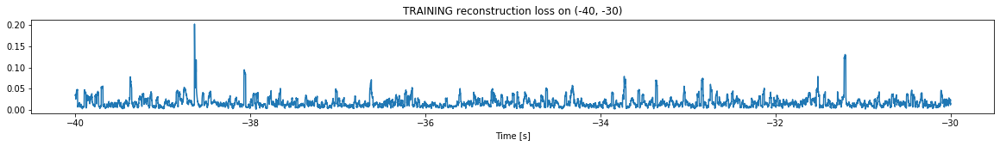

Finished training, median of the log(loss) is:  -1.8472627941899655
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8190091453518868


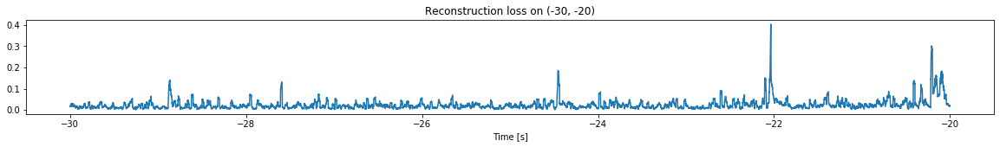

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


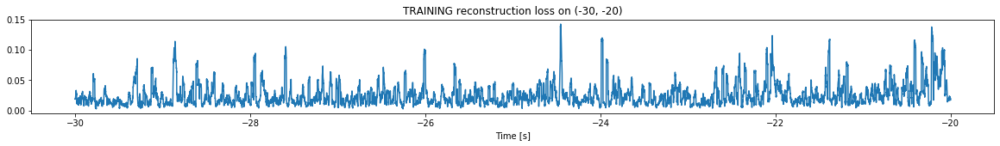

Finished training, median of the log(loss) is:  -1.6917821656246614
Triggering for section:  (-20, -10)
Using this median for triggering: -1.8472627941899655


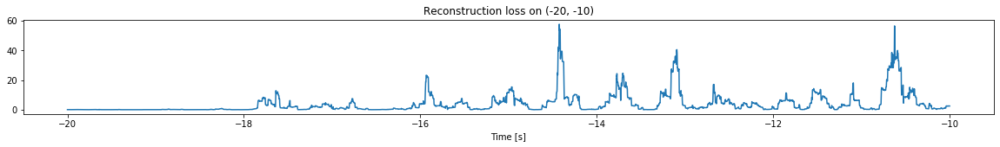

Other trigger time:  [-14.424999 -13.0917   -10.6247  ]
Their log loss values are:  [3.60908879 3.45593584 3.60060204]


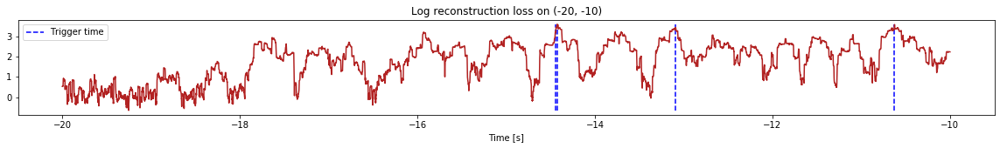

Triggered at:  [-14.424999, -13.0917, -10.6247]
<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


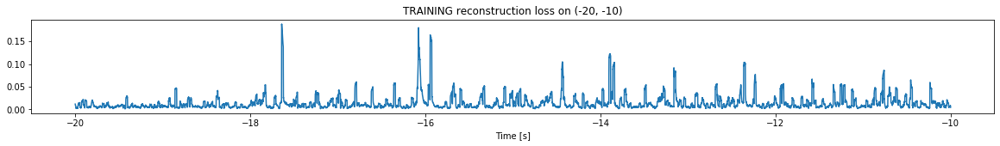

Finished training, median of the log(loss) is:  -2.0232325122299617
Triggering for section:  (-10, 0)
Using this median for triggering: -1.6917821656246614


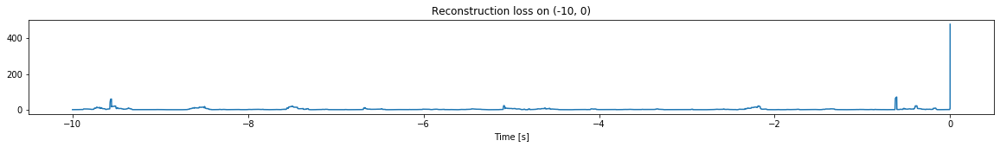

Other trigger time:  [-9.5574 -0.6091]
Their log loss values are:  [3.46989497 3.54321313]


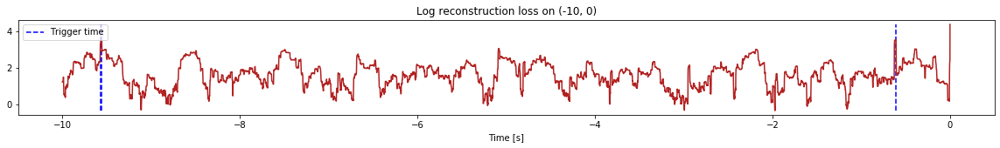

Triggered at:  [-9.5574, -0.6091]
<--------
Finished simulation, all the triggered times are:  [-38.621597, -14.424999, -13.0917, -10.6247, -9.5574, -0.6091]


In [20]:
simulation("./data/Ramp24/", 10, (-110,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (999800, 13)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


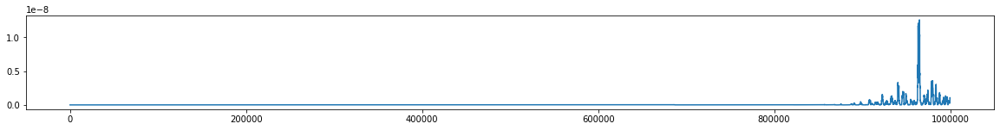

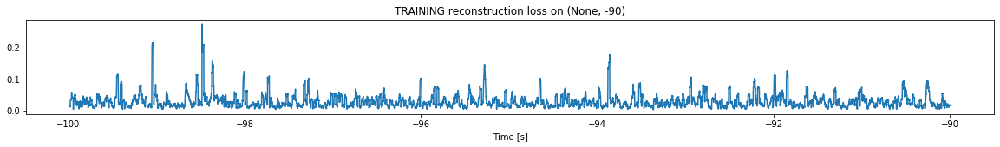

Finished training, median of the log(loss) is:  -1.6048880346728636
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


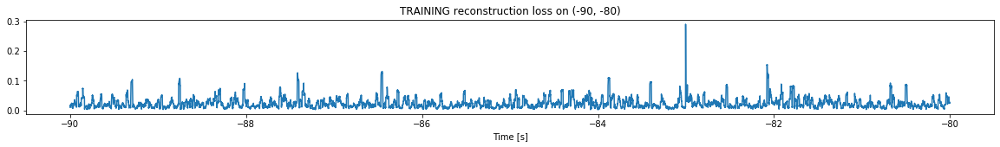

Finished training, median of the log(loss) is:  -1.69689136240362
Triggering for section:  (-80, -70)
Using this median for triggering: -1.6048880346728636


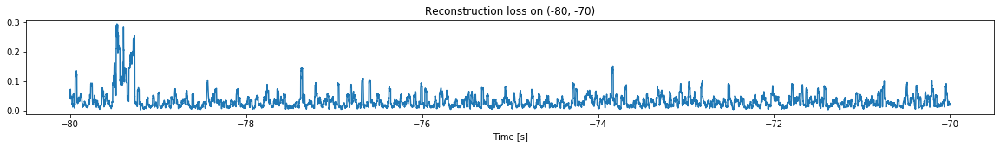

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


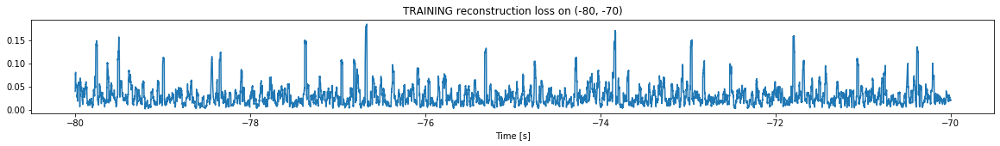

Finished training, median of the log(loss) is:  -1.5956616172558622
Triggering for section:  (-70, -60)
Using this median for triggering: -1.69689136240362


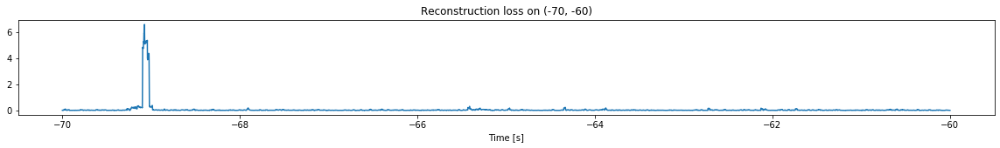

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


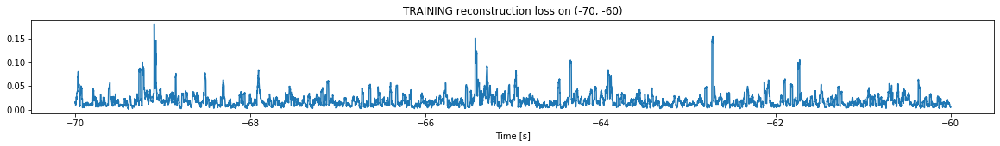

Finished training, median of the log(loss) is:  -1.789950400465706
Triggering for section:  (-60, -50)
Using this median for triggering: -1.5956616172558622


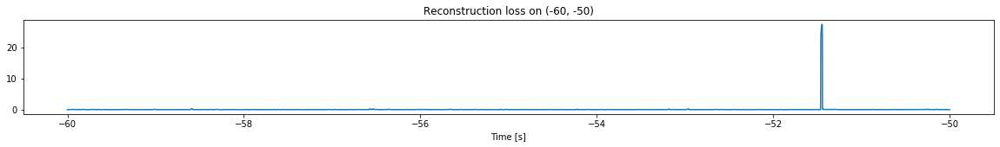

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


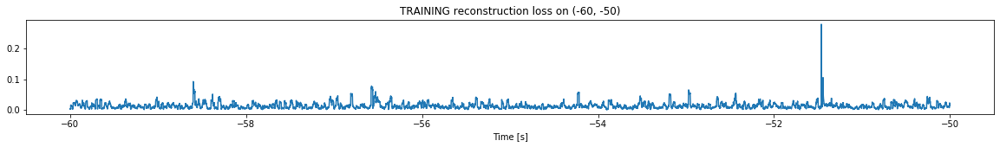

Finished training, median of the log(loss) is:  -1.9295611959383683
Triggering for section:  (-50, -40)
Using this median for triggering: -1.789950400465706


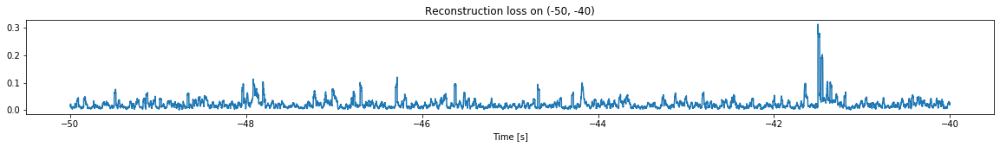

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


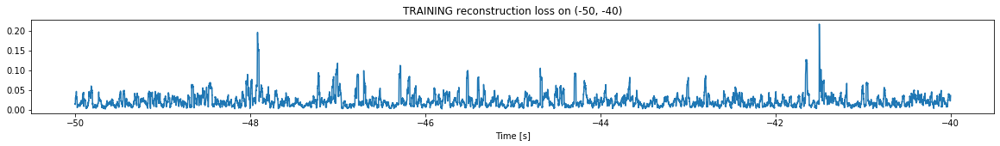

Finished training, median of the log(loss) is:  -1.7228028924196737
Triggering for section:  (-40, -30)
Using this median for triggering: -1.9295611959383683


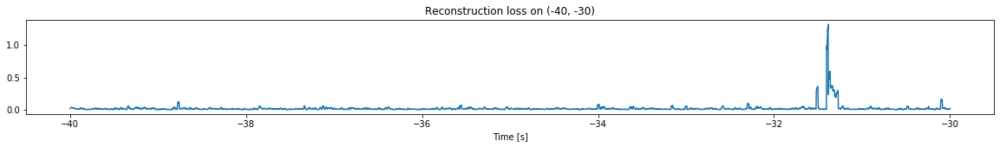

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


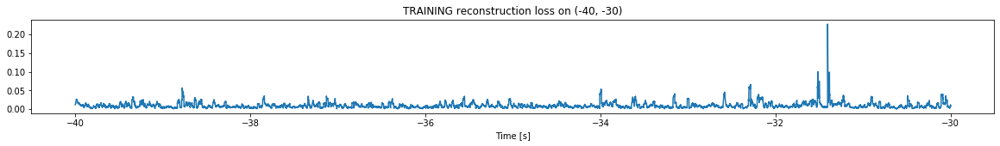

Finished training, median of the log(loss) is:  -2.077898794816191
Triggering for section:  (-30, -20)
Using this median for triggering: -1.7228028924196737


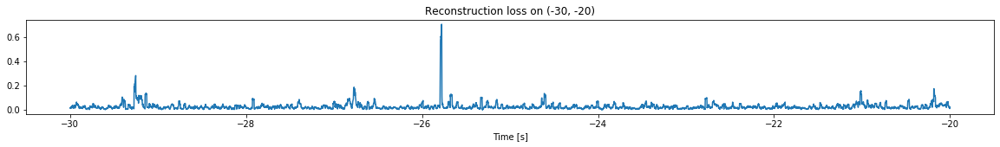

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


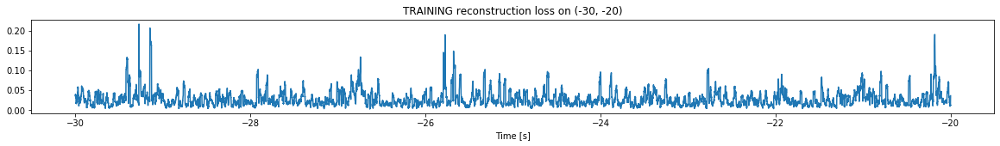

Finished training, median of the log(loss) is:  -1.6204820061288854
Triggering for section:  (-20, -10)
Using this median for triggering: -2.077898794816191


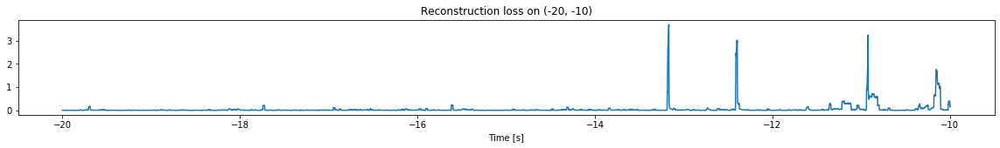

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


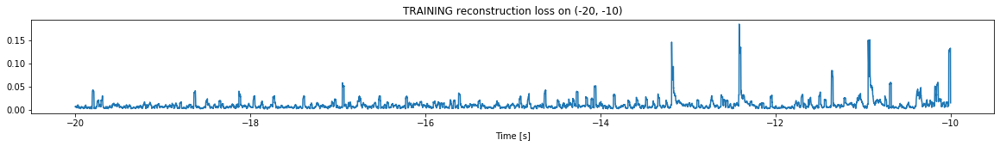

Finished training, median of the log(loss) is:  -2.131885388859648
Triggering for section:  (-10, 0)
Using this median for triggering: -1.6204820061288854


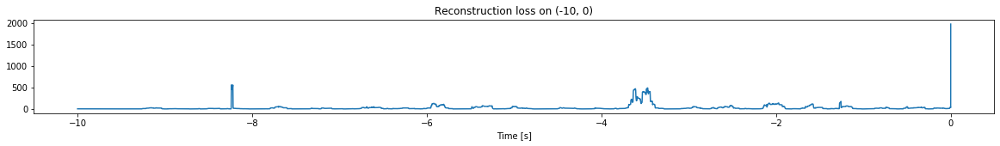

Other trigger time:  [-8.2364    -7.6955    -6.6043997 -5.9182997 -5.3623    -3.4747
 -2.5189    -1.9706999 -1.2574999 -0.5007   ]
Their log loss values are:  [4.37194425 3.39561172 3.33311044 3.73295452 3.50717696 4.31278982
 3.54401219 3.76526439 3.86839861 3.33297729]


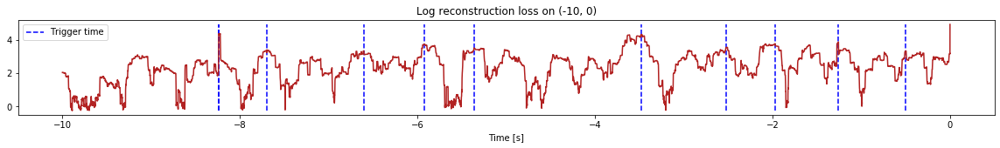

Triggered at:  [-8.2364, -7.6955, -6.6043997, -5.9182997, -5.3623, -3.4747, -2.5189, -1.9706999, -1.2574999, -0.5007]
<--------
Finished simulation, all the triggered times are:  [-8.2364, -7.6955, -6.6043997, -5.9182997, -5.3623, -3.4747, -2.5189, -1.9706999, -1.2574999, -0.5007]


In [21]:
simulation("./data/Ramp25/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1099800, 13)
Flushing input history
Number of sections: 11
Entering sections:  (-110, -100)
-------->
Entering sections:  (-100, -90)
-------->
Training for section:  (None, -100)


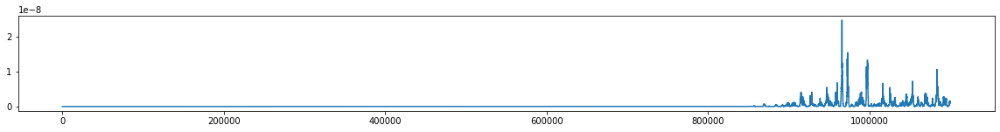

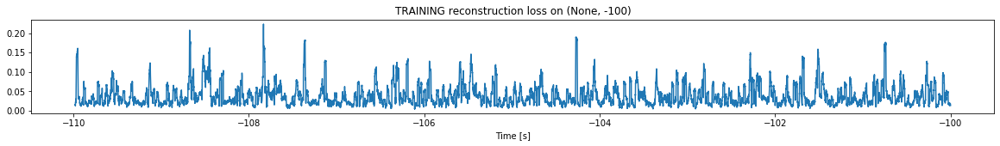

Finished training, median of the log(loss) is:  -1.4932780053686097
<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


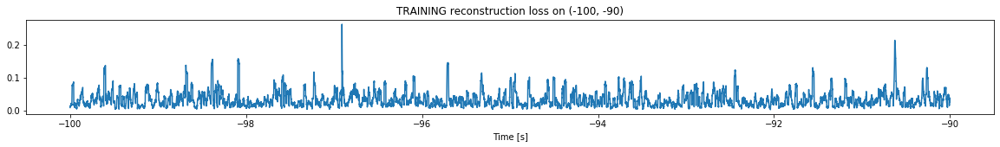

Finished training, median of the log(loss) is:  -1.5466183586312066
Triggering for section:  (-90, -80)
Using this median for triggering: -1.4932780053686097


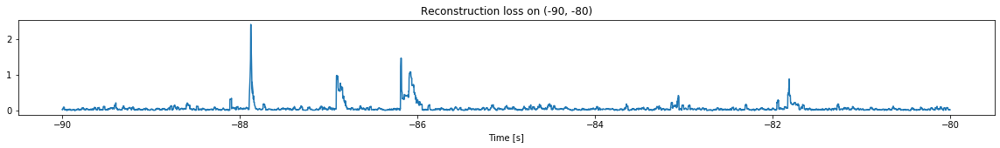

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


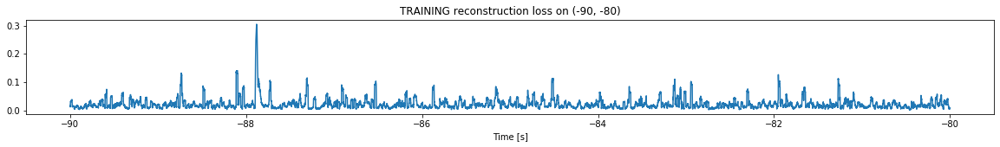

Finished training, median of the log(loss) is:  -1.7422726731736027
Triggering for section:  (-80, -70)
Using this median for triggering: -1.5466183586312066


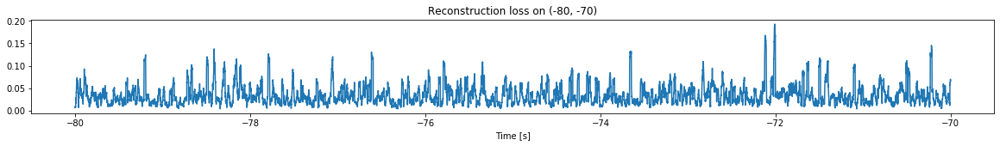

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


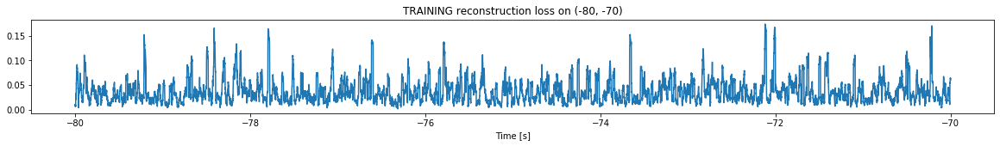

Finished training, median of the log(loss) is:  -1.487768516359085
Triggering for section:  (-70, -60)
Using this median for triggering: -1.7422726731736027


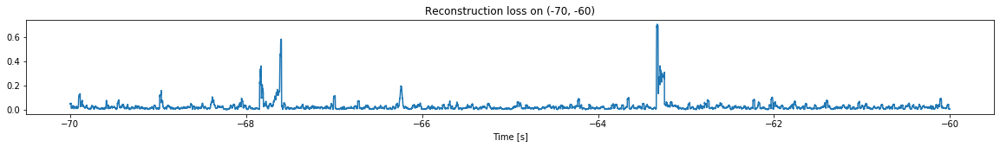

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


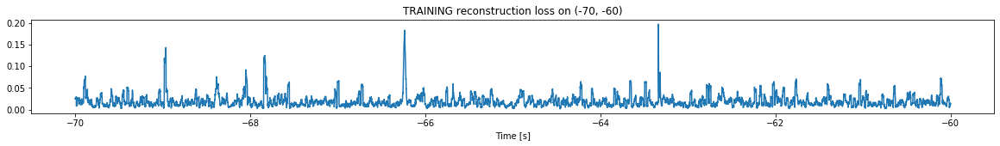

Finished training, median of the log(loss) is:  -1.7900641448181682
Triggering for section:  (-60, -50)
Using this median for triggering: -1.487768516359085


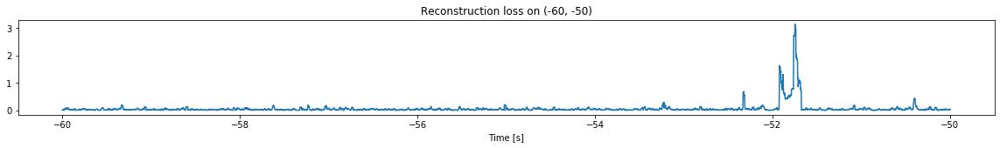

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


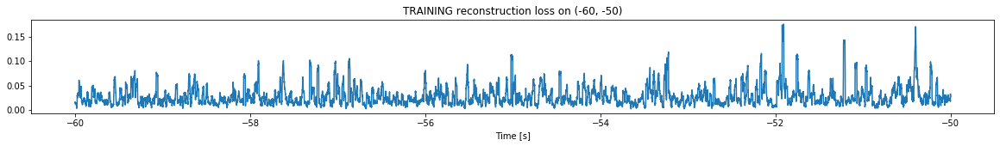

Finished training, median of the log(loss) is:  -1.6379018687066889
Triggering for section:  (-50, -40)
Using this median for triggering: -1.7900641448181682


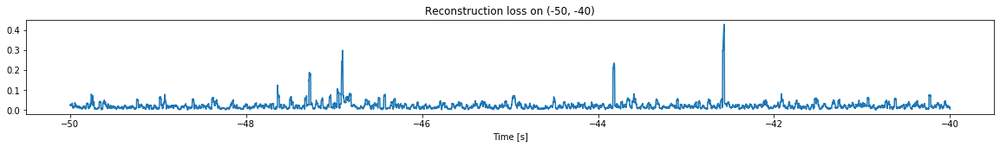

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


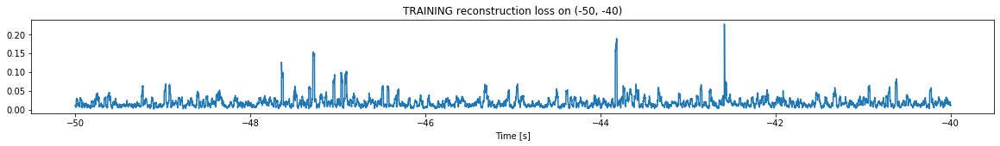

Finished training, median of the log(loss) is:  -1.7969991459346832
Triggering for section:  (-40, -30)
Using this median for triggering: -1.6379018687066889


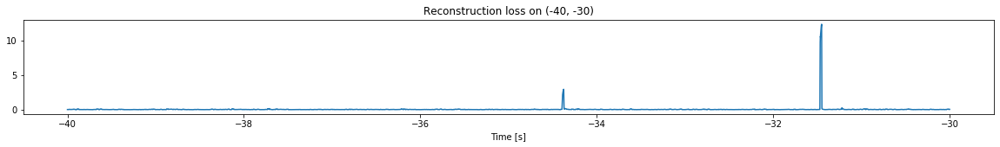

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


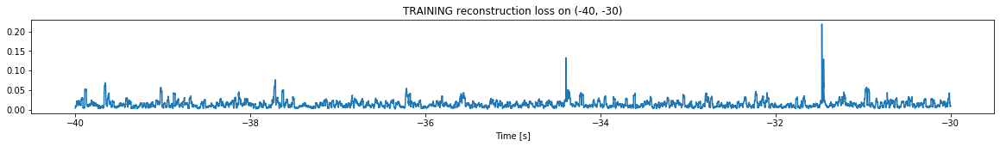

Finished training, median of the log(loss) is:  -1.9197841636327646
Triggering for section:  (-30, -20)
Using this median for triggering: -1.7969991459346832


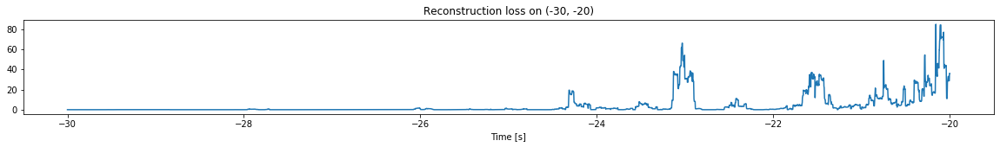

Other trigger time:  [-23.0304   -21.5602   -20.7482   -20.155699]
Their log loss values are:  [3.61809985 3.36528714 3.48694451 3.72646078]


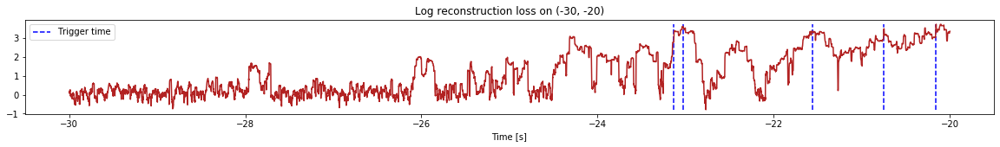

Triggered at:  [-23.0304, -21.5602, -20.7482, -20.155699]
<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


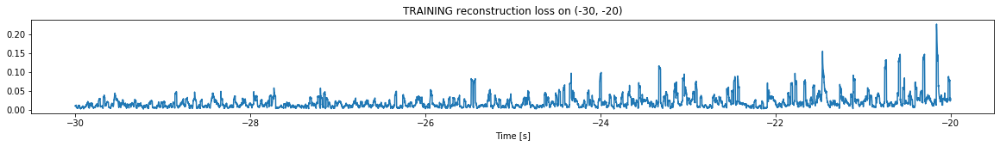

Finished training, median of the log(loss) is:  -1.8467914206582314
Triggering for section:  (-20, -10)
Using this median for triggering: -1.9197841636327646


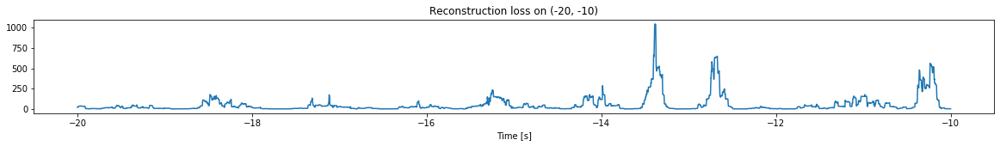

Other trigger time:  [-19.961899  -19.3198    -18.4765    -17.116999  -16.0926    -15.245999
 -14.6528    -13.9848995 -13.3867    -12.672     -12.1683    -11.535999
 -10.982599  -10.235    ]
Their log loss values are:  [3.49167171 3.61655602 4.16321231 4.159809   3.91915771 4.28454611
 3.6088987  4.37673658 4.93829532 4.73200483 3.42279187 3.67979198
 4.16672973 4.66892725]


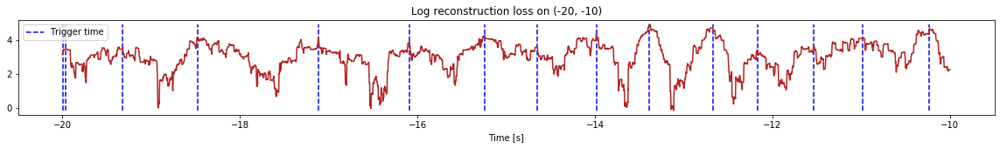

Triggered at:  [-19.961899, -19.3198, -18.4765, -17.116999, -16.0926, -15.245999, -14.6528, -13.9848995, -13.3867, -12.672, -12.1683, -11.535999, -10.982599, -10.235]
<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


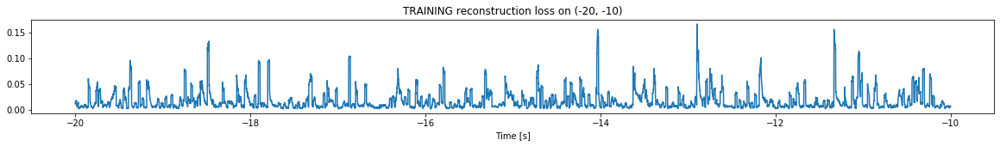

Finished training, median of the log(loss) is:  -1.964795258860583
Triggering for section:  (-10, 0)
Using this median for triggering: -1.8467914206582314


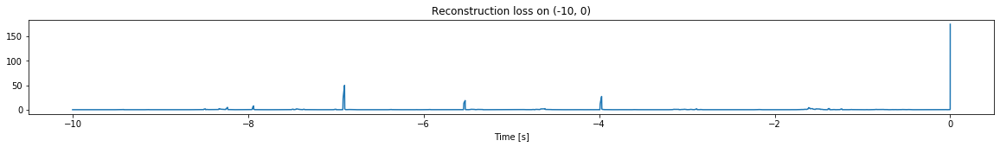

Other trigger time:  [-6.9013]
Their log loss values are:  [3.54522488]


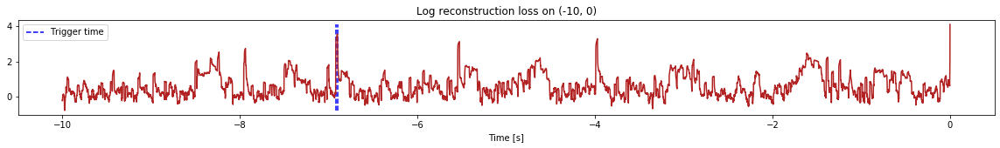

Triggered at:  [-6.9013]
<--------
Finished simulation, all the triggered times are:  [-23.0304, -21.5602, -20.7482, -20.155699, -19.961899, -19.3198, -18.4765, -17.116999, -16.0926, -15.245999, -14.6528, -13.9848995, -13.3867, -12.672, -12.1683, -11.535999, -10.982599, -10.235, -6.9013]


In [22]:
simulation("./data/Ramp26/", 10, (-110,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (699800, 13)
Flushing input history
Number of sections: 7
Entering sections:  (-70, -60)
-------->
Entering sections:  (-60, -50)
-------->
Training for section:  (None, -60)


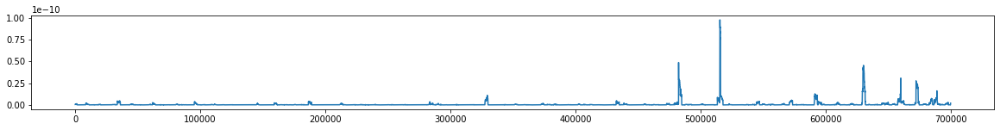

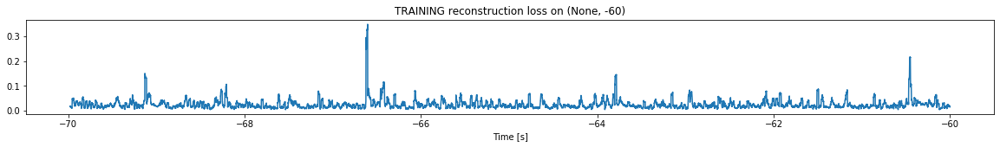

Finished training, median of the log(loss) is:  -1.6790890064659822
<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


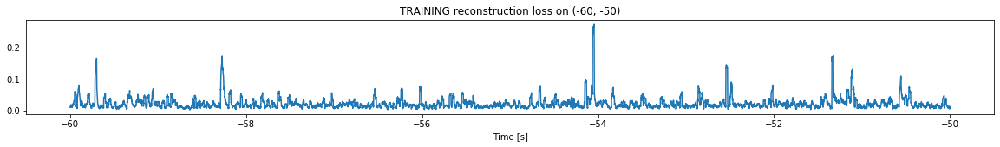

Finished training, median of the log(loss) is:  -1.734566037270247
Triggering for section:  (-50, -40)
Using this median for triggering: -1.6790890064659822


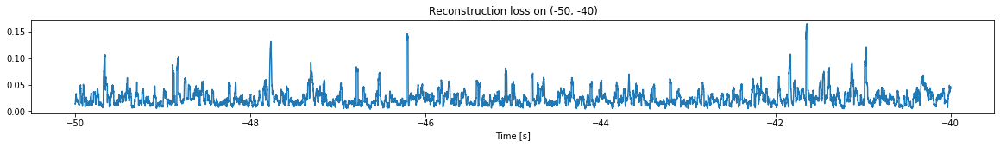

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


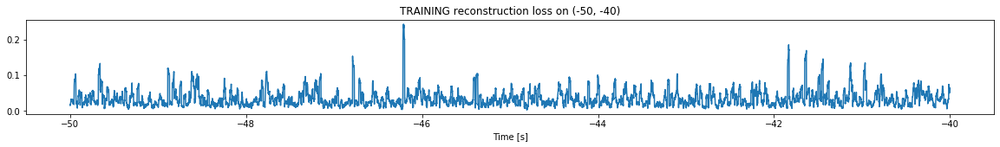

Finished training, median of the log(loss) is:  -1.5295213677671629
Triggering for section:  (-40, -30)
Using this median for triggering: -1.734566037270247


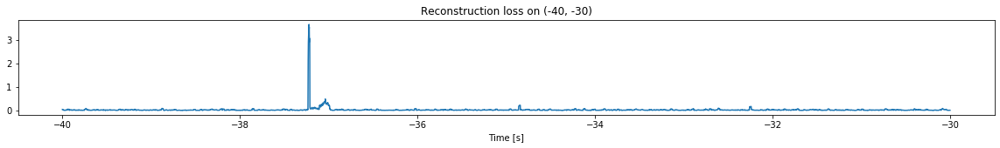

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


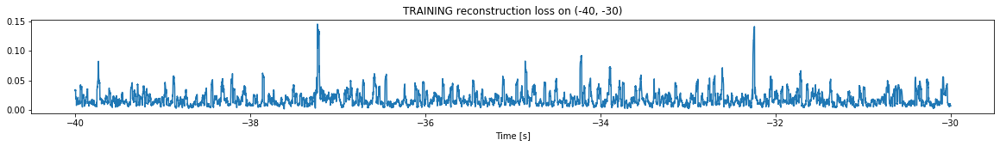

Finished training, median of the log(loss) is:  -1.8138656038838419
Triggering for section:  (-30, -20)
Using this median for triggering: -1.5295213677671629


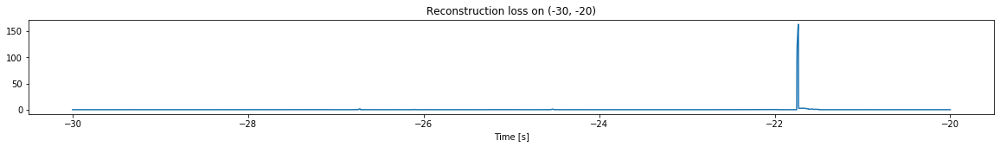

Other trigger time:  [-21.7299]
Their log loss values are:  [3.74290425]


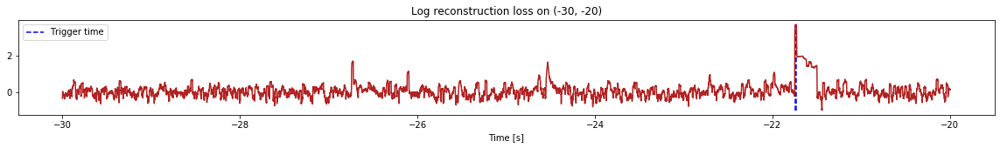

Triggered at:  [-21.7299]
<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


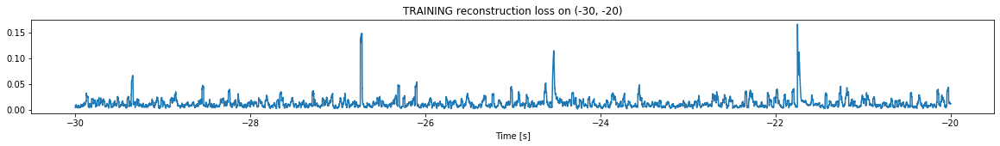

Finished training, median of the log(loss) is:  -1.995472368304791
Triggering for section:  (-20, -10)
Using this median for triggering: -1.8138656038838419


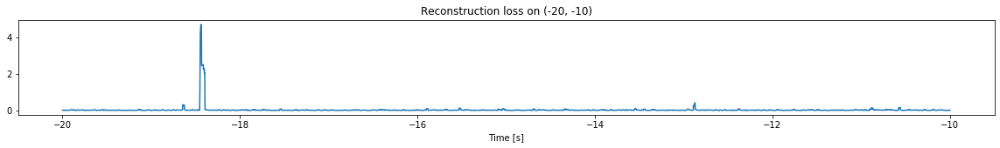

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


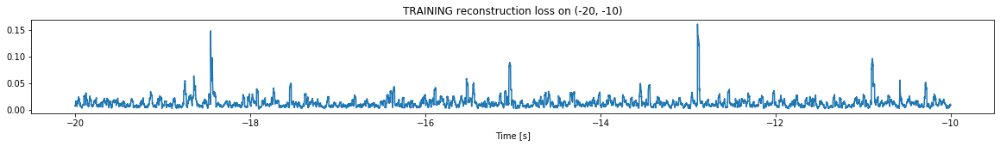

Finished training, median of the log(loss) is:  -1.9779079570511846
Triggering for section:  (-10, 0)
Using this median for triggering: -1.995472368304791


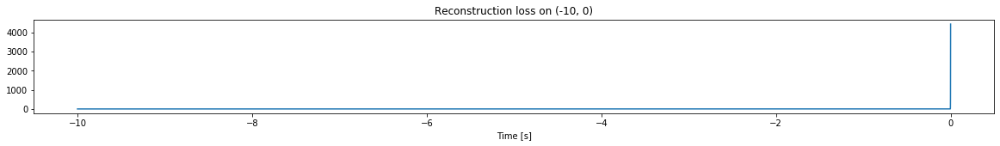

Other trigger time:  []
Their log loss values are:  []


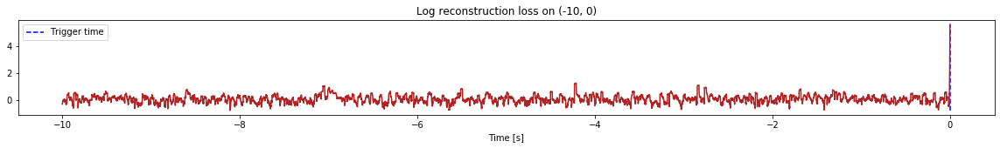

Triggered at:  []
<--------
Finished simulation, all the triggered times are:  [-21.7299]


In [23]:
simulation("./data/Ramp27/", 10, (-70,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (599800, 13)
Flushing input history
Number of sections: 6
Entering sections:  (-60, -50)
-------->
Entering sections:  (-50, -40)
-------->
Training for section:  (None, -50)


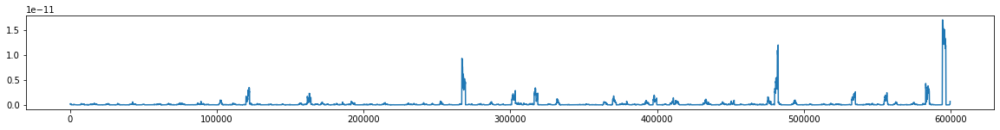

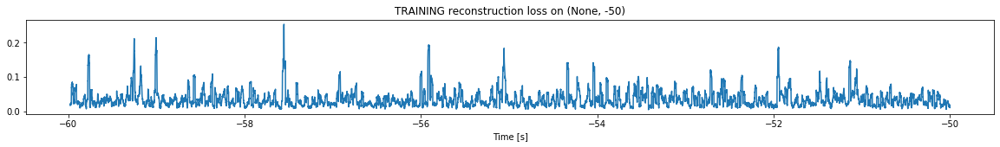

Finished training, median of the log(loss) is:  -1.5234293254462477
<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


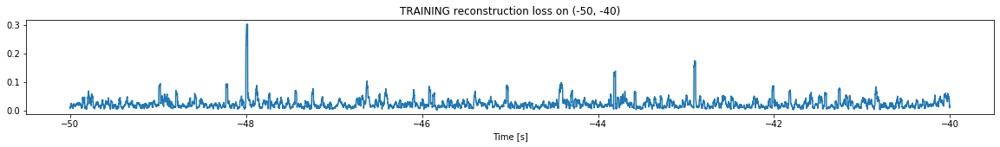

Finished training, median of the log(loss) is:  -1.7019395780134907
Triggering for section:  (-40, -30)
Using this median for triggering: -1.5234293254462477


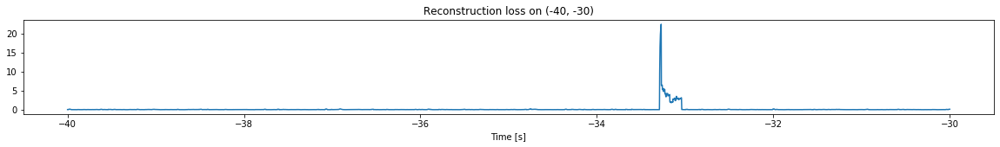

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


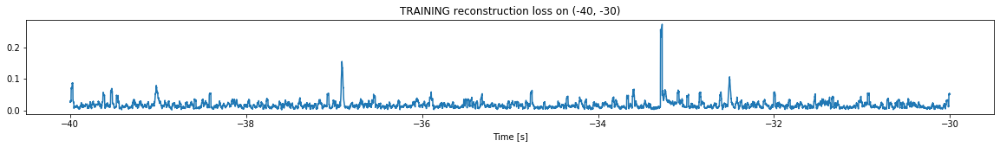

Finished training, median of the log(loss) is:  -1.8103944090667665
Triggering for section:  (-30, -20)
Using this median for triggering: -1.7019395780134907


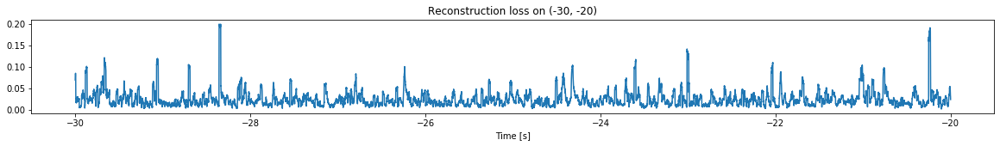

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


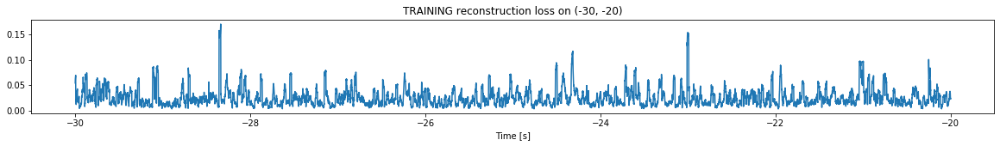

Finished training, median of the log(loss) is:  -1.6723763698312903
Triggering for section:  (-20, -10)
Using this median for triggering: -1.8103944090667665


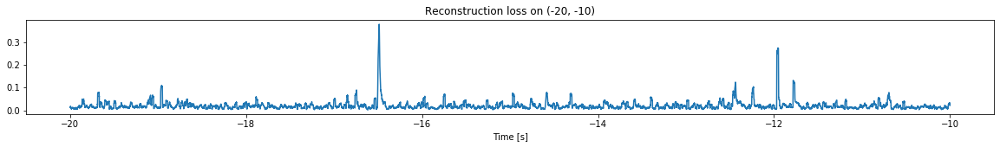

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


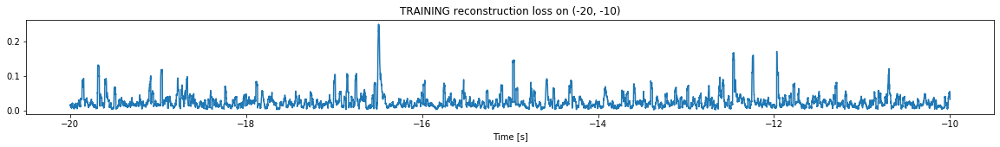

Finished training, median of the log(loss) is:  -1.6905765579749585
Triggering for section:  (-10, 0)
Using this median for triggering: -1.6723763698312903


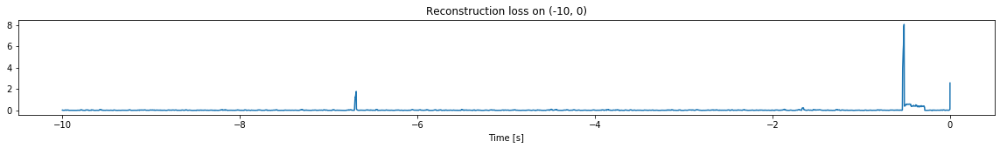

<--------
Finished simulation, all the triggered times are:  []


In [24]:
simulation("./data/Ramp28/", 10, (-60,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (999800, 13)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


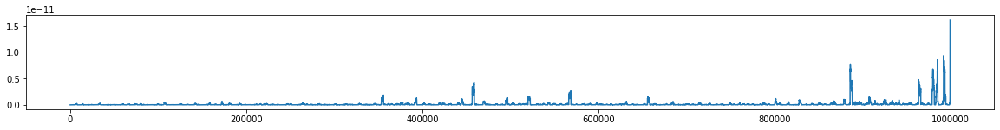

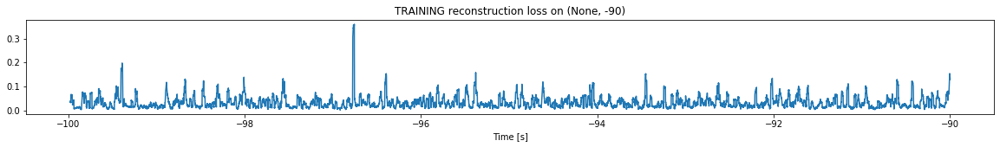

Finished training, median of the log(loss) is:  -1.5616484193060933
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


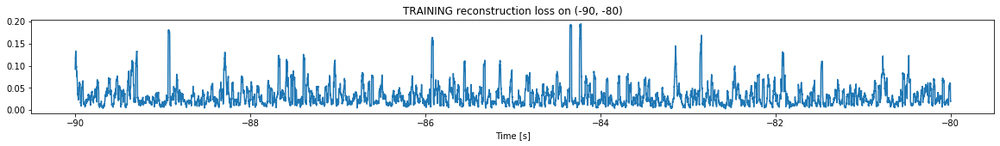

Finished training, median of the log(loss) is:  -1.5942513456957943
Triggering for section:  (-80, -70)
Using this median for triggering: -1.5616484193060933


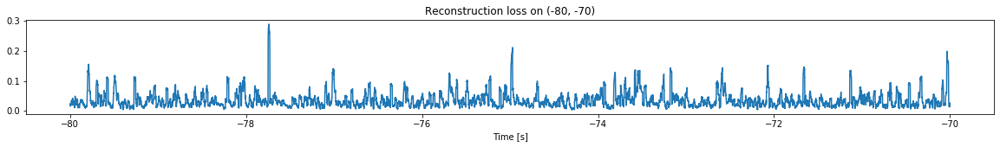

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


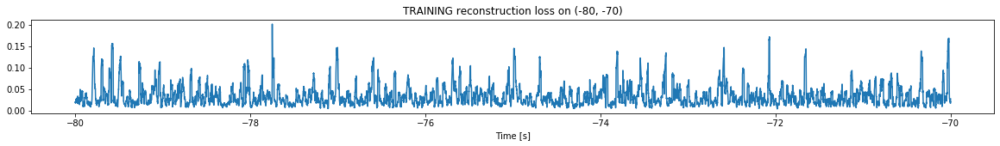

Finished training, median of the log(loss) is:  -1.559463372968716
Triggering for section:  (-70, -60)
Using this median for triggering: -1.5942513456957943


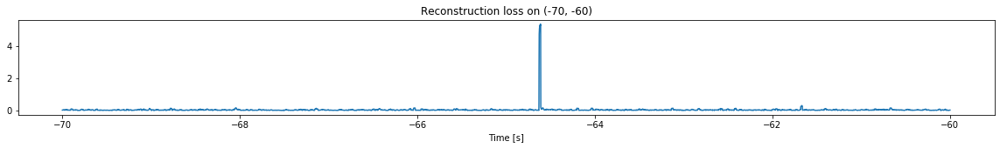

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


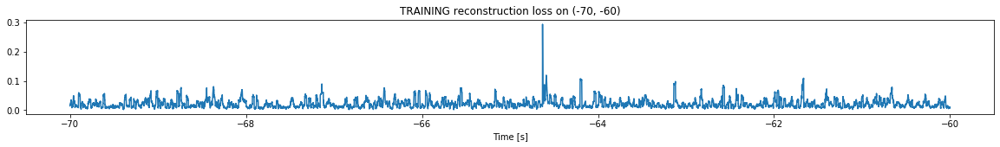

Finished training, median of the log(loss) is:  -1.7330261017505593
Triggering for section:  (-60, -50)
Using this median for triggering: -1.559463372968716


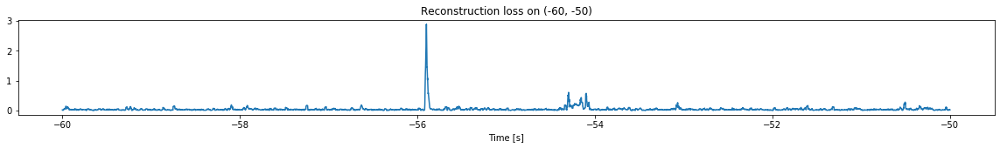

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


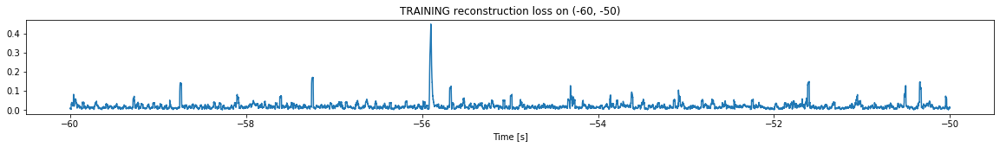

Finished training, median of the log(loss) is:  -1.7610708963076087
Triggering for section:  (-50, -40)
Using this median for triggering: -1.7330261017505593


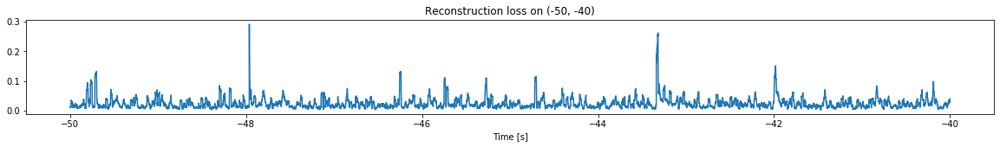

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


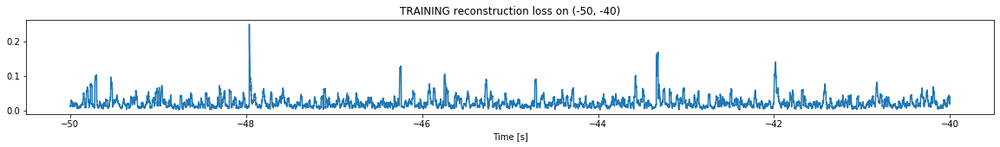

Finished training, median of the log(loss) is:  -1.7156386777133936
Triggering for section:  (-40, -30)
Using this median for triggering: -1.7610708963076087


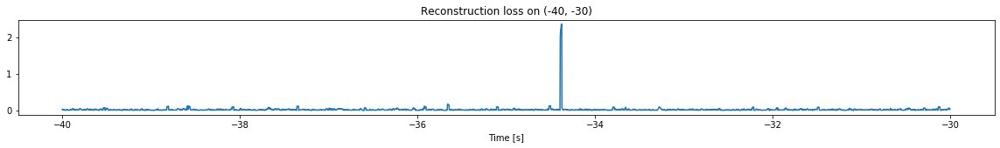

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


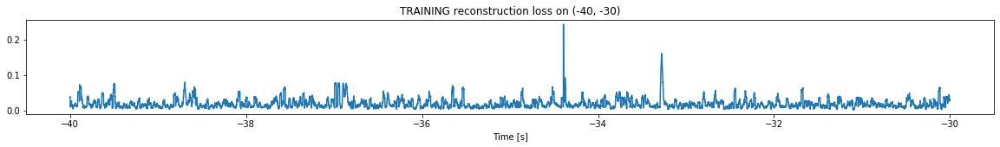

Finished training, median of the log(loss) is:  -1.7994326948138655
Triggering for section:  (-30, -20)
Using this median for triggering: -1.7156386777133936


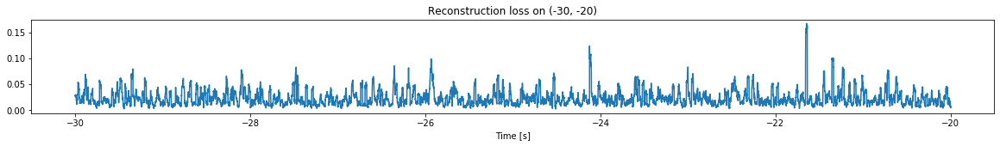

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


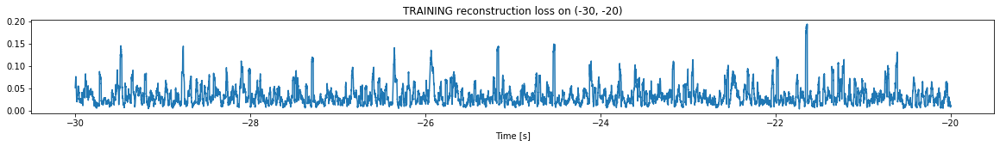

Finished training, median of the log(loss) is:  -1.5314489242750629
Triggering for section:  (-20, -10)
Using this median for triggering: -1.7994326948138655


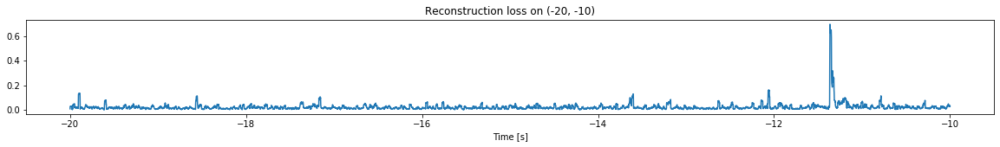

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


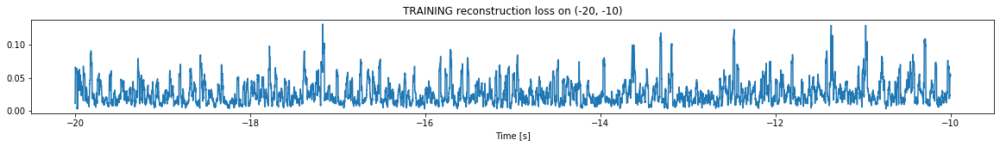

Finished training, median of the log(loss) is:  -1.6483670885899102
Triggering for section:  (-10, 0)
Using this median for triggering: -1.5314489242750629


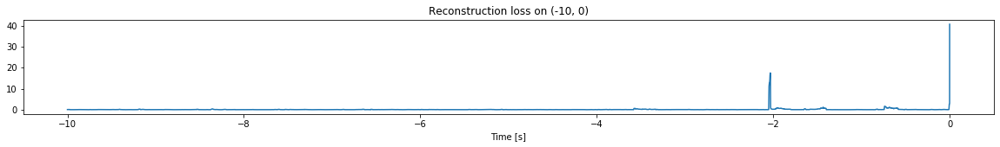

<--------
Finished simulation, all the triggered times are:  []


In [25]:
simulation("./data/Ramp29/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1199800, 13)
Flushing input history
Number of sections: 12
Entering sections:  (-120, -110)
-------->
Entering sections:  (-110, -100)
-------->
Training for section:  (None, -110)


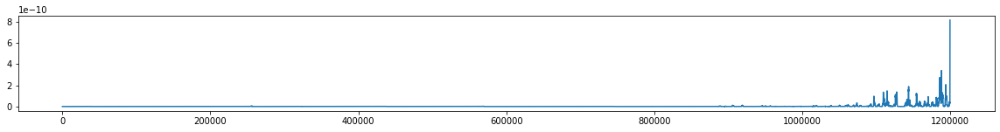

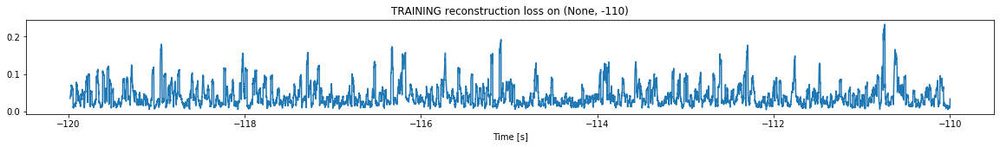

Finished training, median of the log(loss) is:  -1.4720727377881833
<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


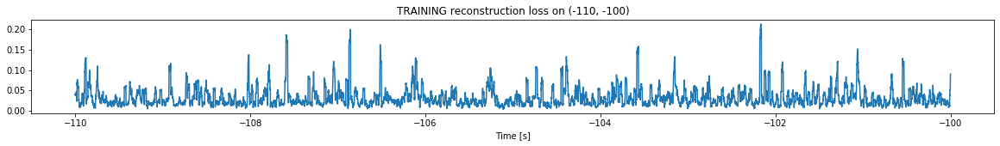

Finished training, median of the log(loss) is:  -1.582704269619027
Triggering for section:  (-100, -90)
Using this median for triggering: -1.4720727377881833


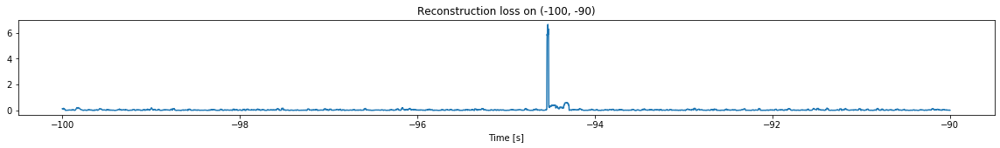

<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


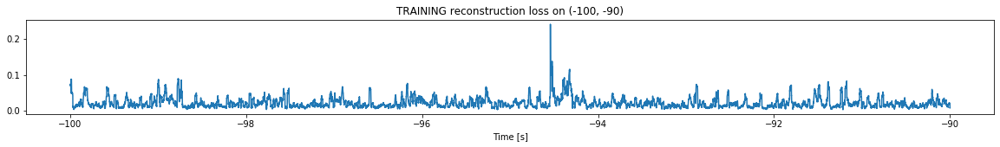

Finished training, median of the log(loss) is:  -1.7534632224627869
Triggering for section:  (-90, -80)
Using this median for triggering: -1.582704269619027


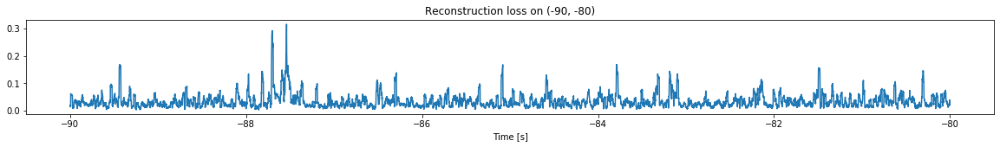

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


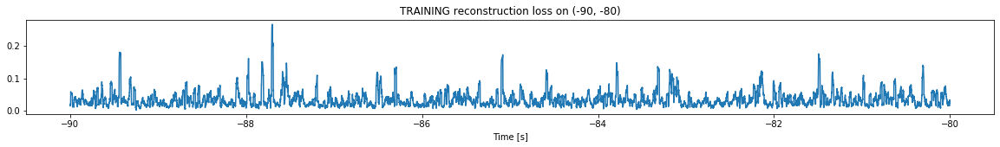

Finished training, median of the log(loss) is:  -1.5395894284426934
Triggering for section:  (-80, -70)
Using this median for triggering: -1.7534632224627869


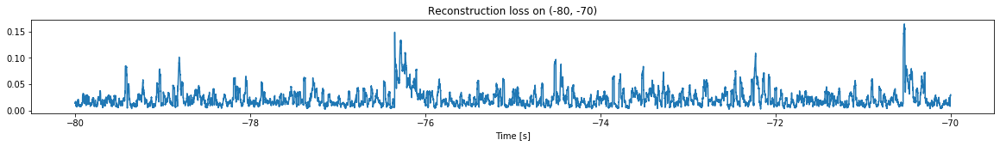

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


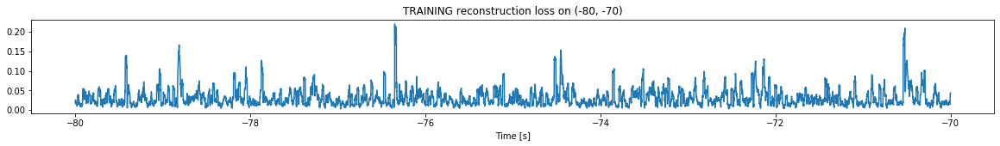

Finished training, median of the log(loss) is:  -1.5781257577843784
Triggering for section:  (-70, -60)
Using this median for triggering: -1.5395894284426934


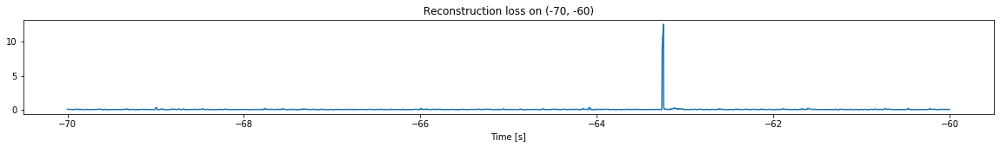

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


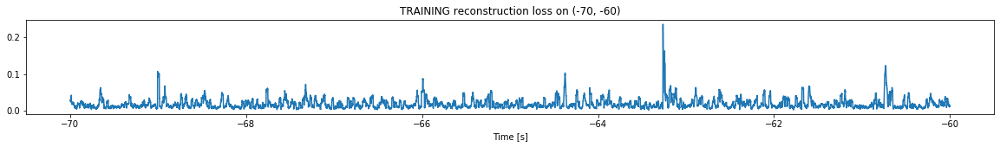

Finished training, median of the log(loss) is:  -1.7998554667479039
Triggering for section:  (-60, -50)
Using this median for triggering: -1.5781257577843784


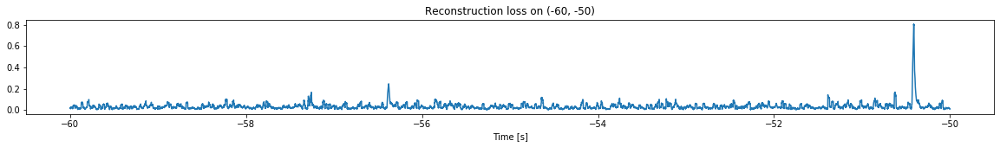

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


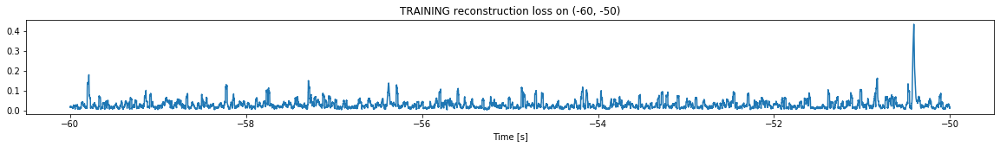

Finished training, median of the log(loss) is:  -1.6346755491543403
Triggering for section:  (-50, -40)
Using this median for triggering: -1.7998554667479039


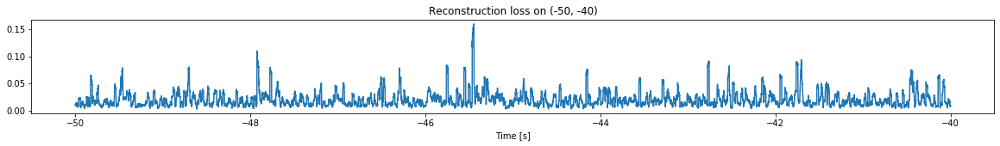

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


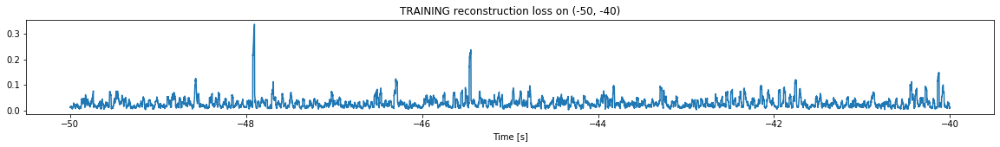

Finished training, median of the log(loss) is:  -1.6085917890089019
Triggering for section:  (-40, -30)
Using this median for triggering: -1.6346755491543403


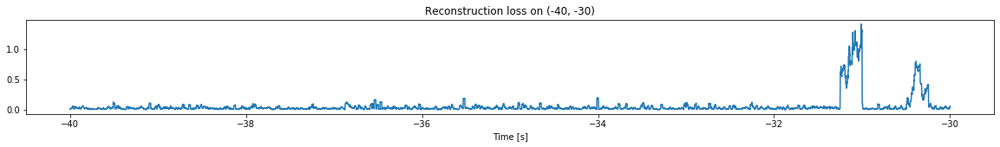

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


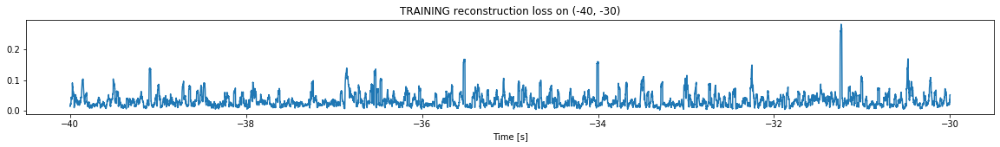

Finished training, median of the log(loss) is:  -1.565763040221635
Triggering for section:  (-30, -20)
Using this median for triggering: -1.6085917890089019


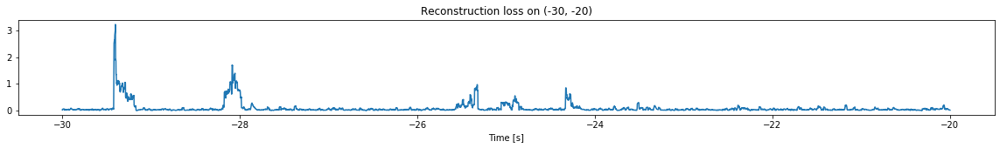

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


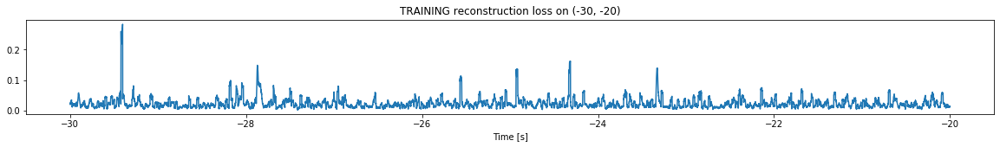

Finished training, median of the log(loss) is:  -1.6998019052297386
Triggering for section:  (-20, -10)
Using this median for triggering: -1.565763040221635


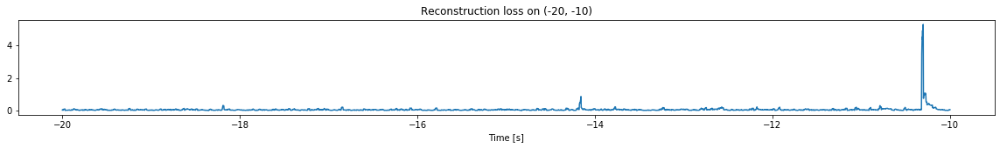

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


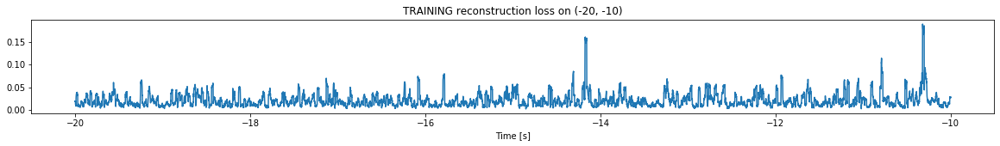

Finished training, median of the log(loss) is:  -1.7450665590023624
Triggering for section:  (-10, 0)
Using this median for triggering: -1.6998019052297386


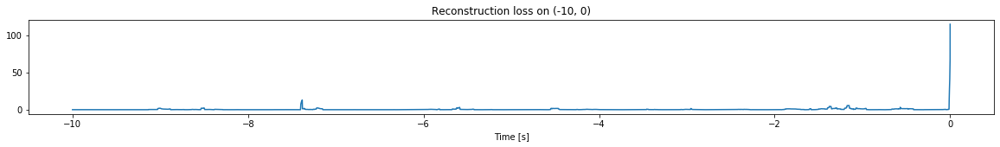

Other trigger time:  []
Their log loss values are:  []


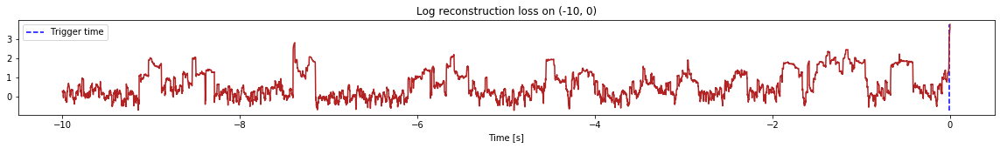

Triggered at:  []
<--------
Finished simulation, all the triggered times are:  []


In [26]:
simulation("./data/Ramp30/", 10, (-120,0))

In [ ]:
----------